<a href="https://colab.research.google.com/github/PacktPublishing/Modern-Computer-Vision-with-PyTorch-2E/blob/main/Chapter10/Image_colorization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
%pip install torch_snippets
from torch_snippets import *
device = 'cuda' if torch.cuda.is_available() else 'cpu'

     |████████████████████████████████| 36.7MB 86kB/s 
     |████████████████████████████████| 61kB 9.7MB/s 
     |████████████████████████████████| 102kB 14.8MB/s 
  Created wheel for contextvars: filename=contextvars-2.4-cp36-none-any.whl size=7666 sha256=f494bc238c8e5795b4faac91019651333bc0b03926136b975d235e95e9687a31
  Stored in directory: /root/.cache/pip/wheels/a5/7d/68/1ebae2668bda2228686e3c1cf16f2c2384cea6e9334ad5f6de
Successfully built contextvars


In [ ]:
from torchvision import datasets
import torch
data_folder = '~/cifar10/cifar/' 
datasets.CIFAR10(data_folder, download=True)

Extracting /root/cifar10/cifar/cifar-10-python.tar.gz to /root/cifar10/cifar/


Dataset CIFAR10
    Number of datapoints: 50000
    Root location: /root/cifar10/cifar/
    Split: Train

In [ ]:
class Colorize(torchvision.datasets.CIFAR10):
    def __init__(self, root, train):
        super().__init__(root, train)
        
    def __getitem__(self, ix):
        im, _ = super().__getitem__(ix)
        bw = im.convert('L').convert('RGB')
        bw, im = np.array(bw)/255., np.array(im)/255.
        bw, im = [torch.tensor(i).permute(2,0,1).to(device).float() for i in [bw,im]]
        return bw, im

trn_ds = Colorize('~/cifar10/cifar/', train=True)
val_ds = Colorize('~/cifar10/cifar/', train=False)

trn_dl = DataLoader(trn_ds, batch_size=256, shuffle=True)
val_dl = DataLoader(val_ds, batch_size=256, shuffle=False)

2020-11-08 11:10:58.474 | INFO     | torch_snippets.loader:subplots:375 - plotting 2 images in a grid of 1x2 @ (5, 5)


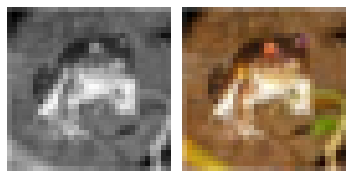

In [ ]:
a,b = trn_ds[0]
subplots([a,b], nc=2)

In [ ]:

class Identity(nn.Module):
    def __init__(self):
        super().__init__()
    def forward(self, x):
        return x

class DownConv(nn.Module):
    def __init__(self, ni, no, maxpool=True):
        super().__init__()
        self.model = nn.Sequential(
            nn.MaxPool2d(2) if maxpool else Identity(),
            nn.Conv2d(ni, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(no, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
        )
    def forward(self, x):
        return self.model(x)

class UpConv(nn.Module):
    def __init__(self, ni, no, maxpool=True):
        super().__init__()
        self.convtranspose = nn.ConvTranspose2d(ni, no, 2, stride=2)
        self.convlayers = nn.Sequential(
            nn.Conv2d(no+no, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
            nn.Conv2d(no, no, 3, padding=1),
            nn.BatchNorm2d(no),
            nn.LeakyReLU(0.2, inplace=True),
        )
        
    def forward(self, x, y):
        x = self.convtranspose(x)
        x = torch.cat([x,y], axis=1)
        x = self.convlayers(x)
        return x

class UNet(nn.Module):
    def __init__(self):
        super().__init__()
        self.d1 = DownConv( 3, 64, maxpool=False)
        self.d2 = DownConv( 64, 128)
        self.d3 = DownConv( 128, 256)
        self.d4 = DownConv( 256, 512)
        self.d5 = DownConv( 512, 1024)
        self.u5 = UpConv (1024, 512)
        self.u4 = UpConv ( 512, 256)
        self.u3 = UpConv ( 256, 128)
        self.u2 = UpConv ( 128, 64)
        self.u1 = nn.Conv2d(64, 3, kernel_size=1, stride=1)

    def forward(self, x):
        x0 = self.d1( x) # 32
        x1 = self.d2(x0) # 16
        x2 = self.d3(x1) # 8
        x3 = self.d4(x2) # 4
        x4 = self.d5(x3) # 2
        X4 = self.u5(x4, x3)# 4
        X3 = self.u4(X4, x2)# 8
        X2 = self.u3(X3, x1)# 16
        X1 = self.u2(X2, x0)# 32
        X0 = self.u1(X1) # 3
        return X0

In [ ]:
def get_model():
    model = UNet().to(device)
    optimizer = optim.Adam(model.parameters(), lr=1e-3)
    loss_fn = nn.MSELoss()
    return model, optimizer, loss_fn

In [ ]:
def train_batch(model, data, optimizer, criterion):
    model.train()
    x, y = data
    _y = model(x)
    optimizer.zero_grad()
    loss = criterion(_y, y)
    loss.backward()
    optimizer.step()
    return loss.item()

@torch.no_grad()
def validate_batch(model, data, criterion):
    model.eval()
    x, y = data
    _y = model(x)
    loss = criterion(_y, y)
    return loss.item()

EPOCH: 0.250	trn_loss: 0.008	(19.58s - 7810.55s remaining)

2020-11-08 11:12:46.313 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 0.255	trn_loss: 0.008	(19.98s - 7810.80s remaining)

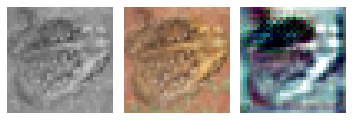

2020-11-08 11:12:46.442 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


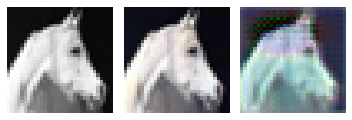

2020-11-08 11:12:46.584 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


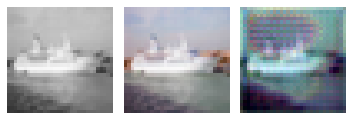

2020-11-08 11:12:46.724 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


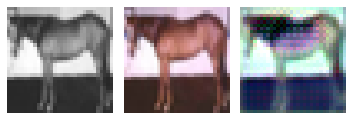

2020-11-08 11:12:46.859 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


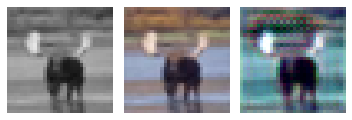

EPOCH: 0.505	trn_loss: 0.007	(40.42s - 7961.56s remaining)

2020-11-08 11:13:07.160 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 0.510	trn_loss: 0.007	(40.82s - 7960.48s remaining)

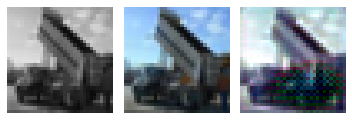

2020-11-08 11:13:07.292 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


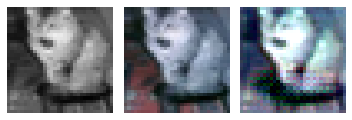

2020-11-08 11:13:07.484 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


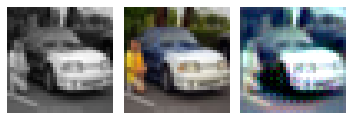

2020-11-08 11:13:07.618 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


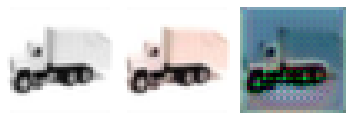

2020-11-08 11:13:07.756 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


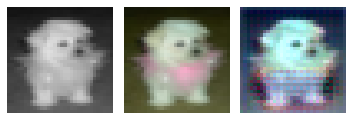

EPOCH: 0.760	trn_loss: 0.006	(61.68s - 8051.67s remaining)

2020-11-08 11:13:28.422 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 0.765	trn_loss: 0.007	(62.09s - 8050.42s remaining)

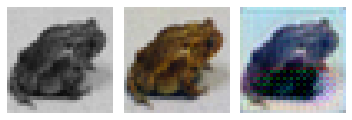

2020-11-08 11:13:28.550 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


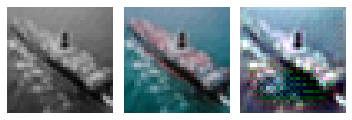

2020-11-08 11:13:28.684 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


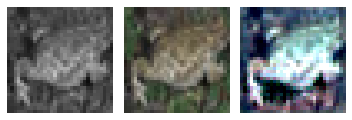

2020-11-08 11:13:28.878 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


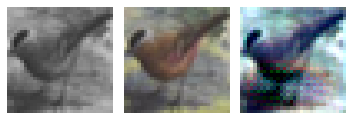

2020-11-08 11:13:29.019 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


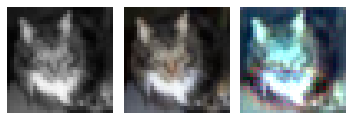

EPOCH: 0.950	val_loss: 0.007	(87.78s - 9152.18s remaining)

2020-11-08 11:13:54.305 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 1.000	val_loss: 0.004	(87.97s - 8708.87s remaining)

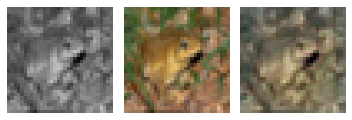

2020-11-08 11:13:54.427 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


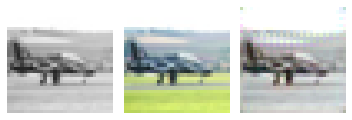

2020-11-08 11:13:54.566 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


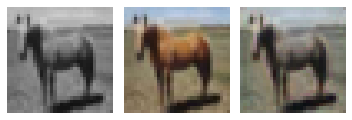

2020-11-08 11:13:54.689 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


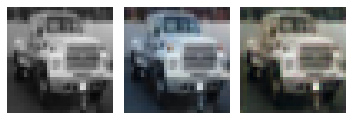

2020-11-08 11:13:54.864 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


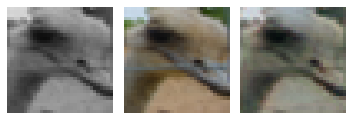

EPOCH: 1.250	trn_loss: 0.007	(108.40s - 8563.51s remaining)

2020-11-08 11:14:15.133 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 1.255	trn_loss: 0.006	(108.80s - 8559.56s remaining)

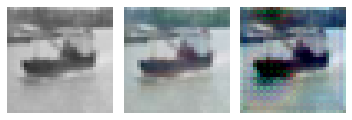

2020-11-08 11:14:15.260 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


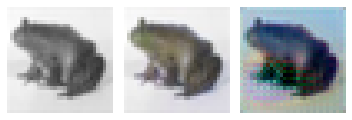

2020-11-08 11:14:15.398 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


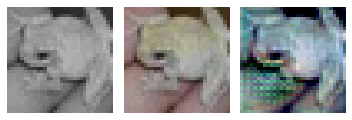

2020-11-08 11:14:15.537 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


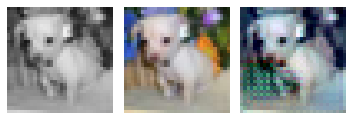

2020-11-08 11:14:15.677 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


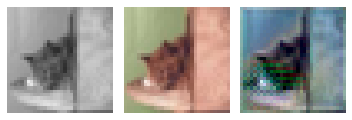

EPOCH: 1.505	trn_loss: 0.006	(129.40s - 8468.32s remaining)

2020-11-08 11:14:36.162 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 1.510	trn_loss: 0.006	(129.83s - 8466.76s remaining)

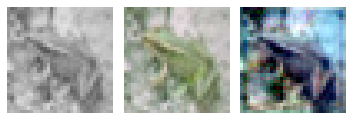

2020-11-08 11:14:36.287 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


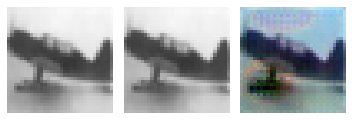

2020-11-08 11:14:36.415 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


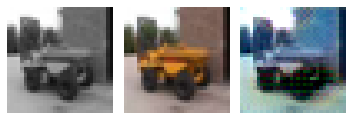

2020-11-08 11:14:36.545 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


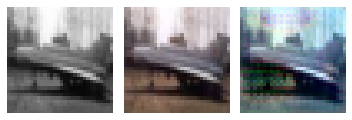

2020-11-08 11:14:36.685 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


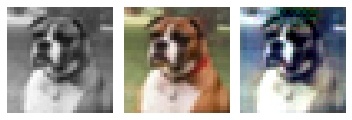

EPOCH: 1.760	trn_loss: 0.006	(150.40s - 8394.24s remaining)

2020-11-08 11:14:57.143 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 1.765	trn_loss: 0.006	(150.81s - 8392.01s remaining)

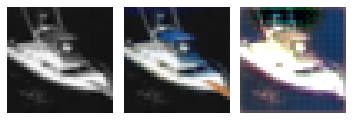

2020-11-08 11:14:57.271 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


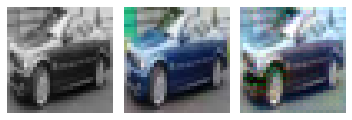

2020-11-08 11:14:57.404 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


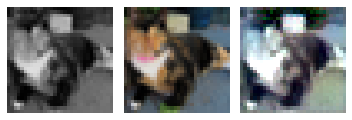

2020-11-08 11:14:57.536 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


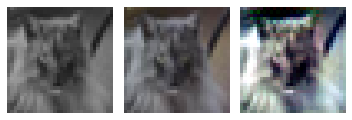

2020-11-08 11:14:57.691 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


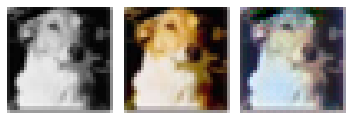

EPOCH: 2.000	val_loss: 0.004	(176.59s - 8652.67s remaining)

2020-11-08 11:15:22.923 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


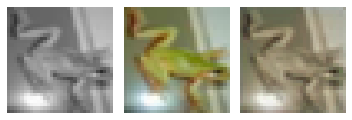

2020-11-08 11:15:23.052 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


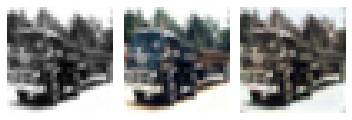

2020-11-08 11:15:23.190 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


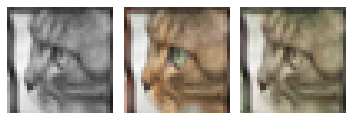

2020-11-08 11:15:23.319 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


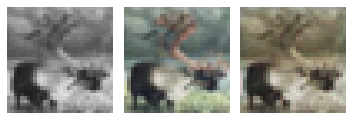

2020-11-08 11:15:23.450 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


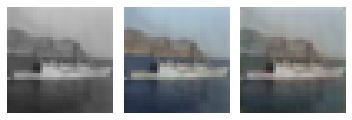

EPOCH: 2.250	trn_loss: 0.006	(197.13s - 8564.37s remaining)

2020-11-08 11:15:43.872 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 2.255	trn_loss: 0.005	(197.54s - 8561.97s remaining)

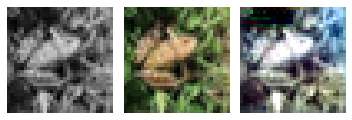

2020-11-08 11:15:44.002 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


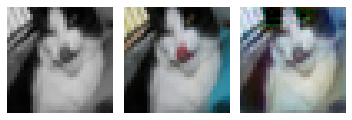

2020-11-08 11:15:44.188 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


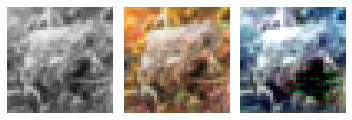

2020-11-08 11:15:44.319 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


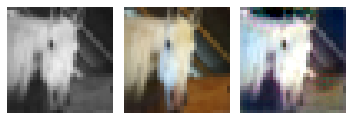

2020-11-08 11:15:44.456 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


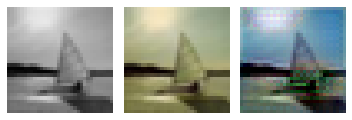

EPOCH: 2.505	trn_loss: 0.006	(218.23s - 8493.04s remaining)

2020-11-08 11:16:04.979 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 2.510	trn_loss: 0.006	(218.64s - 8491.48s remaining)

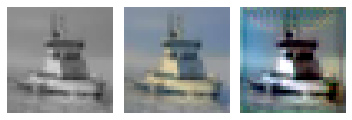

2020-11-08 11:16:05.112 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


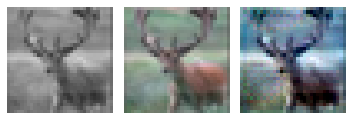

2020-11-08 11:16:05.242 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


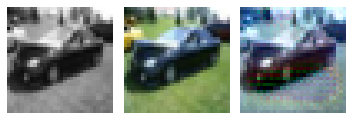

2020-11-08 11:16:05.430 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


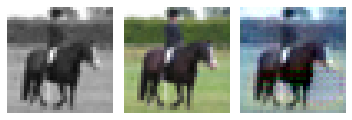

2020-11-08 11:16:05.575 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


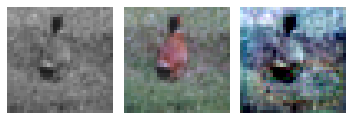

EPOCH: 2.760	trn_loss: 0.005	(239.37s - 8432.72s remaining)

2020-11-08 11:16:26.109 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 2.765	trn_loss: 0.005	(239.77s - 8430.97s remaining)

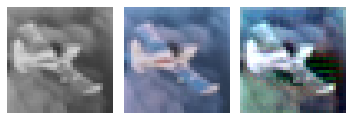

2020-11-08 11:16:26.234 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


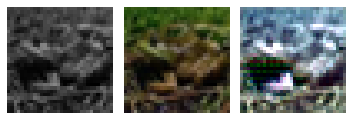

2020-11-08 11:16:26.368 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


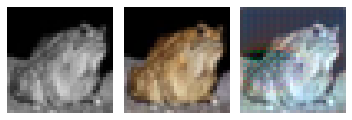

2020-11-08 11:16:26.502 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


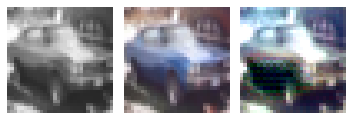

2020-11-08 11:16:26.693 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


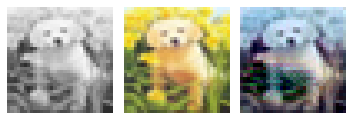

EPOCH: 2.950	val_loss: 0.007	(265.15s - 8723.07s remaining)

2020-11-08 11:16:51.671 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 3.000	val_loss: 0.005	(265.34s - 8579.19s remaining)

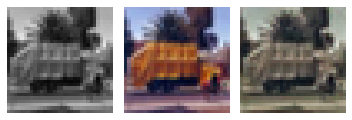

2020-11-08 11:16:51.797 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


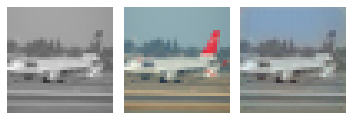

2020-11-08 11:16:51.939 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


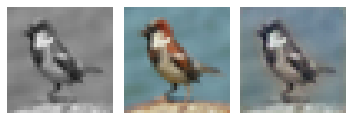

2020-11-08 11:16:52.080 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


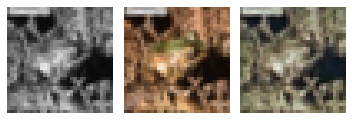

2020-11-08 11:16:52.219 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


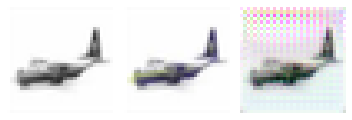

EPOCH: 3.250	trn_loss: 0.005	(285.91s - 8511.31s remaining)

2020-11-08 11:17:12.671 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 3.255	trn_loss: 0.005	(286.33s - 8510.11s remaining)

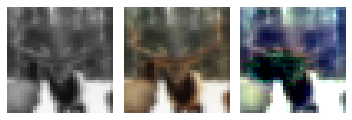

2020-11-08 11:17:12.806 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


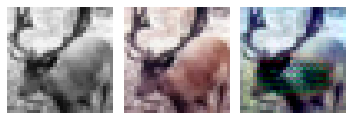

2020-11-08 11:17:12.946 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


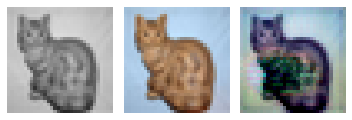

2020-11-08 11:17:13.086 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


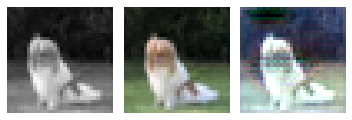

2020-11-08 11:17:13.225 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


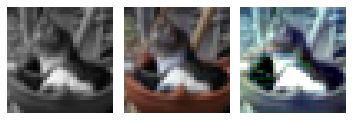

EPOCH: 3.505	trn_loss: 0.005	(307.05s - 8453.09s remaining)

2020-11-08 11:17:33.793 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 3.510	trn_loss: 0.006	(307.46s - 8451.45s remaining)

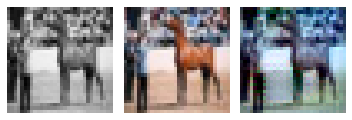

2020-11-08 11:17:33.932 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


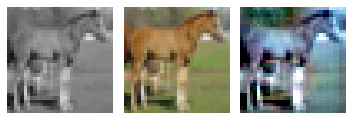

2020-11-08 11:17:34.067 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


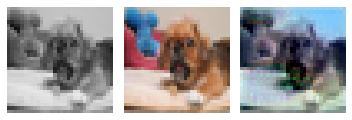

2020-11-08 11:17:34.205 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


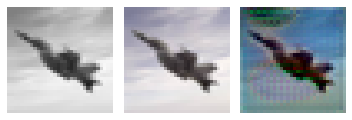

2020-11-08 11:17:34.338 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


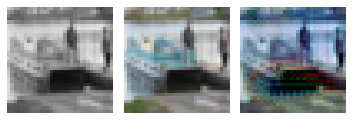

EPOCH: 3.760	trn_loss: 0.005	(328.12s - 8398.08s remaining)

2020-11-08 11:17:54.865 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 3.765	trn_loss: 0.005	(328.53s - 8396.62s remaining)

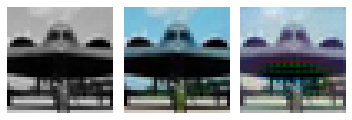

2020-11-08 11:17:54.990 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


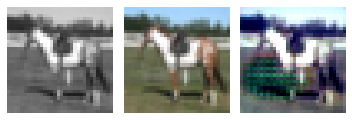

2020-11-08 11:17:55.151 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


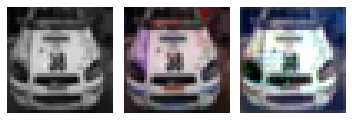

2020-11-08 11:17:55.280 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


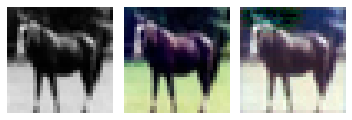

2020-11-08 11:17:55.422 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


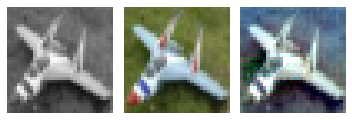

EPOCH: 3.950	val_loss: 0.007	(353.94s - 8606.47s remaining)

2020-11-08 11:18:20.455 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 4.000	val_loss: 0.005	(354.12s - 8498.89s remaining)

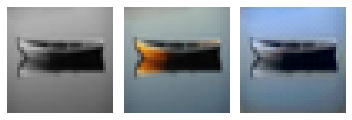

2020-11-08 11:18:20.593 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


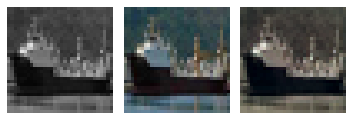

2020-11-08 11:18:20.785 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


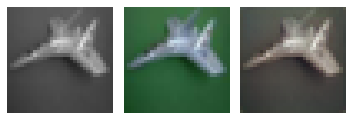

2020-11-08 11:18:20.930 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


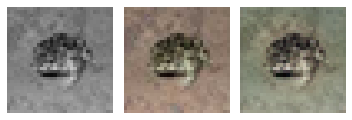

2020-11-08 11:18:21.062 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


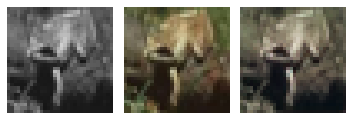

EPOCH: 4.250	trn_loss: 0.005	(374.75s - 8442.80s remaining)

2020-11-08 11:18:41.489 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 4.255	trn_loss: 0.006	(375.15s - 8441.38s remaining)

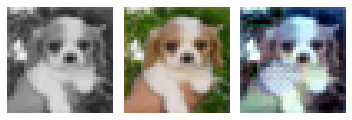

2020-11-08 11:18:41.629 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


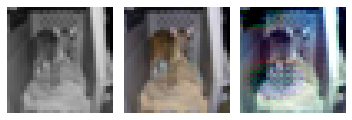

2020-11-08 11:18:41.770 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


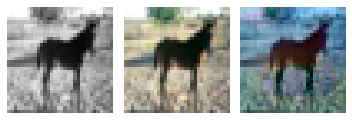

2020-11-08 11:18:41.967 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


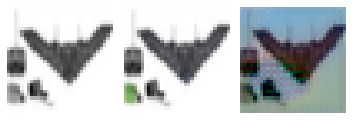

2020-11-08 11:18:42.111 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


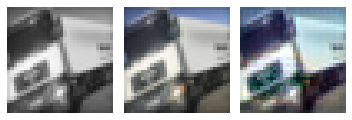

EPOCH: 4.505	trn_loss: 0.005	(395.82s - 8390.30s remaining)

2020-11-08 11:19:02.566 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 4.510	trn_loss: 0.005	(396.23s - 8388.93s remaining)

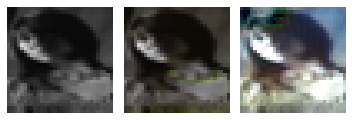

2020-11-08 11:19:02.705 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


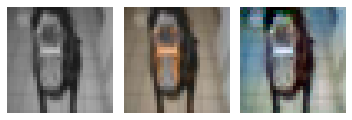

2020-11-08 11:19:02.845 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


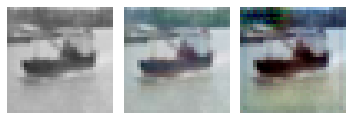

2020-11-08 11:19:02.989 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


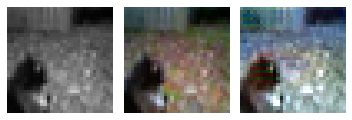

2020-11-08 11:19:03.181 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


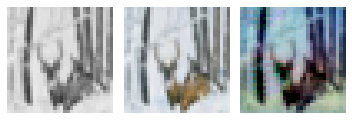

EPOCH: 4.760	trn_loss: 0.006	(417.03s - 8343.83s remaining)

2020-11-08 11:19:23.778 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 4.765	trn_loss: 0.006	(417.44s - 8342.56s remaining)

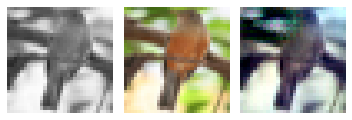

2020-11-08 11:19:23.903 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


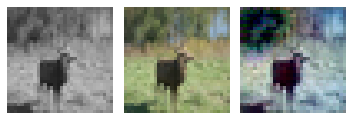

2020-11-08 11:19:24.037 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


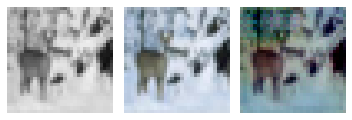

2020-11-08 11:19:24.171 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


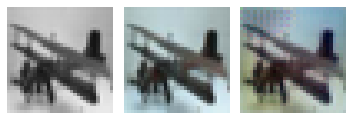

2020-11-08 11:19:24.318 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


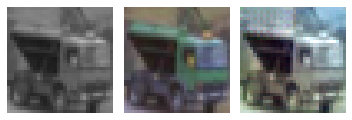

EPOCH: 4.950	val_loss: 0.006	(443.21s - 8510.50s remaining)

2020-11-08 11:19:49.732 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 5.000	trn_loss: 0.005	val_loss: 0.005	(443.40s - 8424.55s remaining)


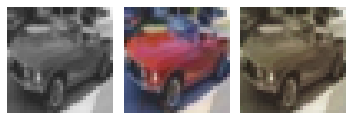

2020-11-08 11:19:49.864 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


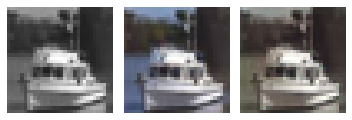

2020-11-08 11:19:49.997 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


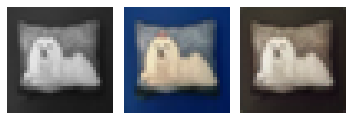

2020-11-08 11:19:50.123 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


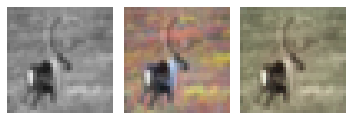

2020-11-08 11:19:50.256 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


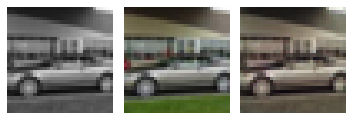

EPOCH: 5.250	trn_loss: 0.005	(464.06s - 8375.22s remaining)

2020-11-08 11:20:10.805 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 5.255	trn_loss: 0.005	(464.47s - 8373.95s remaining)

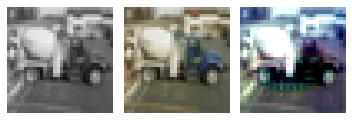

2020-11-08 11:20:10.939 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


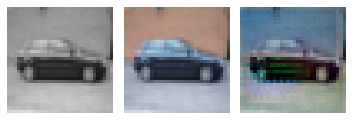

2020-11-08 11:20:11.076 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


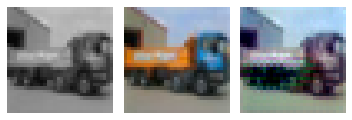

2020-11-08 11:20:11.219 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


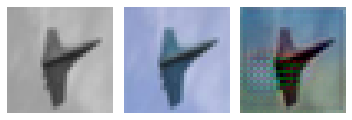

2020-11-08 11:20:11.356 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


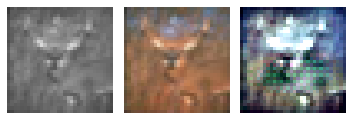

EPOCH: 5.505	trn_loss: 0.005	(485.21s - 8328.58s remaining)

2020-11-08 11:20:31.960 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 5.510	trn_loss: 0.005	(485.62s - 8327.53s remaining)

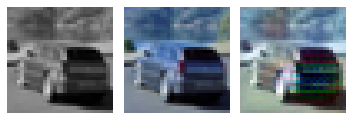

2020-11-08 11:20:32.095 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


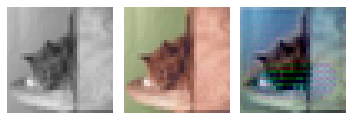

2020-11-08 11:20:32.229 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


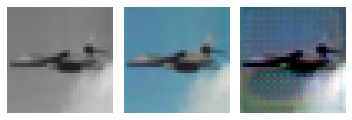

2020-11-08 11:20:32.368 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


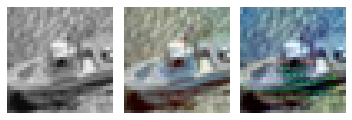

2020-11-08 11:20:32.500 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


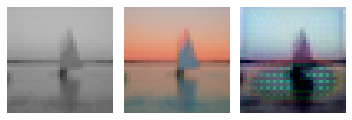

EPOCH: 5.760	trn_loss: 0.006	(506.22s - 8282.06s remaining)

2020-11-08 11:20:52.963 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 5.765	trn_loss: 0.005	(506.63s - 8280.88s remaining)

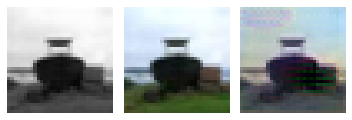

2020-11-08 11:20:53.101 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


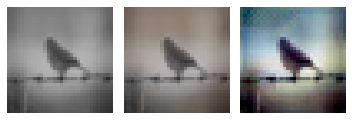

2020-11-08 11:20:53.291 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


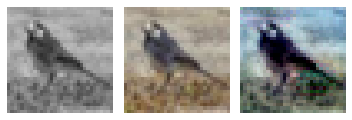

2020-11-08 11:20:53.422 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


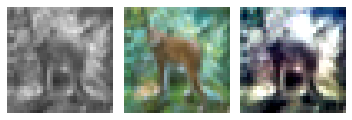

2020-11-08 11:20:53.551 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


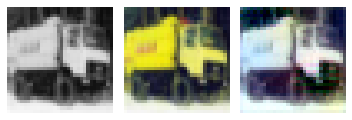

EPOCH: 5.950	val_loss: 0.006	(532.02s - 8409.55s remaining)

2020-11-08 11:21:18.542 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 6.000	val_loss: 0.005	(532.21s - 8337.92s remaining)

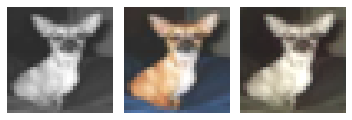

2020-11-08 11:21:18.666 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


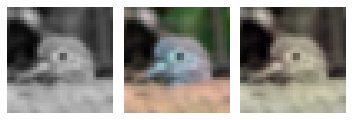

2020-11-08 11:21:18.792 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


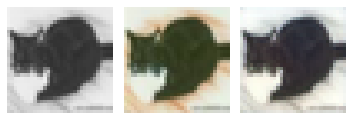

2020-11-08 11:21:18.984 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


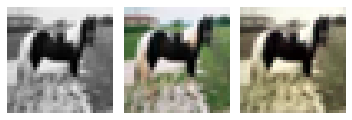

2020-11-08 11:21:19.115 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


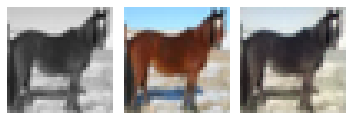

EPOCH: 6.250	trn_loss: 0.005	(552.82s - 8292.36s remaining)

2020-11-08 11:21:39.570 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 6.255	trn_loss: 0.005	(553.23s - 8291.28s remaining)

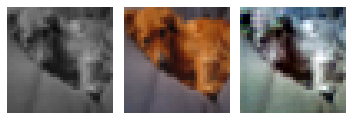

2020-11-08 11:21:39.695 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


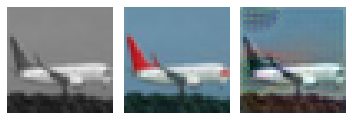

2020-11-08 11:21:39.831 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


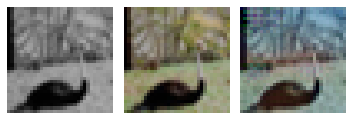

2020-11-08 11:21:39.962 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


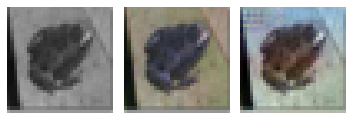

2020-11-08 11:21:40.152 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


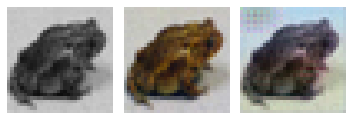

EPOCH: 6.505	trn_loss: 0.005	(573.91s - 8248.51s remaining)

2020-11-08 11:22:00.647 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 6.510	trn_loss: 0.006	(574.31s - 8247.39s remaining)

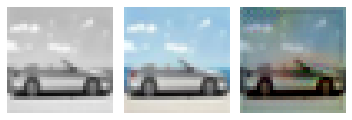

2020-11-08 11:22:00.766 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


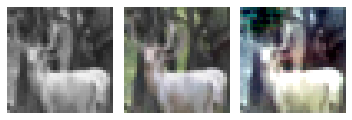

2020-11-08 11:22:00.895 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


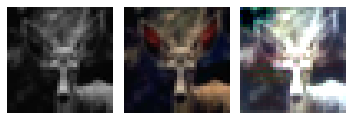

2020-11-08 11:22:01.032 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


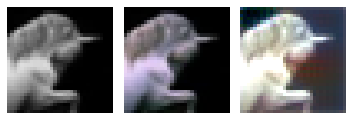

2020-11-08 11:22:01.185 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


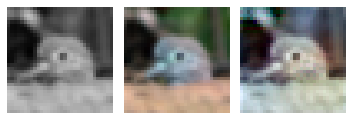

EPOCH: 6.760	trn_loss: 0.005	(594.87s - 8204.72s remaining)

2020-11-08 11:22:21.604 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 6.765	trn_loss: 0.006	(595.27s - 8203.57s remaining)

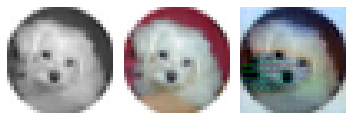

2020-11-08 11:22:21.725 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


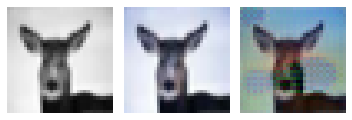

2020-11-08 11:22:21.854 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


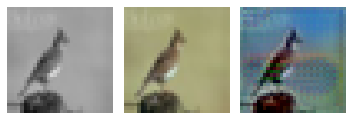

2020-11-08 11:22:21.982 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


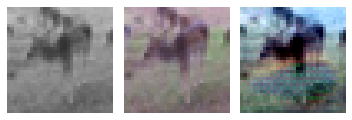

2020-11-08 11:22:22.112 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


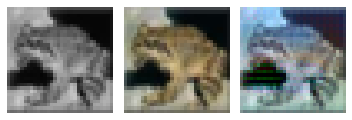

EPOCH: 6.950	val_loss: 0.006	(620.51s - 8307.65s remaining)

2020-11-08 11:22:47.026 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 7.000	val_loss: 0.004	(620.69s - 8246.32s remaining)

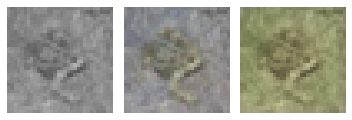

2020-11-08 11:22:47.152 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


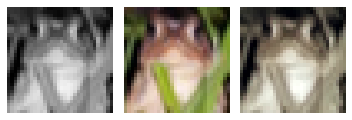

2020-11-08 11:22:47.278 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


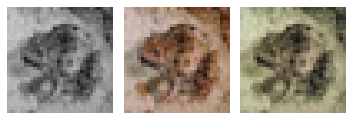

2020-11-08 11:22:47.407 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


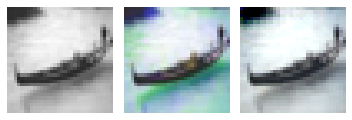

2020-11-08 11:22:47.537 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


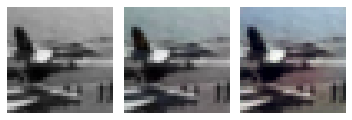

EPOCH: 7.250	trn_loss: 0.004	(641.07s - 8201.23s remaining)

2020-11-08 11:23:07.803 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 7.255	trn_loss: 0.006	(641.47s - 8200.11s remaining)

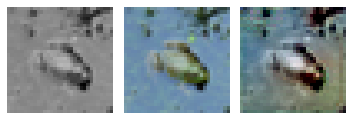

2020-11-08 11:23:07.941 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


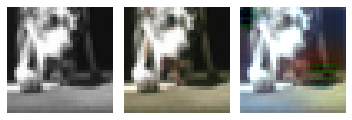

2020-11-08 11:23:08.069 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


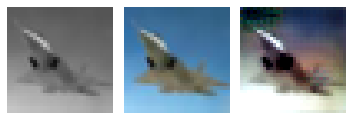

2020-11-08 11:23:08.200 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


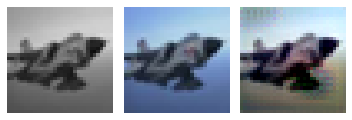

2020-11-08 11:23:08.335 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


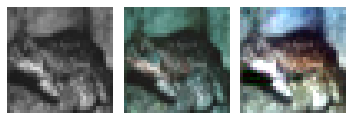

EPOCH: 7.505	trn_loss: 0.005	(661.95s - 8158.09s remaining)

2020-11-08 11:23:28.685 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 7.510	trn_loss: 0.004	(662.35s - 8156.98s remaining)

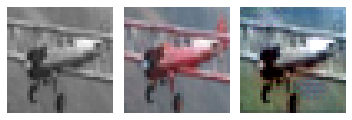

2020-11-08 11:23:28.805 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


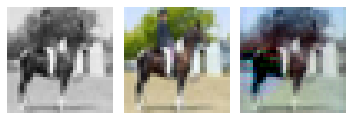

2020-11-08 11:23:28.996 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


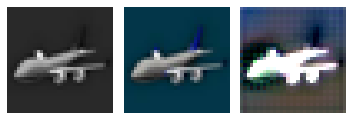

2020-11-08 11:23:29.128 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


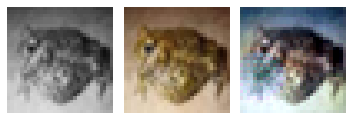

2020-11-08 11:23:29.253 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


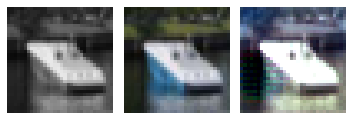

EPOCH: 7.760	trn_loss: 0.005	(682.80s - 8115.92s remaining)

2020-11-08 11:23:49.549 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 7.765	trn_loss: 0.005	(683.21s - 8115.07s remaining)

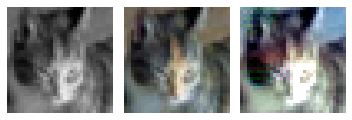

2020-11-08 11:23:49.679 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


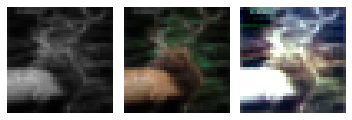

2020-11-08 11:23:49.805 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


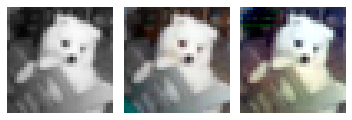

2020-11-08 11:23:49.993 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


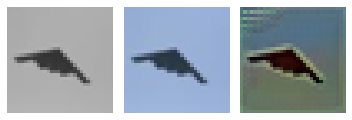

2020-11-08 11:23:50.126 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


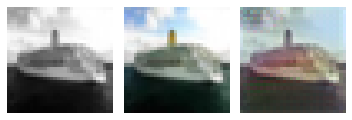

EPOCH: 7.950	val_loss: 0.006	(708.44s - 8202.78s remaining)

2020-11-08 11:24:14.959 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 8.000	val_loss: 0.004	(708.62s - 8149.18s remaining)

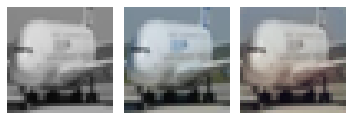

2020-11-08 11:24:15.074 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


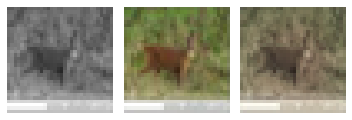

2020-11-08 11:24:15.206 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


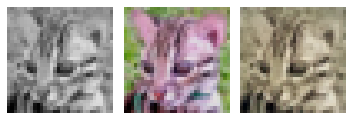

2020-11-08 11:24:15.333 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


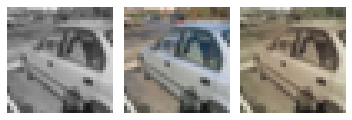

2020-11-08 11:24:15.520 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


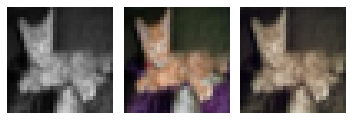

EPOCH: 8.250	trn_loss: 0.005	(729.08s - 8108.23s remaining)

2020-11-08 11:24:35.814 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 8.255	trn_loss: 0.005	(729.48s - 8107.20s remaining)

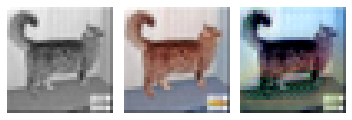

2020-11-08 11:24:35.957 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


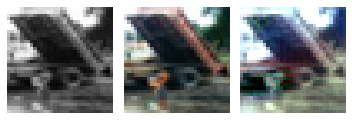

2020-11-08 11:24:36.085 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


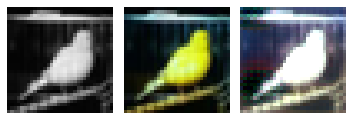

2020-11-08 11:24:36.217 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


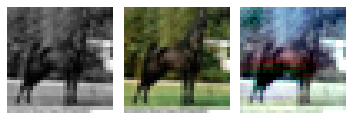

2020-11-08 11:24:36.349 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


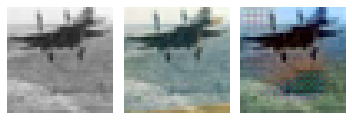

EPOCH: 8.505	trn_loss: 0.004	(749.99s - 8068.14s remaining)

2020-11-08 11:24:56.746 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 8.510	trn_loss: 0.006	(750.41s - 8067.35s remaining)

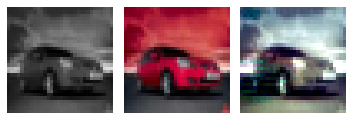

2020-11-08 11:24:56.877 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


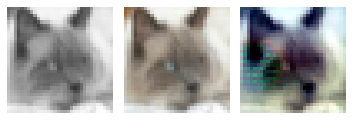

2020-11-08 11:24:57.016 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


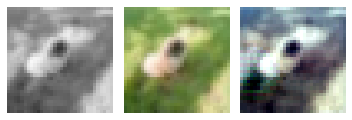

2020-11-08 11:24:57.158 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


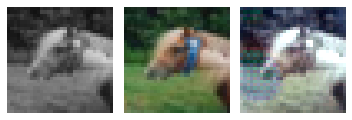

2020-11-08 11:24:57.284 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


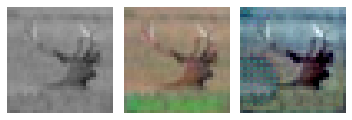

EPOCH: 8.760	trn_loss: 0.005	(770.84s - 8028.48s remaining)

2020-11-08 11:25:17.573 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 8.765	trn_loss: 0.006	(771.24s - 8027.51s remaining)

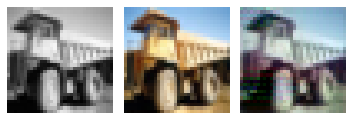

2020-11-08 11:25:17.694 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


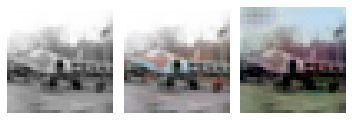

2020-11-08 11:25:17.822 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


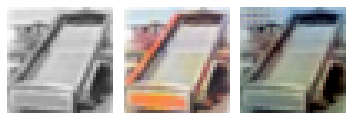

2020-11-08 11:25:17.952 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


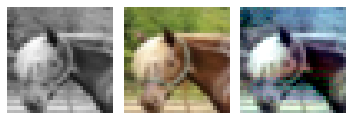

2020-11-08 11:25:18.081 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


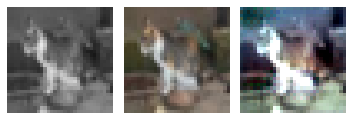

EPOCH: 8.925	val_loss: 0.005	(796.57s - 8128.55s remaining)

2020-11-08 11:25:43.259 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 9.000	val_loss: 0.003	(796.92s - 8057.79s remaining)

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


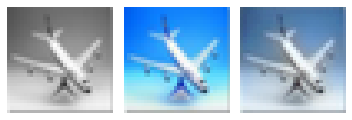

2020-11-08 11:25:43.385 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


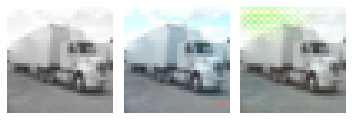

2020-11-08 11:25:43.520 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


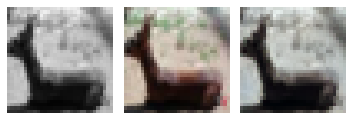

2020-11-08 11:25:43.669 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


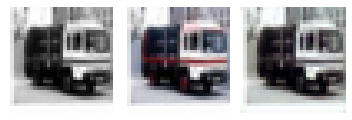

2020-11-08 11:25:43.805 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


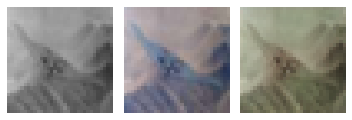

EPOCH: 9.250	trn_loss: 0.005	(817.39s - 8019.30s remaining)

2020-11-08 11:26:04.129 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 9.255	trn_loss: 0.005	(817.79s - 8018.34s remaining)

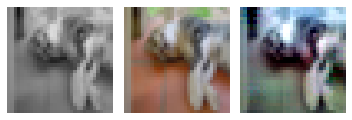

2020-11-08 11:26:04.252 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


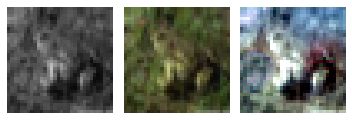

2020-11-08 11:26:04.441 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


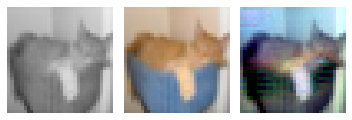

2020-11-08 11:26:04.572 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


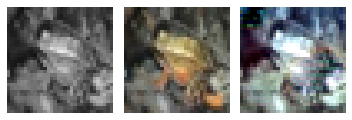

2020-11-08 11:26:04.703 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


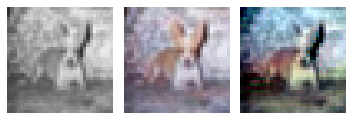

EPOCH: 9.505	trn_loss: 0.006	(838.30s - 7981.21s remaining)

2020-11-08 11:26:25.039 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 9.510	trn_loss: 0.004	(838.70s - 7980.26s remaining)

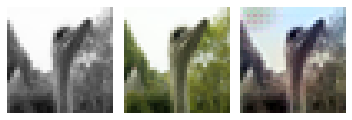

2020-11-08 11:26:25.168 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


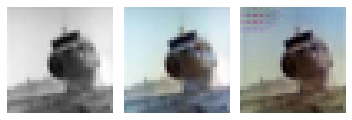

2020-11-08 11:26:25.299 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


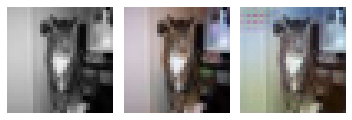

2020-11-08 11:26:25.481 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


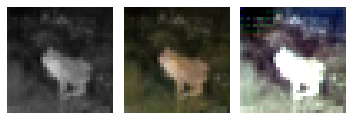

2020-11-08 11:26:25.610 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


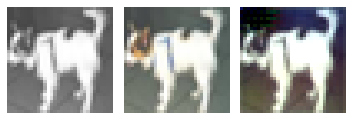

EPOCH: 9.760	trn_loss: 0.006	(859.20s - 7943.86s remaining)

2020-11-08 11:26:45.932 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 9.765	trn_loss: 0.006	(859.60s - 7942.96s remaining)

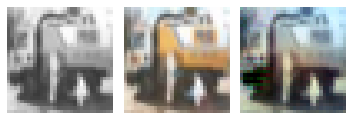

2020-11-08 11:26:46.053 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


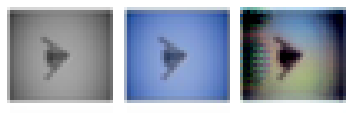

2020-11-08 11:26:46.187 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


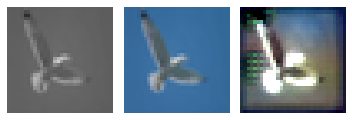

2020-11-08 11:26:46.325 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


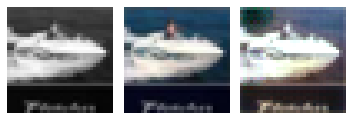

2020-11-08 11:26:46.525 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


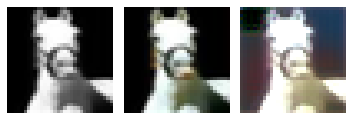

EPOCH: 9.950	val_loss: 0.006	(884.90s - 8008.58s remaining)

2020-11-08 11:27:11.419 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 10.000	trn_loss: 0.005	val_loss: 0.005	(885.08s - 7965.76s remaining)


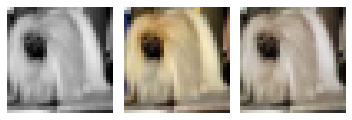

2020-11-08 11:27:11.535 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


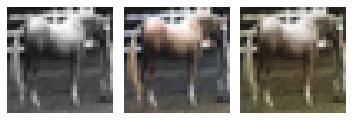

2020-11-08 11:27:11.662 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


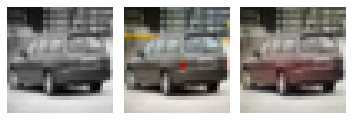

2020-11-08 11:27:11.785 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


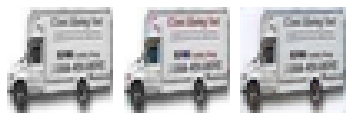

2020-11-08 11:27:11.908 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


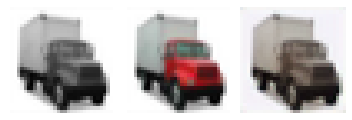

EPOCH: 10.250	trn_loss: 0.005	(905.51s - 7928.70s remaining)

2020-11-08 11:27:32.245 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 10.255	trn_loss: 0.005	(905.91s - 7927.82s remaining)

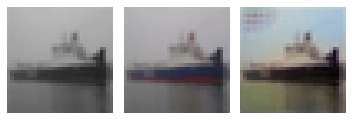

2020-11-08 11:27:32.377 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


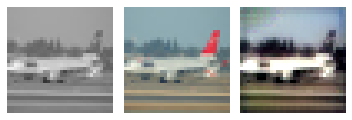

2020-11-08 11:27:32.514 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


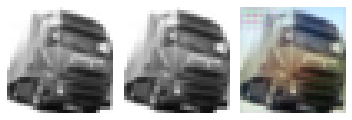

2020-11-08 11:27:32.661 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


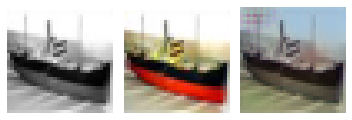

2020-11-08 11:27:32.791 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


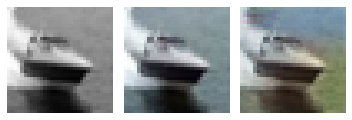

EPOCH: 10.505	trn_loss: 0.005	(926.44s - 7892.48s remaining)

2020-11-08 11:27:53.175 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 10.510	trn_loss: 0.005	(926.84s - 7891.63s remaining)

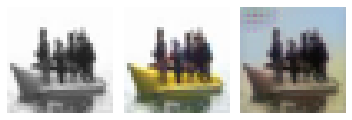

2020-11-08 11:27:53.292 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


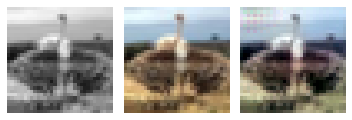

2020-11-08 11:27:53.424 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


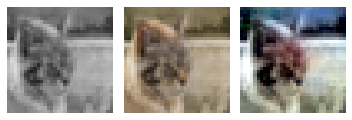

2020-11-08 11:27:53.551 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


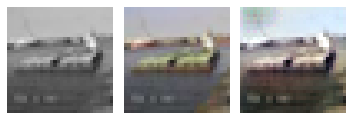

2020-11-08 11:27:53.678 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


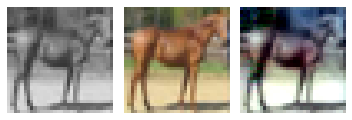

EPOCH: 10.760	trn_loss: 0.006	(947.23s - 7855.82s remaining)

2020-11-08 11:28:13.966 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 10.765	trn_loss: 0.005	(947.63s - 7855.00s remaining)

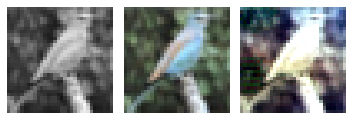

2020-11-08 11:28:14.084 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


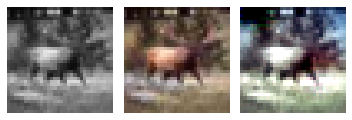

2020-11-08 11:28:14.213 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


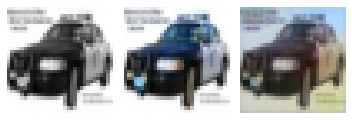

2020-11-08 11:28:14.340 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


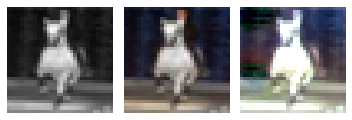

2020-11-08 11:28:14.472 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


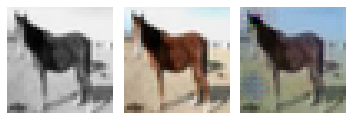

EPOCH: 10.950	val_loss: 0.005	(972.83s - 7911.47s remaining)

2020-11-08 11:28:39.353 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 11.000	val_loss: 0.003	(973.02s - 7872.60s remaining)

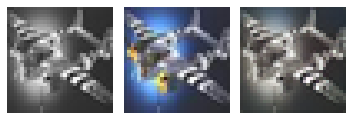

2020-11-08 11:28:39.470 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


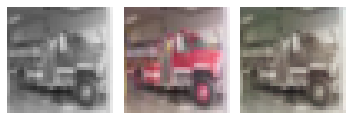

2020-11-08 11:28:39.648 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


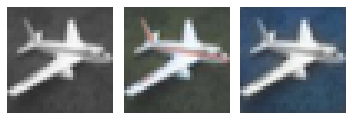

2020-11-08 11:28:39.783 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


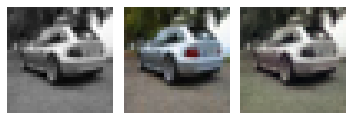

2020-11-08 11:28:39.919 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


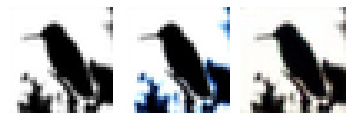

EPOCH: 11.250	trn_loss: 0.005	(993.31s - 7836.13s remaining)

2020-11-08 11:29:00.047 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 11.255	trn_loss: 0.004	(993.71s - 7835.28s remaining)

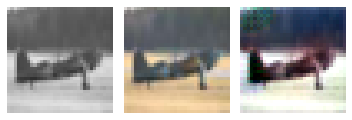

2020-11-08 11:29:00.166 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


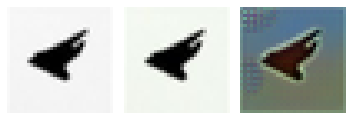

2020-11-08 11:29:00.308 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


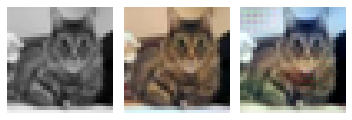

2020-11-08 11:29:00.499 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


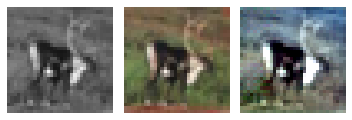

2020-11-08 11:29:00.638 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


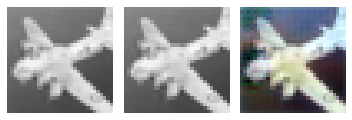

EPOCH: 11.505	trn_loss: 0.005	(1014.13s - 7800.46s remaining)

2020-11-08 11:29:20.861 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 11.510	trn_loss: 0.005	(1014.53s - 7799.62s remaining)

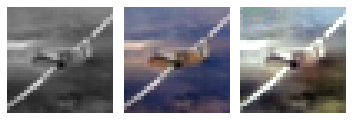

2020-11-08 11:29:20.979 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


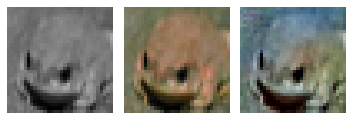

2020-11-08 11:29:21.109 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


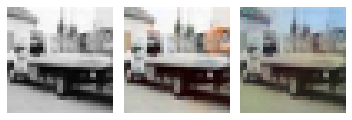

2020-11-08 11:29:21.247 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


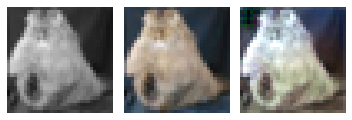

2020-11-08 11:29:21.425 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


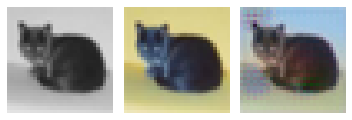

EPOCH: 11.760	trn_loss: 0.005	(1034.95s - 7765.47s remaining)

2020-11-08 11:29:41.683 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 11.765	trn_loss: 0.006	(1035.35s - 7764.66s remaining)

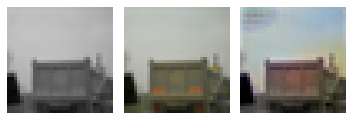

2020-11-08 11:29:41.804 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


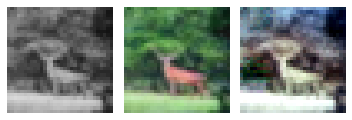

2020-11-08 11:29:41.933 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


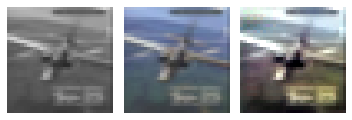

2020-11-08 11:29:42.075 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


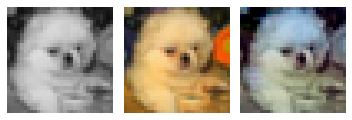

2020-11-08 11:29:42.212 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


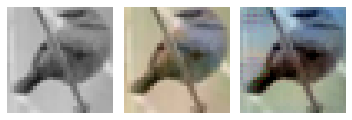

EPOCH: 11.950	val_loss: 0.005	(1060.43s - 7813.49s remaining)

2020-11-08 11:30:06.963 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 12.000	val_loss: 0.003	(1060.63s - 7777.93s remaining)

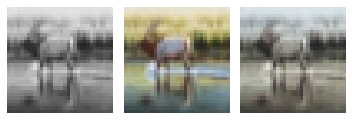

2020-11-08 11:30:07.093 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


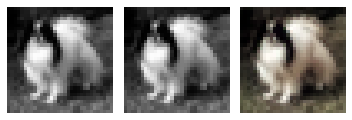

2020-11-08 11:30:07.229 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


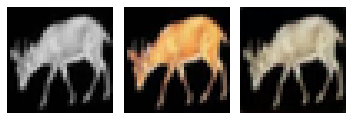

2020-11-08 11:30:07.365 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


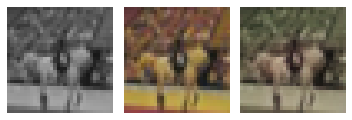

2020-11-08 11:30:07.498 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


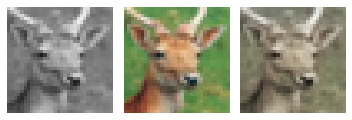

EPOCH: 12.250	trn_loss: 0.005	(1081.05s - 7743.83s remaining)

2020-11-08 11:30:27.783 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 12.255	trn_loss: 0.005	(1081.45s - 7743.02s remaining)

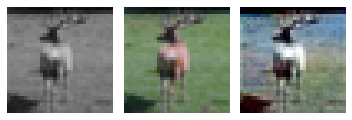

2020-11-08 11:30:27.905 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


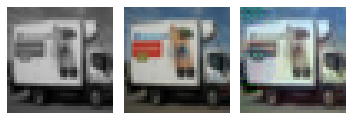

2020-11-08 11:30:28.033 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


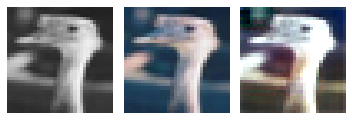

2020-11-08 11:30:28.160 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


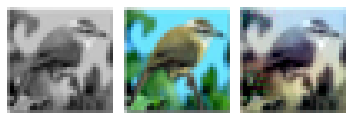

2020-11-08 11:30:28.285 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


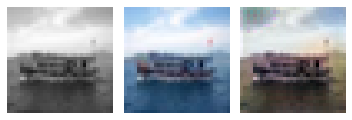

EPOCH: 12.505	trn_loss: 0.005	(1101.84s - 7709.26s remaining)

2020-11-08 11:30:48.573 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 12.510	trn_loss: 0.005	(1102.24s - 7708.47s remaining)

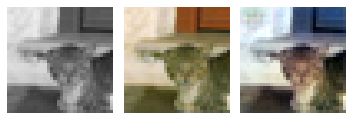

2020-11-08 11:30:48.695 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


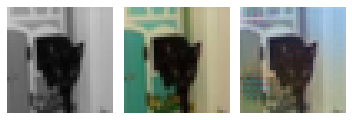

2020-11-08 11:30:48.819 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


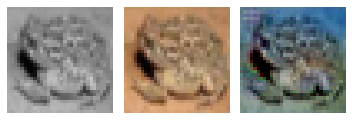

2020-11-08 11:30:48.946 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


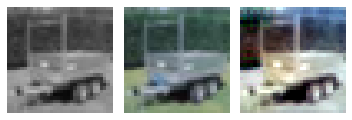

2020-11-08 11:30:49.072 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


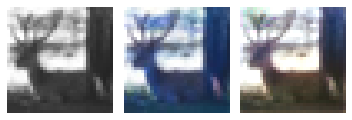

EPOCH: 12.760	trn_loss: 0.005	(1122.56s - 7674.77s remaining)

2020-11-08 11:31:09.298 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 12.765	trn_loss: 0.004	(1122.96s - 7674.03s remaining)

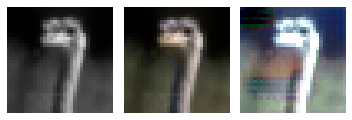

2020-11-08 11:31:09.427 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


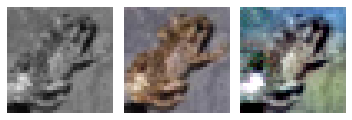

2020-11-08 11:31:09.609 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


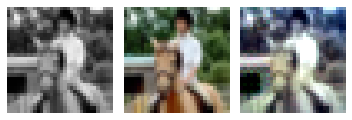

2020-11-08 11:31:09.739 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


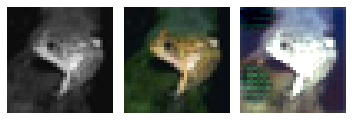

2020-11-08 11:31:09.870 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


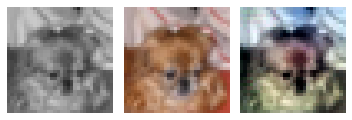

EPOCH: 12.950	val_loss: 0.005	(1148.07s - 7717.33s remaining)

2020-11-08 11:31:34.584 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 13.000	val_loss: 0.003	(1148.25s - 7684.44s remaining)

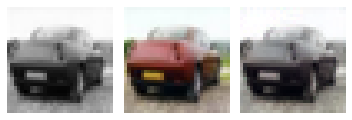

2020-11-08 11:31:34.702 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


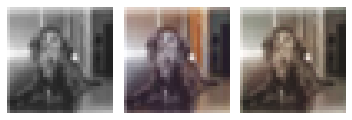

2020-11-08 11:31:34.823 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


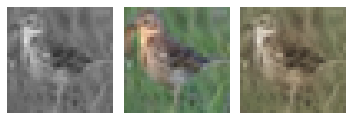

2020-11-08 11:31:34.999 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


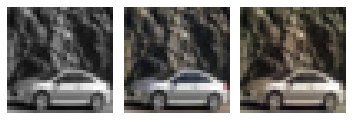

2020-11-08 11:31:35.124 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


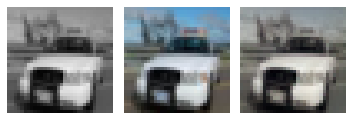

EPOCH: 13.250	trn_loss: 0.005	(1168.71s - 7651.76s remaining)

2020-11-08 11:31:55.447 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 13.255	trn_loss: 0.005	(1169.11s - 7650.98s remaining)

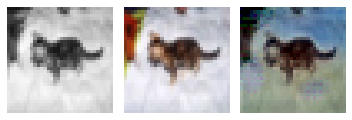

2020-11-08 11:31:55.566 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


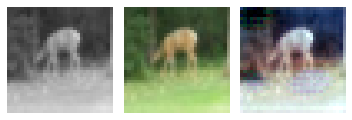

2020-11-08 11:31:55.704 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


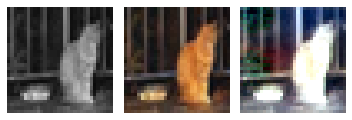

2020-11-08 11:31:55.841 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


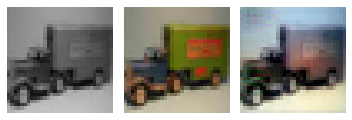

2020-11-08 11:31:56.030 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


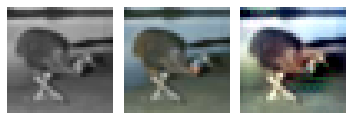

EPOCH: 13.505	trn_loss: 0.004	(1189.58s - 7618.83s remaining)

2020-11-08 11:32:16.333 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 13.510	trn_loss: 0.005	(1190.00s - 7618.14s remaining)

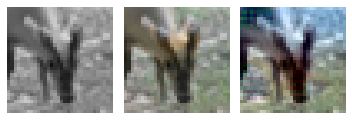

2020-11-08 11:32:16.453 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


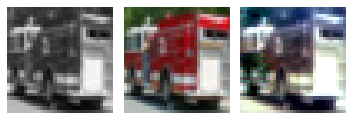

2020-11-08 11:32:16.584 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


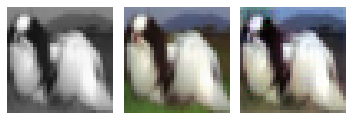

2020-11-08 11:32:16.714 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


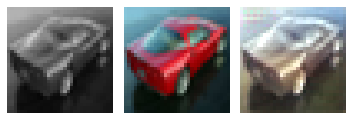

2020-11-08 11:32:16.842 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


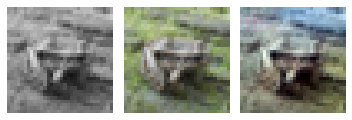

EPOCH: 13.760	trn_loss: 0.005	(1210.44s - 7586.25s remaining)

2020-11-08 11:32:37.183 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 13.765	trn_loss: 0.005	(1210.84s - 7585.49s remaining)

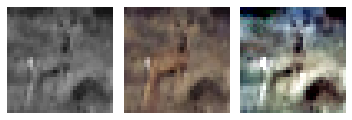

2020-11-08 11:32:37.317 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


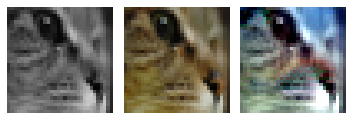

2020-11-08 11:32:37.460 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


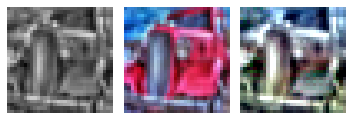

2020-11-08 11:32:37.598 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


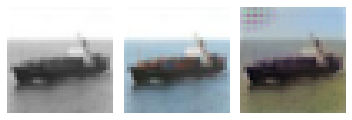

2020-11-08 11:32:37.730 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


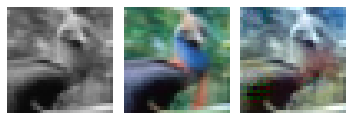

EPOCH: 13.950	val_loss: 0.005	(1235.88s - 7623.45s remaining)

2020-11-08 11:33:02.403 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 14.000	val_loss: 0.003	(1236.07s - 7592.99s remaining)

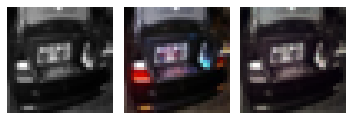

2020-11-08 11:33:02.520 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


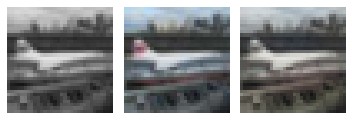

2020-11-08 11:33:02.648 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


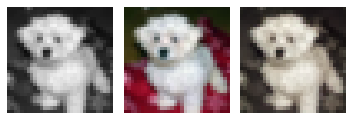

2020-11-08 11:33:02.772 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


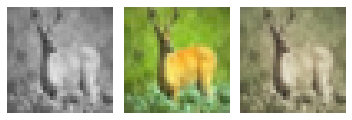

2020-11-08 11:33:02.901 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


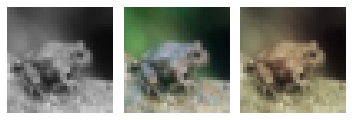

EPOCH: 14.250	trn_loss: 0.005	(1256.40s - 7560.45s remaining)

2020-11-08 11:33:23.145 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 14.255	trn_loss: 0.005	(1256.81s - 7559.75s remaining)

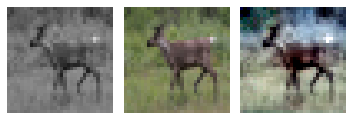

2020-11-08 11:33:23.269 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


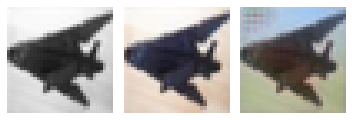

2020-11-08 11:33:23.393 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


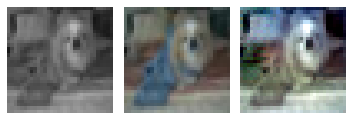

2020-11-08 11:33:23.521 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


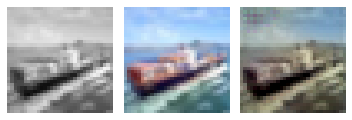

2020-11-08 11:33:23.647 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


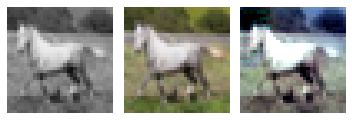

EPOCH: 14.505	trn_loss: 0.005	(1277.10s - 7527.41s remaining)

2020-11-08 11:33:43.838 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 14.510	trn_loss: 0.005	(1277.50s - 7526.66s remaining)

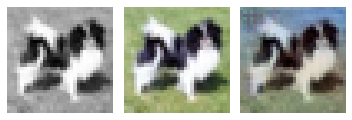

2020-11-08 11:33:43.957 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


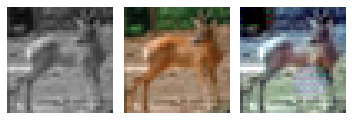

2020-11-08 11:33:44.152 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


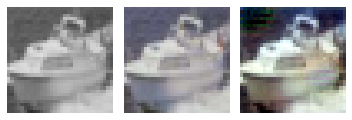

2020-11-08 11:33:44.281 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


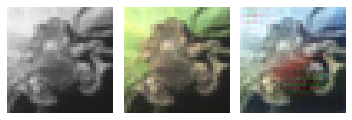

2020-11-08 11:33:44.410 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


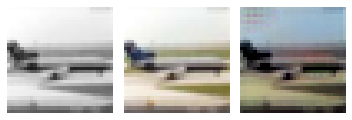

EPOCH: 14.760	trn_loss: 0.005	(1297.91s - 7495.39s remaining)

2020-11-08 11:34:04.641 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 14.765	trn_loss: 0.005	(1298.31s - 7494.64s remaining)

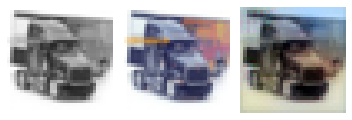

2020-11-08 11:34:04.760 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


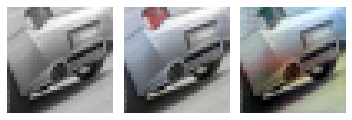

2020-11-08 11:34:04.888 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


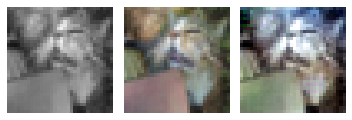

2020-11-08 11:34:05.071 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


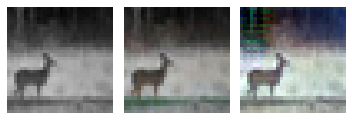

2020-11-08 11:34:05.203 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


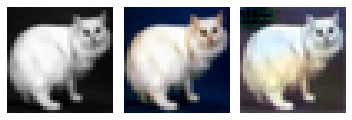

EPOCH: 14.950	val_loss: 0.005	(1323.45s - 7529.04s remaining)

2020-11-08 11:34:29.962 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 15.000	trn_loss: 0.005	val_loss: 0.005	(1323.63s - 7500.56s remaining)


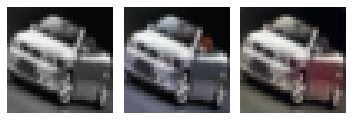

2020-11-08 11:34:30.077 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


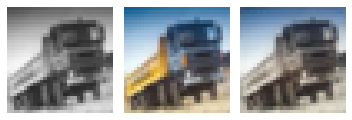

2020-11-08 11:34:30.201 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


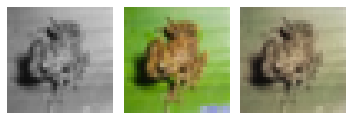

2020-11-08 11:34:30.324 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


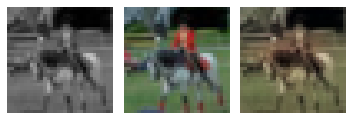

2020-11-08 11:34:30.504 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


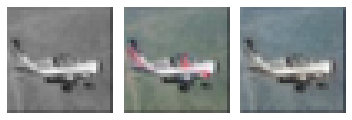

EPOCH: 15.250	trn_loss: 0.004	(1343.93s - 7468.71s remaining)

2020-11-08 11:34:50.660 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 15.255	trn_loss: 0.005	(1344.33s - 7467.97s remaining)

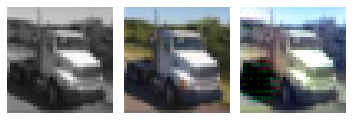

2020-11-08 11:34:50.783 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


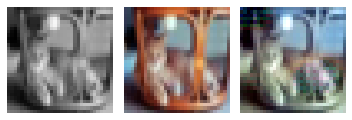

2020-11-08 11:34:50.914 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


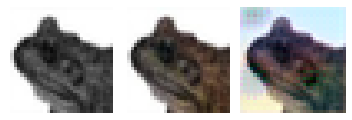

2020-11-08 11:34:51.038 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


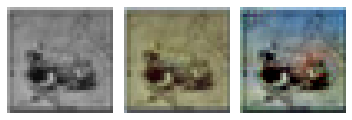

2020-11-08 11:34:51.174 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


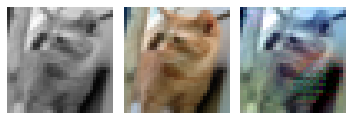

EPOCH: 15.505	trn_loss: 0.004	(1364.71s - 7437.00s remaining)

2020-11-08 11:35:11.457 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 15.510	trn_loss: 0.005	(1365.12s - 7436.32s remaining)

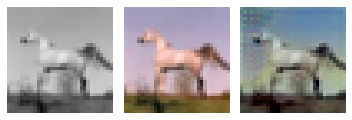

2020-11-08 11:35:11.578 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


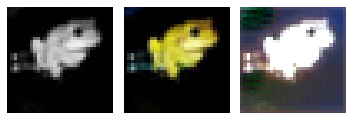

2020-11-08 11:35:11.709 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


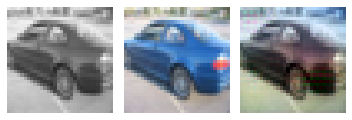

2020-11-08 11:35:11.841 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


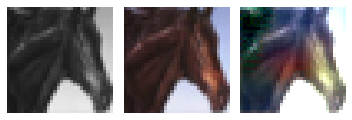

2020-11-08 11:35:11.968 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


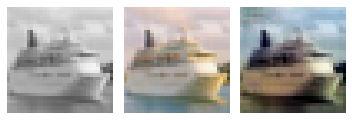

EPOCH: 15.760	trn_loss: 0.005	(1385.45s - 7405.38s remaining)

2020-11-08 11:35:32.182 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 15.765	trn_loss: 0.005	(1385.85s - 7404.63s remaining)

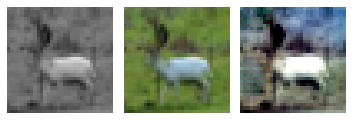

2020-11-08 11:35:32.301 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


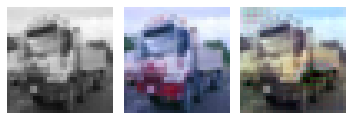

2020-11-08 11:35:32.439 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


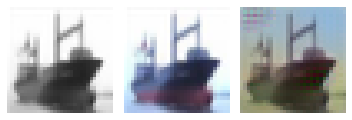

2020-11-08 11:35:32.564 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


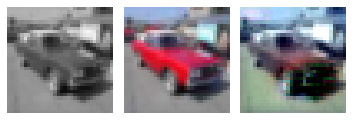

2020-11-08 11:35:32.696 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


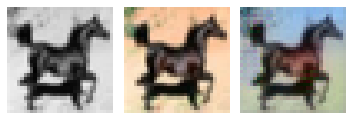

EPOCH: 15.925	val_loss: 0.005	(1410.82s - 7448.35s remaining)

2020-11-08 11:35:57.525 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 16.000	val_loss: 0.003	(1411.19s - 7408.75s remaining)

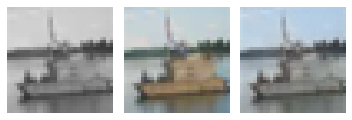

2020-11-08 11:35:57.653 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


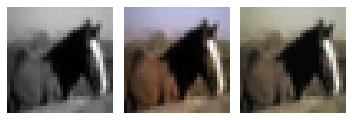

2020-11-08 11:35:57.787 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


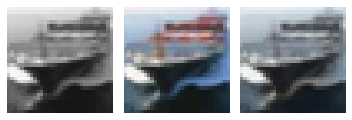

2020-11-08 11:35:57.919 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


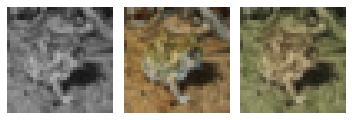

2020-11-08 11:35:58.053 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


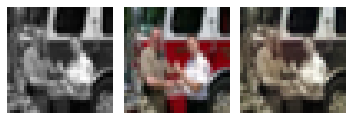

EPOCH: 16.250	trn_loss: 0.004	(1431.61s - 7378.28s remaining)

2020-11-08 11:36:18.348 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 16.255	trn_loss: 0.004	(1432.01s - 7377.60s remaining)

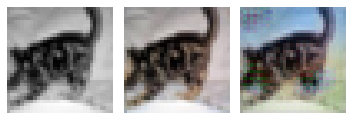

2020-11-08 11:36:18.464 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


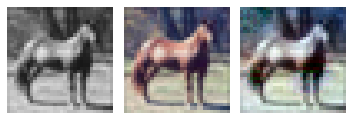

2020-11-08 11:36:18.648 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


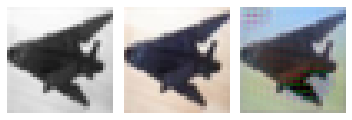

2020-11-08 11:36:18.776 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


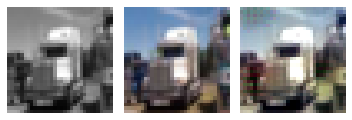

2020-11-08 11:36:18.914 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


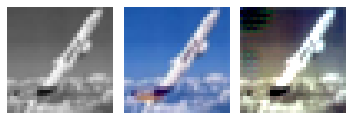

EPOCH: 16.505	trn_loss: 0.004	(1452.41s - 7347.35s remaining)

2020-11-08 11:36:39.150 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 16.510	trn_loss: 0.005	(1452.81s - 7346.68s remaining)

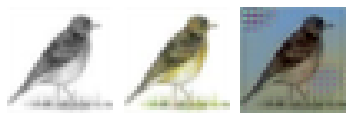

2020-11-08 11:36:39.271 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


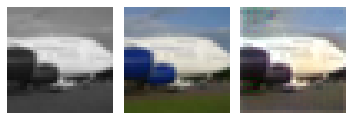

2020-11-08 11:36:39.398 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


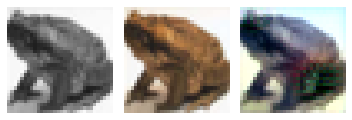

2020-11-08 11:36:39.585 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


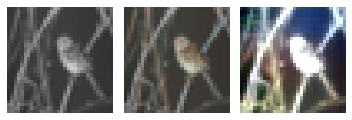

2020-11-08 11:36:39.712 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


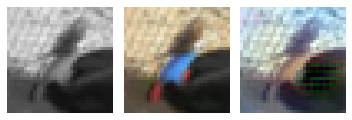

EPOCH: 16.760	trn_loss: 0.005	(1473.20s - 7316.68s remaining)

2020-11-08 11:36:59.937 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 16.765	trn_loss: 0.005	(1473.60s - 7315.98s remaining)

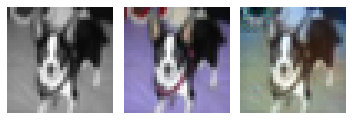

2020-11-08 11:37:00.065 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


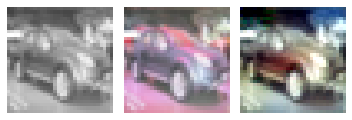

2020-11-08 11:37:00.205 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


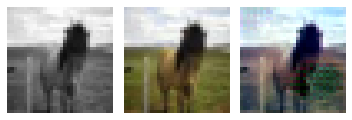

2020-11-08 11:37:00.340 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


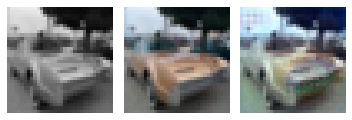

2020-11-08 11:37:00.524 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


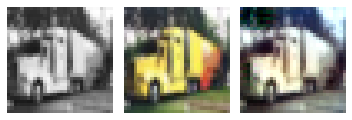

EPOCH: 16.950	val_loss: 0.005	(1498.73s - 7343.33s remaining)

2020-11-08 11:37:25.257 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 17.000	val_loss: 0.003	(1498.92s - 7318.27s remaining)

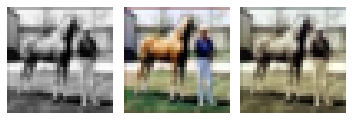

2020-11-08 11:37:25.380 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


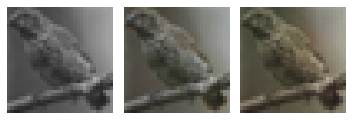

2020-11-08 11:37:25.502 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


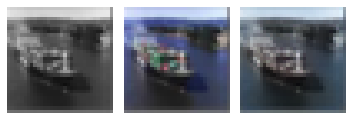

2020-11-08 11:37:25.628 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


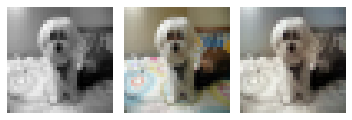

2020-11-08 11:37:25.764 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


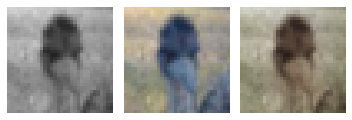

EPOCH: 17.250	trn_loss: 0.004	(1519.26s - 7288.05s remaining)

2020-11-08 11:37:45.994 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 17.255	trn_loss: 0.005	(1519.66s - 7287.34s remaining)

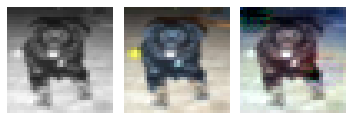

2020-11-08 11:37:46.118 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


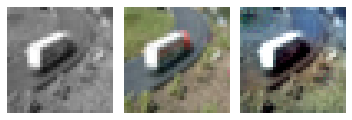

2020-11-08 11:37:46.259 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


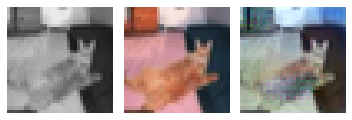

2020-11-08 11:37:46.385 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


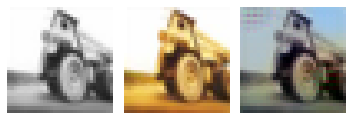

2020-11-08 11:37:46.514 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


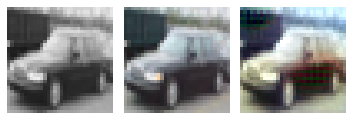

EPOCH: 17.505	trn_loss: 0.004	(1540.02s - 7257.52s remaining)

2020-11-08 11:38:06.752 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 17.510	trn_loss: 0.005	(1540.42s - 7256.83s remaining)

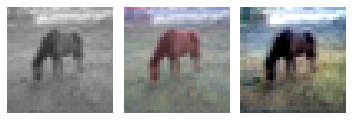

2020-11-08 11:38:06.869 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


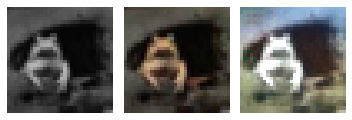

2020-11-08 11:38:06.996 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


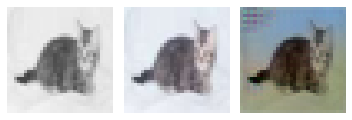

2020-11-08 11:38:07.132 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


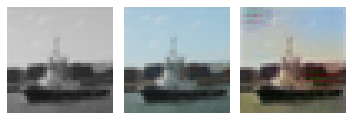

2020-11-08 11:38:07.253 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


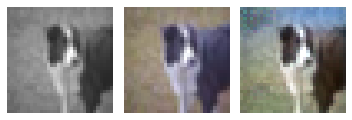

EPOCH: 17.760	trn_loss: 0.004	(1560.74s - 7227.09s remaining)

2020-11-08 11:38:27.467 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 17.765	trn_loss: 0.004	(1561.13s - 7226.40s remaining)

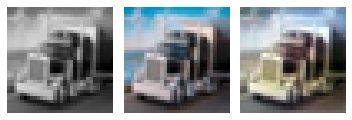

2020-11-08 11:38:27.586 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


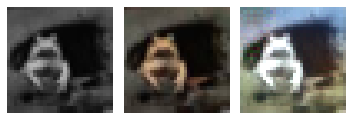

2020-11-08 11:38:27.768 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


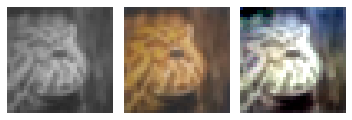

2020-11-08 11:38:27.897 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


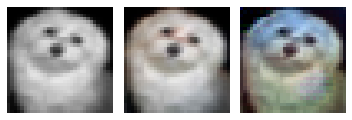

2020-11-08 11:38:28.027 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


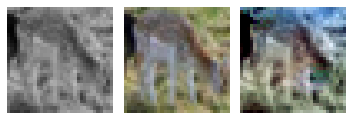

EPOCH: 17.950	val_loss: 0.005	(1586.32s - 7251.10s remaining)

2020-11-08 11:38:52.832 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 18.000	val_loss: 0.003	(1586.50s - 7227.38s remaining)

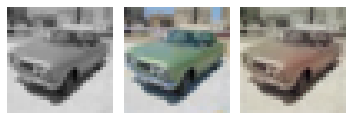

2020-11-08 11:38:52.945 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


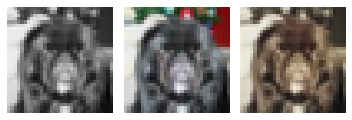

2020-11-08 11:38:53.071 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


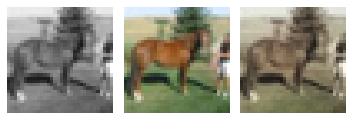

2020-11-08 11:38:53.258 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


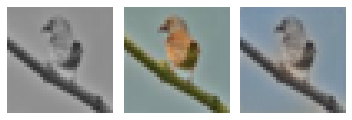

2020-11-08 11:38:53.380 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


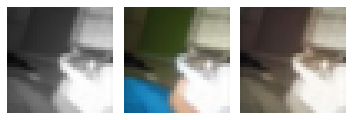

EPOCH: 18.250	trn_loss: 0.004	(1606.84s - 7197.78s remaining)

2020-11-08 11:39:13.590 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 18.255	trn_loss: 0.005	(1607.25s - 7197.15s remaining)

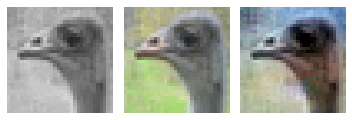

2020-11-08 11:39:13.725 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


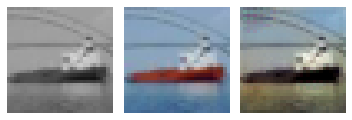

2020-11-08 11:39:13.866 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


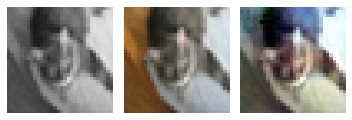

2020-11-08 11:39:14.004 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


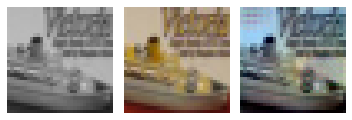

2020-11-08 11:39:14.194 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


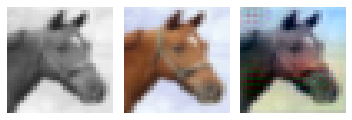

EPOCH: 18.505	trn_loss: 0.005	(1627.69s - 7168.22s remaining)

2020-11-08 11:39:34.443 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 18.510	trn_loss: 0.005	(1628.11s - 7167.62s remaining)

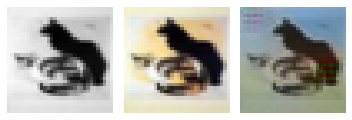

2020-11-08 11:39:34.566 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


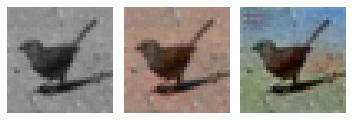

2020-11-08 11:39:34.706 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


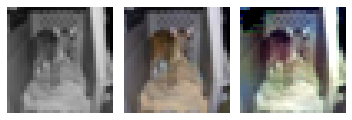

2020-11-08 11:39:34.834 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


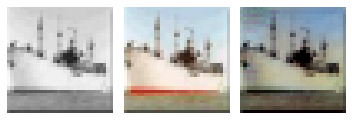

2020-11-08 11:39:34.966 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


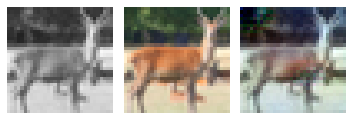

EPOCH: 18.760	trn_loss: 0.005	(1648.52s - 7138.79s remaining)

2020-11-08 11:39:55.253 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 18.765	trn_loss: 0.005	(1648.92s - 7138.13s remaining)

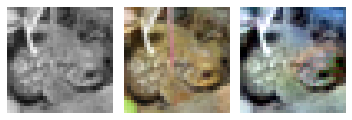

2020-11-08 11:39:55.385 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


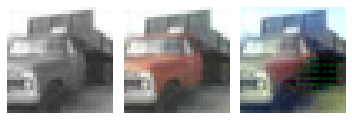

2020-11-08 11:39:55.526 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


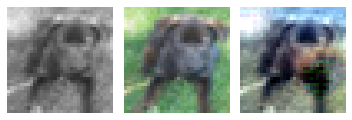

2020-11-08 11:39:55.663 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


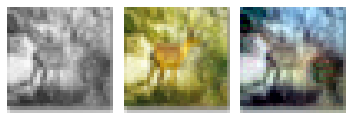

2020-11-08 11:39:55.800 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


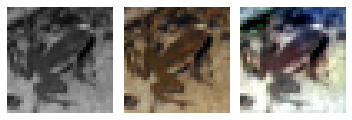

EPOCH: 18.950	val_loss: 0.005	(1674.05s - 7159.99s remaining)

2020-11-08 11:40:20.568 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 19.000	val_loss: 0.003	(1674.23s - 7137.52s remaining)

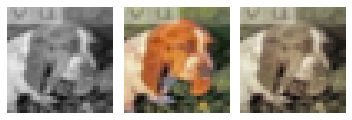

2020-11-08 11:40:20.689 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


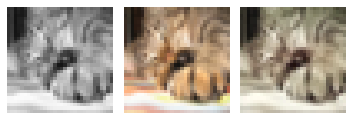

2020-11-08 11:40:20.816 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


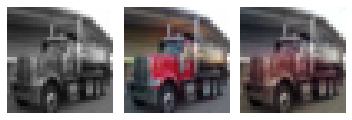

2020-11-08 11:40:20.942 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


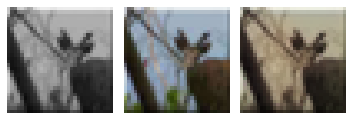

2020-11-08 11:40:21.068 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


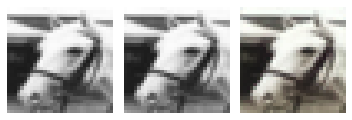

EPOCH: 19.250	trn_loss: 0.005	(1694.63s - 7108.62s remaining)

2020-11-08 11:40:41.362 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 19.255	trn_loss: 0.004	(1695.03s - 7107.97s remaining)

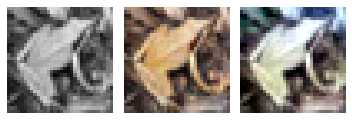

2020-11-08 11:40:41.483 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


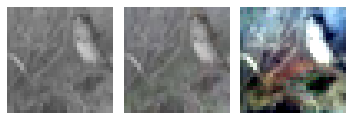

2020-11-08 11:40:41.612 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


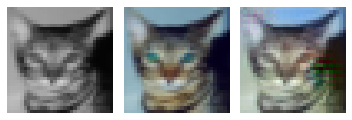

2020-11-08 11:40:41.742 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


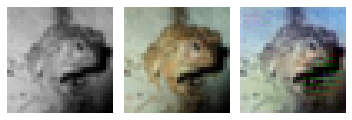

2020-11-08 11:40:41.881 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


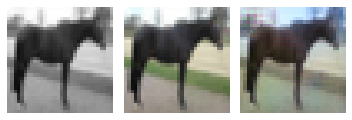

EPOCH: 19.505	trn_loss: 0.005	(1715.38s - 7079.15s remaining)

2020-11-08 11:41:02.118 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 19.510	trn_loss: 0.005	(1715.78s - 7078.50s remaining)

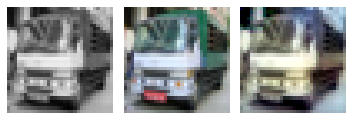

2020-11-08 11:41:02.242 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


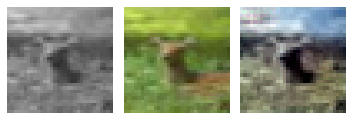

2020-11-08 11:41:02.426 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


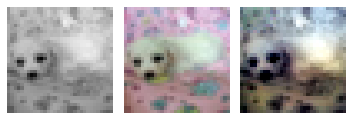

2020-11-08 11:41:02.554 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


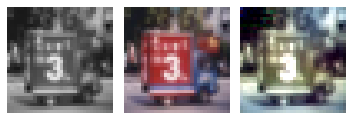

2020-11-08 11:41:02.685 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


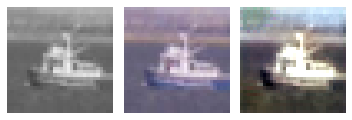

EPOCH: 19.760	trn_loss: 0.004	(1736.17s - 7050.02s remaining)

2020-11-08 11:41:22.901 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 19.765	trn_loss: 0.004	(1736.57s - 7049.36s remaining)

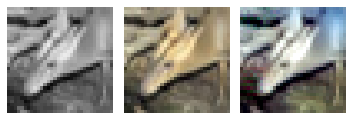

2020-11-08 11:41:23.020 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


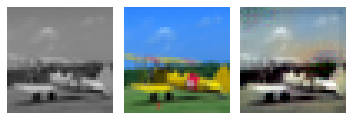

2020-11-08 11:41:23.160 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


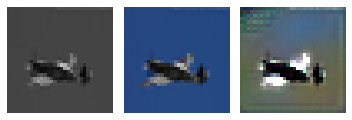

2020-11-08 11:41:23.343 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


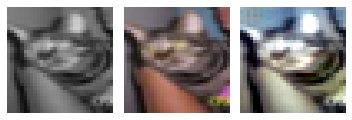

2020-11-08 11:41:23.472 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


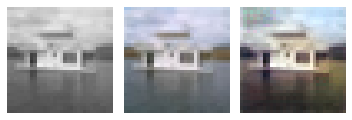

EPOCH: 19.950	val_loss: 0.005	(1761.72s - 7068.94s remaining)

2020-11-08 11:41:48.235 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 20.000	trn_loss: 0.005	val_loss: 0.005	(1761.90s - 7047.60s remaining)


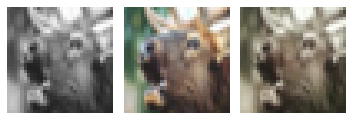

2020-11-08 11:41:48.354 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


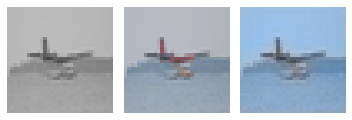

2020-11-08 11:41:48.477 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


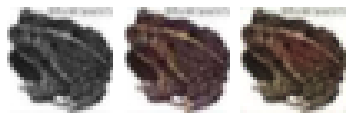

2020-11-08 11:41:48.611 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


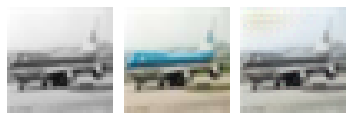

2020-11-08 11:41:48.788 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


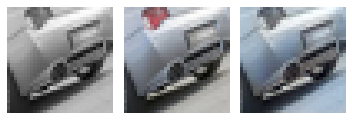

EPOCH: 20.250	trn_loss: 0.004	(1782.36s - 7019.42s remaining)

2020-11-08 11:42:09.092 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 20.255	trn_loss: 0.004	(1782.76s - 7018.76s remaining)

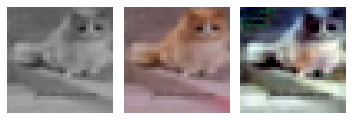

2020-11-08 11:42:09.215 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


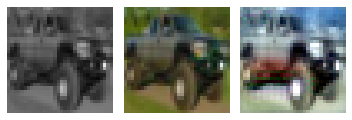

2020-11-08 11:42:09.346 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


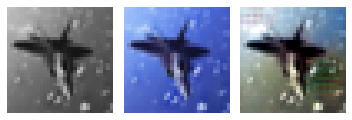

2020-11-08 11:42:09.480 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


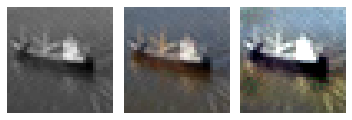

2020-11-08 11:42:09.608 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


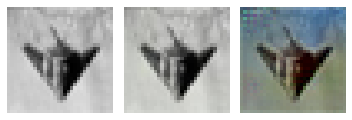

EPOCH: 20.505	trn_loss: 0.005	(1803.19s - 6990.66s remaining)

2020-11-08 11:42:29.917 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 20.510	trn_loss: 0.005	(1803.58s - 6990.00s remaining)

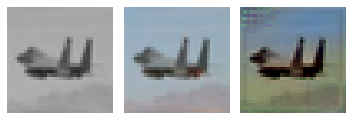

2020-11-08 11:42:30.041 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


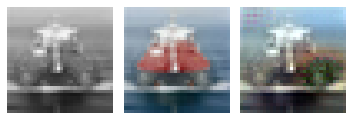

2020-11-08 11:42:30.171 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


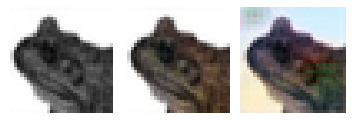

2020-11-08 11:42:30.297 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


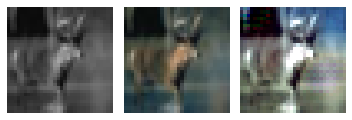

2020-11-08 11:42:30.429 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


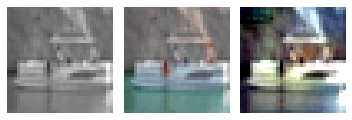

EPOCH: 20.760	trn_loss: 0.005	(1824.01s - 6962.08s remaining)

2020-11-08 11:42:50.744 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 20.765	trn_loss: 0.004	(1824.41s - 6961.44s remaining)

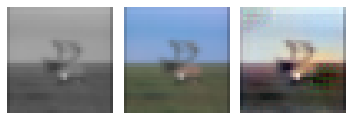

2020-11-08 11:42:50.868 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


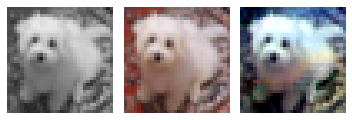

2020-11-08 11:42:51.004 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


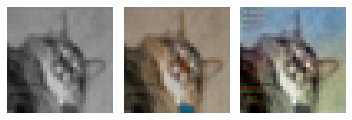

2020-11-08 11:42:51.141 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


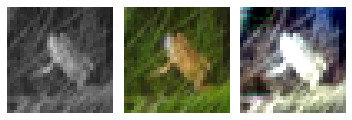

2020-11-08 11:42:51.267 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


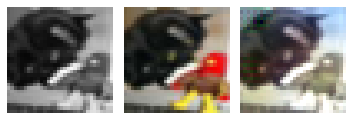

EPOCH: 20.925	val_loss: 0.004	(1849.37s - 6988.70s remaining)

2020-11-08 11:43:16.066 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 21.000	val_loss: 0.003	(1849.73s - 6958.51s remaining)

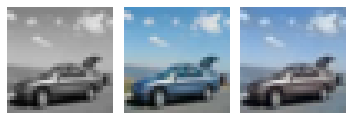

2020-11-08 11:43:16.182 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


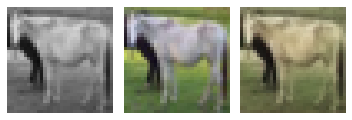

2020-11-08 11:43:16.307 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


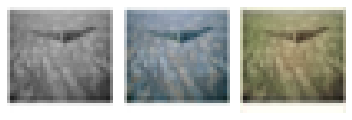

2020-11-08 11:43:16.435 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


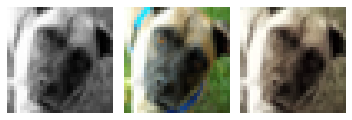

2020-11-08 11:43:16.564 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


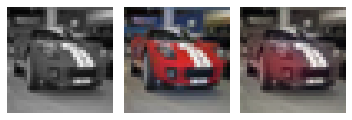

EPOCH: 21.250	trn_loss: 0.004	(1869.99s - 6929.97s remaining)

2020-11-08 11:43:36.732 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 21.255	trn_loss: 0.005	(1870.40s - 6929.36s remaining)

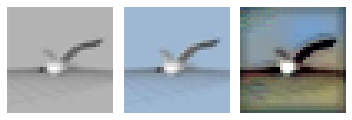

2020-11-08 11:43:36.853 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


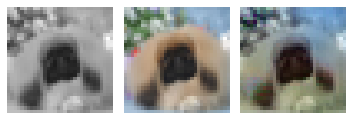

2020-11-08 11:43:37.040 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


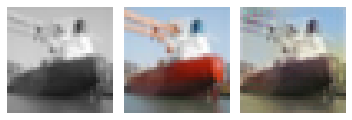

2020-11-08 11:43:37.171 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


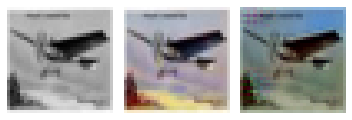

2020-11-08 11:43:37.298 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


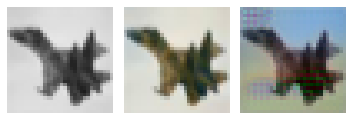

EPOCH: 21.505	trn_loss: 0.004	(1890.78s - 6901.46s remaining)

2020-11-08 11:43:57.521 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 21.510	trn_loss: 0.004	(1891.19s - 6900.85s remaining)

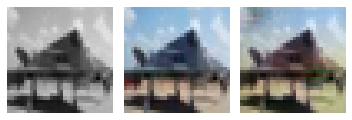

2020-11-08 11:43:57.640 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


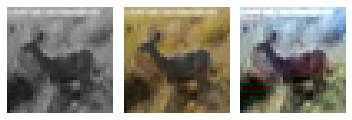

2020-11-08 11:43:57.771 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


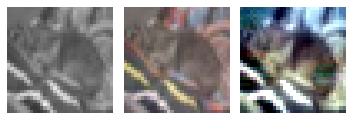

2020-11-08 11:43:57.955 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


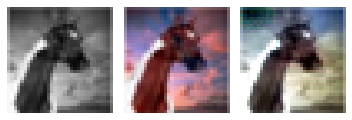

2020-11-08 11:43:58.085 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


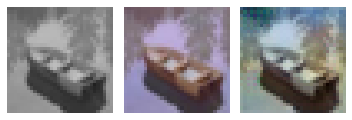

EPOCH: 21.760	trn_loss: 0.005	(1911.65s - 6873.41s remaining)

2020-11-08 11:44:18.375 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 21.765	trn_loss: 0.004	(1912.04s - 6872.76s remaining)

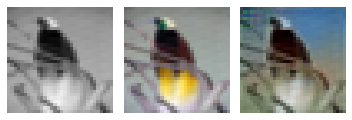

2020-11-08 11:44:18.495 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


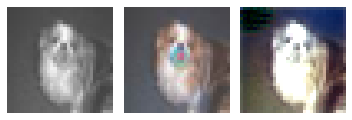

2020-11-08 11:44:18.629 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


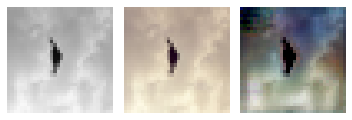

2020-11-08 11:44:18.764 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


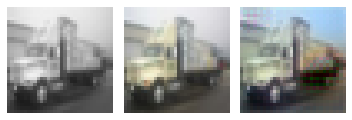

2020-11-08 11:44:18.951 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


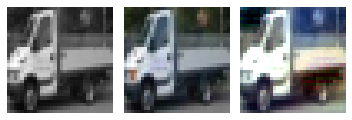

EPOCH: 21.950	val_loss: 0.005	(1937.18s - 6888.25s remaining)

2020-11-08 11:44:43.715 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 22.000	val_loss: 0.003	(1937.38s - 6868.89s remaining)

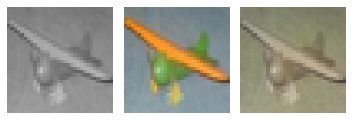

2020-11-08 11:44:43.830 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


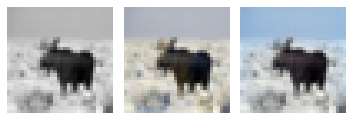

2020-11-08 11:44:43.956 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


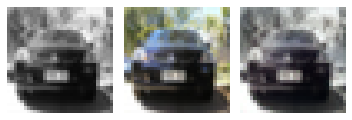

2020-11-08 11:44:44.094 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


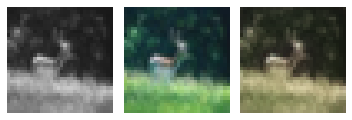

2020-11-08 11:44:44.219 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


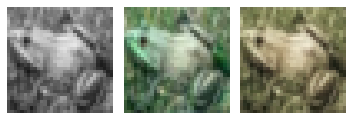

EPOCH: 22.250	trn_loss: 0.004	(1957.64s - 6840.76s remaining)

2020-11-08 11:45:04.381 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 22.255	trn_loss: 0.005	(1958.05s - 6840.14s remaining)

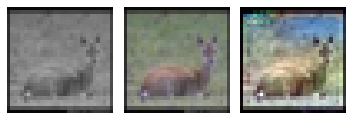

2020-11-08 11:45:04.511 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


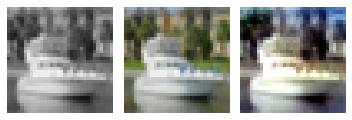

2020-11-08 11:45:04.642 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


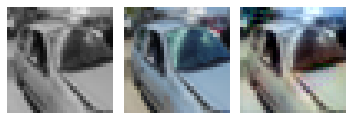

2020-11-08 11:45:04.772 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


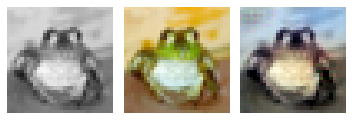

2020-11-08 11:45:04.911 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


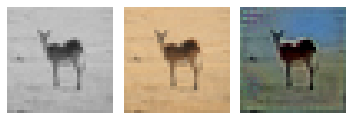

EPOCH: 22.505	trn_loss: 0.004	(1978.40s - 6812.50s remaining)

2020-11-08 11:45:25.138 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 22.510	trn_loss: 0.005	(1978.80s - 6811.88s remaining)

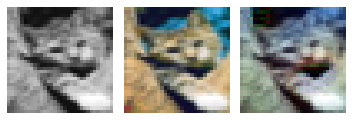

2020-11-08 11:45:25.264 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


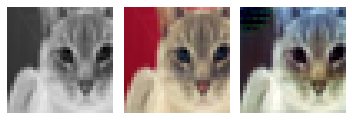

2020-11-08 11:45:25.393 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


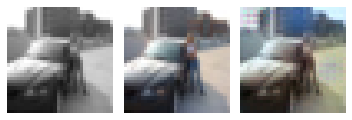

2020-11-08 11:45:25.521 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


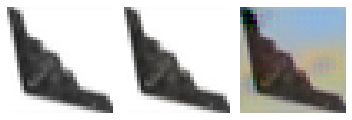

2020-11-08 11:45:25.656 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


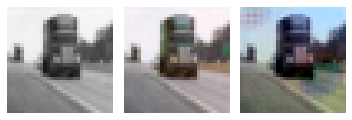

EPOCH: 22.760	trn_loss: 0.005	(1999.17s - 6784.46s remaining)

2020-11-08 11:45:45.908 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 22.765	trn_loss: 0.004	(1999.57s - 6783.85s remaining)

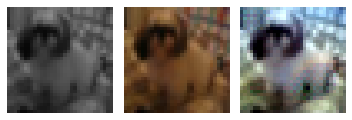

2020-11-08 11:45:46.029 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


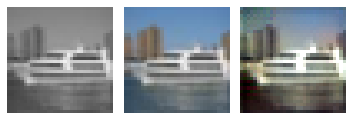

2020-11-08 11:45:46.217 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


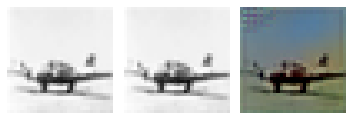

2020-11-08 11:45:46.350 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


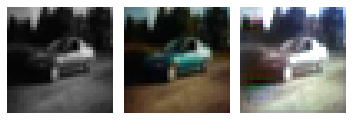

2020-11-08 11:45:46.475 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


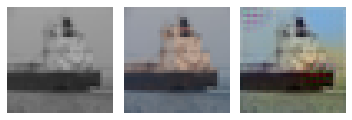

EPOCH: 22.950	val_loss: 0.005	(2024.77s - 6797.76s remaining)

2020-11-08 11:46:11.285 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 23.000	val_loss: 0.003	(2024.95s - 6779.18s remaining)

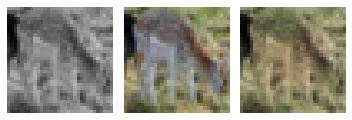

2020-11-08 11:46:11.406 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


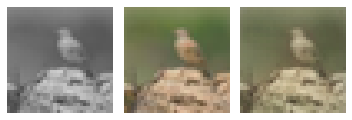

2020-11-08 11:46:11.531 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


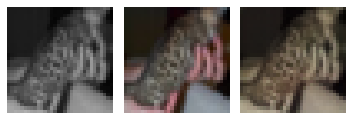

2020-11-08 11:46:11.721 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


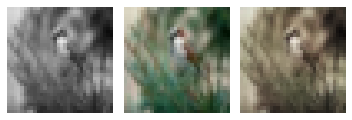

2020-11-08 11:46:11.843 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


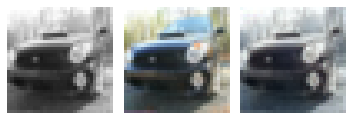

EPOCH: 23.250	trn_loss: 0.005	(2045.26s - 6751.56s remaining)

2020-11-08 11:46:31.993 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 23.255	trn_loss: 0.005	(2045.66s - 6750.94s remaining)

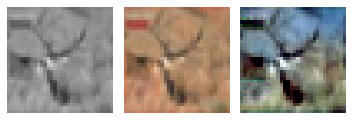

2020-11-08 11:46:32.111 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


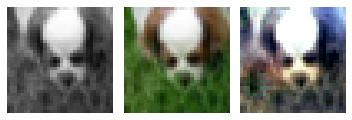

2020-11-08 11:46:32.243 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


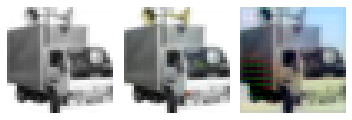

2020-11-08 11:46:32.375 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


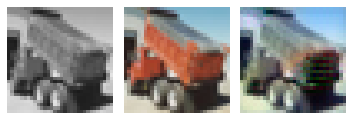

2020-11-08 11:46:32.561 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


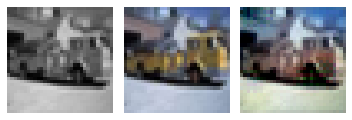

EPOCH: 23.505	trn_loss: 0.004	(2066.08s - 6723.84s remaining)

2020-11-08 11:46:52.815 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 23.510	trn_loss: 0.004	(2066.48s - 6723.23s remaining)

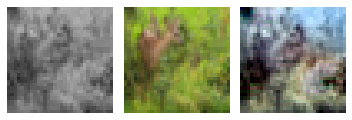

2020-11-08 11:46:52.932 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


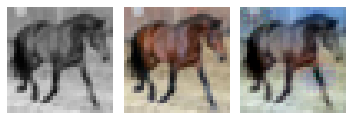

2020-11-08 11:46:53.061 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


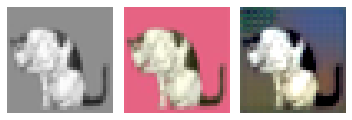

2020-11-08 11:46:53.206 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


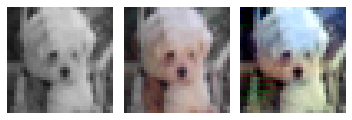

2020-11-08 11:46:53.334 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


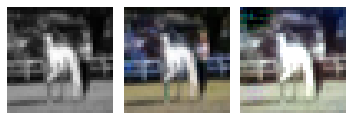

EPOCH: 23.760	trn_loss: 0.005	(2086.94s - 6696.42s remaining)

2020-11-08 11:47:13.688 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 23.765	trn_loss: 0.004	(2087.35s - 6695.83s remaining)

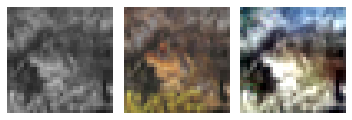

2020-11-08 11:47:13.838 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


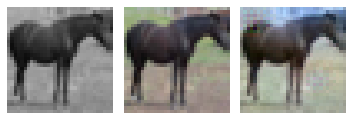

2020-11-08 11:47:13.983 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


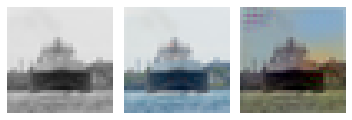

2020-11-08 11:47:14.144 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


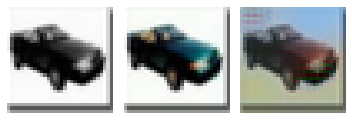

2020-11-08 11:47:14.274 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


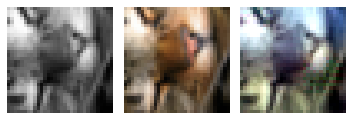

EPOCH: 23.950	val_loss: 0.005	(2112.60s - 6708.27s remaining)

2020-11-08 11:47:39.119 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 24.000	val_loss: 0.003	(2112.78s - 6690.48s remaining)

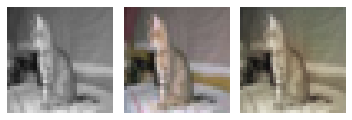

2020-11-08 11:47:39.235 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


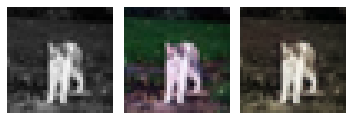

2020-11-08 11:47:39.365 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


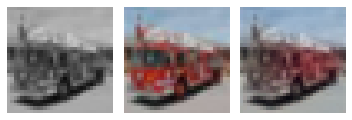

2020-11-08 11:47:39.488 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


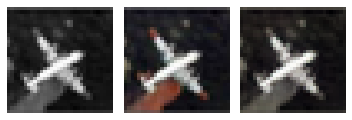

2020-11-08 11:47:39.621 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


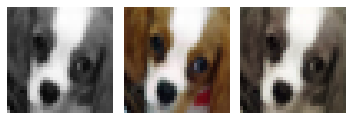

EPOCH: 24.250	trn_loss: 0.004	(2133.12s - 6663.25s remaining)

2020-11-08 11:47:59.859 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 24.255	trn_loss: 0.004	(2133.52s - 6662.65s remaining)

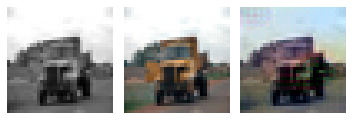

2020-11-08 11:47:59.979 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


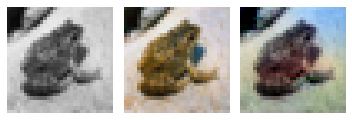

2020-11-08 11:48:00.113 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


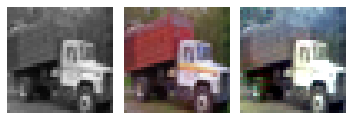

2020-11-08 11:48:00.242 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


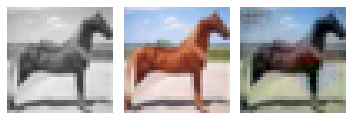

2020-11-08 11:48:00.373 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


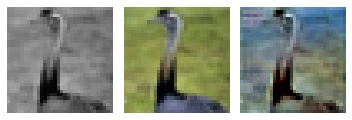

EPOCH: 24.505	trn_loss: 0.004	(2153.93s - 6635.80s remaining)

2020-11-08 11:48:20.677 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 24.510	trn_loss: 0.005	(2154.34s - 6635.23s remaining)

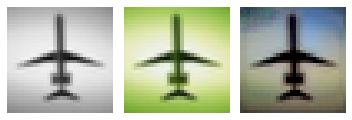

2020-11-08 11:48:20.800 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


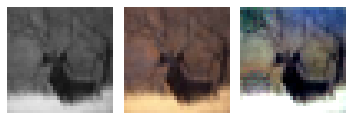

2020-11-08 11:48:20.983 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


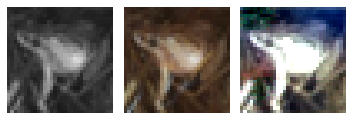

2020-11-08 11:48:21.120 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


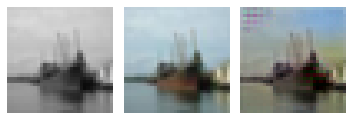

2020-11-08 11:48:21.247 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


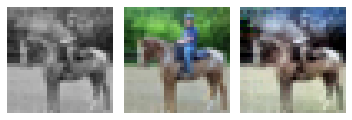

EPOCH: 24.760	trn_loss: 0.004	(2174.88s - 6608.90s remaining)

2020-11-08 11:48:41.611 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 24.765	trn_loss: 0.005	(2175.28s - 6608.29s remaining)

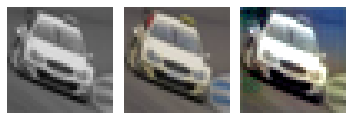

2020-11-08 11:48:41.732 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


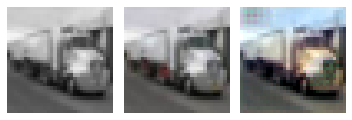

2020-11-08 11:48:41.860 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


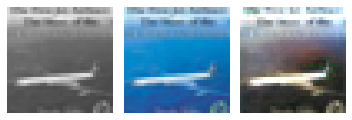

2020-11-08 11:48:42.044 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


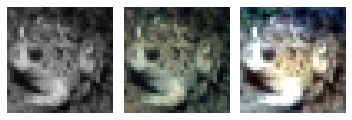

2020-11-08 11:48:42.189 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


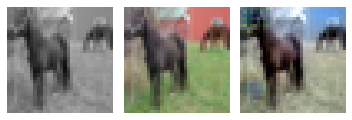

EPOCH: 24.950	val_loss: 0.005	(2200.69s - 6619.70s remaining)

2020-11-08 11:49:07.210 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 25.000	trn_loss: 0.004	val_loss: 0.005	(2200.87s - 6602.62s remaining)


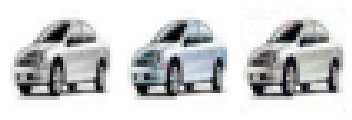

2020-11-08 11:49:07.333 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


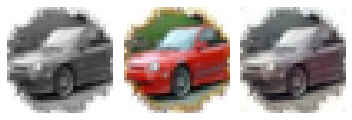

2020-11-08 11:49:07.463 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


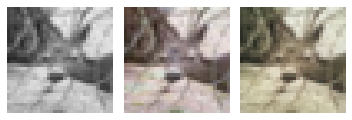

2020-11-08 11:49:07.588 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


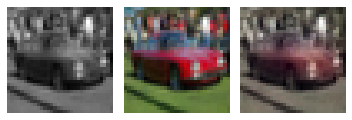

2020-11-08 11:49:07.777 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


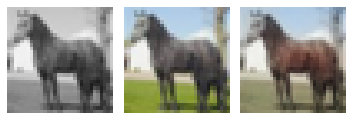

EPOCH: 25.250	trn_loss: 0.004	(2221.34s - 6576.06s remaining)

2020-11-08 11:49:28.099 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 25.255	trn_loss: 0.004	(2221.76s - 6575.52s remaining)

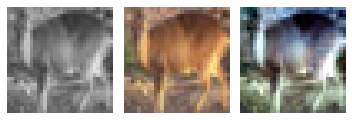

2020-11-08 11:49:28.227 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


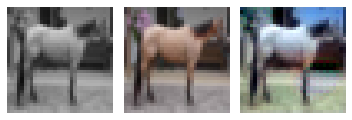

2020-11-08 11:49:28.362 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


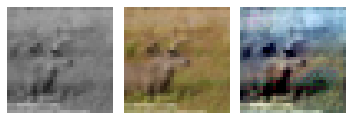

2020-11-08 11:49:28.492 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


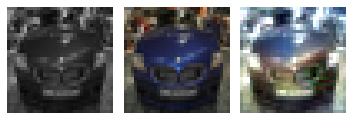

2020-11-08 11:49:28.622 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


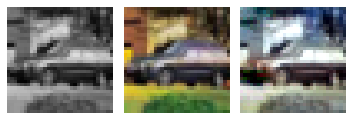

EPOCH: 25.505	trn_loss: 0.004	(2242.34s - 6549.38s remaining)

2020-11-08 11:49:49.081 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 25.510	trn_loss: 0.005	(2242.74s - 6548.81s remaining)

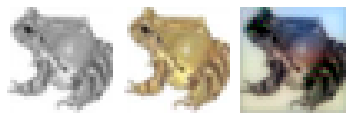

2020-11-08 11:49:49.211 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


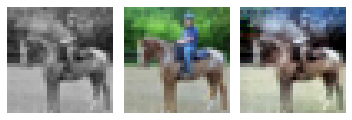

2020-11-08 11:49:49.342 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


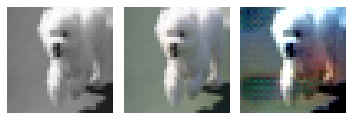

2020-11-08 11:49:49.472 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


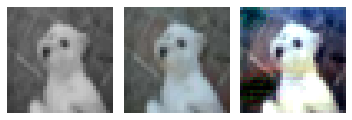

2020-11-08 11:49:49.603 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


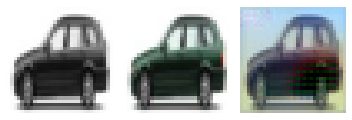

EPOCH: 25.760	trn_loss: 0.005	(2263.29s - 6522.72s remaining)

2020-11-08 11:50:10.033 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 25.765	trn_loss: 0.004	(2263.70s - 6522.14s remaining)

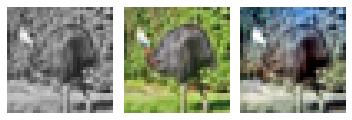

2020-11-08 11:50:10.158 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


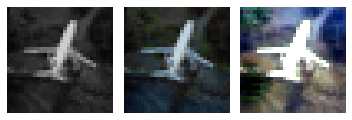

2020-11-08 11:50:10.288 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


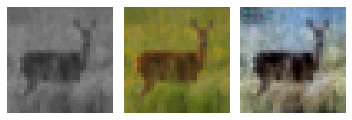

2020-11-08 11:50:10.431 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


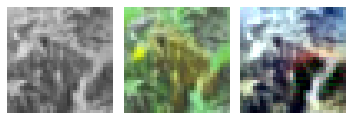

2020-11-08 11:50:10.558 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


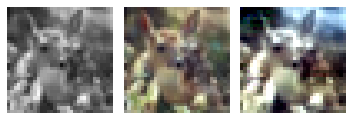

EPOCH: 25.925	val_loss: 0.004	(2288.98s - 6540.26s remaining)

2020-11-08 11:50:35.657 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 26.000	val_loss: 0.003	(2289.32s - 6515.76s remaining)

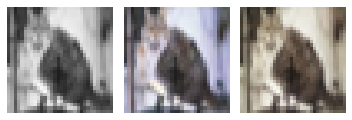

2020-11-08 11:50:35.800 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


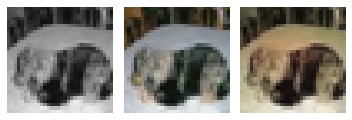

2020-11-08 11:50:35.933 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


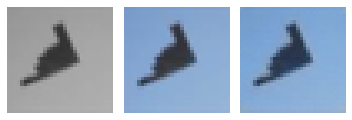

2020-11-08 11:50:36.070 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


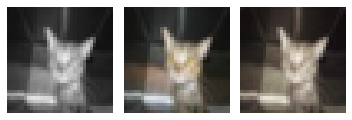

2020-11-08 11:50:36.200 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


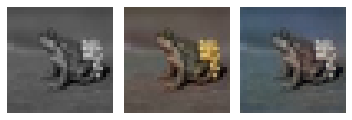

EPOCH: 26.250	trn_loss: 0.005	(2309.85s - 6489.57s remaining)

2020-11-08 11:50:56.588 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 26.255	trn_loss: 0.005	(2310.25s - 6489.00s remaining)

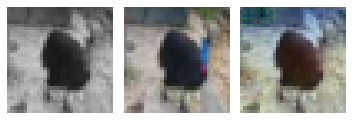

2020-11-08 11:50:56.716 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


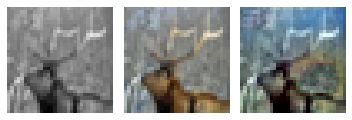

2020-11-08 11:50:56.908 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


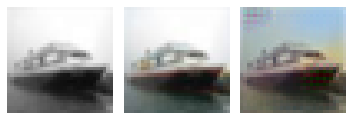

2020-11-08 11:50:57.051 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


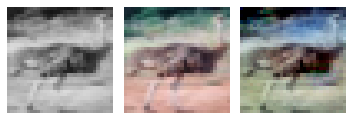

2020-11-08 11:50:57.194 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


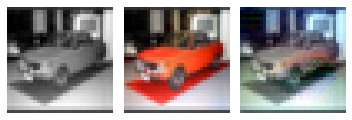

EPOCH: 26.505	trn_loss: 0.005	(2330.91s - 6463.27s remaining)

2020-11-08 11:51:17.647 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 26.510	trn_loss: 0.004	(2331.31s - 6462.70s remaining)

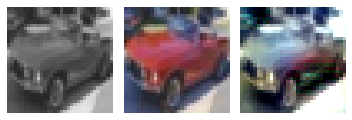

2020-11-08 11:51:17.777 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


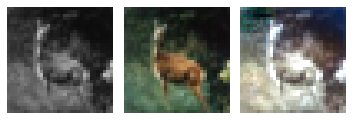

2020-11-08 11:51:17.909 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


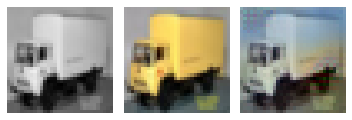

2020-11-08 11:51:18.098 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


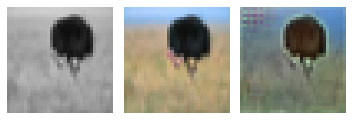

2020-11-08 11:51:18.236 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


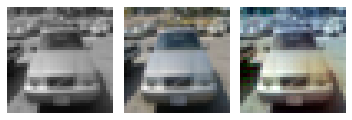

EPOCH: 26.760	trn_loss: 0.004	(2351.85s - 6436.77s remaining)

2020-11-08 11:51:38.591 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 26.765	trn_loss: 0.005	(2352.25s - 6436.19s remaining)

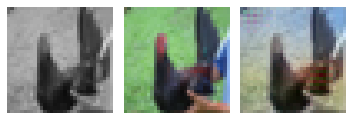

2020-11-08 11:51:38.717 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


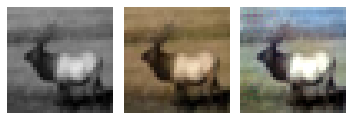

2020-11-08 11:51:38.849 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


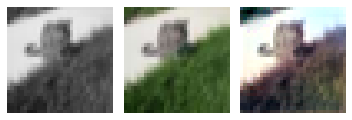

2020-11-08 11:51:38.976 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


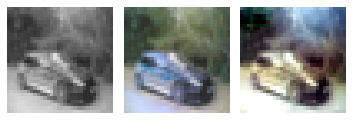

2020-11-08 11:51:39.172 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


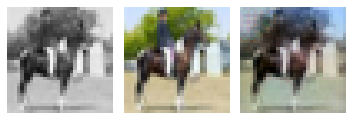

EPOCH: 26.950	val_loss: 0.005	(2377.52s - 6444.45s remaining)

2020-11-08 11:52:04.043 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 27.000	val_loss: 0.003	(2377.71s - 6428.62s remaining)

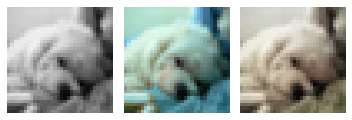

2020-11-08 11:52:04.164 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


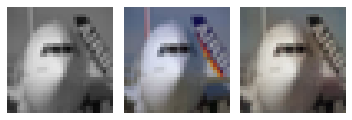

2020-11-08 11:52:04.301 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


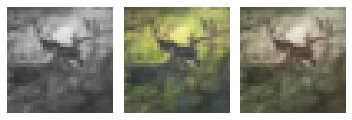

2020-11-08 11:52:04.435 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


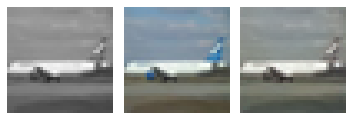

2020-11-08 11:52:04.572 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


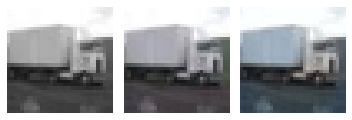

EPOCH: 27.250	trn_loss: 0.005	(2398.10s - 6402.26s remaining)

2020-11-08 11:52:24.854 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 27.255	trn_loss: 0.005	(2398.52s - 6401.73s remaining)

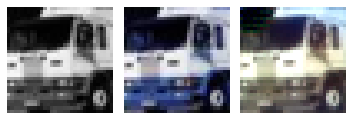

2020-11-08 11:52:24.997 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


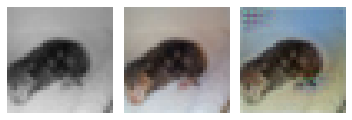

2020-11-08 11:52:25.149 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


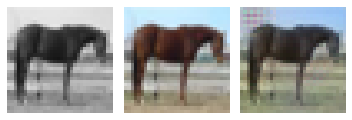

2020-11-08 11:52:25.277 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


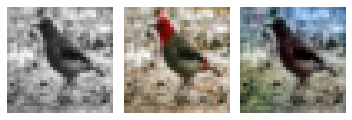

2020-11-08 11:52:25.408 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


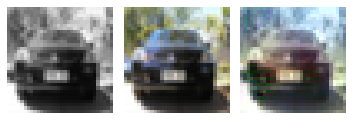

EPOCH: 27.505	trn_loss: 0.004	(2419.03s - 6375.80s remaining)

2020-11-08 11:52:45.760 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 27.510	trn_loss: 0.005	(2419.42s - 6375.22s remaining)

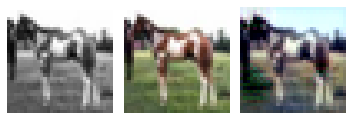

2020-11-08 11:52:45.885 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


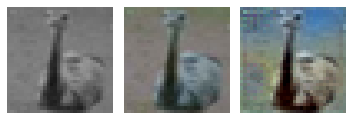

2020-11-08 11:52:46.016 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


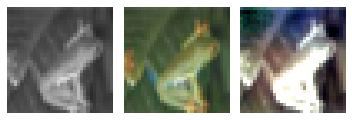

2020-11-08 11:52:46.169 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


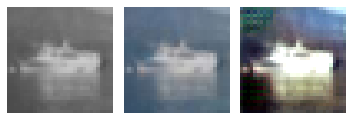

2020-11-08 11:52:46.297 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


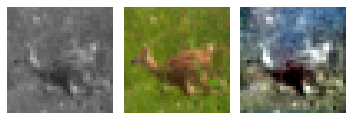

EPOCH: 27.760	trn_loss: 0.005	(2439.70s - 6348.78s remaining)

2020-11-08 11:53:06.436 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 27.765	trn_loss: 0.005	(2440.10s - 6348.20s remaining)

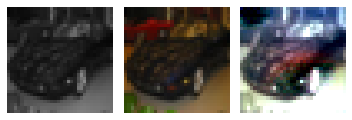

2020-11-08 11:53:06.565 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


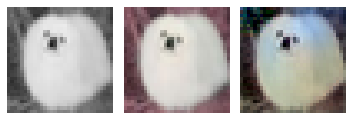

2020-11-08 11:53:06.754 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


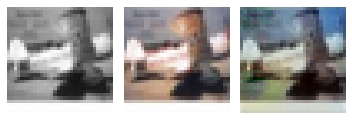

2020-11-08 11:53:06.882 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


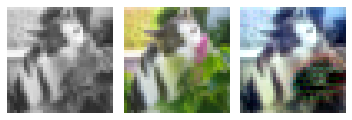

2020-11-08 11:53:07.017 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


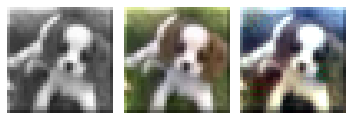

EPOCH: 27.950	val_loss: 0.005	(2465.11s - 6354.61s remaining)

2020-11-08 11:53:31.630 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 28.000	val_loss: 0.003	(2465.30s - 6339.33s remaining)

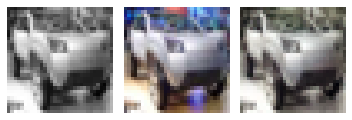

2020-11-08 11:53:31.754 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


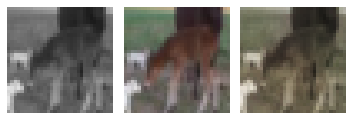

2020-11-08 11:53:31.896 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


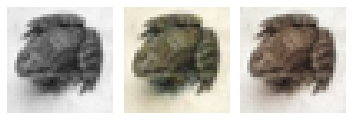

2020-11-08 11:53:32.083 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


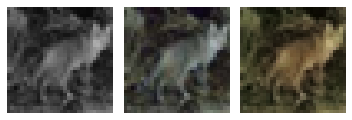

2020-11-08 11:53:32.222 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


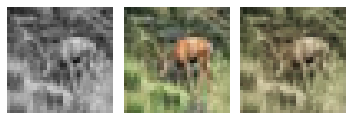

EPOCH: 28.250	trn_loss: 0.005	(2485.64s - 6313.08s remaining)

2020-11-08 11:53:52.369 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 28.255	trn_loss: 0.004	(2486.03s - 6312.50s remaining)

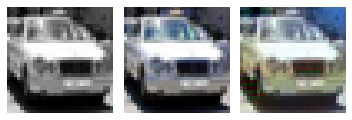

2020-11-08 11:53:52.500 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


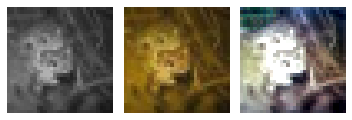

2020-11-08 11:53:52.636 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


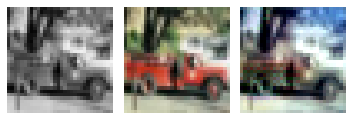

2020-11-08 11:53:52.770 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


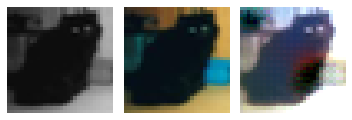

2020-11-08 11:53:52.975 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


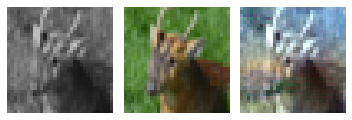

EPOCH: 28.505	trn_loss: 0.004	(2506.43s - 6286.49s remaining)

2020-11-08 11:54:13.173 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 28.510	trn_loss: 0.005	(2506.84s - 6285.94s remaining)

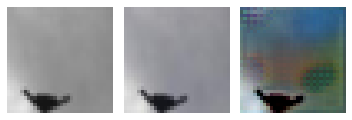

2020-11-08 11:54:13.302 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


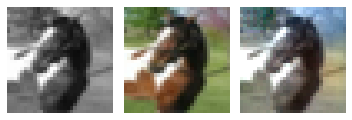

2020-11-08 11:54:13.431 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


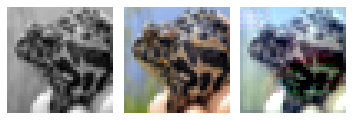

2020-11-08 11:54:13.564 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


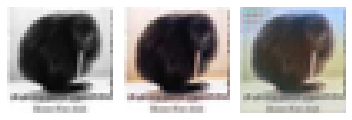

2020-11-08 11:54:13.695 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


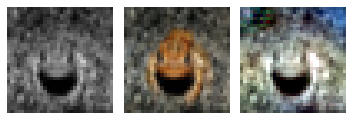

EPOCH: 28.760	trn_loss: 0.004	(2526.96s - 6259.34s remaining)

2020-11-08 11:54:33.689 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 28.765	trn_loss: 0.004	(2527.35s - 6258.76s remaining)

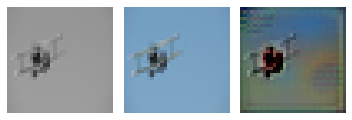

2020-11-08 11:54:33.812 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


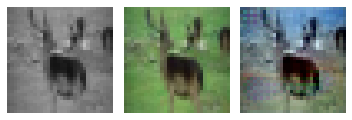

2020-11-08 11:54:33.942 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


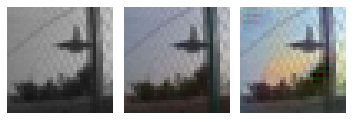

2020-11-08 11:54:34.079 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


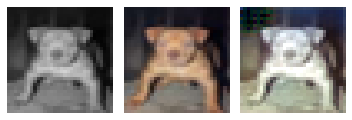

2020-11-08 11:54:34.216 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


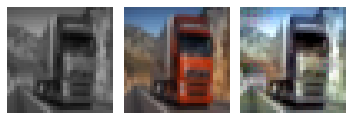

EPOCH: 28.950	val_loss: 0.005	(2552.40s - 6264.18s remaining)

2020-11-08 11:54:58.919 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 29.000	val_loss: 0.003	(2552.59s - 6249.43s remaining)

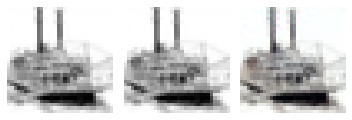

2020-11-08 11:54:59.038 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


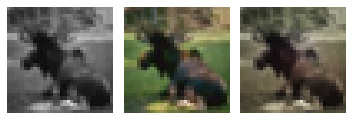

2020-11-08 11:54:59.165 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


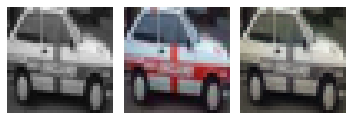

2020-11-08 11:54:59.292 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


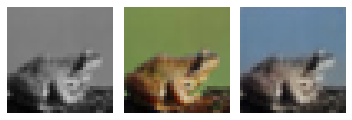

2020-11-08 11:54:59.415 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


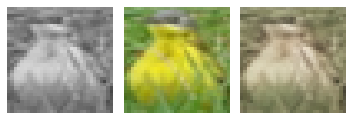

EPOCH: 29.250	trn_loss: 0.004	(2572.80s - 6223.11s remaining)

2020-11-08 11:55:19.539 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 29.255	trn_loss: 0.005	(2573.20s - 6222.54s remaining)

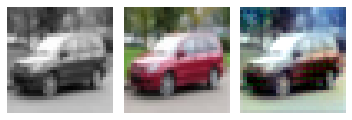

2020-11-08 11:55:19.667 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


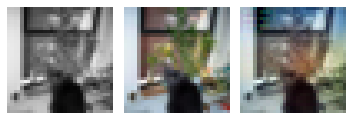

2020-11-08 11:55:19.800 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


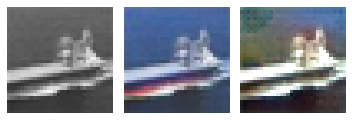

2020-11-08 11:55:19.929 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


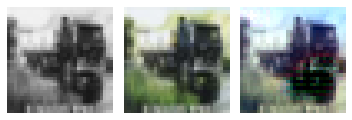

2020-11-08 11:55:20.066 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


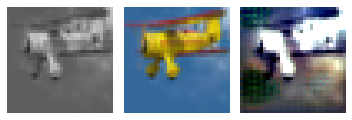

EPOCH: 29.505	trn_loss: 0.004	(2593.42s - 6196.32s remaining)

2020-11-08 11:55:40.155 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 29.510	trn_loss: 0.004	(2593.82s - 6195.75s remaining)

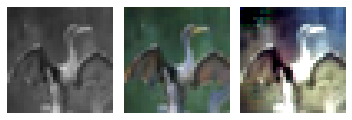

2020-11-08 11:55:40.280 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


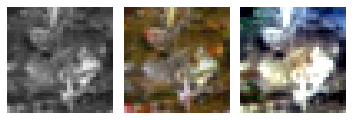

2020-11-08 11:55:40.482 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


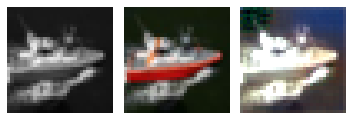

2020-11-08 11:55:40.611 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


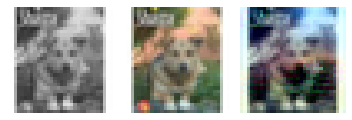

2020-11-08 11:55:40.742 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


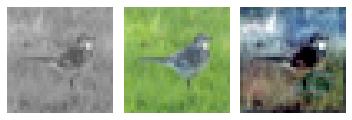

EPOCH: 29.760	trn_loss: 0.004	(2614.12s - 6169.82s remaining)

2020-11-08 11:56:00.853 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 29.765	trn_loss: 0.005	(2614.52s - 6169.26s remaining)

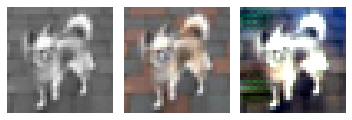

2020-11-08 11:56:00.982 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


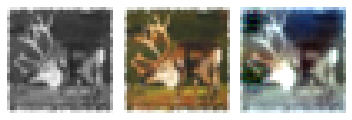

2020-11-08 11:56:01.117 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


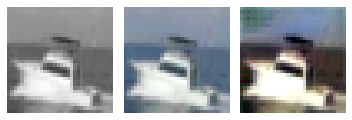

2020-11-08 11:56:01.304 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


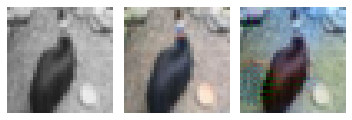

2020-11-08 11:56:01.435 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


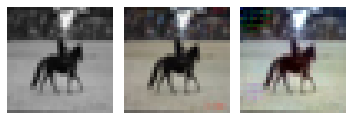

EPOCH: 29.950	val_loss: 0.005	(2639.41s - 6173.31s remaining)

2020-11-08 11:56:25.931 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 30.000	trn_loss: 0.004	val_loss: 0.005	(2639.60s - 6159.06s remaining)


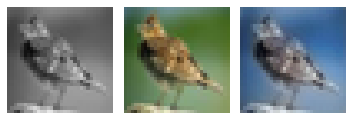

2020-11-08 11:56:26.047 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


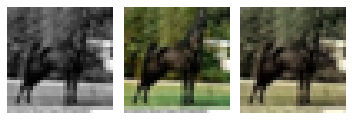

2020-11-08 11:56:26.175 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


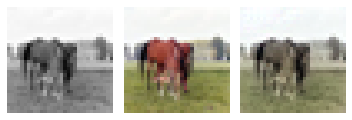

2020-11-08 11:56:26.303 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


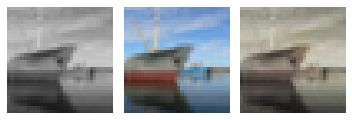

2020-11-08 11:56:26.487 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


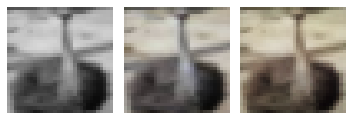

EPOCH: 30.250	trn_loss: 0.004	(2659.72s - 6132.75s remaining)

2020-11-08 11:56:46.462 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 30.255	trn_loss: 0.005	(2660.13s - 6132.20s remaining)

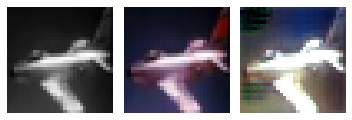

2020-11-08 11:56:46.585 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


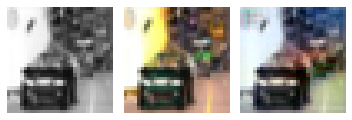

2020-11-08 11:56:46.714 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


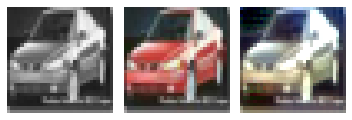

2020-11-08 11:56:46.845 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


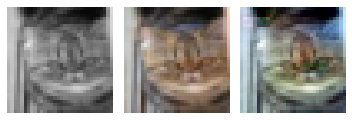

2020-11-08 11:56:46.972 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


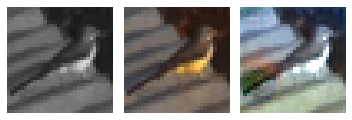

EPOCH: 30.505	trn_loss: 0.004	(2680.30s - 6106.09s remaining)

2020-11-08 11:57:07.042 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 30.510	trn_loss: 0.004	(2680.70s - 6105.55s remaining)

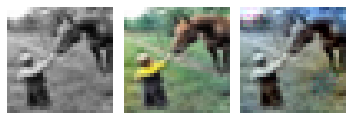

2020-11-08 11:57:07.178 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


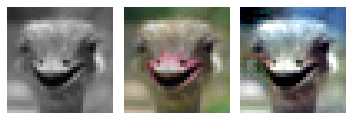

2020-11-08 11:57:07.315 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


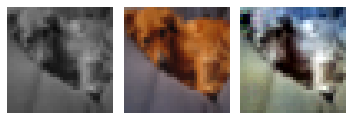

2020-11-08 11:57:07.440 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


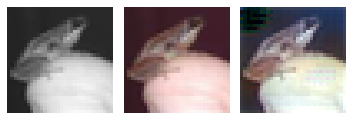

2020-11-08 11:57:07.568 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


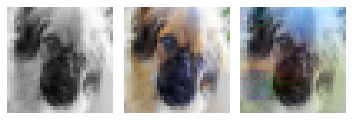

EPOCH: 30.760	trn_loss: 0.005	(2700.87s - 6079.54s remaining)

2020-11-08 11:57:27.609 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 30.765	trn_loss: 0.005	(2701.27s - 6078.98s remaining)

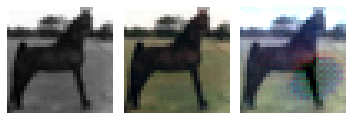

2020-11-08 11:57:27.731 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


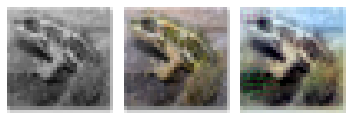

2020-11-08 11:57:27.859 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


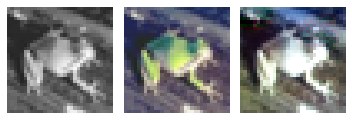

2020-11-08 11:57:27.992 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


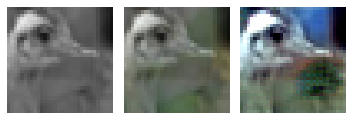

2020-11-08 11:57:28.119 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


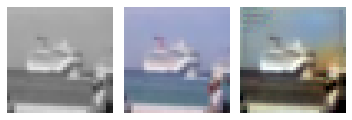

EPOCH: 30.925	val_loss: 0.004	(2726.03s - 6088.95s remaining)

2020-11-08 11:57:52.708 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 31.000	val_loss: 0.003	(2726.37s - 6068.38s remaining)

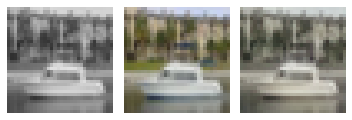

2020-11-08 11:57:52.824 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


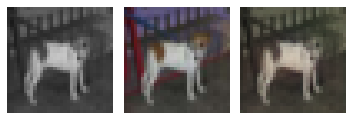

2020-11-08 11:57:52.950 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


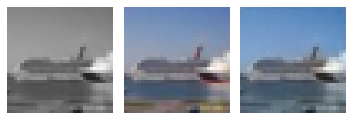

2020-11-08 11:57:53.081 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


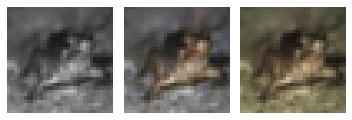

2020-11-08 11:57:53.206 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


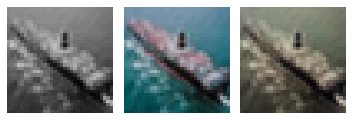

EPOCH: 31.250	trn_loss: 0.005	(2746.51s - 6042.33s remaining)

2020-11-08 11:58:13.244 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 31.255	trn_loss: 0.004	(2746.91s - 6041.76s remaining)

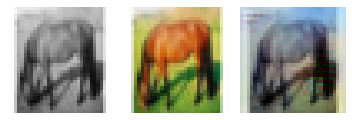

2020-11-08 11:58:13.368 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


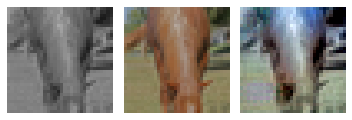

2020-11-08 11:58:13.554 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


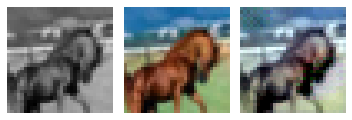

2020-11-08 11:58:13.692 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


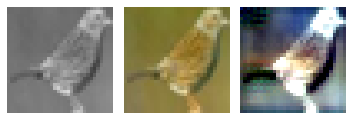

2020-11-08 11:58:13.827 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


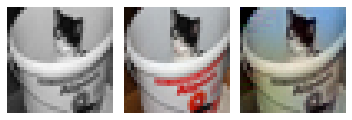

EPOCH: 31.505	trn_loss: 0.004	(2766.96s - 6015.62s remaining)

2020-11-08 11:58:33.708 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 31.510	trn_loss: 0.004	(2767.37s - 6015.09s remaining)

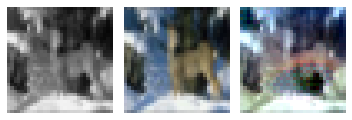

2020-11-08 11:58:33.841 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


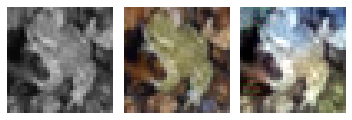

2020-11-08 11:58:33.978 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


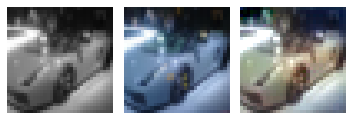

2020-11-08 11:58:34.163 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


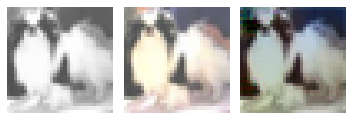

2020-11-08 11:58:34.299 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


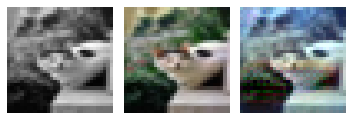

EPOCH: 31.760	trn_loss: 0.004	(2787.54s - 5989.28s remaining)

2020-11-08 11:58:54.276 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 31.765	trn_loss: 0.004	(2787.94s - 5988.74s remaining)

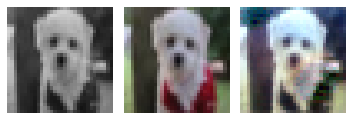

2020-11-08 11:58:54.396 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


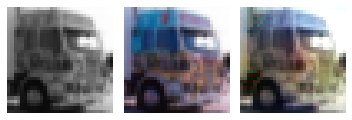

2020-11-08 11:58:54.524 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


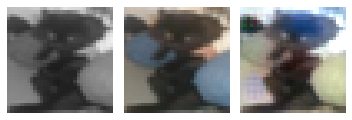

2020-11-08 11:58:54.660 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


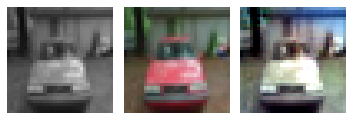

2020-11-08 11:58:54.846 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


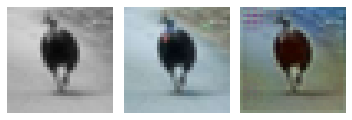

EPOCH: 31.950	val_loss: 0.005	(2813.01s - 5991.40s remaining)

2020-11-08 11:59:19.524 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 32.000	val_loss: 0.003	(2813.19s - 5978.03s remaining)

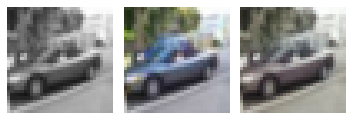

2020-11-08 11:59:19.644 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


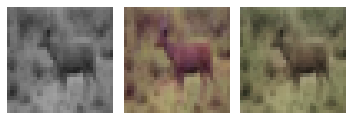

2020-11-08 11:59:19.772 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


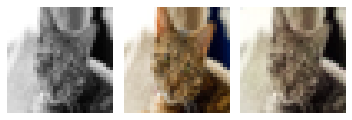

2020-11-08 11:59:19.919 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


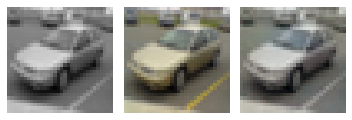

2020-11-08 11:59:20.039 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


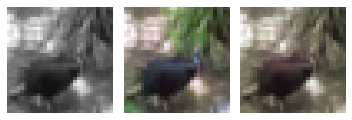

EPOCH: 32.250	trn_loss: 0.004	(2833.38s - 5952.29s remaining)

2020-11-08 11:59:40.111 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 32.255	trn_loss: 0.004	(2833.77s - 5951.73s remaining)

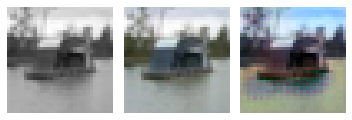

2020-11-08 11:59:40.232 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


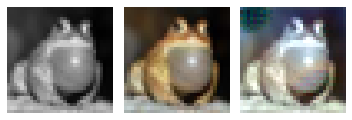

2020-11-08 11:59:40.362 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


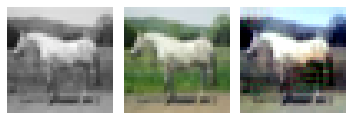

2020-11-08 11:59:40.493 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


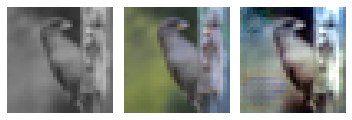

2020-11-08 11:59:40.622 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


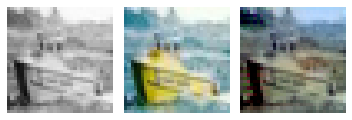

EPOCH: 32.505	trn_loss: 0.005	(2853.91s - 5925.97s remaining)

2020-11-08 12:00:00.640 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 32.510	trn_loss: 0.004	(2854.31s - 5925.42s remaining)

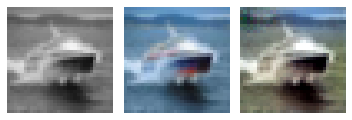

2020-11-08 12:00:00.760 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


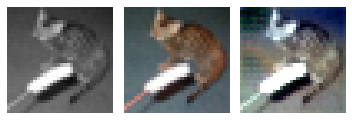

2020-11-08 12:00:00.889 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


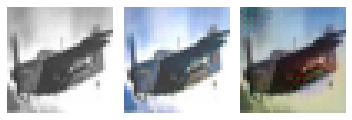

2020-11-08 12:00:01.025 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


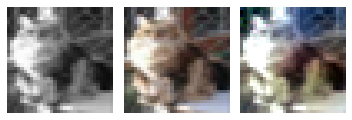

2020-11-08 12:00:01.164 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


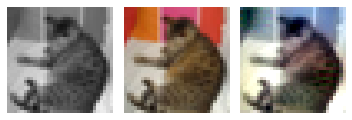

EPOCH: 32.760	trn_loss: 0.005	(2874.53s - 5899.92s remaining)

2020-11-08 12:00:21.257 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 32.765	trn_loss: 0.004	(2874.92s - 5899.36s remaining)

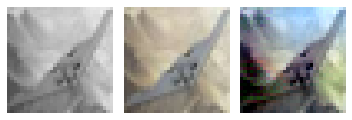

2020-11-08 12:00:21.380 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


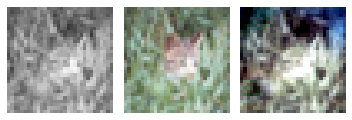

2020-11-08 12:00:21.572 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


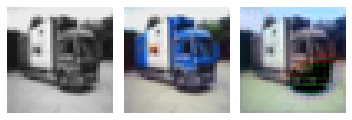

2020-11-08 12:00:21.702 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


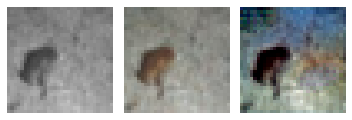

2020-11-08 12:00:21.832 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


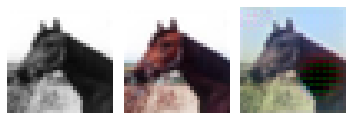

EPOCH: 32.950	val_loss: 0.005	(2899.97s - 5901.15s remaining)

2020-11-08 12:00:46.488 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 33.000	val_loss: 0.003	(2900.15s - 5888.19s remaining)

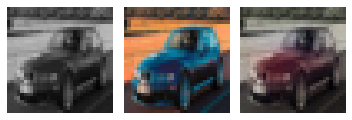

2020-11-08 12:00:46.605 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


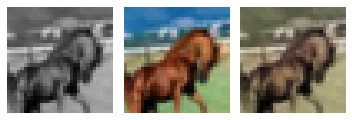

2020-11-08 12:00:46.728 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


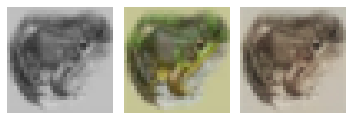

2020-11-08 12:00:46.917 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


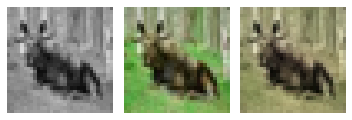

2020-11-08 12:00:47.041 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


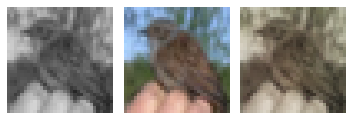

EPOCH: 33.250	trn_loss: 0.004	(2920.28s - 5862.53s remaining)

2020-11-08 12:01:07.018 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 33.255	trn_loss: 0.004	(2920.68s - 5861.97s remaining)

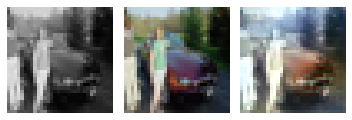

2020-11-08 12:01:07.155 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


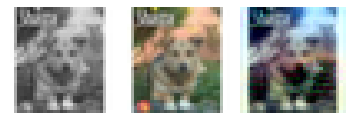

2020-11-08 12:01:07.287 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


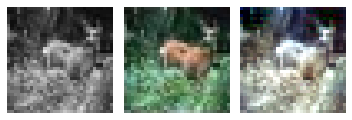

2020-11-08 12:01:07.415 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


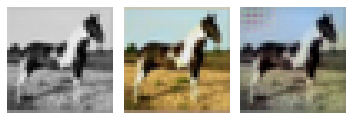

2020-11-08 12:01:07.609 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


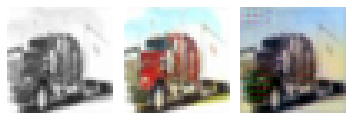

EPOCH: 33.505	trn_loss: 0.004	(2940.84s - 5836.44s remaining)

2020-11-08 12:01:27.580 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 33.510	trn_loss: 0.005	(2941.24s - 5835.91s remaining)

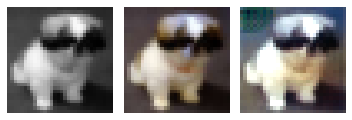

2020-11-08 12:01:27.715 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


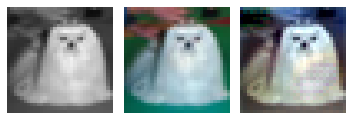

2020-11-08 12:01:27.859 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


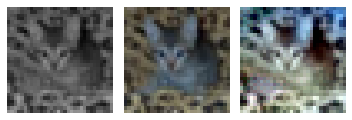

2020-11-08 12:01:27.996 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


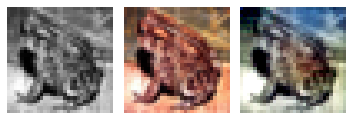

2020-11-08 12:01:28.133 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


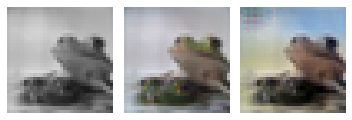

EPOCH: 33.760	trn_loss: 0.004	(2961.46s - 5810.59s remaining)

2020-11-08 12:01:48.195 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 33.765	trn_loss: 0.004	(2961.86s - 5810.04s remaining)

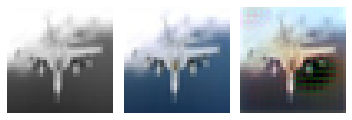

2020-11-08 12:01:48.315 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


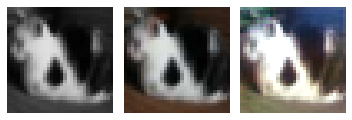

2020-11-08 12:01:48.447 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


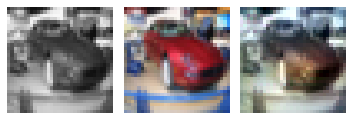

2020-11-08 12:01:48.580 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


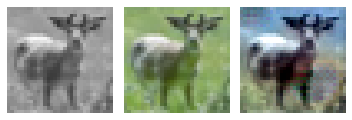

2020-11-08 12:01:48.714 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


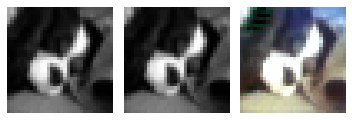

EPOCH: 33.950	val_loss: 0.005	(2986.80s - 5810.84s remaining)

2020-11-08 12:02:13.317 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 34.000	val_loss: 0.003	(2986.98s - 5798.26s remaining)

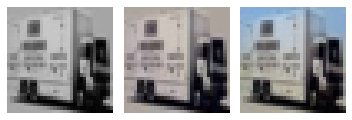

2020-11-08 12:02:13.433 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


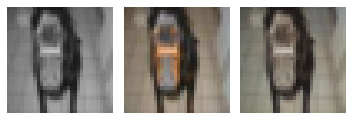

2020-11-08 12:02:13.560 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


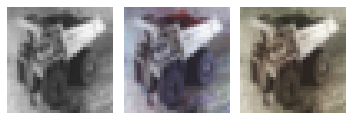

2020-11-08 12:02:13.685 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


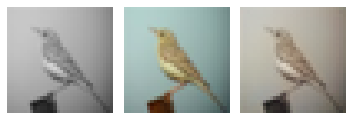

2020-11-08 12:02:13.808 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


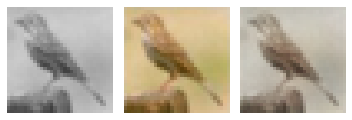

EPOCH: 34.250	trn_loss: 0.004	(3007.04s - 5772.64s remaining)

2020-11-08 12:02:33.768 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 34.255	trn_loss: 0.004	(3007.43s - 5772.08s remaining)

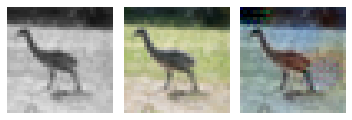

2020-11-08 12:02:33.886 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


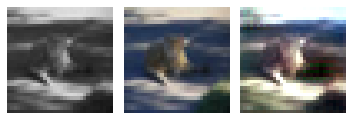

2020-11-08 12:02:34.017 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


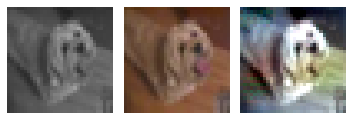

2020-11-08 12:02:34.158 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


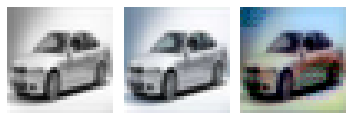

2020-11-08 12:02:34.285 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


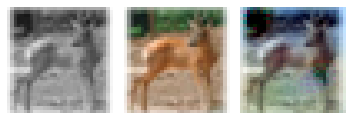

EPOCH: 34.505	trn_loss: 0.004	(3027.56s - 5746.67s remaining)

2020-11-08 12:02:54.299 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 34.510	trn_loss: 0.005	(3027.96s - 5746.15s remaining)

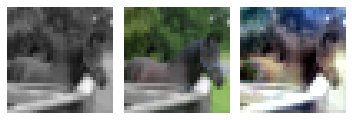

2020-11-08 12:02:54.424 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


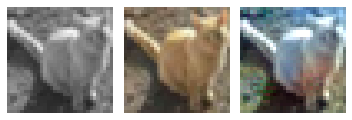

2020-11-08 12:02:54.611 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


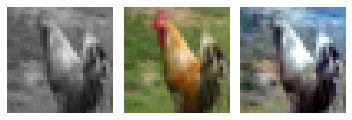

2020-11-08 12:02:54.742 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


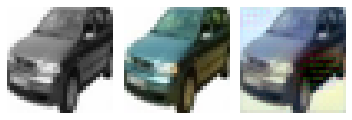

2020-11-08 12:02:54.872 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


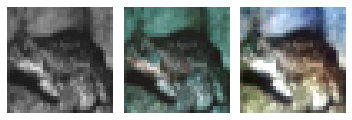

EPOCH: 34.760	trn_loss: 0.004	(3048.17s - 5720.98s remaining)

2020-11-08 12:03:14.903 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 34.765	trn_loss: 0.005	(3048.57s - 5720.43s remaining)

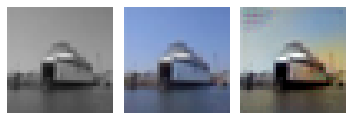

2020-11-08 12:03:15.022 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


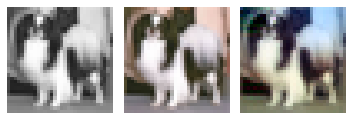

2020-11-08 12:03:15.151 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


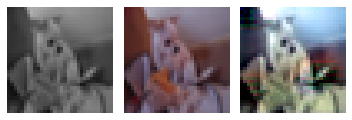

2020-11-08 12:03:15.359 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


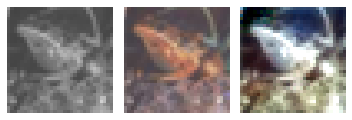

2020-11-08 12:03:15.497 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


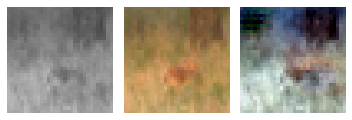

EPOCH: 34.950	val_loss: 0.005	(3073.62s - 5720.71s remaining)

2020-11-08 12:03:40.154 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 35.000	trn_loss: 0.004	val_loss: 0.005	(3073.82s - 5708.52s remaining)


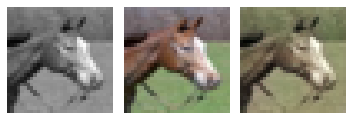

2020-11-08 12:03:40.284 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


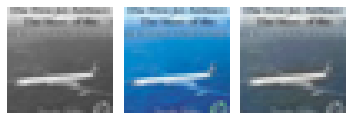

2020-11-08 12:03:40.419 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


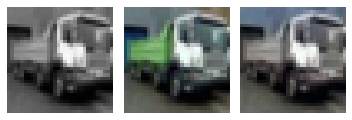

2020-11-08 12:03:40.554 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


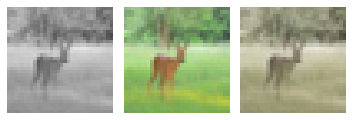

2020-11-08 12:03:40.749 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


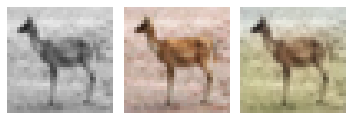

EPOCH: 35.250	trn_loss: 0.004	(3094.03s - 5683.36s remaining)

2020-11-08 12:04:00.774 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 35.255	trn_loss: 0.004	(3094.44s - 5682.84s remaining)

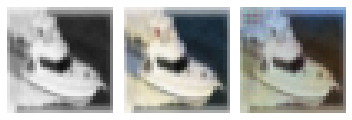

2020-11-08 12:04:00.892 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


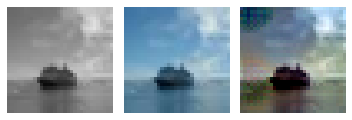

2020-11-08 12:04:01.021 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


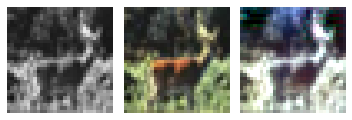

2020-11-08 12:04:01.158 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


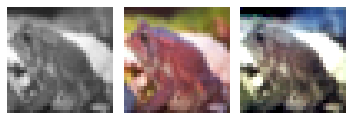

2020-11-08 12:04:01.293 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


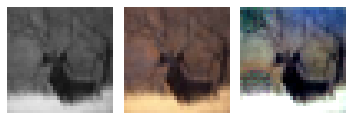

EPOCH: 35.505	trn_loss: 0.005	(3114.71s - 5657.86s remaining)

2020-11-08 12:04:21.442 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 35.510	trn_loss: 0.005	(3115.11s - 5657.32s remaining)

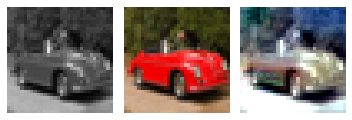

2020-11-08 12:04:21.563 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


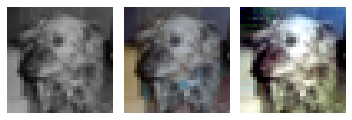

2020-11-08 12:04:21.691 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


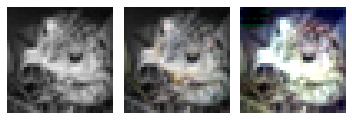

2020-11-08 12:04:21.820 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


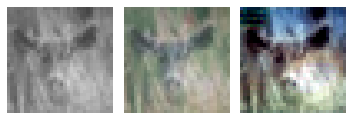

2020-11-08 12:04:21.950 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


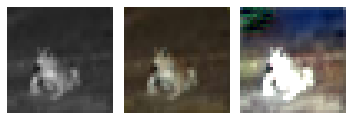

EPOCH: 35.760	trn_loss: 0.004	(3135.31s - 5632.28s remaining)

2020-11-08 12:04:42.035 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 35.765	trn_loss: 0.004	(3135.70s - 5631.73s remaining)

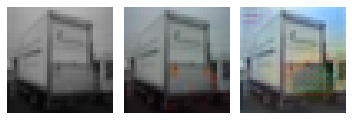

2020-11-08 12:04:42.167 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


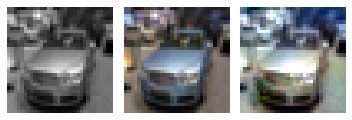

2020-11-08 12:04:42.293 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


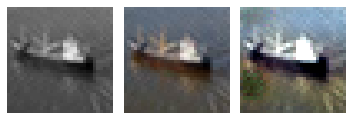

2020-11-08 12:04:42.421 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


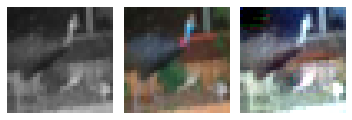

2020-11-08 12:04:42.552 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


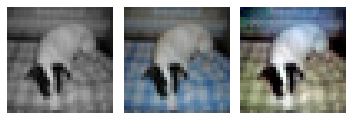

EPOCH: 35.925	val_loss: 0.004	(3160.36s - 5636.75s remaining)

2020-11-08 12:05:07.050 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 36.000	val_loss: 0.003	(3160.72s - 5619.05s remaining)

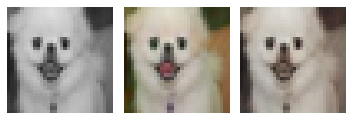

2020-11-08 12:05:07.173 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


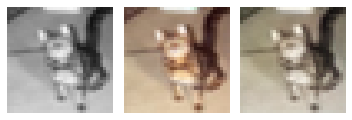

2020-11-08 12:05:07.297 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


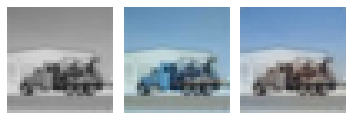

2020-11-08 12:05:07.418 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


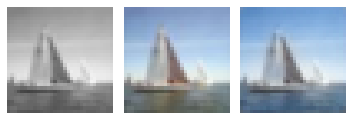

2020-11-08 12:05:07.541 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


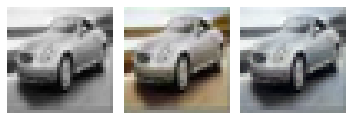

EPOCH: 36.250	trn_loss: 0.004	(3180.71s - 5593.67s remaining)

2020-11-08 12:05:27.451 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 36.255	trn_loss: 0.004	(3181.12s - 5593.14s remaining)

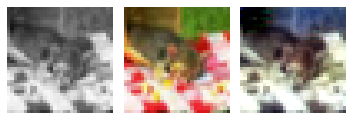

2020-11-08 12:05:27.570 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


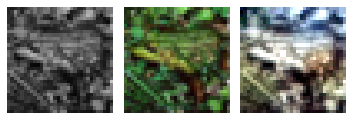

2020-11-08 12:05:27.754 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


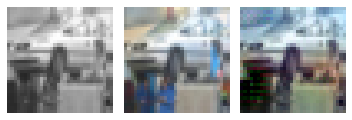

2020-11-08 12:05:27.889 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


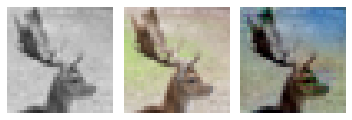

2020-11-08 12:05:28.015 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


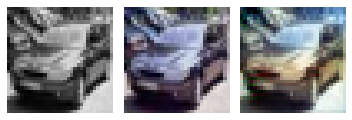

EPOCH: 36.505	trn_loss: 0.004	(3201.22s - 5568.03s remaining)

2020-11-08 12:05:47.955 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 36.510	trn_loss: 0.005	(3201.62s - 5567.49s remaining)

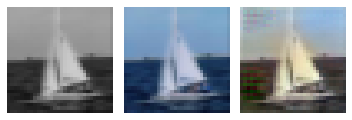

2020-11-08 12:05:48.080 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


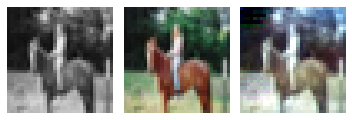

2020-11-08 12:05:48.217 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


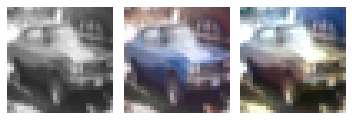

2020-11-08 12:05:48.415 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


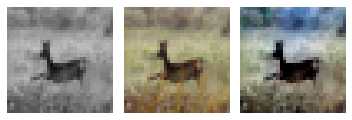

2020-11-08 12:05:48.554 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


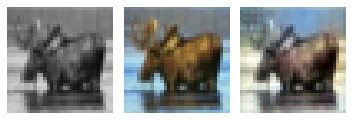

EPOCH: 36.760	trn_loss: 0.004	(3221.91s - 5542.76s remaining)

2020-11-08 12:06:08.653 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 36.765	trn_loss: 0.004	(3222.32s - 5542.24s remaining)

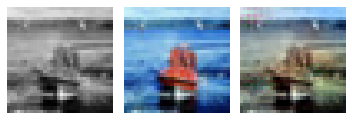

2020-11-08 12:06:08.784 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


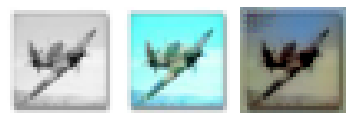

2020-11-08 12:06:08.922 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


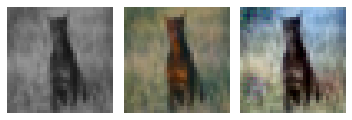

2020-11-08 12:06:09.069 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


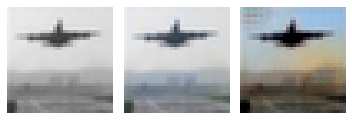

2020-11-08 12:06:09.249 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


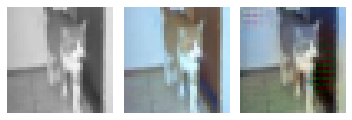

EPOCH: 36.950	val_loss: 0.005	(3247.14s - 5540.78s remaining)

2020-11-08 12:06:33.649 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 37.000	val_loss: 0.003	(3247.31s - 5529.21s remaining)

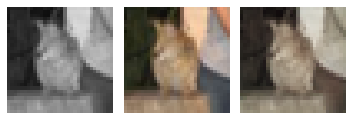

2020-11-08 12:06:33.766 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


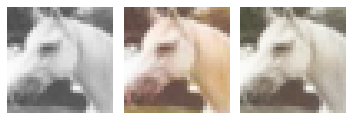

2020-11-08 12:06:33.892 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


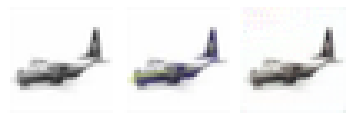

2020-11-08 12:06:34.030 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


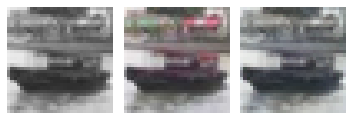

2020-11-08 12:06:34.161 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


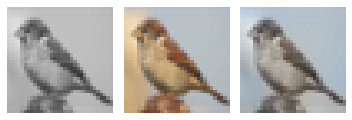

EPOCH: 37.250	trn_loss: 0.005	(3267.44s - 5504.22s remaining)

2020-11-08 12:06:54.178 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 37.255	trn_loss: 0.006	(3267.84s - 5503.68s remaining)

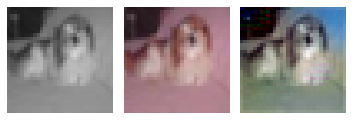

2020-11-08 12:06:54.299 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


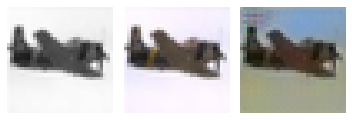

2020-11-08 12:06:54.422 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


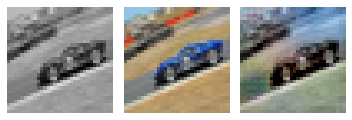

2020-11-08 12:06:54.548 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


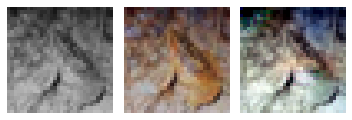

2020-11-08 12:06:54.677 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


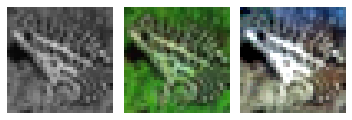

EPOCH: 37.505	trn_loss: 0.005	(3287.90s - 5478.64s remaining)

2020-11-08 12:07:14.628 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 37.510	trn_loss: 0.005	(3288.29s - 5478.10s remaining)

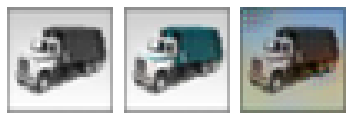

2020-11-08 12:07:14.758 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


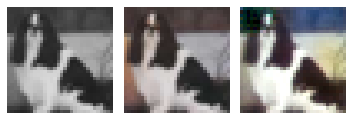

2020-11-08 12:07:14.897 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


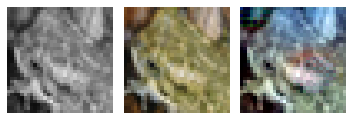

2020-11-08 12:07:15.027 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


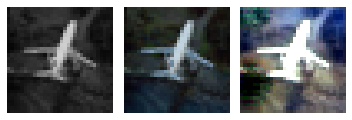

2020-11-08 12:07:15.157 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


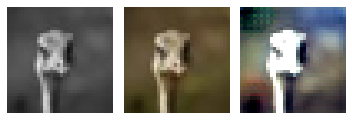

EPOCH: 37.760	trn_loss: 0.004	(3308.46s - 5453.31s remaining)

2020-11-08 12:07:35.200 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 37.765	trn_loss: 0.004	(3308.86s - 5452.79s remaining)

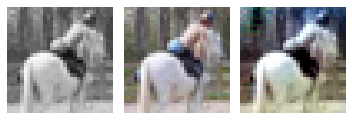

2020-11-08 12:07:35.329 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


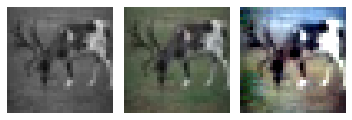

2020-11-08 12:07:35.521 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


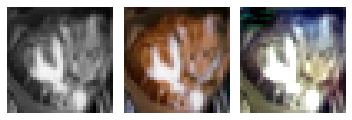

2020-11-08 12:07:35.655 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


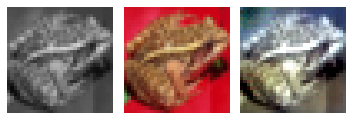

2020-11-08 12:07:35.805 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


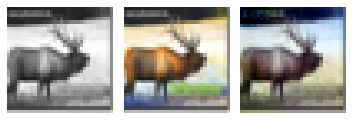

EPOCH: 37.950	val_loss: 0.005	(3333.86s - 5451.02s remaining)

2020-11-08 12:08:00.383 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 38.000	val_loss: 0.003	(3334.05s - 5439.76s remaining)

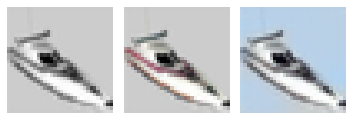

2020-11-08 12:08:00.503 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


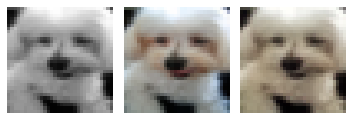

2020-11-08 12:08:00.635 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


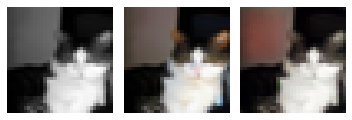

2020-11-08 12:08:00.822 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


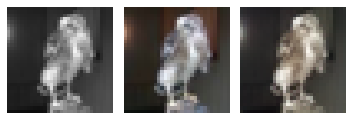

2020-11-08 12:08:00.946 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


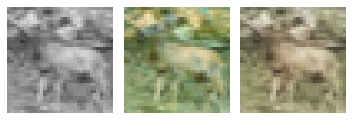

EPOCH: 38.250	trn_loss: 0.004	(3354.23s - 5415.00s remaining)

2020-11-08 12:08:20.961 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 38.255	trn_loss: 0.004	(3354.63s - 5414.47s remaining)

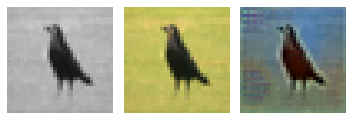

2020-11-08 12:08:21.079 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


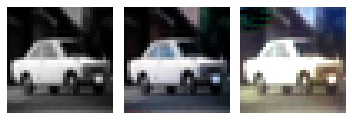

2020-11-08 12:08:21.217 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


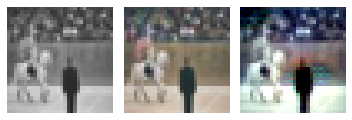

2020-11-08 12:08:21.343 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


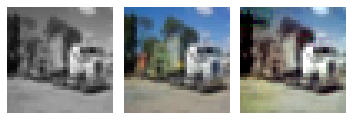

2020-11-08 12:08:21.470 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


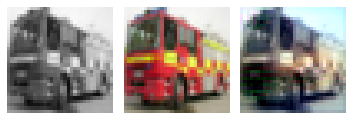

EPOCH: 38.505	trn_loss: 0.005	(3374.79s - 5389.74s remaining)

2020-11-08 12:08:41.527 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 38.510	trn_loss: 0.005	(3375.19s - 5389.22s remaining)

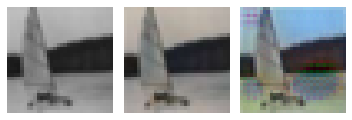

2020-11-08 12:08:41.645 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


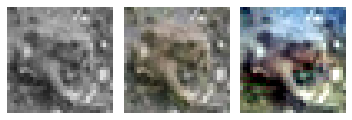

2020-11-08 12:08:41.777 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


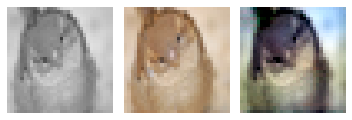

2020-11-08 12:08:41.913 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


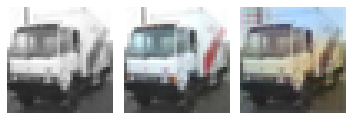

2020-11-08 12:08:42.042 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


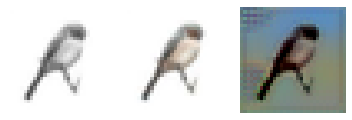

EPOCH: 38.760	trn_loss: 0.004	(3395.25s - 5364.38s remaining)

2020-11-08 12:09:01.976 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 38.765	trn_loss: 0.005	(3395.64s - 5363.84s remaining)

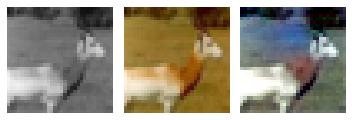

2020-11-08 12:09:02.096 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


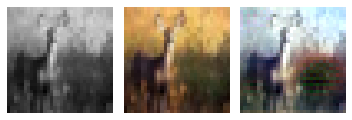

2020-11-08 12:09:02.228 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


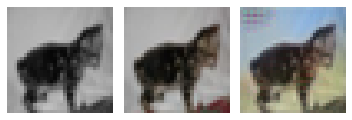

2020-11-08 12:09:02.352 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


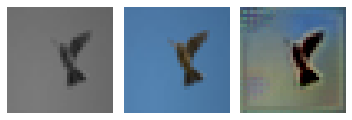

2020-11-08 12:09:02.479 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


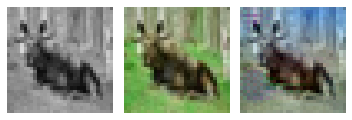

EPOCH: 38.950	val_loss: 0.005	(3420.65s - 5361.51s remaining)

2020-11-08 12:09:27.178 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 39.000	val_loss: 0.003	(3420.84s - 5350.55s remaining)

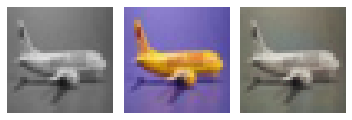

2020-11-08 12:09:27.351 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


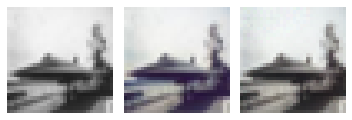

2020-11-08 12:09:27.484 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


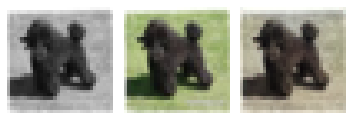

2020-11-08 12:09:27.608 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


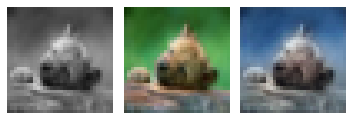

2020-11-08 12:09:27.735 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


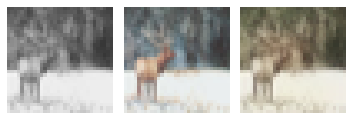

EPOCH: 39.250	trn_loss: 0.004	(3441.00s - 5325.88s remaining)

2020-11-08 12:09:47.723 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 39.255	trn_loss: 0.004	(3441.39s - 5325.34s remaining)

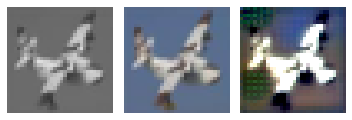

2020-11-08 12:09:47.846 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


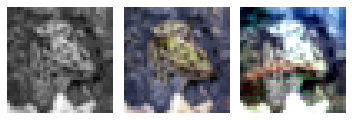

2020-11-08 12:09:47.972 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


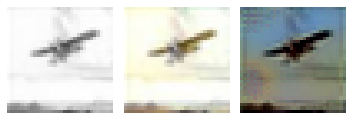

2020-11-08 12:09:48.160 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


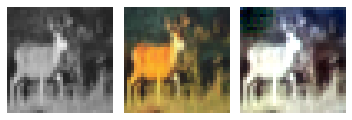

2020-11-08 12:09:48.297 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


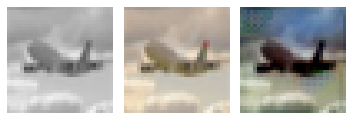

EPOCH: 39.505	trn_loss: 0.004	(3461.56s - 5300.75s remaining)

2020-11-08 12:10:08.300 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 39.510	trn_loss: 0.004	(3461.96s - 5300.24s remaining)

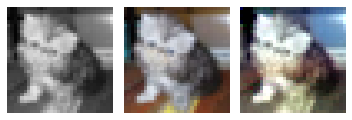

2020-11-08 12:10:08.421 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


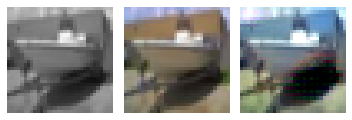

2020-11-08 12:10:08.561 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


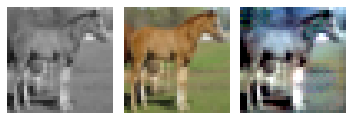

2020-11-08 12:10:08.697 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


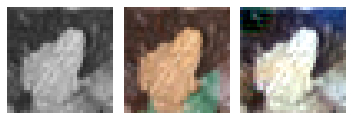

2020-11-08 12:10:08.834 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


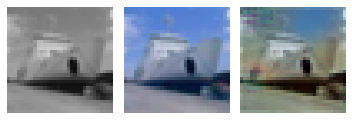

EPOCH: 39.760	trn_loss: 0.004	(3482.10s - 5275.66s remaining)

2020-11-08 12:10:28.834 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 39.765	trn_loss: 0.004	(3482.50s - 5275.13s remaining)

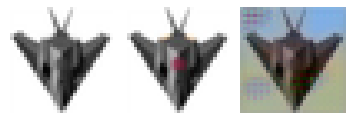

2020-11-08 12:10:28.952 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


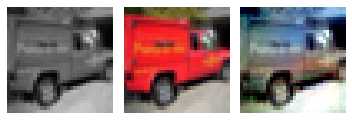

2020-11-08 12:10:29.082 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


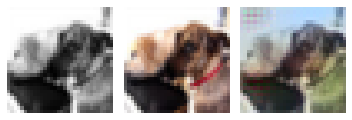

2020-11-08 12:10:29.211 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


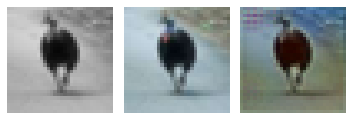

2020-11-08 12:10:29.338 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


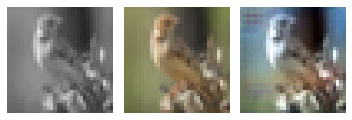

EPOCH: 39.950	val_loss: 0.005	(3507.28s - 5271.90s remaining)

2020-11-08 12:10:53.800 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 40.000	trn_loss: 0.004	val_loss: 0.005	(3507.47s - 5261.20s remaining)


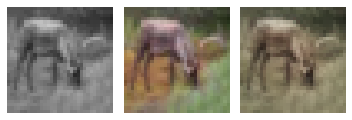

2020-11-08 12:10:53.914 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


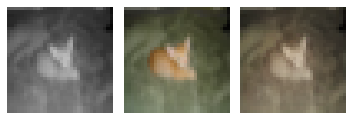

2020-11-08 12:10:54.050 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


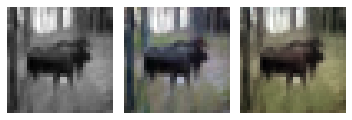

2020-11-08 12:10:54.187 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


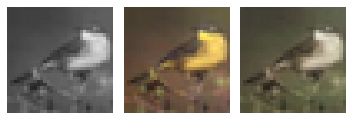

2020-11-08 12:10:54.312 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


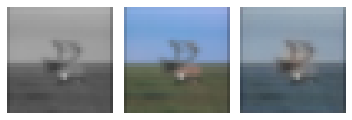

EPOCH: 40.250	trn_loss: 0.004	(3527.51s - 5236.49s remaining)

2020-11-08 12:11:14.245 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 40.255	trn_loss: 0.004	(3527.91s - 5235.97s remaining)

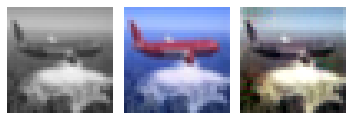

2020-11-08 12:11:14.363 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


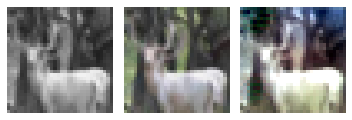

2020-11-08 12:11:14.551 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


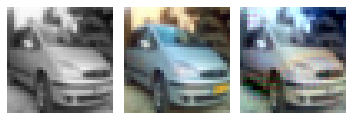

2020-11-08 12:11:14.678 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


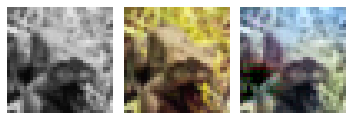

2020-11-08 12:11:14.808 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


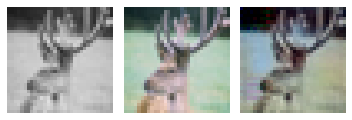

EPOCH: 40.505	trn_loss: 0.004	(3548.04s - 5211.45s remaining)

2020-11-08 12:11:34.773 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 40.510	trn_loss: 0.004	(3548.44s - 5210.93s remaining)

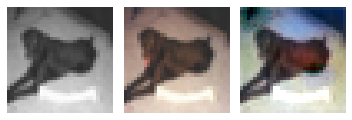

2020-11-08 12:11:34.895 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


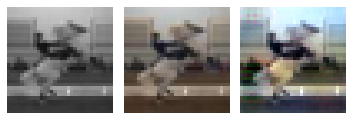

2020-11-08 12:11:35.023 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


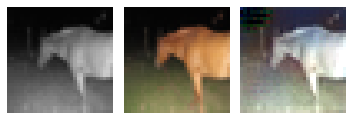

2020-11-08 12:11:35.163 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


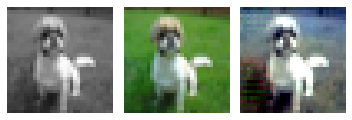

2020-11-08 12:11:35.358 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


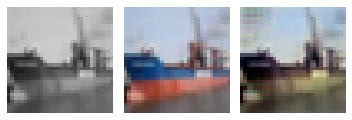

EPOCH: 40.760	trn_loss: 0.004	(3568.62s - 5186.54s remaining)

2020-11-08 12:11:55.360 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 40.765	trn_loss: 0.005	(3569.02s - 5186.03s remaining)

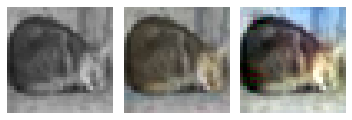

2020-11-08 12:11:55.479 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


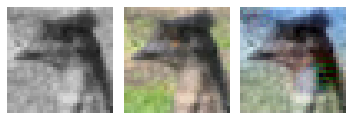

2020-11-08 12:11:55.606 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


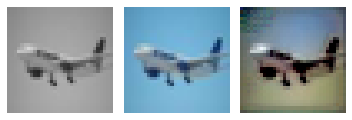

2020-11-08 12:11:55.758 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


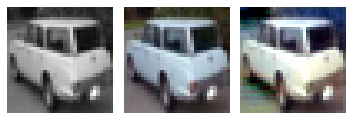

2020-11-08 12:11:55.890 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


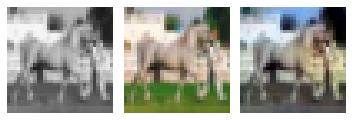

EPOCH: 40.950	val_loss: 0.005	(3593.91s - 5182.43s remaining)

2020-11-08 12:12:20.424 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 41.000	val_loss: 0.003	(3594.09s - 5171.98s remaining)

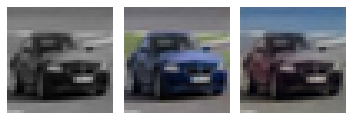

2020-11-08 12:12:20.540 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


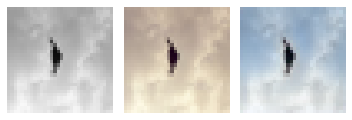

2020-11-08 12:12:20.662 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


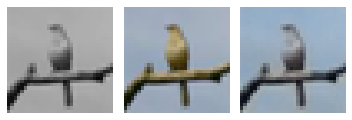

2020-11-08 12:12:20.789 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


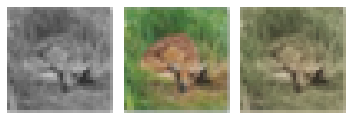

2020-11-08 12:12:20.914 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


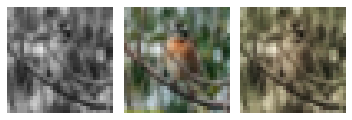

EPOCH: 41.250	trn_loss: 0.004	(3614.19s - 5147.48s remaining)

2020-11-08 12:12:40.912 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 41.255	trn_loss: 0.005	(3614.58s - 5146.95s remaining)

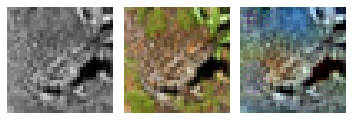

2020-11-08 12:12:41.036 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


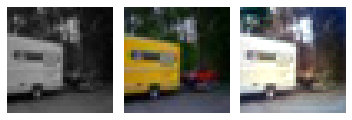

2020-11-08 12:12:41.173 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


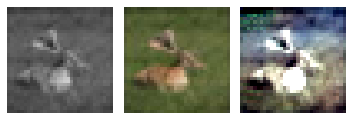

2020-11-08 12:12:41.321 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


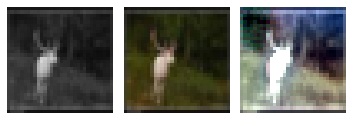

2020-11-08 12:12:41.445 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


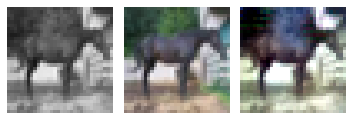

EPOCH: 41.505	trn_loss: 0.005	(3634.78s - 5122.65s remaining)

2020-11-08 12:13:01.504 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 41.510	trn_loss: 0.004	(3635.17s - 5122.12s remaining)

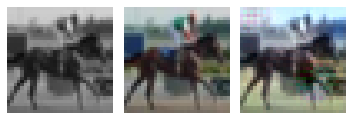

2020-11-08 12:13:01.628 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


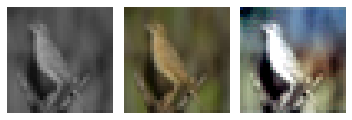

2020-11-08 12:13:01.813 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


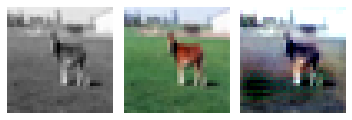

2020-11-08 12:13:01.940 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


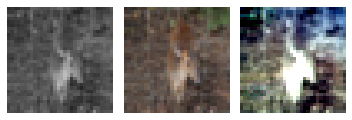

2020-11-08 12:13:02.066 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


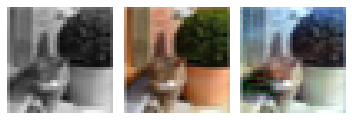

EPOCH: 41.760	trn_loss: 0.004	(3655.45s - 5097.98s remaining)

2020-11-08 12:13:22.194 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 41.765	trn_loss: 0.004	(3655.86s - 5097.48s remaining)

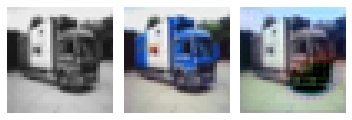

2020-11-08 12:13:22.325 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


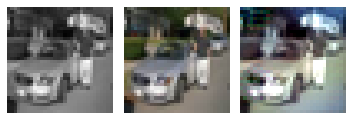

2020-11-08 12:13:22.466 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


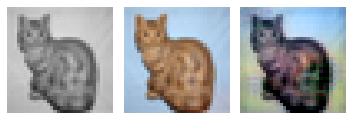

2020-11-08 12:13:22.605 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


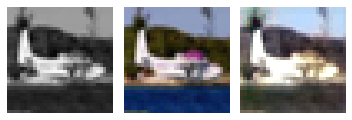

2020-11-08 12:13:22.816 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


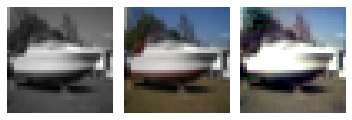

EPOCH: 41.950	val_loss: 0.005	(3680.68s - 5093.29s remaining)

2020-11-08 12:13:47.215 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 42.000	val_loss: 0.003	(3680.88s - 5083.12s remaining)

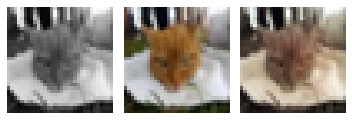

2020-11-08 12:13:47.351 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


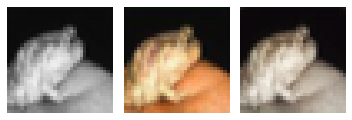

2020-11-08 12:13:47.481 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


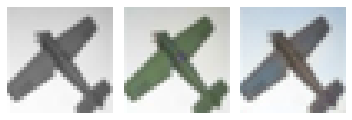

2020-11-08 12:13:47.616 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


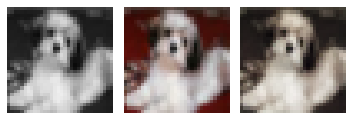

2020-11-08 12:13:47.749 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


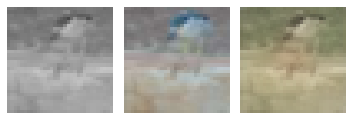

EPOCH: 42.250	trn_loss: 0.004	(3700.95s - 5058.70s remaining)

2020-11-08 12:14:07.707 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 42.255	trn_loss: 0.005	(3701.37s - 5058.21s remaining)

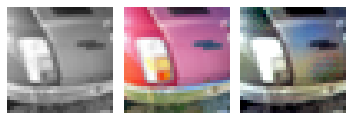

2020-11-08 12:14:07.838 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


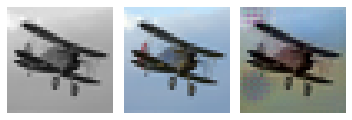

2020-11-08 12:14:07.977 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


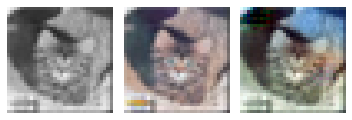

2020-11-08 12:14:08.117 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


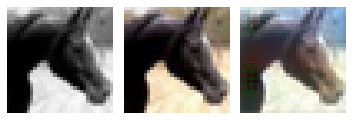

2020-11-08 12:14:08.251 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


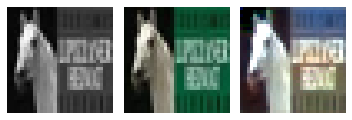

EPOCH: 42.505	trn_loss: 0.004	(3721.49s - 5033.90s remaining)

2020-11-08 12:14:28.217 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 42.510	trn_loss: 0.004	(3721.88s - 5033.38s remaining)

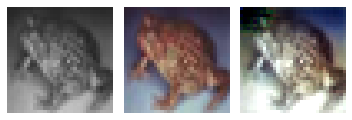

2020-11-08 12:14:28.339 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


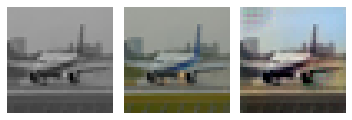

2020-11-08 12:14:28.467 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


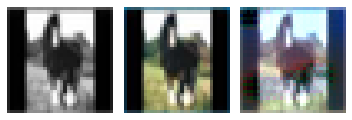

2020-11-08 12:14:28.609 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


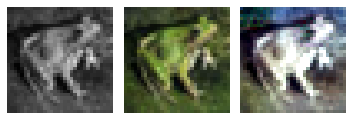

2020-11-08 12:14:28.735 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


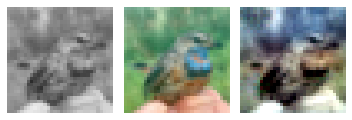

EPOCH: 42.760	trn_loss: 0.004	(3741.94s - 5009.05s remaining)

2020-11-08 12:14:48.674 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 42.765	trn_loss: 0.005	(3742.34s - 5008.54s remaining)

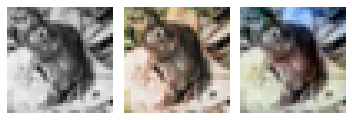

2020-11-08 12:14:48.800 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


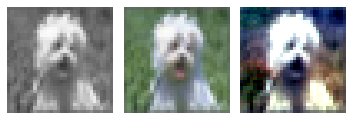

2020-11-08 12:14:48.990 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


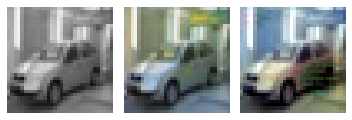

2020-11-08 12:14:49.132 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


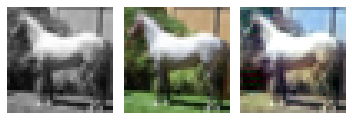

2020-11-08 12:14:49.258 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


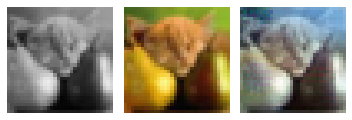

EPOCH: 42.950	val_loss: 0.005	(3767.18s - 5003.91s remaining)

2020-11-08 12:15:13.694 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 43.000	val_loss: 0.003	(3767.36s - 4993.94s remaining)

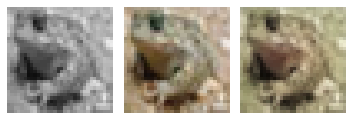

2020-11-08 12:15:13.812 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


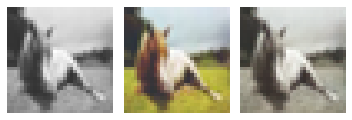

2020-11-08 12:15:13.944 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


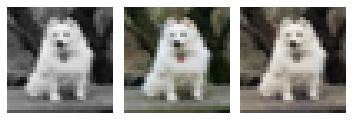

2020-11-08 12:15:14.144 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


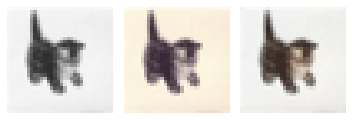

2020-11-08 12:15:14.265 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


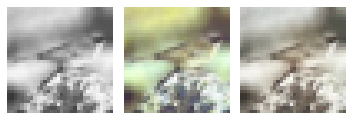

EPOCH: 43.250	trn_loss: 0.004	(3787.53s - 4969.76s remaining)

2020-11-08 12:15:34.252 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 43.255	trn_loss: 0.004	(3787.92s - 4969.24s remaining)

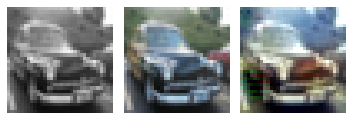

2020-11-08 12:15:34.372 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


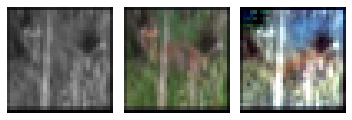

2020-11-08 12:15:34.499 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


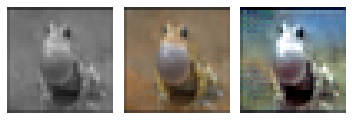

2020-11-08 12:15:34.630 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


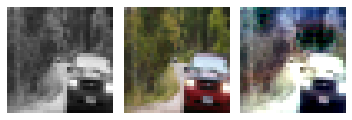

2020-11-08 12:15:34.760 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


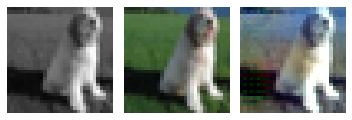

EPOCH: 43.505	trn_loss: 0.004	(3807.97s - 4944.96s remaining)

2020-11-08 12:15:54.702 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 43.510	trn_loss: 0.004	(3808.37s - 4944.45s remaining)

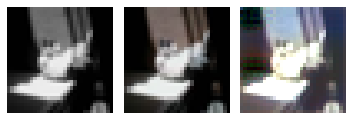

2020-11-08 12:15:54.824 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


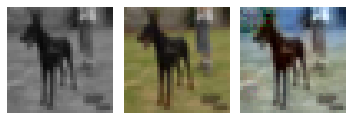

2020-11-08 12:15:54.950 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


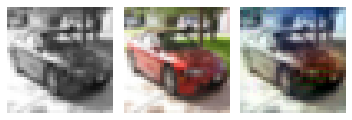

2020-11-08 12:15:55.079 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


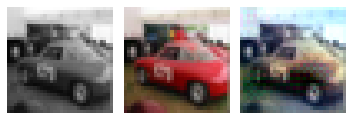

2020-11-08 12:15:55.209 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


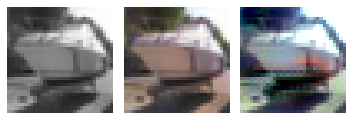

EPOCH: 43.760	trn_loss: 0.005	(3828.47s - 4920.28s remaining)

2020-11-08 12:16:15.210 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 43.765	trn_loss: 0.005	(3828.87s - 4919.78s remaining)

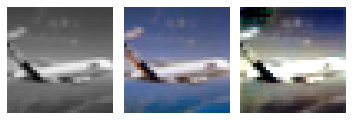

2020-11-08 12:16:15.331 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


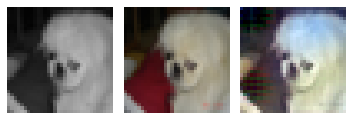

2020-11-08 12:16:15.469 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


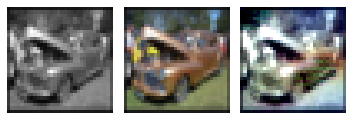

2020-11-08 12:16:15.596 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


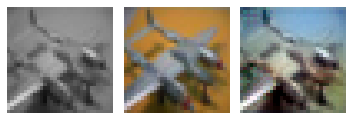

2020-11-08 12:16:15.735 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


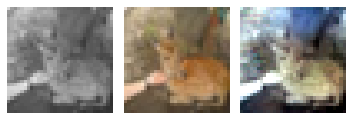

EPOCH: 43.950	val_loss: 0.005	(3853.65s - 4914.61s remaining)

2020-11-08 12:16:40.167 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 44.000	val_loss: 0.003	(3853.83s - 4904.88s remaining)

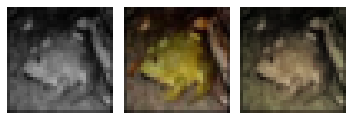

2020-11-08 12:16:40.337 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


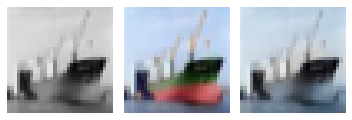

2020-11-08 12:16:40.462 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


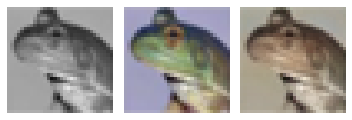

2020-11-08 12:16:40.585 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


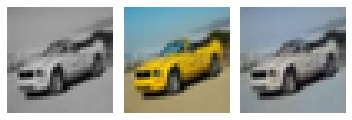

2020-11-08 12:16:40.711 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


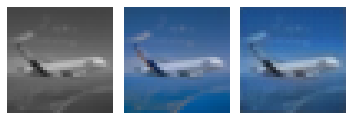

EPOCH: 44.250	trn_loss: 0.004	(3873.93s - 4880.72s remaining)

2020-11-08 12:17:00.667 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 44.255	trn_loss: 0.004	(3874.33s - 4880.21s remaining)

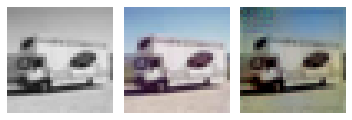

2020-11-08 12:17:00.789 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


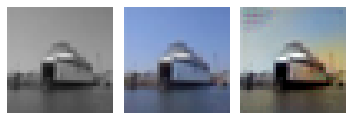

2020-11-08 12:17:00.921 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


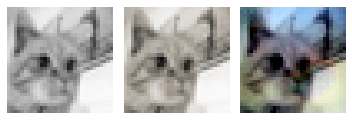

2020-11-08 12:17:01.108 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


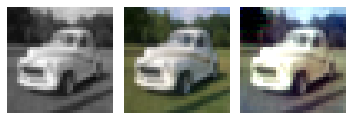

2020-11-08 12:17:01.246 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


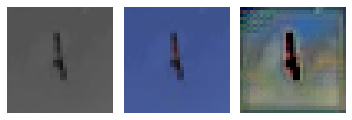

EPOCH: 44.505	trn_loss: 0.004	(3894.40s - 4856.06s remaining)

2020-11-08 12:17:21.130 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 44.510	trn_loss: 0.004	(3894.79s - 4855.55s remaining)

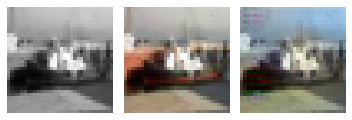

2020-11-08 12:17:21.253 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


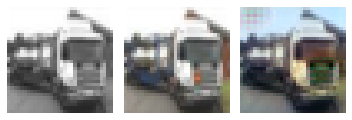

2020-11-08 12:17:21.384 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


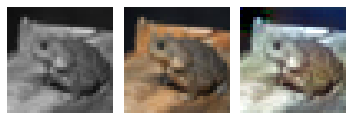

2020-11-08 12:17:21.512 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


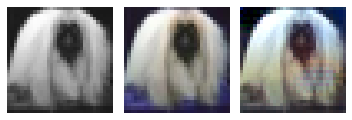

2020-11-08 12:17:21.644 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


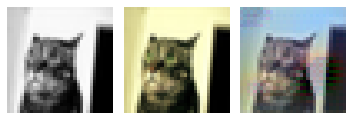

EPOCH: 44.760	trn_loss: 0.004	(3914.94s - 4831.54s remaining)

2020-11-08 12:17:41.673 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 44.765	trn_loss: 0.004	(3915.34s - 4831.03s remaining)

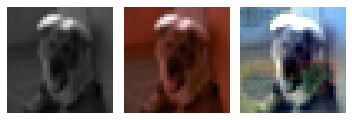

2020-11-08 12:17:41.795 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


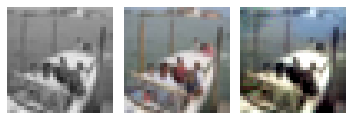

2020-11-08 12:17:41.929 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


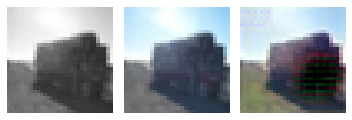

2020-11-08 12:17:42.056 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


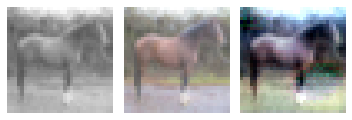

2020-11-08 12:17:42.185 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


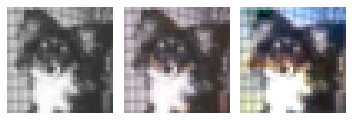

EPOCH: 44.950	val_loss: 0.005	(3940.16s - 4825.49s remaining)

2020-11-08 12:18:06.677 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 45.000	trn_loss: 0.004	val_loss: 0.005	(3940.34s - 4815.97s remaining)


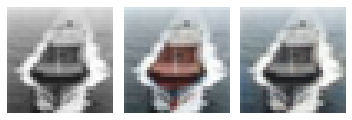

2020-11-08 12:18:06.792 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


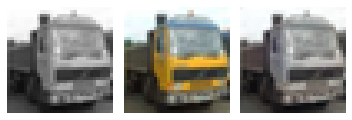

2020-11-08 12:18:06.921 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


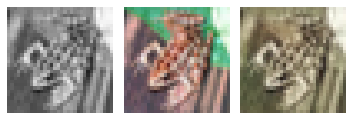

2020-11-08 12:18:07.055 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


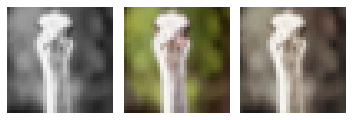

2020-11-08 12:18:07.202 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


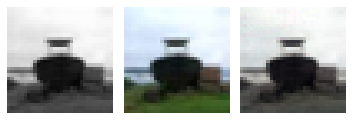

EPOCH: 45.250	trn_loss: 0.004	(3960.51s - 4792.00s remaining)

2020-11-08 12:18:27.243 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 45.255	trn_loss: 0.004	(3960.91s - 4791.49s remaining)

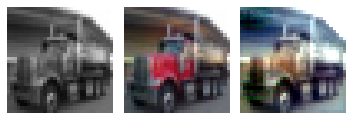

2020-11-08 12:18:27.370 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


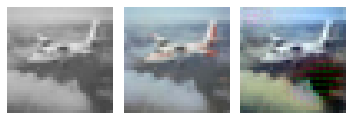

2020-11-08 12:18:27.562 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


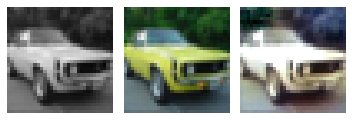

2020-11-08 12:18:27.701 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


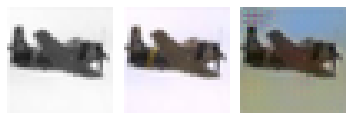

2020-11-08 12:18:27.834 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


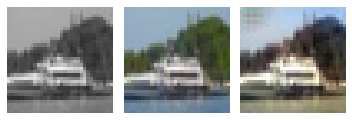

EPOCH: 45.505	trn_loss: 0.004	(3981.00s - 4767.47s remaining)

2020-11-08 12:18:47.733 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 45.510	trn_loss: 0.004	(3981.40s - 4766.96s remaining)

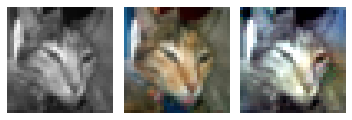

2020-11-08 12:18:47.852 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


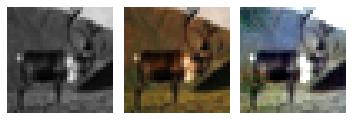

2020-11-08 12:18:47.981 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


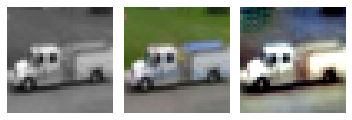

2020-11-08 12:18:48.107 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


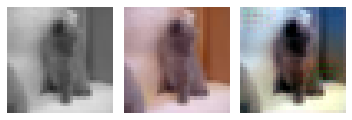

2020-11-08 12:18:48.292 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


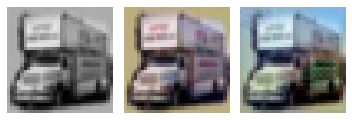

EPOCH: 45.760	trn_loss: 0.004	(4001.54s - 4743.05s remaining)

2020-11-08 12:19:08.268 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 45.765	trn_loss: 0.004	(4001.93s - 4742.54s remaining)

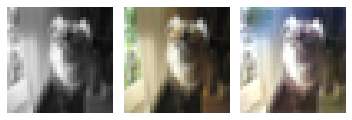

2020-11-08 12:19:08.385 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


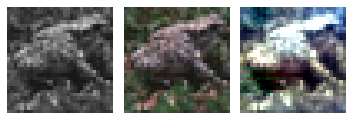

2020-11-08 12:19:08.512 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


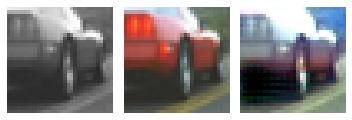

2020-11-08 12:19:08.639 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


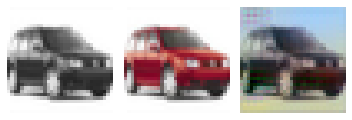

2020-11-08 12:19:08.767 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


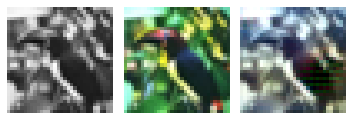

EPOCH: 45.950	val_loss: 0.005	(4026.74s - 4736.57s remaining)

2020-11-08 12:19:33.273 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 46.000	val_loss: 0.003	(4026.94s - 4727.27s remaining)

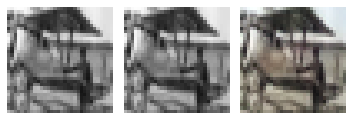

2020-11-08 12:19:33.415 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


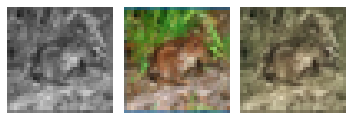

2020-11-08 12:19:33.548 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


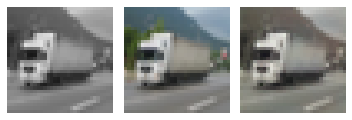

2020-11-08 12:19:33.685 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


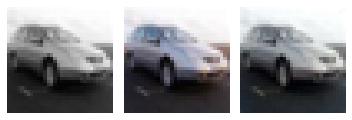

2020-11-08 12:19:33.820 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


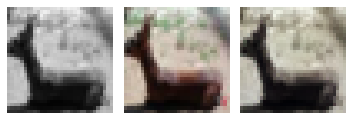

EPOCH: 46.250	trn_loss: 0.004	(4047.00s - 4703.27s remaining)

2020-11-08 12:19:53.746 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 46.255	trn_loss: 0.004	(4047.41s - 4702.78s remaining)

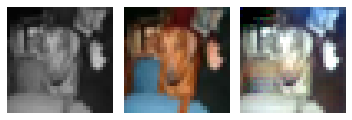

2020-11-08 12:19:53.877 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


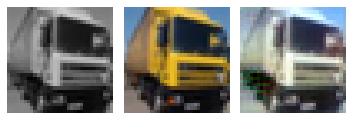

2020-11-08 12:19:54.062 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


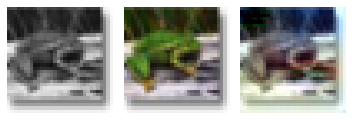

2020-11-08 12:19:54.191 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


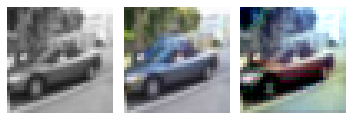

2020-11-08 12:19:54.318 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


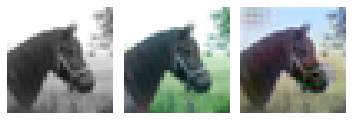

EPOCH: 46.505	trn_loss: 0.005	(4067.50s - 4678.85s remaining)

2020-11-08 12:20:14.224 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 46.510	trn_loss: 0.004	(4067.89s - 4678.34s remaining)

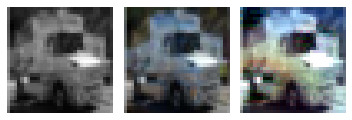

2020-11-08 12:20:14.344 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


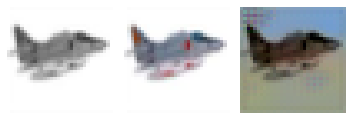

2020-11-08 12:20:14.470 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


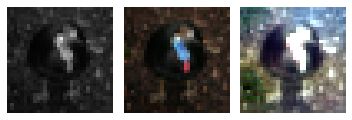

2020-11-08 12:20:14.603 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


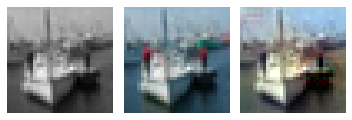

2020-11-08 12:20:14.790 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


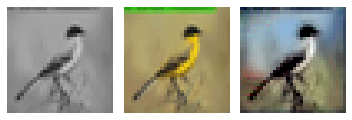

EPOCH: 46.760	trn_loss: 0.004	(4088.02s - 4654.50s remaining)

2020-11-08 12:20:34.748 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 46.765	trn_loss: 0.005	(4088.41s - 4653.99s remaining)

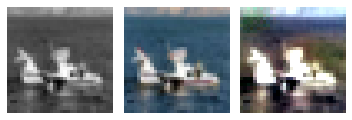

2020-11-08 12:20:34.872 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


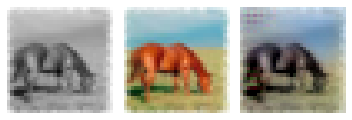

2020-11-08 12:20:34.998 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


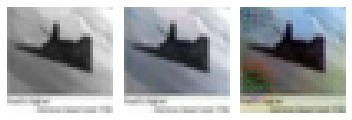

2020-11-08 12:20:35.129 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


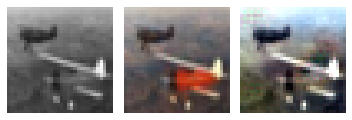

2020-11-08 12:20:35.264 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


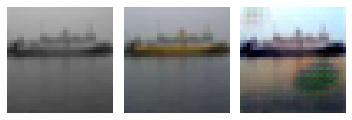

EPOCH: 46.950	val_loss: 0.005	(4113.27s - 4647.69s remaining)

2020-11-08 12:20:59.786 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 47.000	val_loss: 0.003	(4113.45s - 4638.57s remaining)

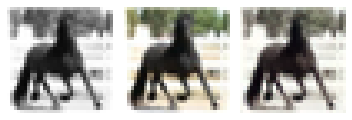

2020-11-08 12:20:59.905 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


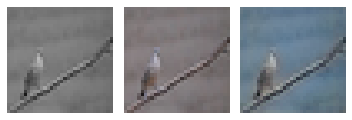

2020-11-08 12:21:00.027 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


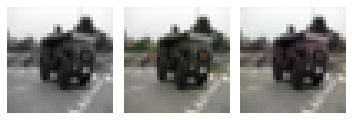

2020-11-08 12:21:00.160 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


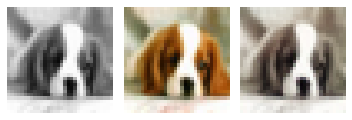

2020-11-08 12:21:00.287 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


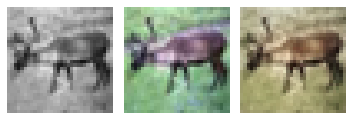

EPOCH: 47.250	trn_loss: 0.005	(4133.46s - 4614.61s remaining)

2020-11-08 12:21:20.194 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 47.255	trn_loss: 0.004	(4133.86s - 4614.10s remaining)

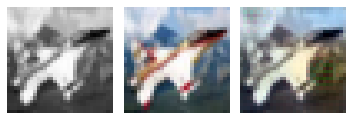

2020-11-08 12:21:20.316 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


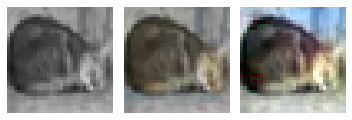

2020-11-08 12:21:20.511 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


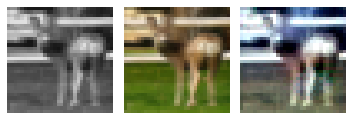

2020-11-08 12:21:20.636 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


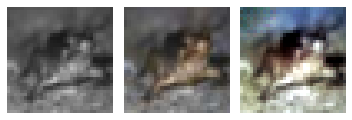

2020-11-08 12:21:20.759 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


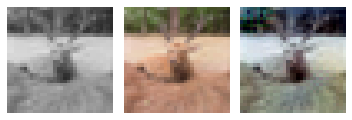

EPOCH: 47.505	trn_loss: 0.005	(4154.00s - 4590.33s remaining)

2020-11-08 12:21:40.735 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 47.510	trn_loss: 0.004	(4154.40s - 4589.83s remaining)

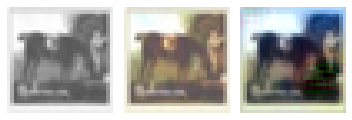

2020-11-08 12:21:40.854 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


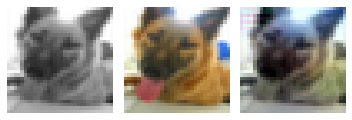

2020-11-08 12:21:40.987 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


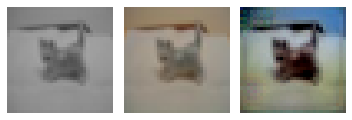

2020-11-08 12:21:41.113 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


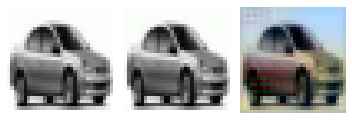

2020-11-08 12:21:41.297 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


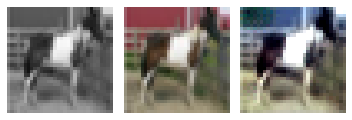

EPOCH: 47.760	trn_loss: 0.005	(4174.52s - 4566.06s remaining)

2020-11-08 12:22:01.241 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 47.765	trn_loss: 0.004	(4174.91s - 4565.55s remaining)

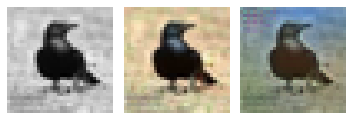

2020-11-08 12:22:01.359 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


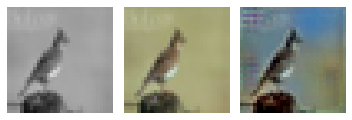

2020-11-08 12:22:01.488 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


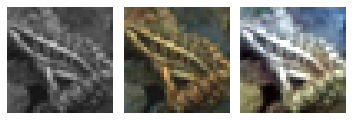

2020-11-08 12:22:01.616 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


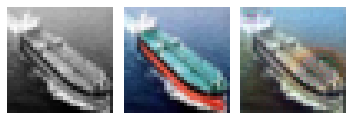

2020-11-08 12:22:01.743 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


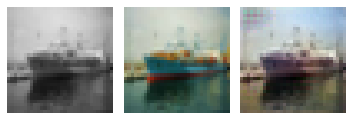

EPOCH: 47.950	val_loss: 0.005	(4199.70s - 4558.79s remaining)

2020-11-08 12:22:26.230 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 48.000	val_loss: 0.003	(4199.89s - 4549.89s remaining)

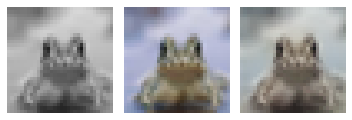

2020-11-08 12:22:26.347 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


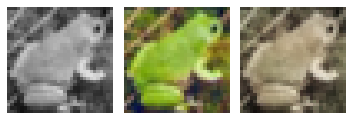

2020-11-08 12:22:26.470 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


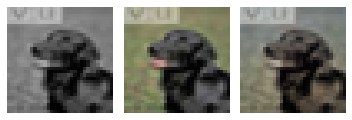

2020-11-08 12:22:26.594 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


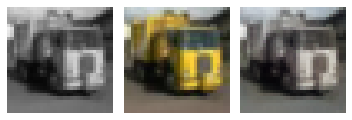

2020-11-08 12:22:26.715 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


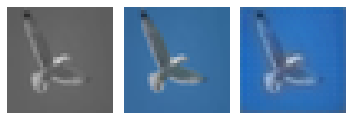

EPOCH: 48.250	trn_loss: 0.005	(4219.95s - 4526.06s remaining)

2020-11-08 12:22:46.682 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 48.255	trn_loss: 0.004	(4220.35s - 4525.56s remaining)

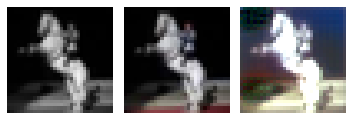

2020-11-08 12:22:46.799 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


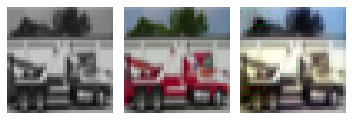

2020-11-08 12:22:46.986 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


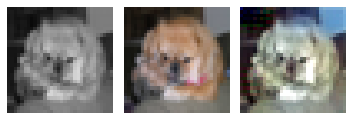

2020-11-08 12:22:47.113 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


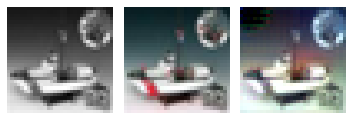

2020-11-08 12:22:47.240 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


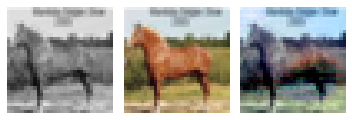

EPOCH: 48.505	trn_loss: 0.005	(4240.45s - 4501.82s remaining)

2020-11-08 12:23:07.179 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 48.510	trn_loss: 0.004	(4240.84s - 4501.32s remaining)

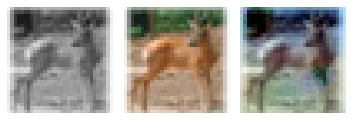

2020-11-08 12:23:07.300 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


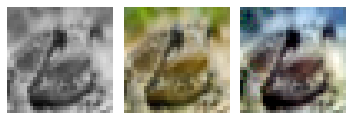

2020-11-08 12:23:07.429 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


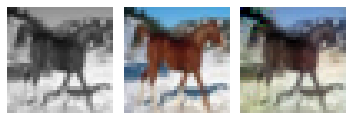

2020-11-08 12:23:07.563 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


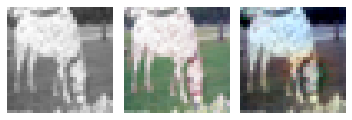

2020-11-08 12:23:07.760 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


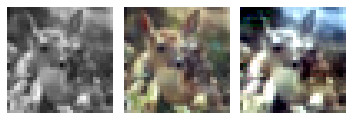

EPOCH: 48.760	trn_loss: 0.005	(4260.97s - 4477.65s remaining)

2020-11-08 12:23:27.696 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 48.765	trn_loss: 0.005	(4261.36s - 4477.15s remaining)

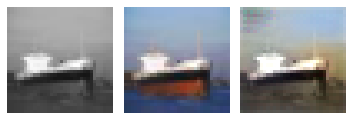

2020-11-08 12:23:27.818 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


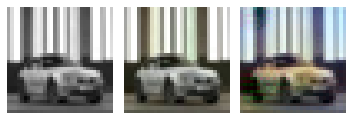

2020-11-08 12:23:27.947 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


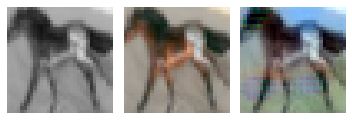

2020-11-08 12:23:28.077 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


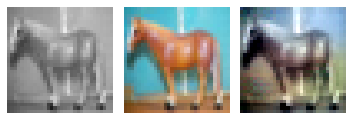

2020-11-08 12:23:28.207 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


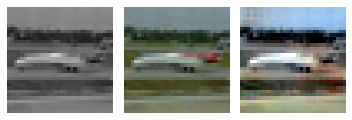

EPOCH: 48.950	val_loss: 0.005	(4286.18s - 4470.06s remaining)

2020-11-08 12:23:52.696 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 49.000	val_loss: 0.003	(4286.36s - 4461.32s remaining)

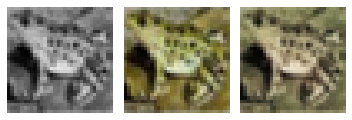

2020-11-08 12:23:52.813 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


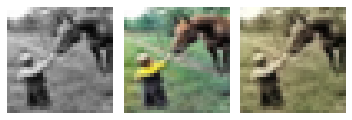

2020-11-08 12:23:52.949 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


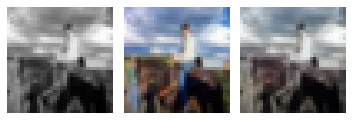

2020-11-08 12:23:53.081 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


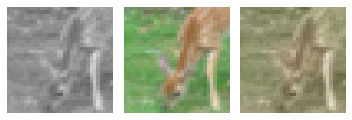

2020-11-08 12:23:53.214 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


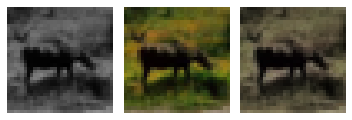

EPOCH: 49.250	trn_loss: 0.004	(4306.47s - 4437.63s remaining)

2020-11-08 12:24:13.190 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 49.255	trn_loss: 0.004	(4306.85s - 4437.12s remaining)

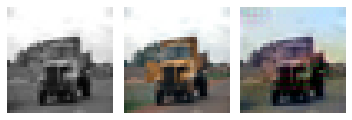

2020-11-08 12:24:13.309 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


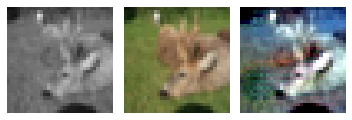

2020-11-08 12:24:13.510 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


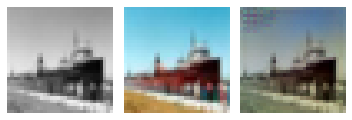

2020-11-08 12:24:13.640 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


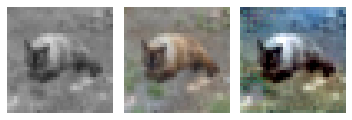

2020-11-08 12:24:13.770 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


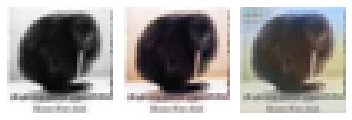

EPOCH: 49.505	trn_loss: 0.005	(4326.97s - 4413.48s remaining)

2020-11-08 12:24:33.698 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 49.510	trn_loss: 0.004	(4327.36s - 4412.98s remaining)

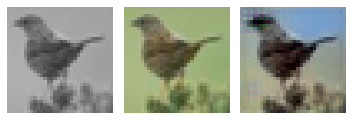

2020-11-08 12:24:33.820 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


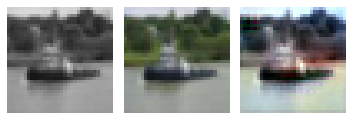

2020-11-08 12:24:33.947 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


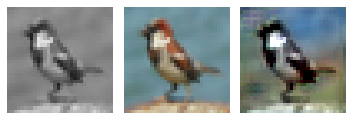

2020-11-08 12:24:34.085 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


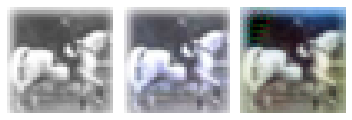

2020-11-08 12:24:34.282 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


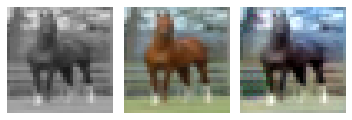

EPOCH: 49.760	trn_loss: 0.004	(4347.55s - 4389.46s remaining)

2020-11-08 12:24:54.298 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 49.765	trn_loss: 0.005	(4347.96s - 4388.97s remaining)

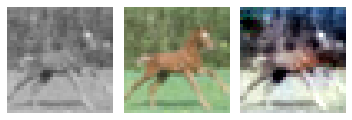

2020-11-08 12:24:54.417 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


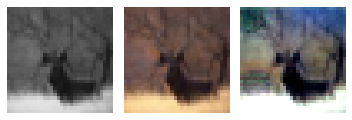

2020-11-08 12:24:54.550 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


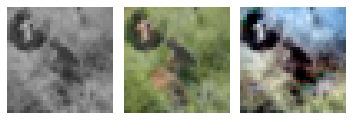

2020-11-08 12:24:54.682 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


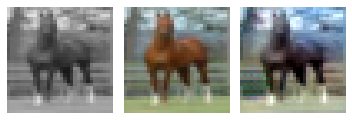

2020-11-08 12:24:54.814 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


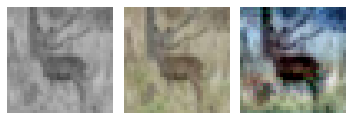

EPOCH: 49.950	val_loss: 0.005	(4372.83s - 4381.59s remaining)

2020-11-08 12:25:19.360 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 50.000	trn_loss: 0.004	val_loss: 0.005	(4373.03s - 4373.03s remaining)


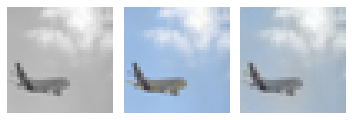

2020-11-08 12:25:19.478 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


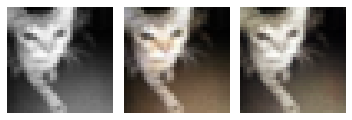

2020-11-08 12:25:19.600 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


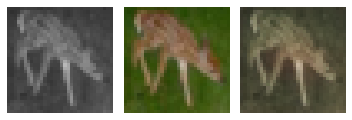

2020-11-08 12:25:19.723 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


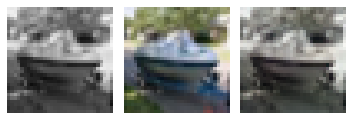

2020-11-08 12:25:19.846 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


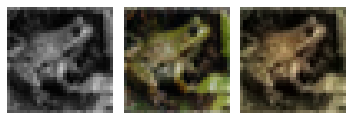

EPOCH: 50.250	trn_loss: 0.004	(4393.07s - 4349.36s remaining)

2020-11-08 12:25:39.812 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 50.255	trn_loss: 0.004	(4393.48s - 4348.87s remaining)

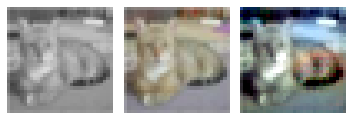

2020-11-08 12:25:39.946 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


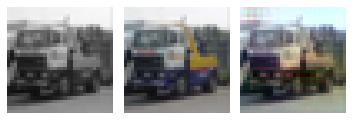

2020-11-08 12:25:40.131 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


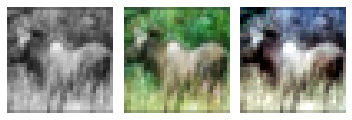

2020-11-08 12:25:40.266 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


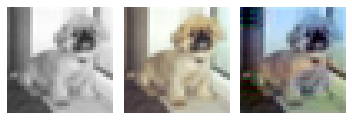

2020-11-08 12:25:40.395 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


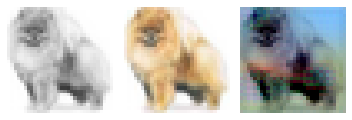

EPOCH: 50.505	trn_loss: 0.004	(4413.61s - 4325.33s remaining)

2020-11-08 12:26:00.338 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 50.510	trn_loss: 0.005	(4414.00s - 4324.83s remaining)

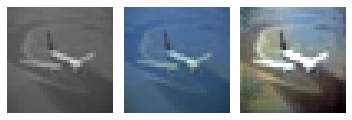

2020-11-08 12:26:00.464 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


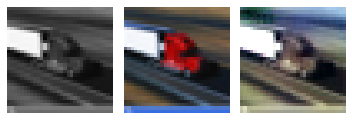

2020-11-08 12:26:00.596 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


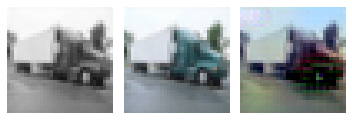

2020-11-08 12:26:00.731 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


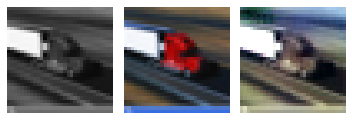

2020-11-08 12:26:00.918 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


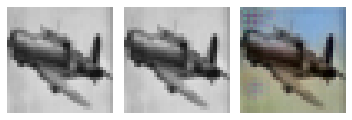

EPOCH: 50.760	trn_loss: 0.005	(4434.18s - 4301.37s remaining)

2020-11-08 12:26:20.913 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 50.765	trn_loss: 0.004	(4434.58s - 4300.87s remaining)

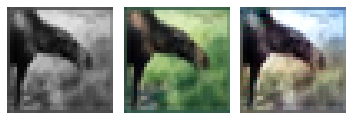

2020-11-08 12:26:21.032 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


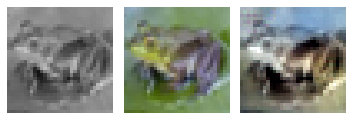

2020-11-08 12:26:21.169 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


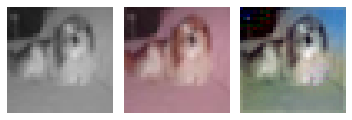

2020-11-08 12:26:21.297 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


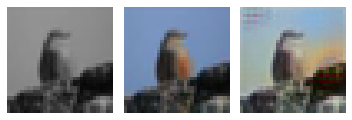

2020-11-08 12:26:21.424 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


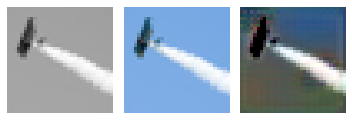

EPOCH: 50.950	val_loss: 0.005	(4459.40s - 4293.10s remaining)

2020-11-08 12:26:45.913 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 51.000	val_loss: 0.003	(4459.58s - 4284.69s remaining)

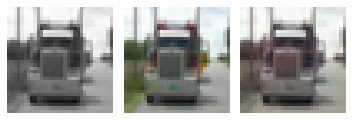

2020-11-08 12:26:46.029 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


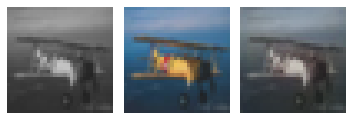

2020-11-08 12:26:46.152 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


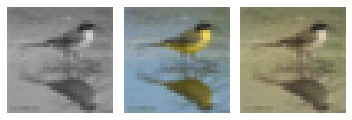

2020-11-08 12:26:46.285 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


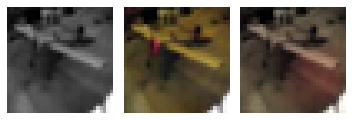

2020-11-08 12:26:46.410 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


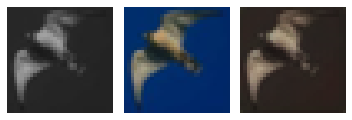

EPOCH: 51.250	trn_loss: 0.004	(4479.57s - 4261.06s remaining)

2020-11-08 12:27:06.305 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 51.255	trn_loss: 0.004	(4479.97s - 4260.56s remaining)

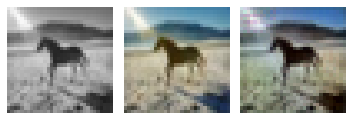

2020-11-08 12:27:06.433 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


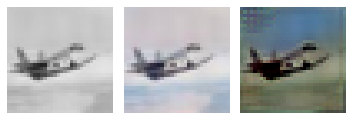

2020-11-08 12:27:06.618 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


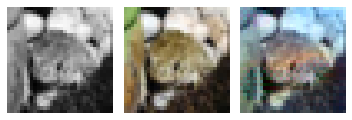

2020-11-08 12:27:06.749 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


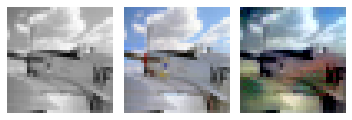

2020-11-08 12:27:06.885 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


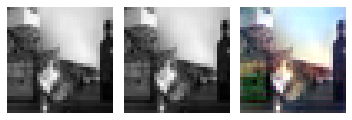

EPOCH: 51.505	trn_loss: 0.005	(4500.08s - 4237.08s remaining)

2020-11-08 12:27:26.829 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 51.510	trn_loss: 0.004	(4500.49s - 4236.60s remaining)

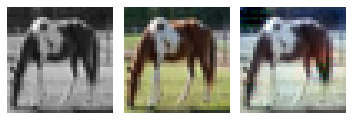

2020-11-08 12:27:26.971 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


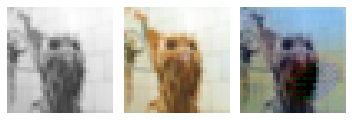

2020-11-08 12:27:27.106 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


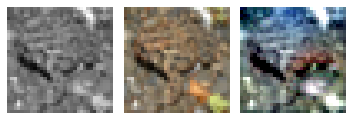

2020-11-08 12:27:27.242 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


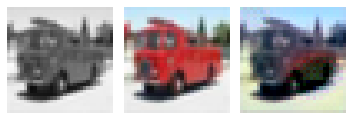

2020-11-08 12:27:27.442 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


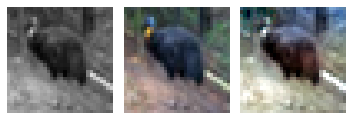

EPOCH: 51.760	trn_loss: 0.004	(4520.80s - 4213.32s remaining)

2020-11-08 12:27:47.537 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 51.765	trn_loss: 0.005	(4521.20s - 4212.84s remaining)

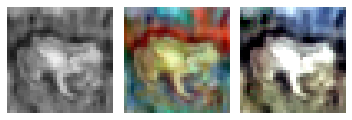

2020-11-08 12:27:47.659 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


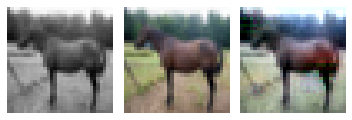

2020-11-08 12:27:47.793 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


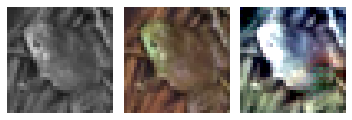

2020-11-08 12:27:47.925 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


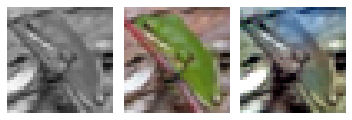

2020-11-08 12:27:48.053 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


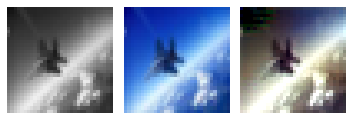

EPOCH: 51.950	val_loss: 0.005	(4545.96s - 4204.69s remaining)

2020-11-08 12:28:12.480 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 52.000	val_loss: 0.003	(4546.14s - 4196.44s remaining)

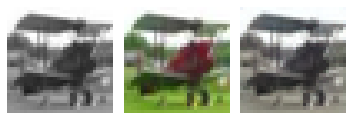

2020-11-08 12:28:12.597 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


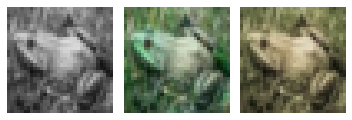

2020-11-08 12:28:12.721 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


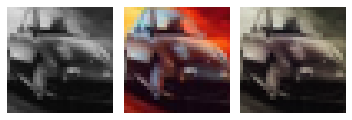

2020-11-08 12:28:12.845 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


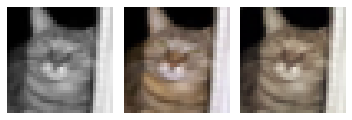

2020-11-08 12:28:12.971 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


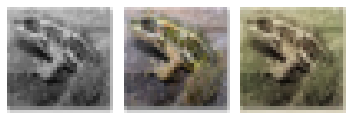

EPOCH: 52.250	trn_loss: 0.004	(4566.12s - 4172.87s remaining)

2020-11-08 12:28:32.846 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 52.255	trn_loss: 0.004	(4566.51s - 4172.37s remaining)

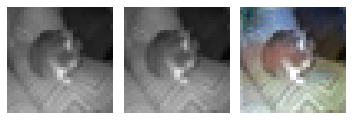

2020-11-08 12:28:32.966 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


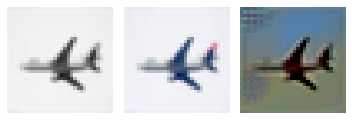

2020-11-08 12:28:33.156 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


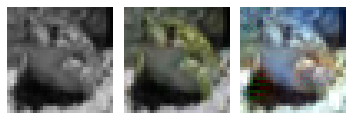

2020-11-08 12:28:33.283 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


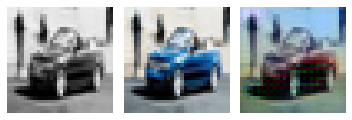

2020-11-08 12:28:33.452 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


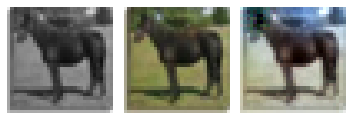

EPOCH: 52.505	trn_loss: 0.005	(4586.75s - 4149.07s remaining)

2020-11-08 12:28:53.494 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 52.510	trn_loss: 0.004	(4587.16s - 4148.59s remaining)

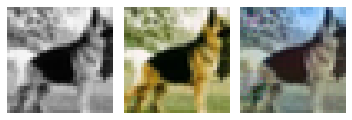

2020-11-08 12:28:53.618 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


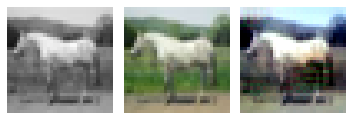

2020-11-08 12:28:53.758 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


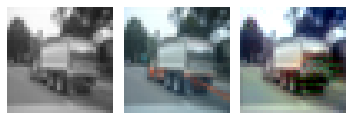

2020-11-08 12:28:53.888 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


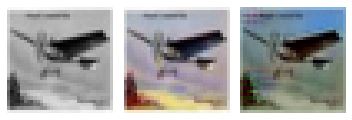

2020-11-08 12:28:54.094 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


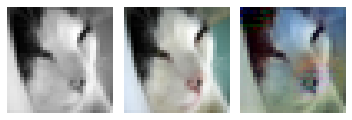

EPOCH: 52.760	trn_loss: 0.005	(4607.33s - 4125.26s remaining)

2020-11-08 12:29:14.066 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 52.765	trn_loss: 0.004	(4607.73s - 4124.77s remaining)

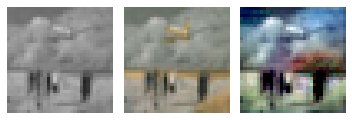

2020-11-08 12:29:14.186 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


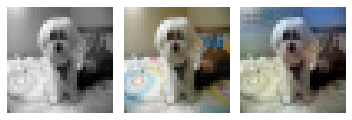

2020-11-08 12:29:14.313 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


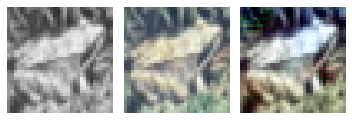

2020-11-08 12:29:14.445 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


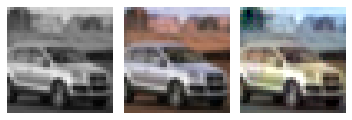

2020-11-08 12:29:14.570 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


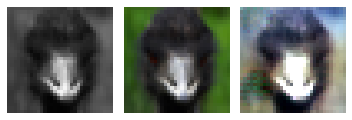

EPOCH: 52.950	val_loss: 0.005	(4632.47s - 4116.29s remaining)

2020-11-08 12:29:38.984 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 53.000	val_loss: 0.003	(4632.65s - 4108.20s remaining)

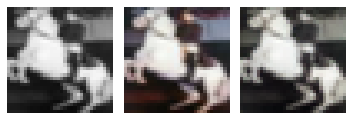

2020-11-08 12:29:39.098 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


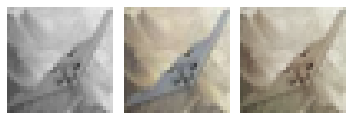

2020-11-08 12:29:39.230 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


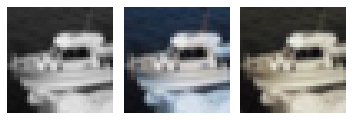

2020-11-08 12:29:39.350 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


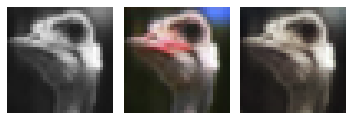

2020-11-08 12:29:39.473 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


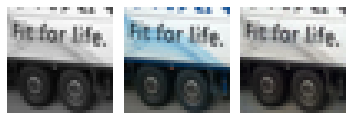

EPOCH: 53.250	trn_loss: 0.004	(4652.72s - 4084.78s remaining)

2020-11-08 12:29:59.444 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 53.255	trn_loss: 0.005	(4653.11s - 4084.29s remaining)

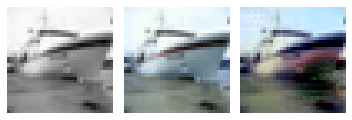

2020-11-08 12:29:59.567 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


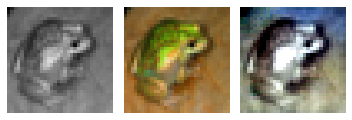

2020-11-08 12:29:59.762 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


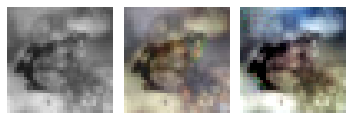

2020-11-08 12:29:59.891 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


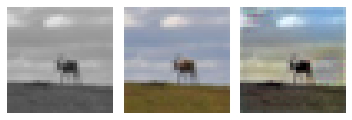

2020-11-08 12:30:00.025 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


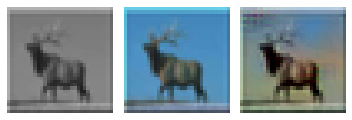

EPOCH: 53.505	trn_loss: 0.004	(4673.23s - 4060.95s remaining)

2020-11-08 12:30:19.959 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 53.510	trn_loss: 0.004	(4673.62s - 4060.46s remaining)

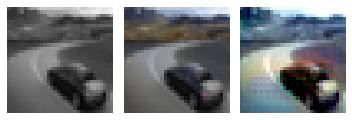

2020-11-08 12:30:20.083 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


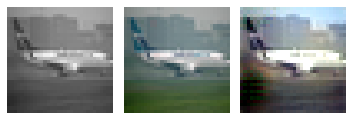

2020-11-08 12:30:20.211 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


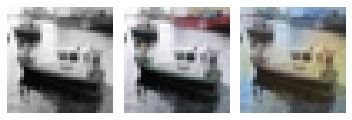

2020-11-08 12:30:20.346 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


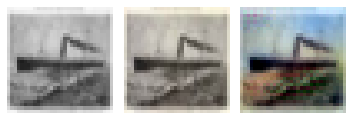

2020-11-08 12:30:20.532 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


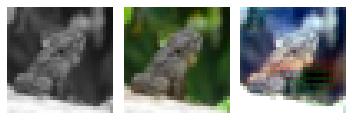

EPOCH: 53.760	trn_loss: 0.004	(4693.66s - 4037.07s remaining)

2020-11-08 12:30:40.383 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 53.765	trn_loss: 0.004	(4694.05s - 4036.58s remaining)

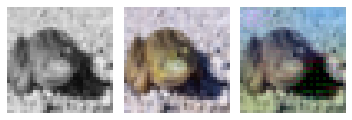

2020-11-08 12:30:40.500 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


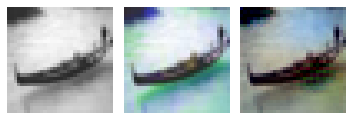

2020-11-08 12:30:40.633 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


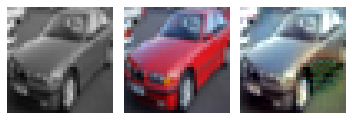

2020-11-08 12:30:40.759 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


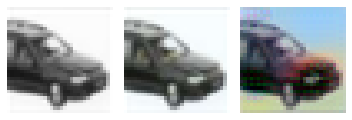

2020-11-08 12:30:40.886 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


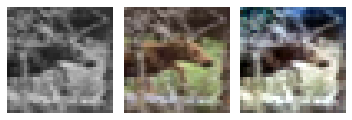

EPOCH: 53.950	val_loss: 0.005	(4718.73s - 4027.75s remaining)

2020-11-08 12:31:05.244 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 54.000	val_loss: 0.003	(4718.91s - 4019.81s remaining)

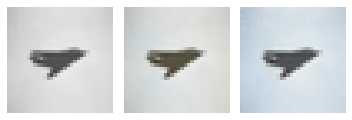

2020-11-08 12:31:05.359 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


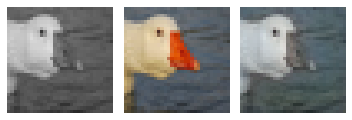

2020-11-08 12:31:05.482 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


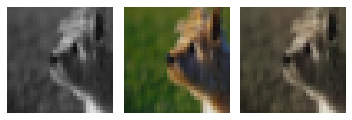

2020-11-08 12:31:05.606 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


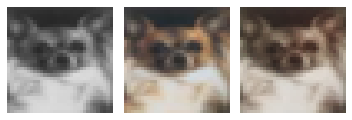

2020-11-08 12:31:05.740 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


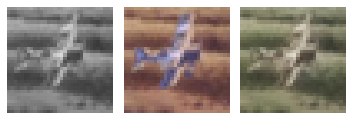

EPOCH: 54.250	trn_loss: 0.004	(4738.84s - 3996.35s remaining)

2020-11-08 12:31:25.567 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 54.255	trn_loss: 0.004	(4739.23s - 3995.86s remaining)

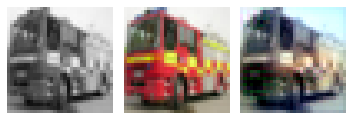

2020-11-08 12:31:25.685 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


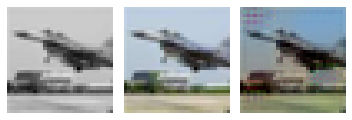

2020-11-08 12:31:25.874 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


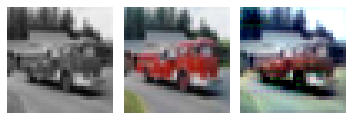

2020-11-08 12:31:26.001 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


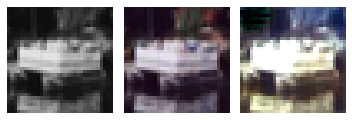

2020-11-08 12:31:26.126 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


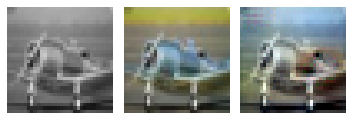

EPOCH: 54.505	trn_loss: 0.004	(4759.33s - 3972.57s remaining)

2020-11-08 12:31:46.066 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 54.510	trn_loss: 0.004	(4759.73s - 3972.09s remaining)

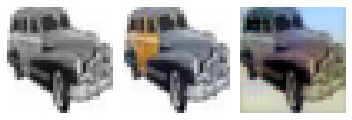

2020-11-08 12:31:46.191 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


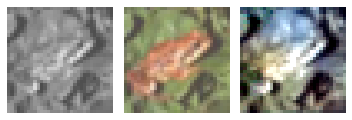

2020-11-08 12:31:46.319 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


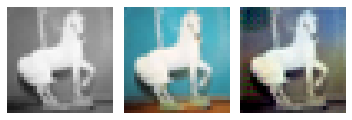

2020-11-08 12:31:46.449 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


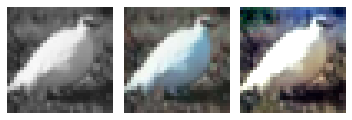

2020-11-08 12:31:46.637 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


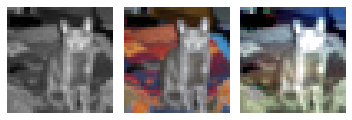

EPOCH: 54.760	trn_loss: 0.004	(4779.86s - 3948.85s remaining)

2020-11-08 12:32:06.592 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 54.765	trn_loss: 0.005	(4780.26s - 3948.37s remaining)

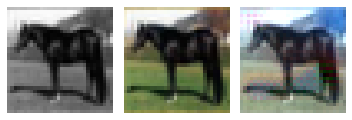

2020-11-08 12:32:06.710 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


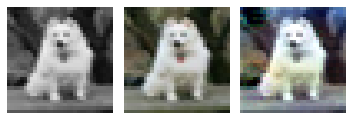

2020-11-08 12:32:06.840 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


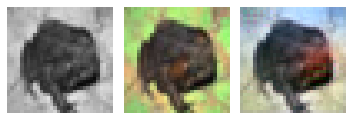

2020-11-08 12:32:06.979 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


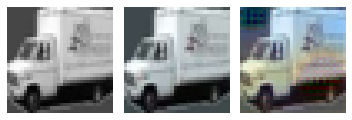

2020-11-08 12:32:07.114 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


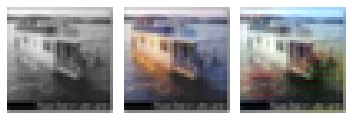

EPOCH: 54.950	val_loss: 0.005	(4805.05s - 3939.36s remaining)

2020-11-08 12:32:31.568 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 55.000	trn_loss: 0.004	val_loss: 0.005	(4805.23s - 3931.55s remaining)


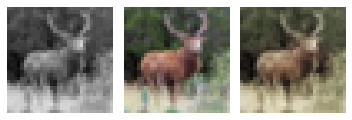

2020-11-08 12:32:31.680 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


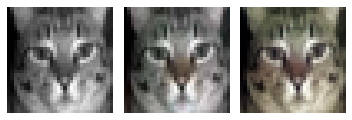

2020-11-08 12:32:31.804 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


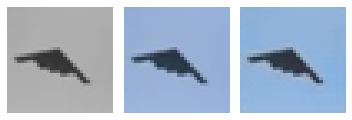

2020-11-08 12:32:31.928 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


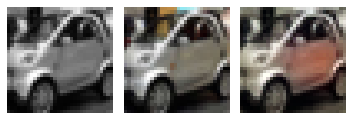

2020-11-08 12:32:32.052 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


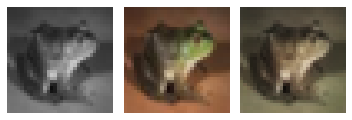

EPOCH: 55.250	trn_loss: 0.004	(4825.34s - 3908.31s remaining)

2020-11-08 12:32:52.067 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 55.255	trn_loss: 0.004	(4825.73s - 3907.82s remaining)

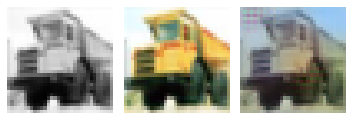

2020-11-08 12:32:52.187 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


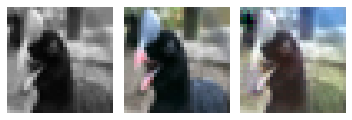

2020-11-08 12:32:52.377 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


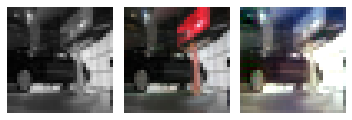

2020-11-08 12:32:52.508 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


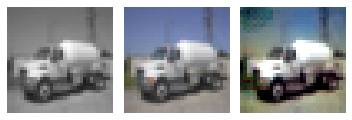

2020-11-08 12:32:52.637 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


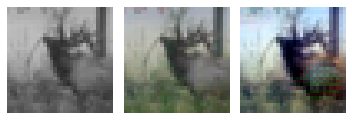

EPOCH: 55.505	trn_loss: 0.004	(4845.82s - 3884.58s remaining)

2020-11-08 12:33:12.561 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 55.510	trn_loss: 0.004	(4846.22s - 3884.11s remaining)

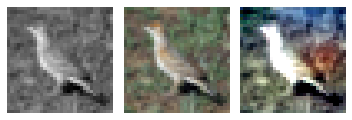

2020-11-08 12:33:12.692 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


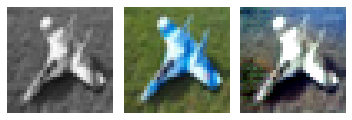

2020-11-08 12:33:12.841 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


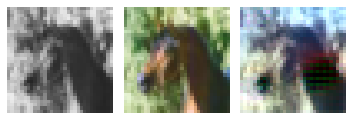

2020-11-08 12:33:12.986 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


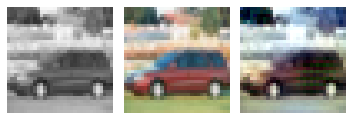

2020-11-08 12:33:13.183 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


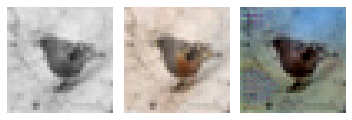

EPOCH: 55.760	trn_loss: 0.005	(4866.36s - 3860.94s remaining)

2020-11-08 12:33:33.097 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 55.765	trn_loss: 0.004	(4866.76s - 3860.46s remaining)

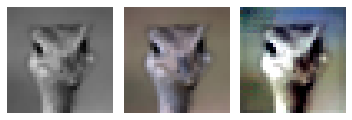

2020-11-08 12:33:33.218 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


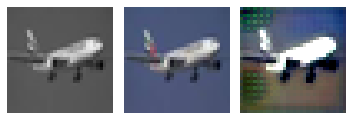

2020-11-08 12:33:33.356 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


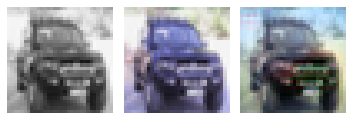

2020-11-08 12:33:33.488 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


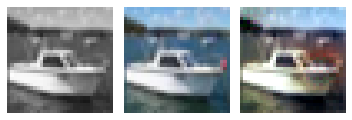

2020-11-08 12:33:33.619 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


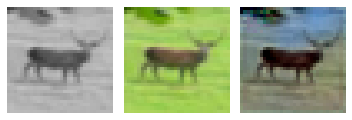

EPOCH: 55.950	val_loss: 0.005	(4891.62s - 3851.22s remaining)

2020-11-08 12:33:58.142 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 56.000	val_loss: 0.003	(4891.81s - 3843.56s remaining)

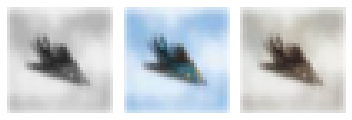

2020-11-08 12:33:58.269 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


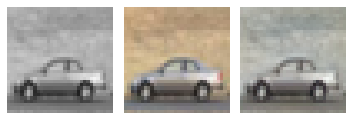

2020-11-08 12:33:58.393 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


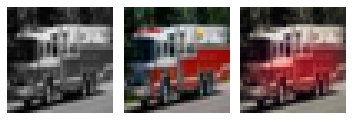

2020-11-08 12:33:58.521 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


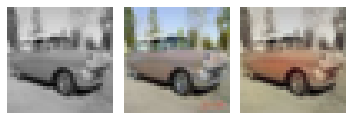

2020-11-08 12:33:58.646 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


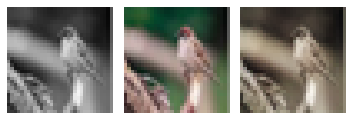

EPOCH: 56.250	trn_loss: 0.005	(4911.88s - 3820.35s remaining)

2020-11-08 12:34:18.611 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 56.255	trn_loss: 0.004	(4912.28s - 3819.87s remaining)

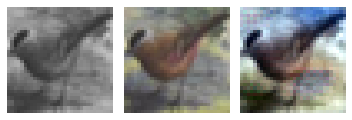

2020-11-08 12:34:18.731 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


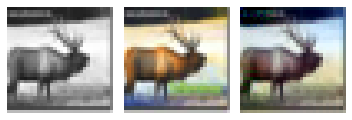

2020-11-08 12:34:18.924 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


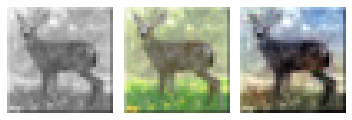

2020-11-08 12:34:19.058 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


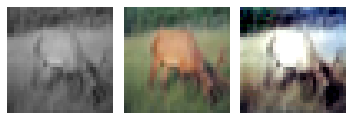

2020-11-08 12:34:19.196 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


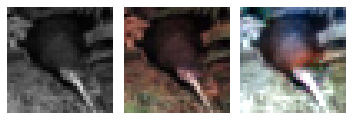

EPOCH: 56.505	trn_loss: 0.004	(4932.42s - 3796.74s remaining)

2020-11-08 12:34:39.160 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 56.510	trn_loss: 0.005	(4932.82s - 3796.26s remaining)

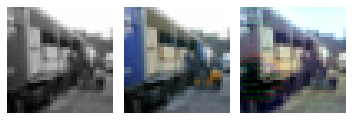

2020-11-08 12:34:39.277 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


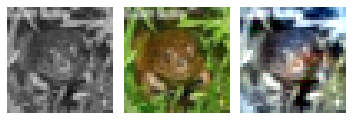

2020-11-08 12:34:39.410 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


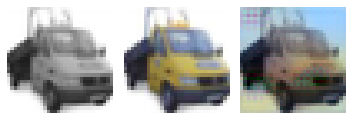

2020-11-08 12:34:39.535 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


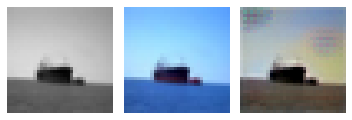

2020-11-08 12:34:39.719 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


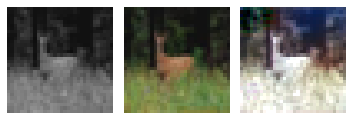

EPOCH: 56.760	trn_loss: 0.004	(4952.89s - 3773.10s remaining)

2020-11-08 12:34:59.616 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 56.765	trn_loss: 0.005	(4953.28s - 3772.61s remaining)

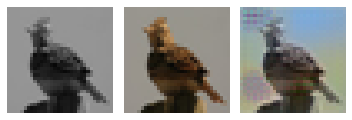

2020-11-08 12:34:59.733 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


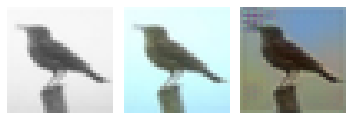

2020-11-08 12:34:59.857 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


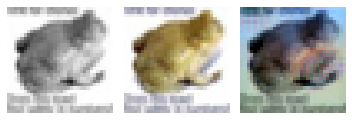

2020-11-08 12:34:59.987 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


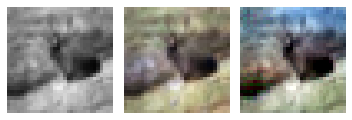

2020-11-08 12:35:00.117 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


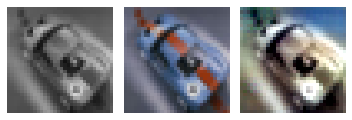

EPOCH: 56.950	val_loss: 0.005	(4978.11s - 3763.08s remaining)

2020-11-08 12:35:24.639 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 57.000	val_loss: 0.003	(4978.30s - 3755.56s remaining)

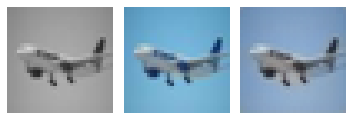

2020-11-08 12:35:24.767 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


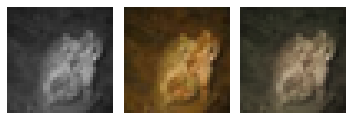

2020-11-08 12:35:24.900 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


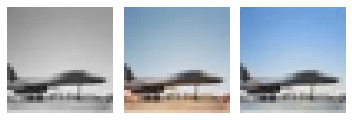

2020-11-08 12:35:25.035 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


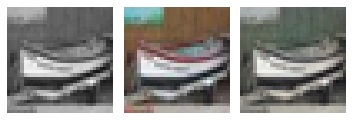

2020-11-08 12:35:25.167 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


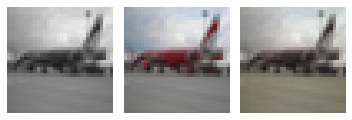

EPOCH: 57.250	trn_loss: 0.005	(4998.36s - 3732.40s remaining)

2020-11-08 12:35:45.086 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 57.255	trn_loss: 0.004	(4998.75s - 3731.91s remaining)

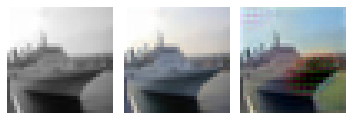

2020-11-08 12:35:45.206 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


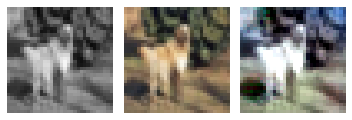

2020-11-08 12:35:45.389 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


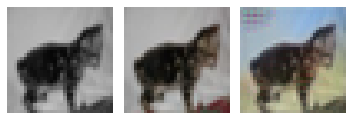

2020-11-08 12:35:45.514 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


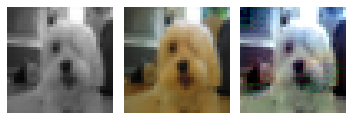

2020-11-08 12:35:45.648 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


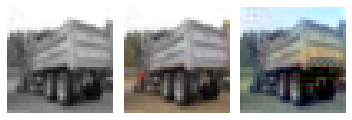

EPOCH: 57.505	trn_loss: 0.004	(5018.80s - 3708.78s remaining)

2020-11-08 12:36:05.544 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 57.510	trn_loss: 0.005	(5019.21s - 3708.30s remaining)

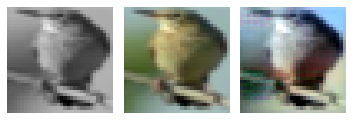

2020-11-08 12:36:05.665 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


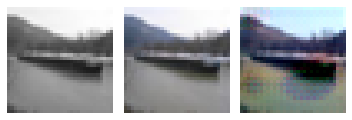

2020-11-08 12:36:05.804 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


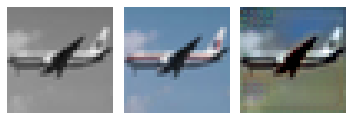

2020-11-08 12:36:05.928 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


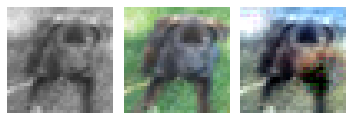

2020-11-08 12:36:06.113 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


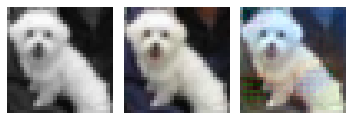

EPOCH: 57.760	trn_loss: 0.005	(5039.28s - 3685.20s remaining)

2020-11-08 12:36:26.008 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 57.765	trn_loss: 0.004	(5039.67s - 3684.72s remaining)

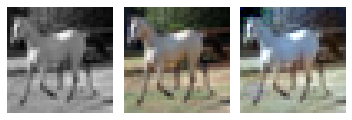

2020-11-08 12:36:26.134 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


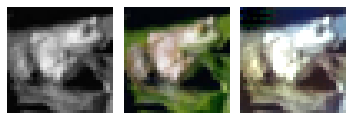

2020-11-08 12:36:26.270 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


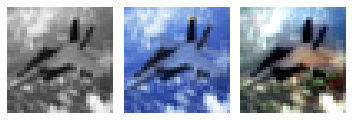

2020-11-08 12:36:26.396 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


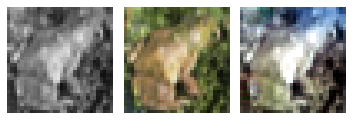

2020-11-08 12:36:26.521 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


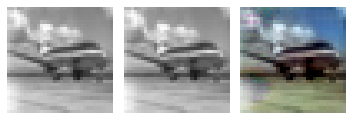

EPOCH: 57.950	val_loss: 0.005	(5064.36s - 3674.83s remaining)

2020-11-08 12:36:50.875 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 58.000	val_loss: 0.003	(5064.54s - 3667.43s remaining)

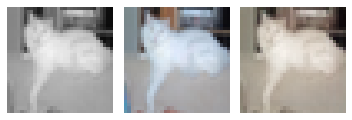

2020-11-08 12:36:50.991 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


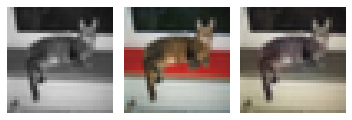

2020-11-08 12:36:51.116 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


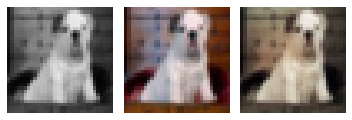

2020-11-08 12:36:51.239 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


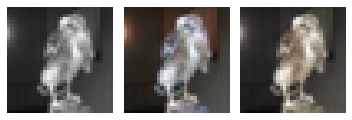

2020-11-08 12:36:51.375 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


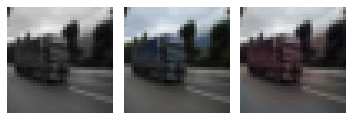

EPOCH: 58.250	trn_loss: 0.004	(5084.57s - 3644.31s remaining)

2020-11-08 12:37:11.303 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 58.255	trn_loss: 0.005	(5084.97s - 3643.83s remaining)

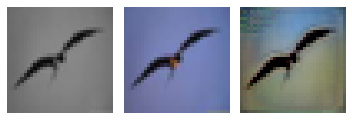

2020-11-08 12:37:11.422 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


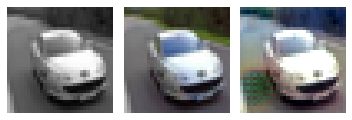

2020-11-08 12:37:11.609 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


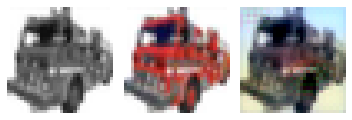

2020-11-08 12:37:11.740 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


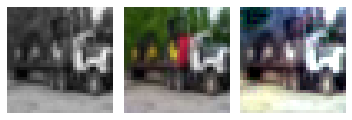

2020-11-08 12:37:11.866 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


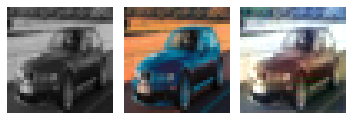

EPOCH: 58.505	trn_loss: 0.004	(5105.08s - 3620.79s remaining)

2020-11-08 12:37:31.810 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 58.510	trn_loss: 0.004	(5105.48s - 3620.31s remaining)

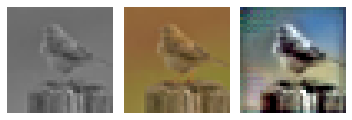

2020-11-08 12:37:31.931 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


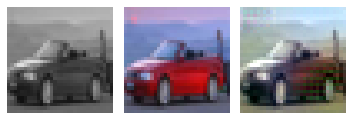

2020-11-08 12:37:32.062 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


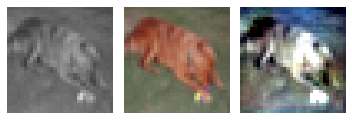

2020-11-08 12:37:32.190 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


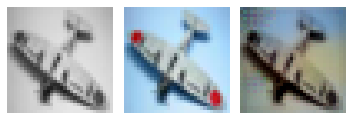

2020-11-08 12:37:32.376 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


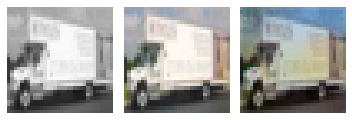

EPOCH: 58.760	trn_loss: 0.004	(5125.52s - 3597.26s remaining)

2020-11-08 12:37:52.254 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 58.765	trn_loss: 0.004	(5125.92s - 3596.78s remaining)

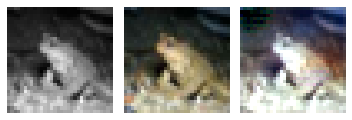

2020-11-08 12:37:52.388 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


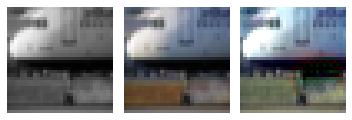

2020-11-08 12:37:52.526 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


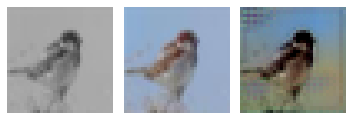

2020-11-08 12:37:52.664 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


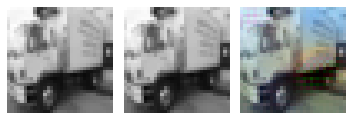

2020-11-08 12:37:52.802 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


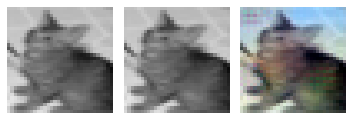

EPOCH: 58.950	val_loss: 0.005	(5150.88s - 3586.83s remaining)

2020-11-08 12:38:17.397 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 59.000	val_loss: 0.003	(5151.06s - 3579.55s remaining)

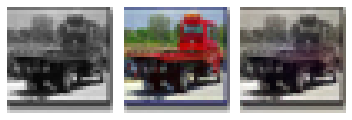

2020-11-08 12:38:17.512 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


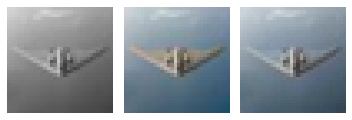

2020-11-08 12:38:17.637 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


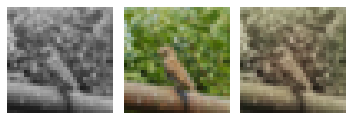

2020-11-08 12:38:17.765 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


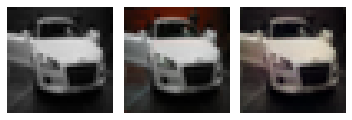

2020-11-08 12:38:17.898 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


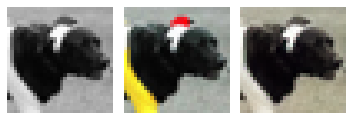

EPOCH: 59.250	trn_loss: 0.005	(5171.08s - 3556.48s remaining)

2020-11-08 12:38:37.820 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 59.255	trn_loss: 0.004	(5171.48s - 3556.01s remaining)

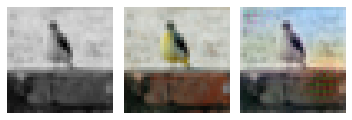

2020-11-08 12:38:37.948 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


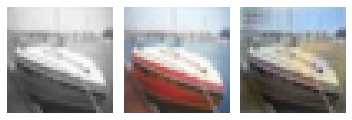

2020-11-08 12:38:38.145 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


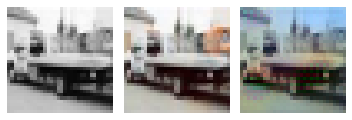

2020-11-08 12:38:38.270 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


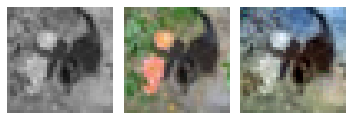

2020-11-08 12:38:38.400 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


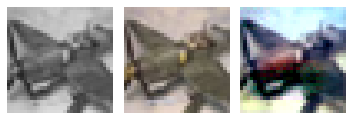

EPOCH: 59.505	trn_loss: 0.004	(5191.59s - 3533.02s remaining)

2020-11-08 12:38:58.314 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 59.510	trn_loss: 0.004	(5191.98s - 3532.54s remaining)

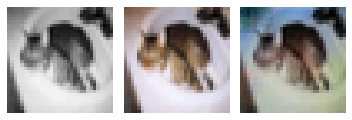

2020-11-08 12:38:58.437 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


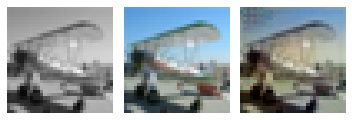

2020-11-08 12:38:58.567 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


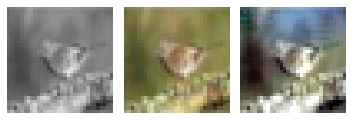

2020-11-08 12:38:58.697 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


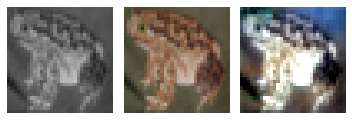

2020-11-08 12:38:58.895 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


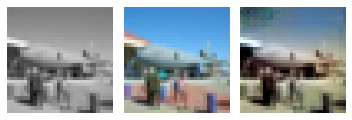

EPOCH: 59.760	trn_loss: 0.004	(5212.09s - 3509.59s remaining)

2020-11-08 12:39:18.817 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 59.765	trn_loss: 0.004	(5212.48s - 3509.10s remaining)

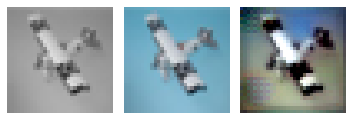

2020-11-08 12:39:18.947 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


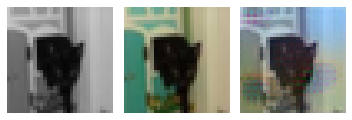

2020-11-08 12:39:19.078 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


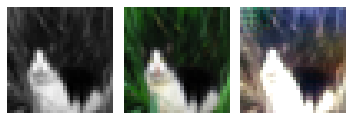

2020-11-08 12:39:19.209 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


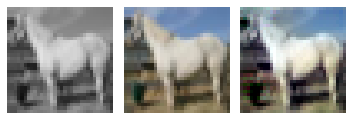

2020-11-08 12:39:19.342 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


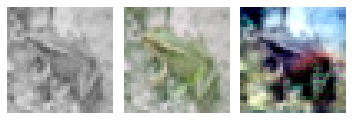

EPOCH: 59.950	val_loss: 0.005	(5237.31s - 3498.82s remaining)

2020-11-08 12:39:43.824 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 60.000	trn_loss: 0.004	val_loss: 0.005	(5237.49s - 3491.66s remaining)


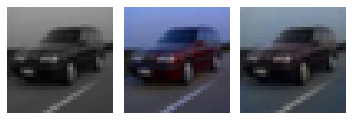

2020-11-08 12:39:43.942 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


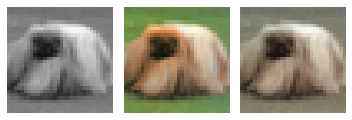

2020-11-08 12:39:44.066 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


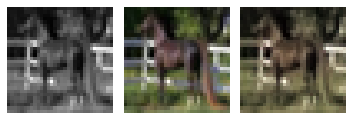

2020-11-08 12:39:44.197 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


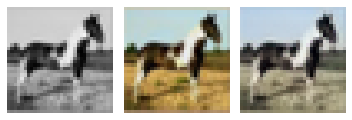

2020-11-08 12:39:44.330 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


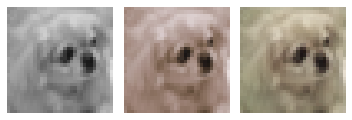

EPOCH: 60.250	trn_loss: 0.005	(5257.49s - 3468.63s remaining)

2020-11-08 12:40:04.241 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 60.255	trn_loss: 0.004	(5257.91s - 3468.17s remaining)

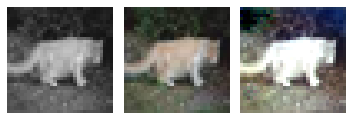

2020-11-08 12:40:04.359 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


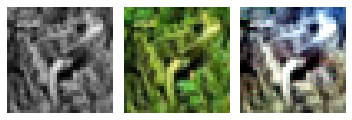

2020-11-08 12:40:04.545 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


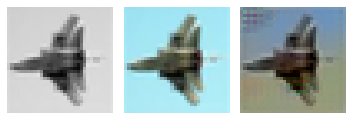

2020-11-08 12:40:04.674 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


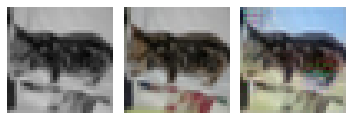

2020-11-08 12:40:04.798 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


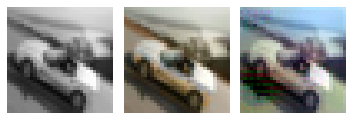

EPOCH: 60.505	trn_loss: 0.004	(5277.92s - 3445.18s remaining)

2020-11-08 12:40:24.649 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 60.510	trn_loss: 0.004	(5278.31s - 3444.70s remaining)

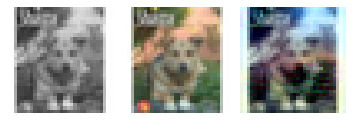

2020-11-08 12:40:24.779 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


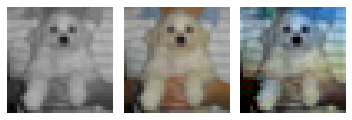

2020-11-08 12:40:24.914 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


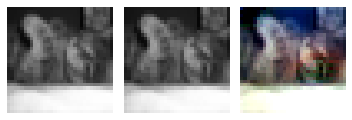

2020-11-08 12:40:25.045 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


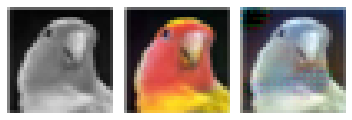

2020-11-08 12:40:25.238 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


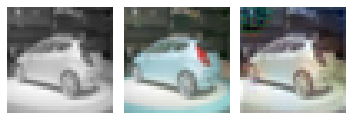

EPOCH: 60.760	trn_loss: 0.004	(5298.38s - 3421.77s remaining)

2020-11-08 12:40:45.110 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 60.765	trn_loss: 0.004	(5298.77s - 3421.29s remaining)

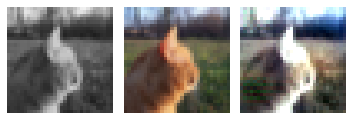

2020-11-08 12:40:45.232 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


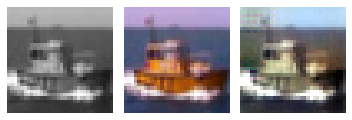

2020-11-08 12:40:45.360 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


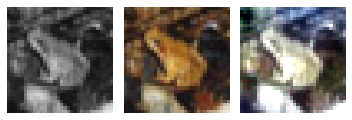

2020-11-08 12:40:45.488 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


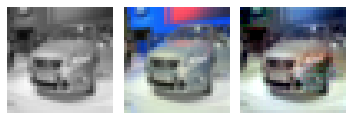

2020-11-08 12:40:45.616 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


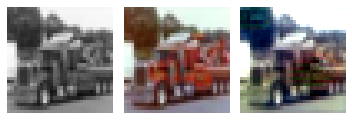

EPOCH: 60.950	val_loss: 0.005	(5323.49s - 3410.70s remaining)

2020-11-08 12:41:10.010 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 61.000	val_loss: 0.003	(5323.68s - 3403.66s remaining)

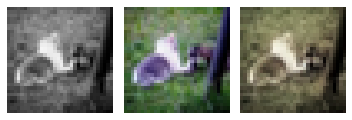

2020-11-08 12:41:10.128 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


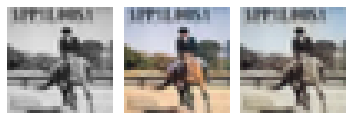

2020-11-08 12:41:10.252 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


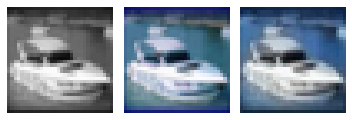

2020-11-08 12:41:10.380 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


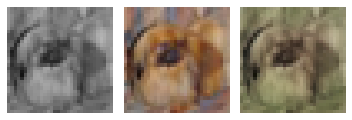

2020-11-08 12:41:10.502 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


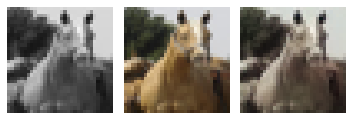

EPOCH: 61.250	trn_loss: 0.004	(5343.76s - 3380.74s remaining)

2020-11-08 12:41:30.485 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 61.255	trn_loss: 0.005	(5344.15s - 3380.27s remaining)

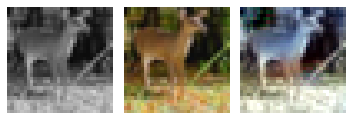

2020-11-08 12:41:30.612 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


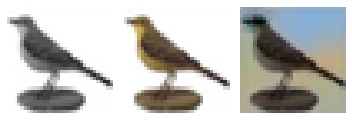

2020-11-08 12:41:30.798 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


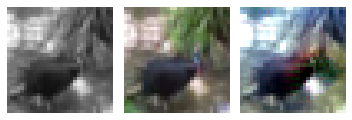

2020-11-08 12:41:30.927 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


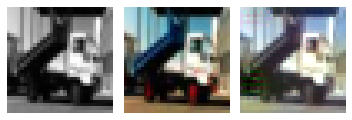

2020-11-08 12:41:31.060 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


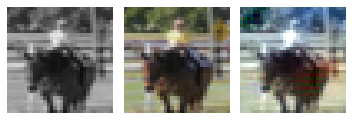

EPOCH: 61.505	trn_loss: 0.004	(5364.22s - 3357.36s remaining)

2020-11-08 12:41:50.957 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 61.510	trn_loss: 0.004	(5364.62s - 3356.89s remaining)

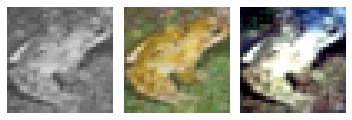

2020-11-08 12:41:51.089 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


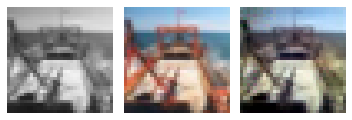

2020-11-08 12:41:51.227 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


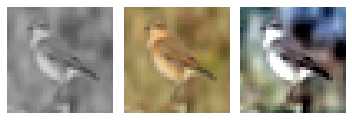

2020-11-08 12:41:51.363 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


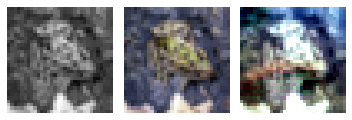

2020-11-08 12:41:51.561 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


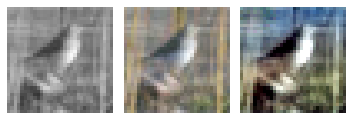

EPOCH: 61.760	trn_loss: 0.005	(5384.75s - 3334.05s remaining)

2020-11-08 12:42:11.473 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 61.765	trn_loss: 0.005	(5385.14s - 3333.57s remaining)

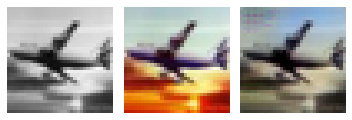

2020-11-08 12:42:11.593 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


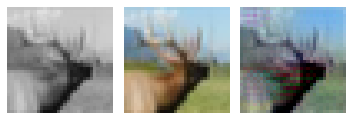

2020-11-08 12:42:11.721 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


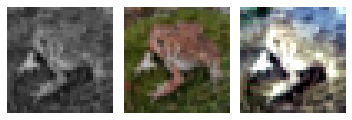

2020-11-08 12:42:11.851 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


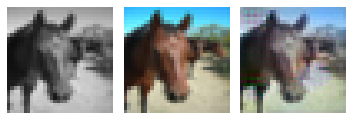

2020-11-08 12:42:11.985 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


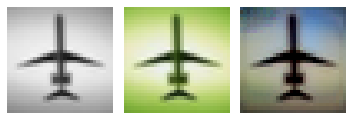

EPOCH: 61.950	val_loss: 0.005	(5410.02s - 3322.86s remaining)

2020-11-08 12:42:36.539 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 62.000	val_loss: 0.003	(5410.20s - 3315.93s remaining)

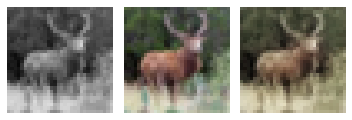

2020-11-08 12:42:36.652 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


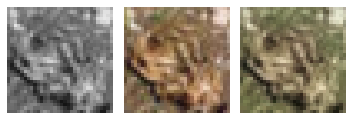

2020-11-08 12:42:36.775 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


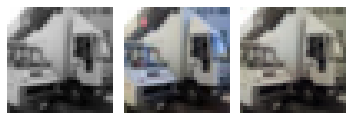

2020-11-08 12:42:36.901 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


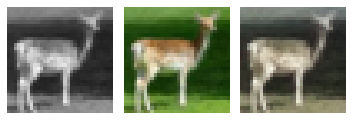

2020-11-08 12:42:37.025 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


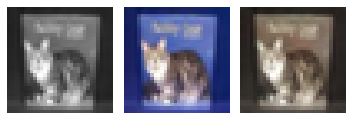

EPOCH: 62.250	trn_loss: 0.004	(5430.18s - 3293.00s remaining)

2020-11-08 12:42:56.907 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 62.255	trn_loss: 0.004	(5430.57s - 3292.52s remaining)

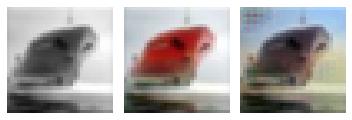

2020-11-08 12:42:57.027 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


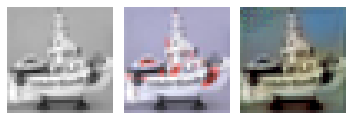

2020-11-08 12:42:57.221 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


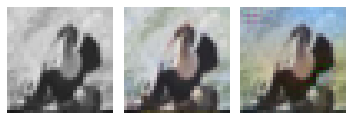

2020-11-08 12:42:57.343 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


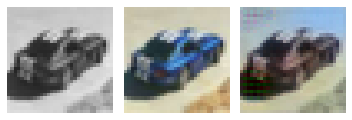

2020-11-08 12:42:57.472 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


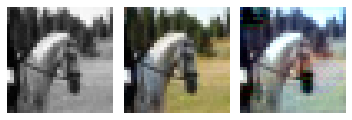

EPOCH: 62.505	trn_loss: 0.004	(5450.56s - 3269.63s remaining)

2020-11-08 12:43:17.290 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 62.510	trn_loss: 0.005	(5450.95s - 3269.15s remaining)

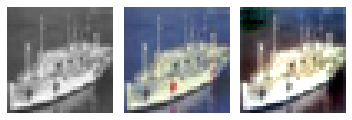

2020-11-08 12:43:17.409 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


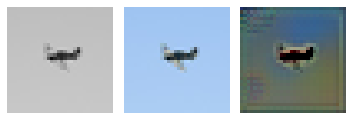

2020-11-08 12:43:17.537 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


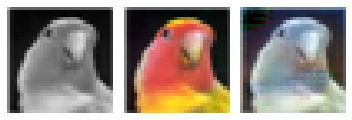

2020-11-08 12:43:17.665 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


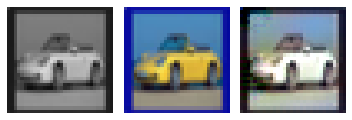

2020-11-08 12:43:17.858 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


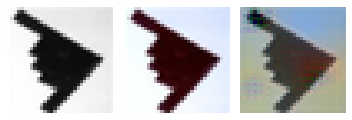

EPOCH: 62.760	trn_loss: 0.004	(5470.97s - 3246.29s remaining)

2020-11-08 12:43:37.702 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 62.765	trn_loss: 0.004	(5471.37s - 3245.82s remaining)

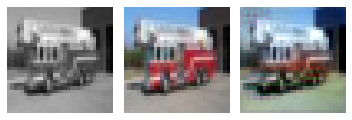

2020-11-08 12:43:37.827 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


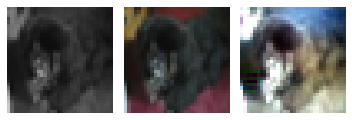

2020-11-08 12:43:37.959 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


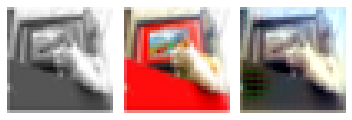

2020-11-08 12:43:38.089 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


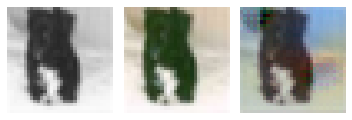

2020-11-08 12:43:38.225 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


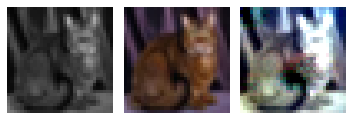

EPOCH: 62.950	val_loss: 0.005	(5496.12s - 3234.81s remaining)

2020-11-08 12:44:02.648 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 63.000	val_loss: 0.003	(5496.31s - 3227.99s remaining)

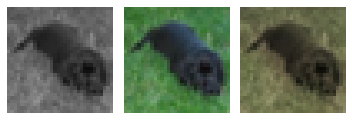

2020-11-08 12:44:02.774 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


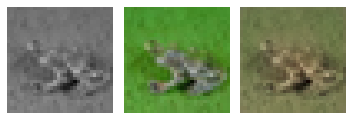

2020-11-08 12:44:02.910 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


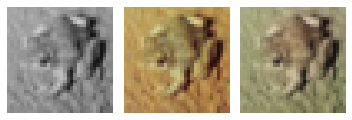

2020-11-08 12:44:03.049 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


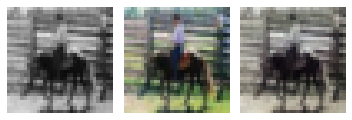

2020-11-08 12:44:03.180 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


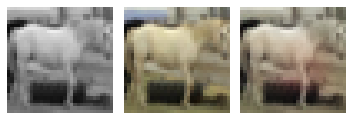

EPOCH: 63.250	trn_loss: 0.004	(5516.38s - 3205.17s remaining)

2020-11-08 12:44:23.108 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 63.255	trn_loss: 0.005	(5516.77s - 3204.69s remaining)

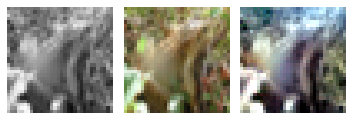

2020-11-08 12:44:23.228 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


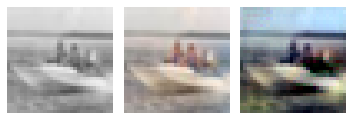

2020-11-08 12:44:23.415 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


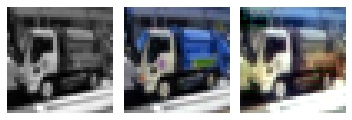

2020-11-08 12:44:23.542 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


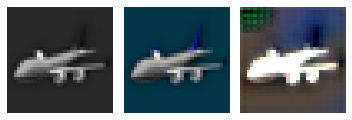

2020-11-08 12:44:23.680 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


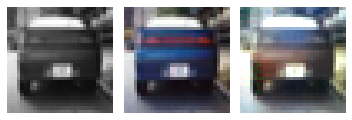

EPOCH: 63.505	trn_loss: 0.004	(5536.93s - 3181.94s remaining)

2020-11-08 12:44:43.672 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 63.510	trn_loss: 0.004	(5537.33s - 3181.48s remaining)

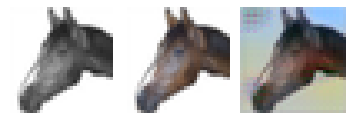

2020-11-08 12:44:43.811 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


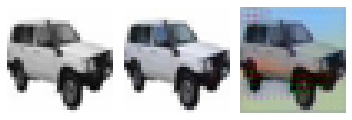

2020-11-08 12:44:43.954 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


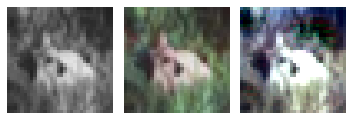

2020-11-08 12:44:44.091 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


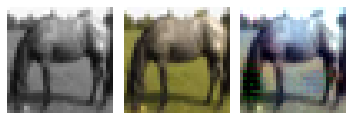

2020-11-08 12:44:44.290 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


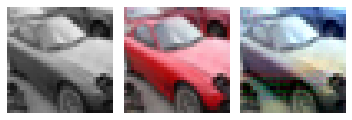

EPOCH: 63.760	trn_loss: 0.004	(5557.53s - 3158.77s remaining)

2020-11-08 12:45:04.273 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 63.765	trn_loss: 0.005	(5557.94s - 3158.30s remaining)

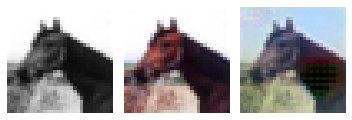

2020-11-08 12:45:04.392 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


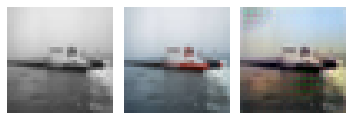

2020-11-08 12:45:04.520 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


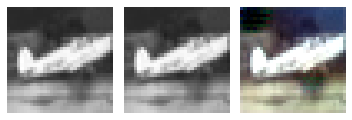

2020-11-08 12:45:04.645 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


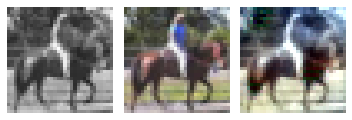

2020-11-08 12:45:04.770 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


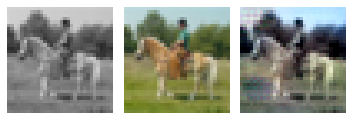

EPOCH: 63.950	val_loss: 0.005	(5582.75s - 3147.12s remaining)

2020-11-08 12:45:29.277 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 64.000	val_loss: 0.003	(5582.94s - 3140.40s remaining)

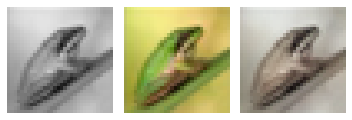

2020-11-08 12:45:29.410 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


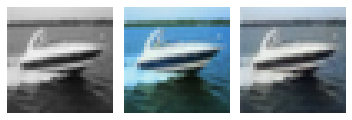

2020-11-08 12:45:29.552 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


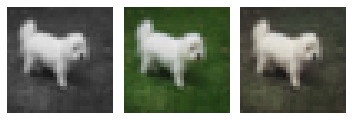

2020-11-08 12:45:29.692 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


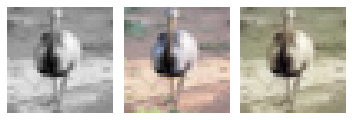

2020-11-08 12:45:29.827 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


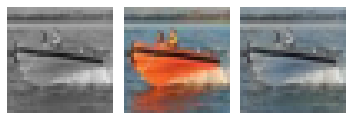

EPOCH: 64.250	trn_loss: 0.004	(5603.28s - 3117.78s remaining)

2020-11-08 12:45:50.023 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 64.255	trn_loss: 0.004	(5603.69s - 3117.31s remaining)

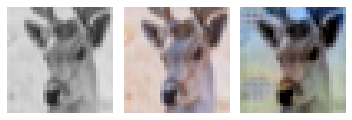

2020-11-08 12:45:50.158 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


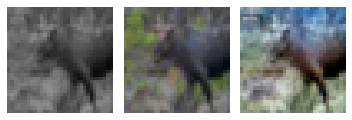

2020-11-08 12:45:50.343 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


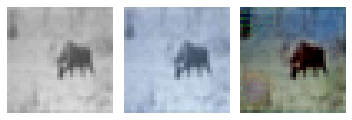

2020-11-08 12:45:50.475 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


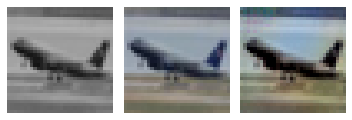

2020-11-08 12:45:50.603 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


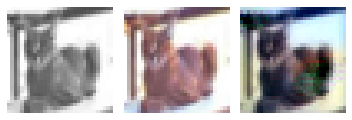

EPOCH: 64.505	trn_loss: 0.005	(5624.49s - 3094.96s remaining)

2020-11-08 12:46:11.234 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 64.510	trn_loss: 0.004	(5624.90s - 3094.49s remaining)

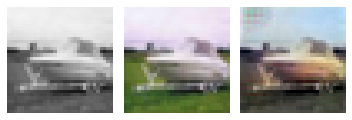

2020-11-08 12:46:11.357 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


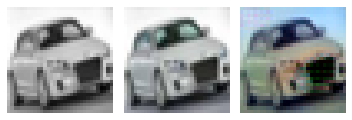

2020-11-08 12:46:11.487 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


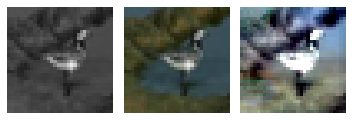

2020-11-08 12:46:11.614 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


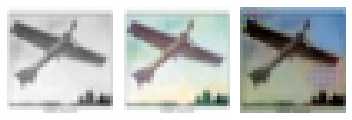

2020-11-08 12:46:11.801 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


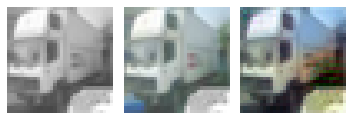

EPOCH: 64.760	trn_loss: 0.005	(5645.46s - 3072.02s remaining)

2020-11-08 12:46:32.190 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 64.765	trn_loss: 0.004	(5645.85s - 3071.55s remaining)

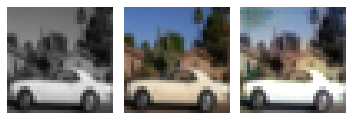

2020-11-08 12:46:32.314 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


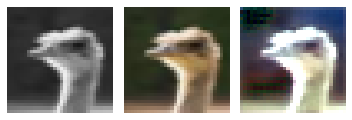

2020-11-08 12:46:32.447 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


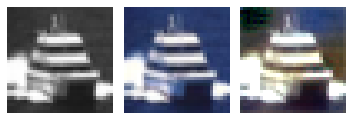

2020-11-08 12:46:32.574 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


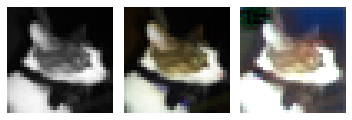

2020-11-08 12:46:32.705 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


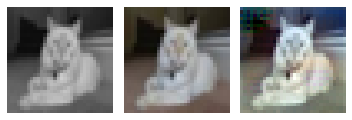

EPOCH: 64.950	val_loss: 0.005	(5671.12s - 3060.40s remaining)

2020-11-08 12:46:57.650 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 65.000	trn_loss: 0.004	val_loss: 0.005	(5671.31s - 3053.78s remaining)


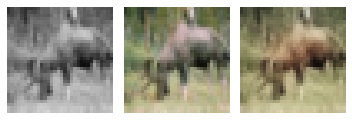

2020-11-08 12:46:57.769 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


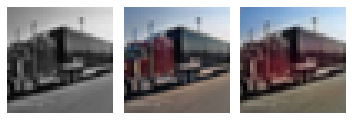

2020-11-08 12:46:57.898 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


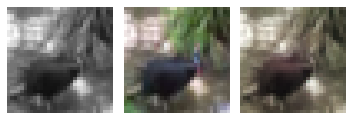

2020-11-08 12:46:58.034 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


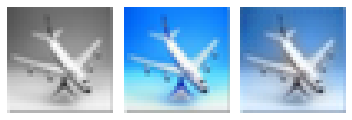

2020-11-08 12:46:58.163 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


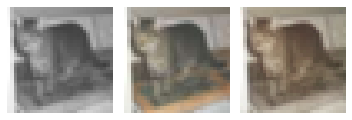

EPOCH: 65.250	trn_loss: 0.004	(5691.77s - 3031.25s remaining)

2020-11-08 12:47:18.517 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 65.255	trn_loss: 0.005	(5692.18s - 3030.79s remaining)

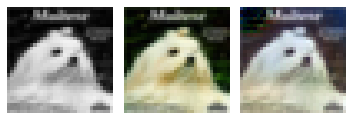

2020-11-08 12:47:18.636 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


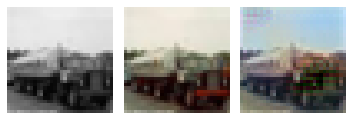

2020-11-08 12:47:18.832 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


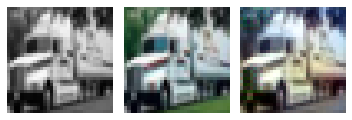

2020-11-08 12:47:18.959 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


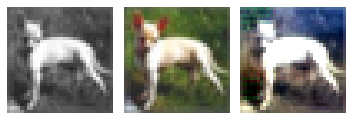

2020-11-08 12:47:19.090 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


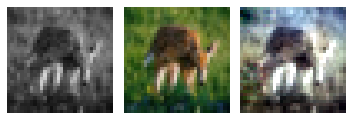

EPOCH: 65.505	trn_loss: 0.004	(5712.77s - 3008.34s remaining)

2020-11-08 12:47:39.509 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 65.510	trn_loss: 0.004	(5713.17s - 3007.87s remaining)

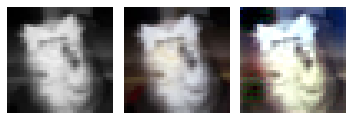

2020-11-08 12:47:39.634 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


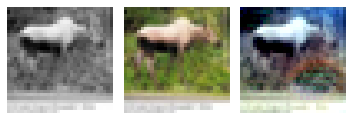

2020-11-08 12:47:39.766 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


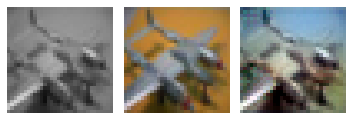

2020-11-08 12:47:39.903 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


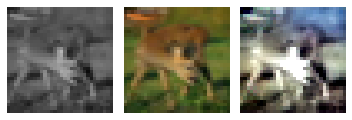

2020-11-08 12:47:40.101 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


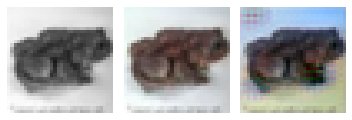

EPOCH: 65.760	trn_loss: 0.005	(5733.79s - 2985.45s remaining)

2020-11-08 12:48:00.526 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 65.765	trn_loss: 0.004	(5734.19s - 2984.98s remaining)

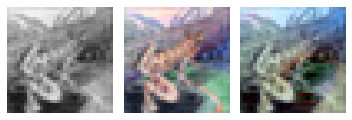

2020-11-08 12:48:00.651 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


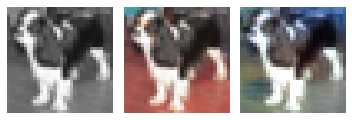

2020-11-08 12:48:00.788 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


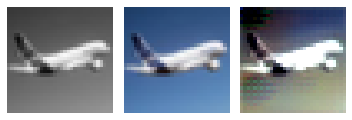

2020-11-08 12:48:00.921 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


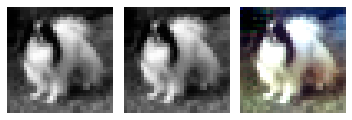

2020-11-08 12:48:01.057 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


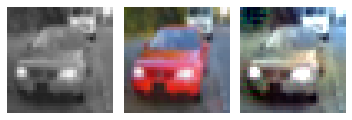

EPOCH: 65.950	val_loss: 0.005	(5759.61s - 2973.69s remaining)

2020-11-08 12:48:26.137 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 66.000	val_loss: 0.003	(5759.80s - 2967.17s remaining)

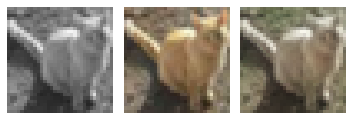

2020-11-08 12:48:26.267 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


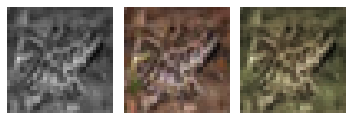

2020-11-08 12:48:26.395 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


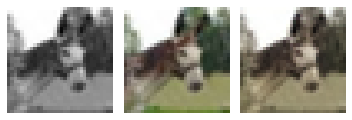

2020-11-08 12:48:26.528 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


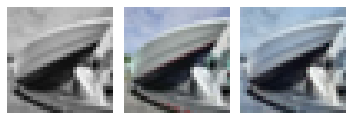

2020-11-08 12:48:26.662 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


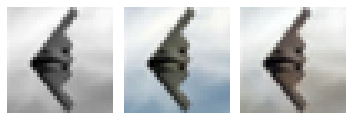

EPOCH: 66.250	trn_loss: 0.004	(5780.36s - 2944.71s remaining)

2020-11-08 12:48:47.100 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 66.255	trn_loss: 0.005	(5780.76s - 2944.25s remaining)

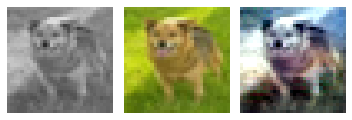

2020-11-08 12:48:47.224 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


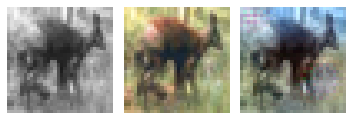

2020-11-08 12:48:47.429 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


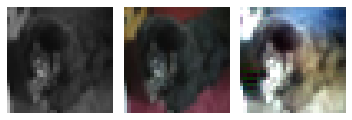

2020-11-08 12:48:47.562 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


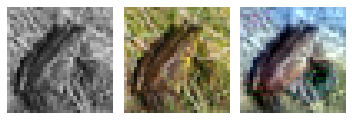

2020-11-08 12:48:47.700 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


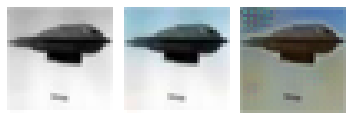

EPOCH: 66.505	trn_loss: 0.005	(5801.44s - 2921.86s remaining)

2020-11-08 12:49:08.191 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 66.510	trn_loss: 0.004	(5801.85s - 2921.40s remaining)

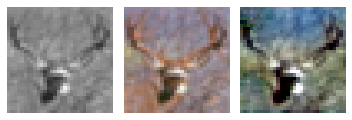

2020-11-08 12:49:08.328 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


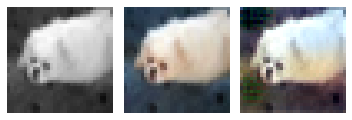

2020-11-08 12:49:08.474 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


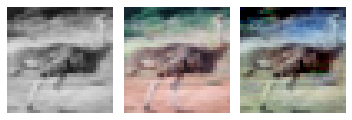

2020-11-08 12:49:08.615 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


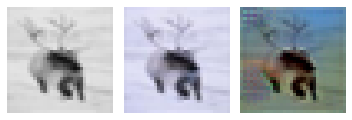

2020-11-08 12:49:08.821 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


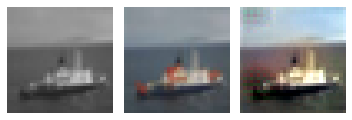

EPOCH: 66.760	trn_loss: 0.004	(5822.57s - 2899.05s remaining)

2020-11-08 12:49:29.329 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 66.765	trn_loss: 0.004	(5822.99s - 2898.59s remaining)

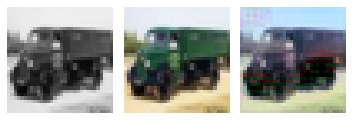

2020-11-08 12:49:29.481 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


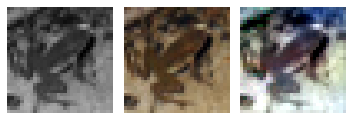

2020-11-08 12:49:29.622 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


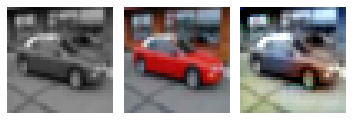

2020-11-08 12:49:29.765 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


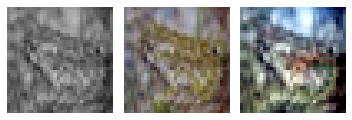

2020-11-08 12:49:29.913 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


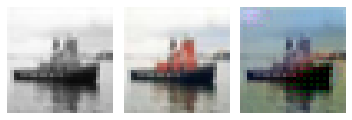

EPOCH: 66.950	val_loss: 0.005	(5848.48s - 2887.12s remaining)

2020-11-08 12:49:55.004 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 67.000	val_loss: 0.003	(5848.67s - 2880.69s remaining)

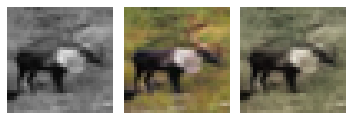

2020-11-08 12:49:55.125 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


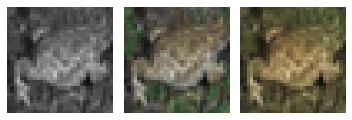

2020-11-08 12:49:55.255 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


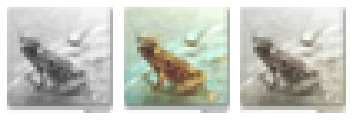

2020-11-08 12:49:55.386 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


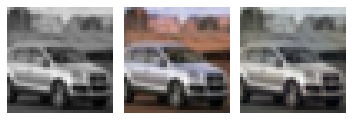

2020-11-08 12:49:55.516 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


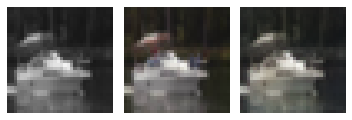

EPOCH: 67.250	trn_loss: 0.004	(5869.23s - 2858.25s remaining)

2020-11-08 12:50:15.983 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 67.255	trn_loss: 0.005	(5869.65s - 2857.79s remaining)

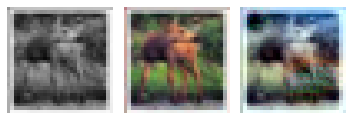

2020-11-08 12:50:16.142 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


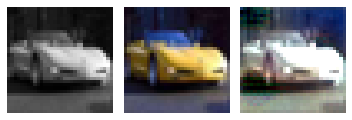

2020-11-08 12:50:16.336 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


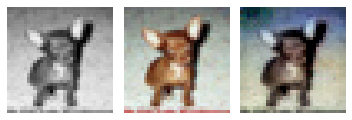

2020-11-08 12:50:16.470 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


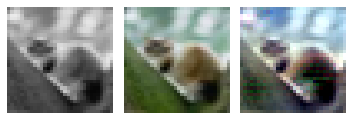

2020-11-08 12:50:16.614 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


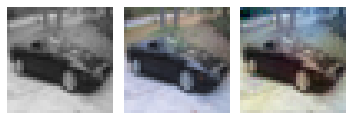

EPOCH: 67.505	trn_loss: 0.004	(5890.37s - 2835.44s remaining)

2020-11-08 12:50:37.104 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 67.510	trn_loss: 0.005	(5890.77s - 2834.98s remaining)

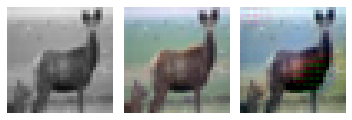

2020-11-08 12:50:37.232 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


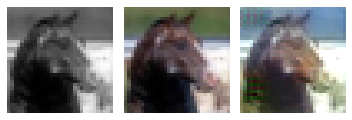

2020-11-08 12:50:37.379 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


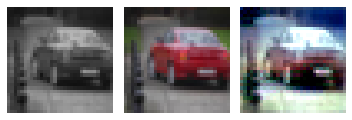

2020-11-08 12:50:37.511 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


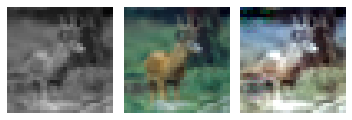

2020-11-08 12:50:37.717 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


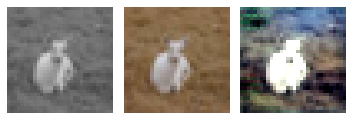

EPOCH: 67.760	trn_loss: 0.004	(5911.39s - 2812.60s remaining)

2020-11-08 12:50:58.137 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 67.765	trn_loss: 0.004	(5911.80s - 2812.13s remaining)

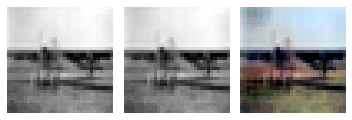

2020-11-08 12:50:58.276 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


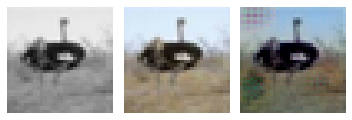

2020-11-08 12:50:58.407 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


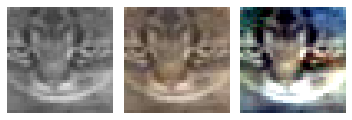

2020-11-08 12:50:58.553 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


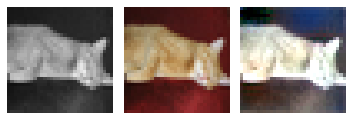

2020-11-08 12:50:58.704 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


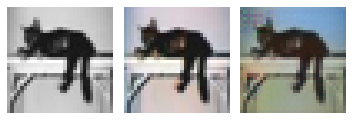

EPOCH: 67.950	val_loss: 0.005	(5937.51s - 2800.55s remaining)

2020-11-08 12:51:24.034 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 68.000	val_loss: 0.003	(5937.70s - 2794.21s remaining)

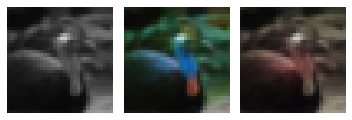

2020-11-08 12:51:24.158 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


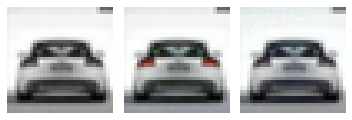

2020-11-08 12:51:24.288 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


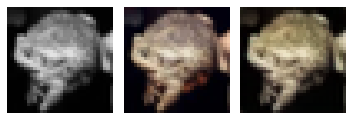

2020-11-08 12:51:24.420 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


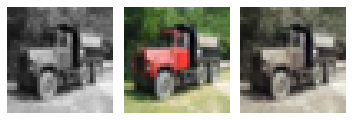

2020-11-08 12:51:24.556 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


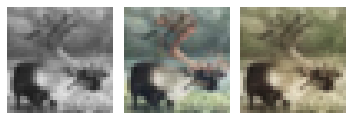

EPOCH: 68.250	trn_loss: 0.004	(5958.30s - 2771.81s remaining)

2020-11-08 12:51:45.036 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 68.255	trn_loss: 0.004	(5958.70s - 2771.34s remaining)

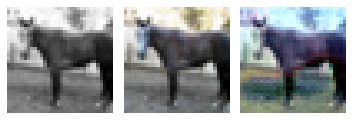

2020-11-08 12:51:45.169 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


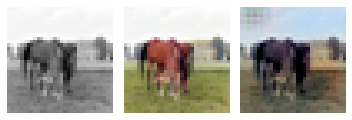

2020-11-08 12:51:45.382 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


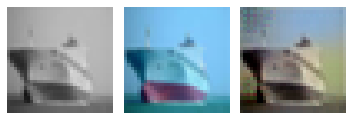

2020-11-08 12:51:45.527 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


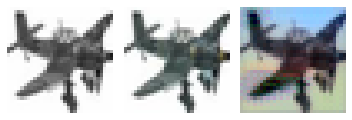

2020-11-08 12:51:45.679 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


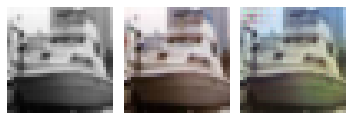

EPOCH: 68.505	trn_loss: 0.004	(5979.53s - 2749.06s remaining)

2020-11-08 12:52:06.267 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 68.510	trn_loss: 0.004	(5979.93s - 2748.59s remaining)

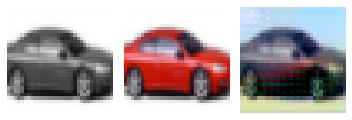

2020-11-08 12:52:06.398 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


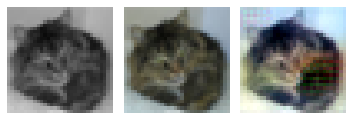

2020-11-08 12:52:06.546 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


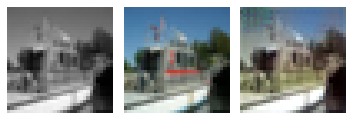

2020-11-08 12:52:06.687 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


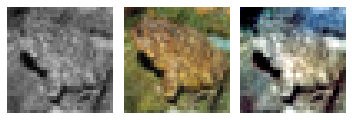

2020-11-08 12:52:06.885 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


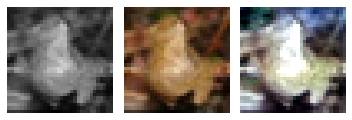

EPOCH: 68.760	trn_loss: 0.004	(6000.72s - 2726.31s remaining)

2020-11-08 12:52:27.467 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 68.765	trn_loss: 0.005	(6001.13s - 2725.84s remaining)

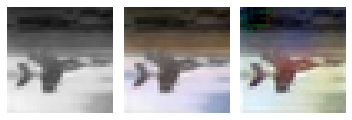

2020-11-08 12:52:27.624 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


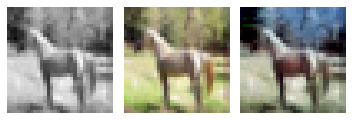

2020-11-08 12:52:27.764 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


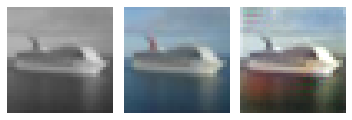

2020-11-08 12:52:27.903 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


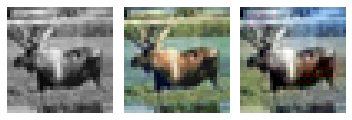

2020-11-08 12:52:28.043 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


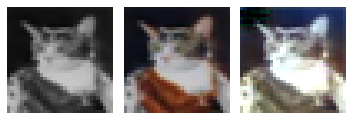

EPOCH: 68.950	val_loss: 0.005	(6026.88s - 2714.06s remaining)

2020-11-08 12:52:53.411 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 69.000	val_loss: 0.003	(6027.08s - 2707.82s remaining)

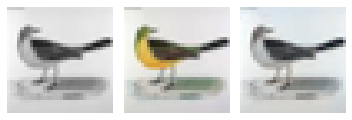

2020-11-08 12:52:53.544 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


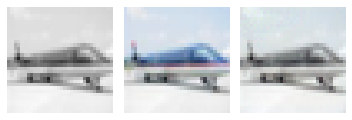

2020-11-08 12:52:53.680 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


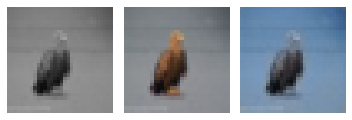

2020-11-08 12:52:53.814 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


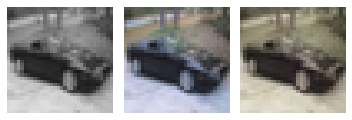

2020-11-08 12:52:53.946 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


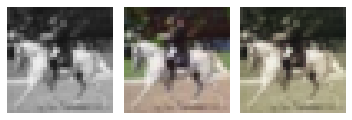

EPOCH: 69.250	trn_loss: 0.005	(6047.75s - 2685.46s remaining)

2020-11-08 12:53:14.491 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 69.255	trn_loss: 0.005	(6048.16s - 2685.00s remaining)

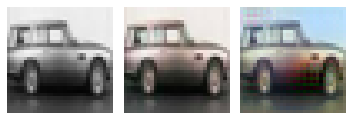

2020-11-08 12:53:14.621 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


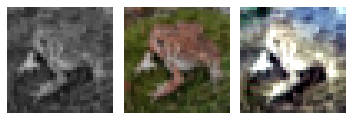

2020-11-08 12:53:14.822 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


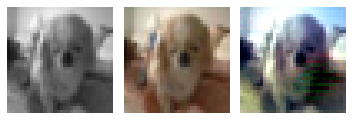

2020-11-08 12:53:14.967 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


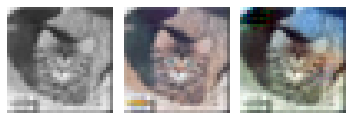

2020-11-08 12:53:15.121 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


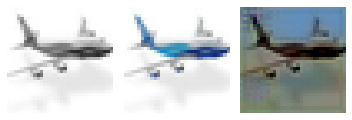

EPOCH: 69.505	trn_loss: 0.004	(6068.87s - 2662.68s remaining)

2020-11-08 12:53:35.622 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 69.510	trn_loss: 0.005	(6069.28s - 2662.22s remaining)

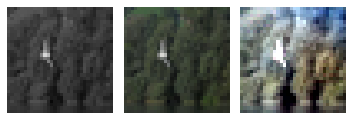

2020-11-08 12:53:35.768 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


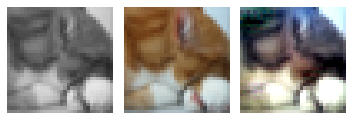

2020-11-08 12:53:35.912 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


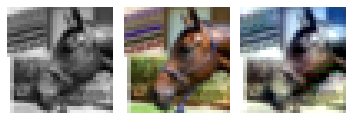

2020-11-08 12:53:36.063 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


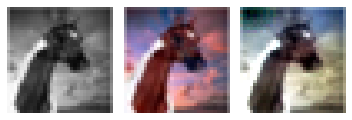

2020-11-08 12:53:36.260 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


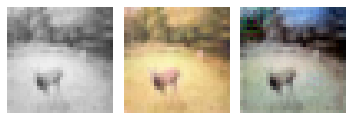

EPOCH: 69.760	trn_loss: 0.004	(6090.02s - 2639.91s remaining)

2020-11-08 12:53:56.760 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 69.765	trn_loss: 0.005	(6090.42s - 2639.45s remaining)

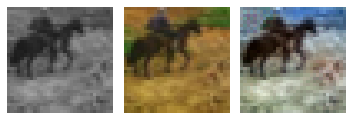

2020-11-08 12:53:56.902 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


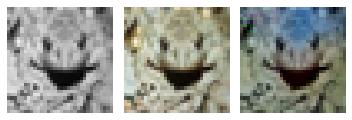

2020-11-08 12:53:57.040 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


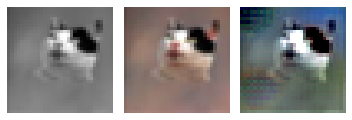

2020-11-08 12:53:57.182 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


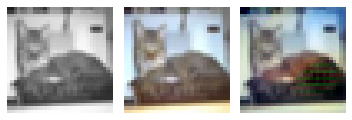

2020-11-08 12:53:57.321 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


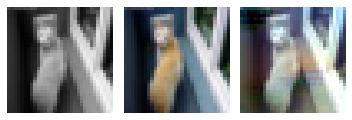

EPOCH: 69.950	val_loss: 0.005	(6116.05s - 2627.41s remaining)

2020-11-08 12:54:22.579 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 70.000	trn_loss: 0.004	val_loss: 0.005	(6116.24s - 2621.25s remaining)


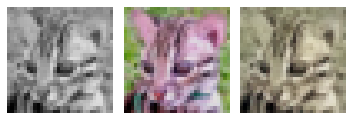

2020-11-08 12:54:22.711 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


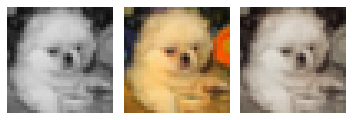

2020-11-08 12:54:22.845 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


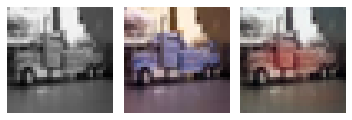

2020-11-08 12:54:22.984 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


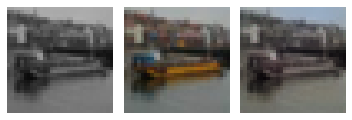

2020-11-08 12:54:23.121 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


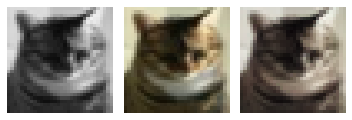

EPOCH: 70.250	trn_loss: 0.004	(6136.89s - 2598.90s remaining)

2020-11-08 12:54:43.635 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 70.255	trn_loss: 0.004	(6137.30s - 2598.43s remaining)

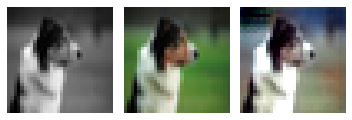

2020-11-08 12:54:43.763 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


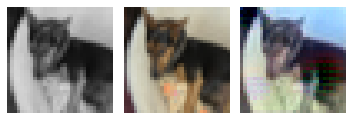

2020-11-08 12:54:43.963 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


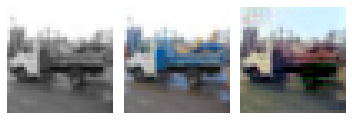

2020-11-08 12:54:44.099 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


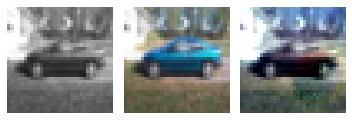

2020-11-08 12:54:44.240 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


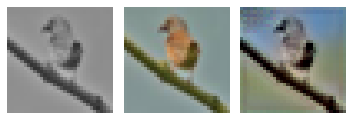

EPOCH: 70.505	trn_loss: 0.005	(6158.08s - 2576.15s remaining)

2020-11-08 12:55:04.821 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 70.510	trn_loss: 0.004	(6158.48s - 2575.69s remaining)

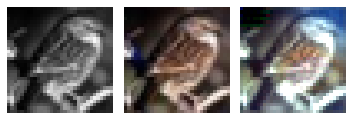

2020-11-08 12:55:04.947 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


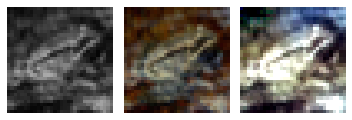

2020-11-08 12:55:05.093 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


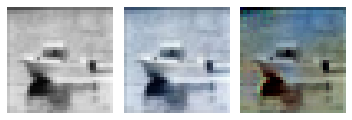

2020-11-08 12:55:05.236 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


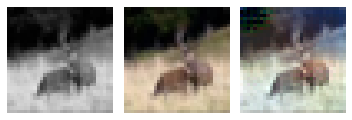

2020-11-08 12:55:05.448 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


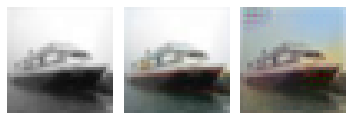

EPOCH: 70.760	trn_loss: 0.004	(6179.24s - 2553.41s remaining)

2020-11-08 12:55:25.996 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 70.765	trn_loss: 0.004	(6179.65s - 2552.95s remaining)

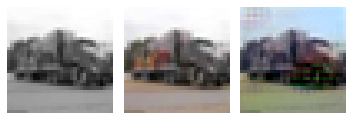

2020-11-08 12:55:26.126 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


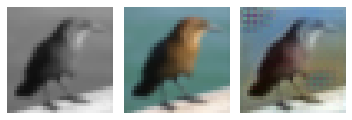

2020-11-08 12:55:26.264 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


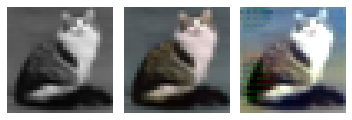

2020-11-08 12:55:26.415 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


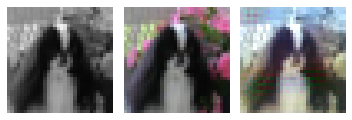

2020-11-08 12:55:26.561 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


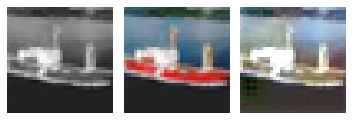

EPOCH: 70.950	val_loss: 0.005	(6205.34s - 2540.74s remaining)

2020-11-08 12:55:51.885 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 71.000	val_loss: 0.003	(6205.55s - 2534.66s remaining)

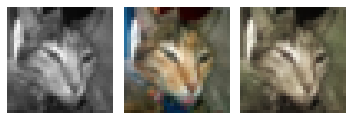

2020-11-08 12:55:52.027 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


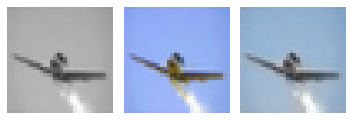

2020-11-08 12:55:52.166 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


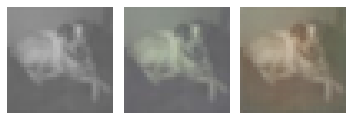

2020-11-08 12:55:52.299 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


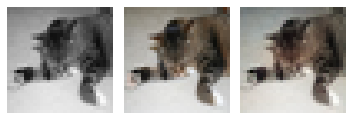

2020-11-08 12:55:52.446 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


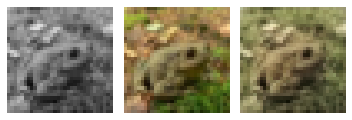

EPOCH: 71.250	trn_loss: 0.004	(6226.26s - 2512.35s remaining)

2020-11-08 12:56:13.020 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 71.255	trn_loss: 0.004	(6226.68s - 2511.90s remaining)

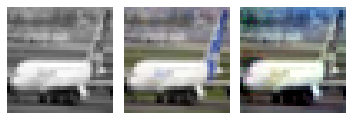

2020-11-08 12:56:13.150 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


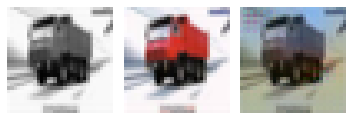

2020-11-08 12:56:13.344 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


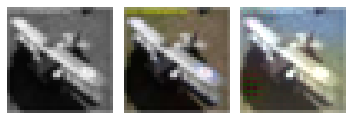

2020-11-08 12:56:13.480 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


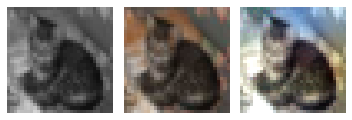

2020-11-08 12:56:13.625 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


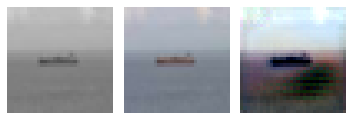

EPOCH: 71.505	trn_loss: 0.005	(6247.40s - 2489.60s remaining)

2020-11-08 12:56:34.162 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 71.510	trn_loss: 0.004	(6247.82s - 2489.14s remaining)

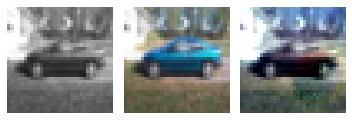

2020-11-08 12:56:34.294 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


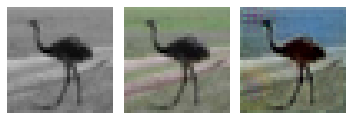

2020-11-08 12:56:34.427 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


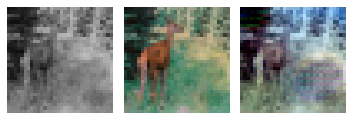

2020-11-08 12:56:34.562 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


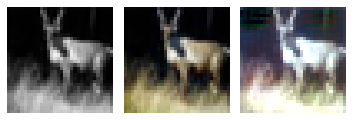

2020-11-08 12:56:34.758 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


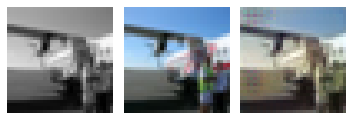

EPOCH: 71.760	trn_loss: 0.004	(6268.57s - 2466.87s remaining)

2020-11-08 12:56:55.315 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 71.765	trn_loss: 0.004	(6268.98s - 2466.41s remaining)

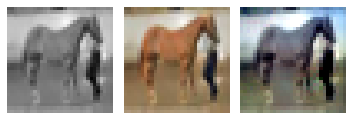

2020-11-08 12:56:55.444 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


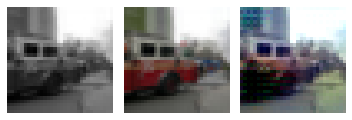

2020-11-08 12:56:55.585 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


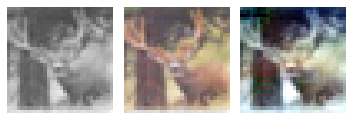

2020-11-08 12:56:55.743 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


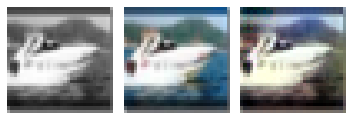

2020-11-08 12:56:55.889 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


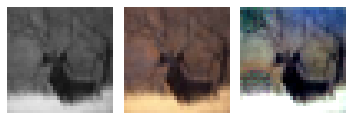

EPOCH: 71.950	val_loss: 0.005	(6294.64s - 2453.99s remaining)

2020-11-08 12:57:21.169 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 72.000	val_loss: 0.003	(6294.83s - 2447.99s remaining)

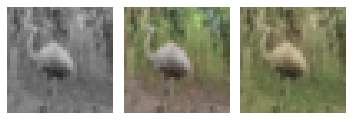

2020-11-08 12:57:21.302 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


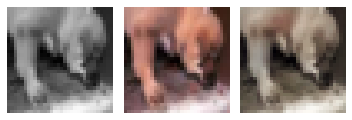

2020-11-08 12:57:21.447 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


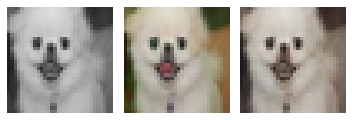

2020-11-08 12:57:21.601 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


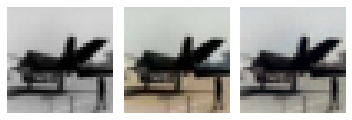

2020-11-08 12:57:21.737 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


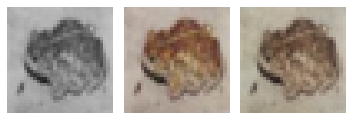

EPOCH: 72.250	trn_loss: 0.004	(6315.44s - 2425.65s remaining)

2020-11-08 12:57:42.182 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 72.255	trn_loss: 0.004	(6315.85s - 2425.19s remaining)

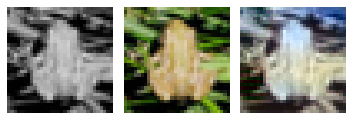

2020-11-08 12:57:42.313 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


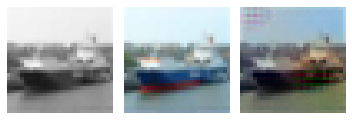

2020-11-08 12:57:42.503 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


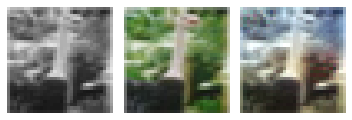

2020-11-08 12:57:42.639 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


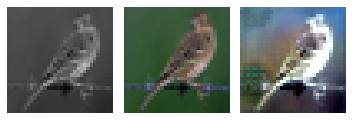

2020-11-08 12:57:42.789 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


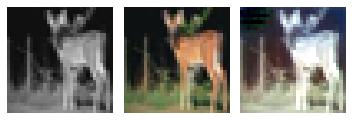

EPOCH: 72.505	trn_loss: 0.004	(6336.52s - 2402.89s remaining)

2020-11-08 12:58:03.263 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 72.510	trn_loss: 0.005	(6336.93s - 2402.43s remaining)

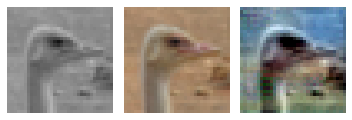

2020-11-08 12:58:03.399 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


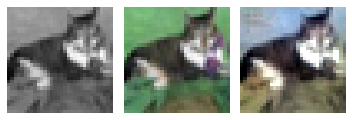

2020-11-08 12:58:03.552 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


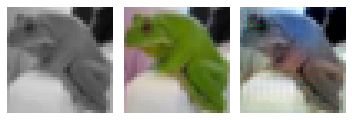

2020-11-08 12:58:03.695 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


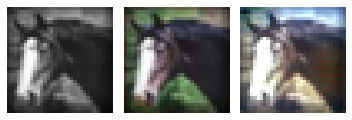

2020-11-08 12:58:03.901 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


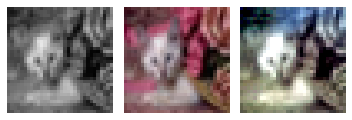

EPOCH: 72.760	trn_loss: 0.004	(6357.58s - 2380.14s remaining)

2020-11-08 12:58:24.322 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 72.765	trn_loss: 0.004	(6357.98s - 2379.67s remaining)

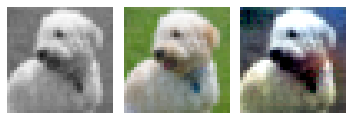

2020-11-08 12:58:24.465 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


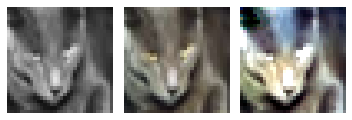

2020-11-08 12:58:24.617 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


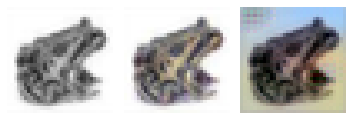

2020-11-08 12:58:24.764 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


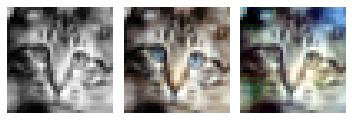

2020-11-08 12:58:24.916 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


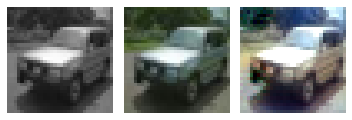

EPOCH: 72.950	val_loss: 0.005	(6383.65s - 2367.07s remaining)

2020-11-08 12:58:50.180 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 73.000	val_loss: 0.003	(6383.84s - 2361.15s remaining)

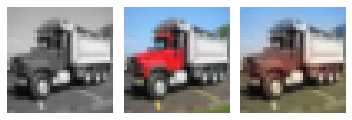

2020-11-08 12:58:50.307 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


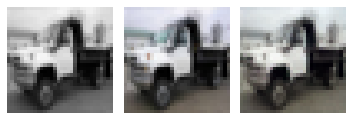

2020-11-08 12:58:50.441 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


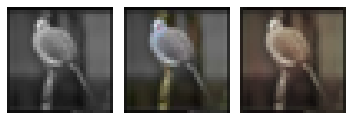

2020-11-08 12:58:50.576 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


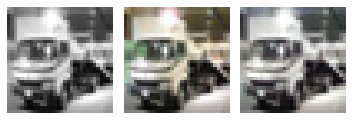

2020-11-08 12:58:50.722 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


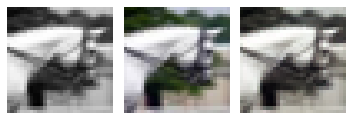

EPOCH: 73.250	trn_loss: 0.004	(6404.52s - 2338.85s remaining)

2020-11-08 12:59:11.276 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 73.255	trn_loss: 0.005	(6404.94s - 2338.40s remaining)

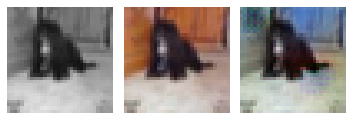

2020-11-08 12:59:11.416 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


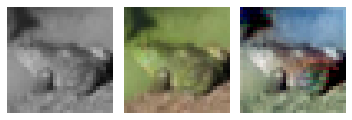

2020-11-08 12:59:11.617 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


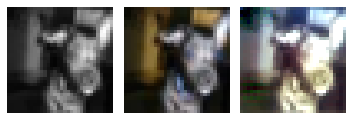

2020-11-08 12:59:11.754 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


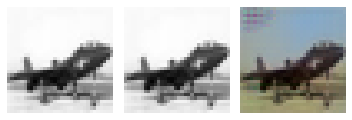

2020-11-08 12:59:11.895 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


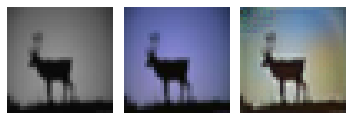

EPOCH: 73.505	trn_loss: 0.004	(6425.67s - 2316.13s remaining)

2020-11-08 12:59:32.413 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 73.510	trn_loss: 0.004	(6426.08s - 2315.67s remaining)

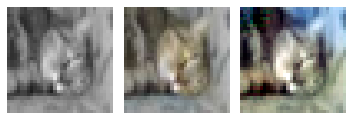

2020-11-08 12:59:32.545 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


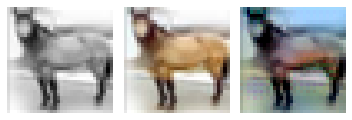

2020-11-08 12:59:32.684 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


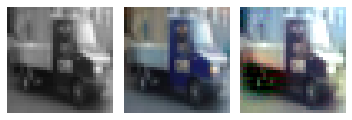

2020-11-08 12:59:32.823 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


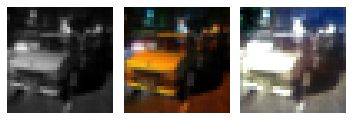

2020-11-08 12:59:33.025 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


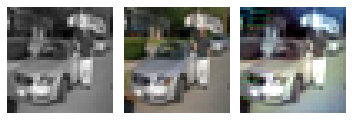

EPOCH: 73.760	trn_loss: 0.004	(6446.80s - 2293.42s remaining)

2020-11-08 12:59:53.548 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 73.765	trn_loss: 0.005	(6447.21s - 2292.96s remaining)

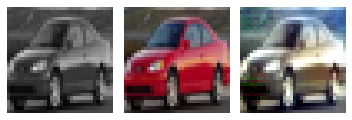

2020-11-08 12:59:53.682 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


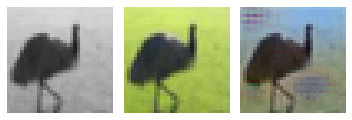

2020-11-08 12:59:53.819 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


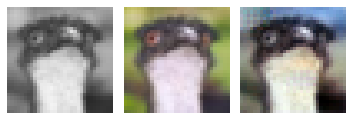

2020-11-08 12:59:53.955 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


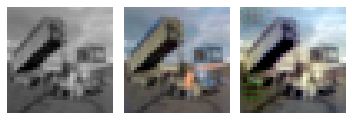

2020-11-08 12:59:54.119 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


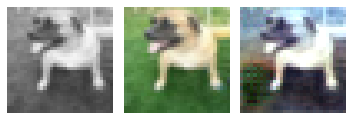

EPOCH: 73.950	val_loss: 0.005	(6472.89s - 2280.17s remaining)

2020-11-08 13:00:19.406 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 74.000	val_loss: 0.003	(6473.07s - 2274.32s remaining)

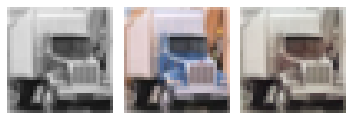

2020-11-08 13:00:19.528 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


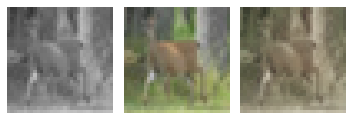

2020-11-08 13:00:19.660 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


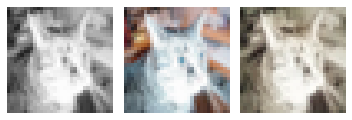

2020-11-08 13:00:19.803 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


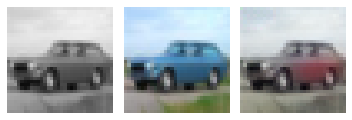

2020-11-08 13:00:19.932 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


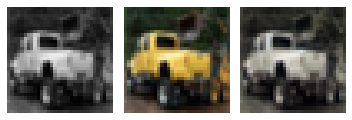

EPOCH: 74.250	trn_loss: 0.004	(6493.69s - 2252.02s remaining)

2020-11-08 13:00:40.458 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 74.255	trn_loss: 0.004	(6494.12s - 2251.57s remaining)

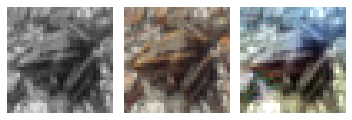

2020-11-08 13:00:40.588 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


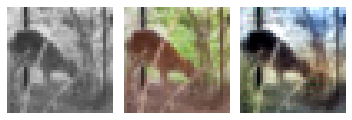

2020-11-08 13:00:40.788 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


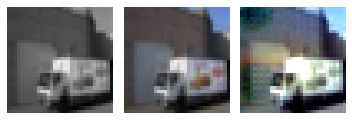

2020-11-08 13:00:40.925 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


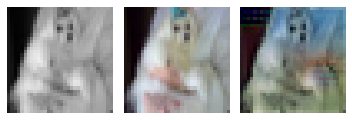

2020-11-08 13:00:41.065 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


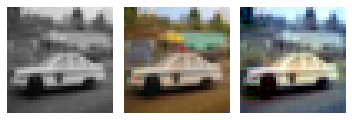

EPOCH: 74.505	trn_loss: 0.004	(6514.89s - 2229.33s remaining)

2020-11-08 13:01:01.630 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 74.510	trn_loss: 0.004	(6515.29s - 2228.87s remaining)

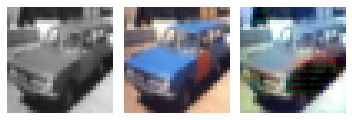

2020-11-08 13:01:01.765 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


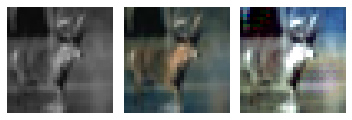

2020-11-08 13:01:01.909 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


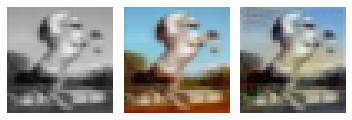

2020-11-08 13:01:02.041 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


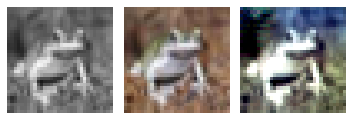

2020-11-08 13:01:02.243 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


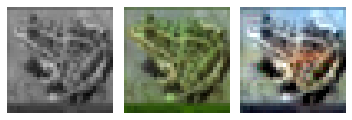

EPOCH: 74.760	trn_loss: 0.004	(6536.02s - 2206.62s remaining)

2020-11-08 13:01:22.757 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 74.765	trn_loss: 0.004	(6536.42s - 2206.16s remaining)

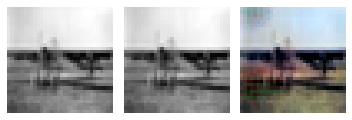

2020-11-08 13:01:22.885 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


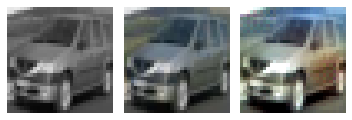

2020-11-08 13:01:23.027 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


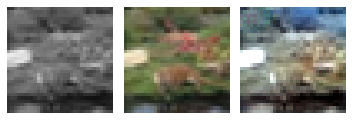

2020-11-08 13:01:23.163 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


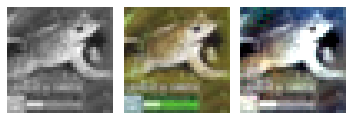

2020-11-08 13:01:23.299 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


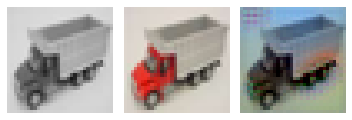

EPOCH: 74.950	val_loss: 0.005	(6562.04s - 2193.18s remaining)

2020-11-08 13:01:48.565 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 75.000	trn_loss: 0.004	val_loss: 0.005	(6562.23s - 2187.41s remaining)


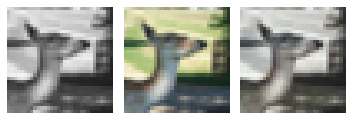

2020-11-08 13:01:48.691 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


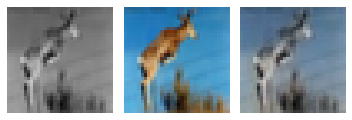

2020-11-08 13:01:48.819 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


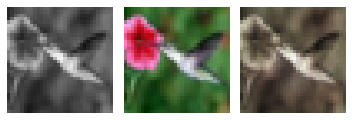

2020-11-08 13:01:48.963 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


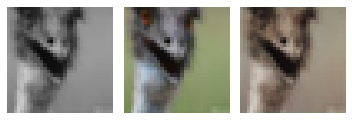

2020-11-08 13:01:49.105 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


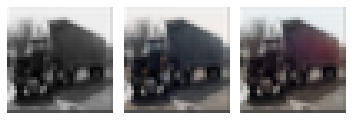

EPOCH: 75.250	trn_loss: 0.004	(6582.92s - 2165.15s remaining)

2020-11-08 13:02:09.673 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 75.255	trn_loss: 0.004	(6583.34s - 2164.69s remaining)

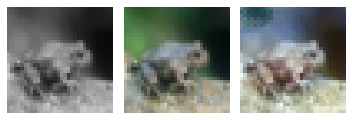

2020-11-08 13:02:09.811 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


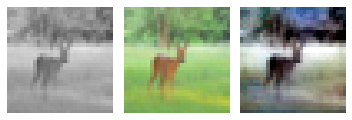

2020-11-08 13:02:10.023 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


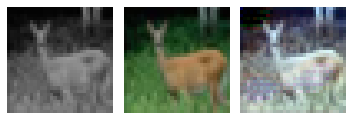

2020-11-08 13:02:10.166 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


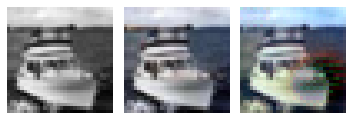

2020-11-08 13:02:10.312 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


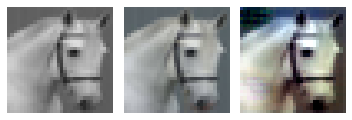

EPOCH: 75.505	trn_loss: 0.005	(6604.13s - 2142.47s remaining)

2020-11-08 13:02:30.873 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 75.510	trn_loss: 0.004	(6604.54s - 2142.01s remaining)

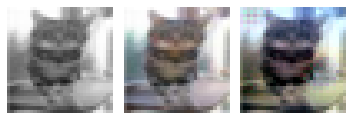

2020-11-08 13:02:31.007 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


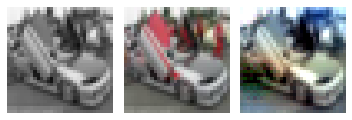

2020-11-08 13:02:31.149 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


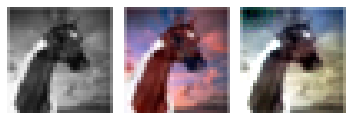

2020-11-08 13:02:31.281 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


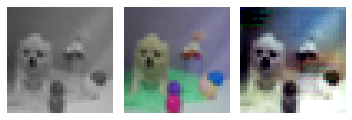

2020-11-08 13:02:31.480 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


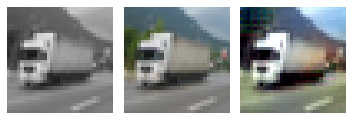

EPOCH: 75.760	trn_loss: 0.005	(6625.27s - 2119.78s remaining)

2020-11-08 13:02:52.006 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 75.765	trn_loss: 0.005	(6625.67s - 2119.32s remaining)

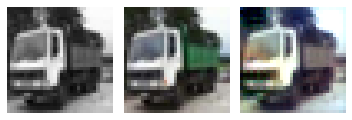

2020-11-08 13:02:52.144 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


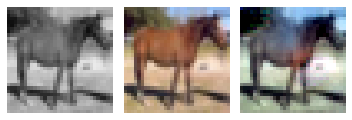

2020-11-08 13:02:52.279 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


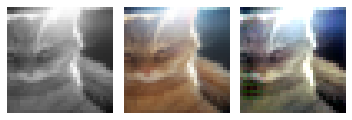

2020-11-08 13:02:52.418 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


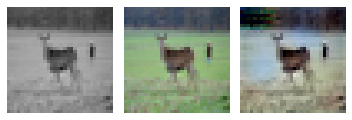

2020-11-08 13:02:52.560 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


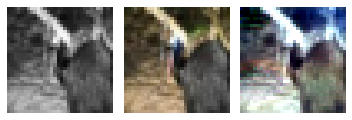

EPOCH: 75.950	val_loss: 0.005	(6651.22s - 2106.15s remaining)

2020-11-08 13:03:17.741 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 76.000	val_loss: 0.003	(6651.41s - 2100.44s remaining)

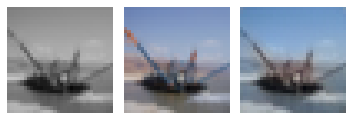

2020-11-08 13:03:17.873 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


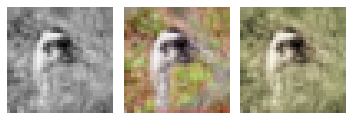

2020-11-08 13:03:18.004 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


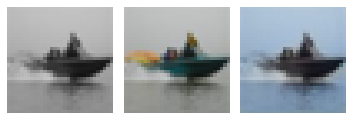

2020-11-08 13:03:18.150 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


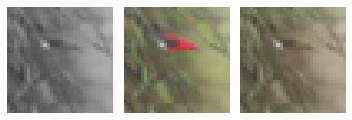

2020-11-08 13:03:18.282 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


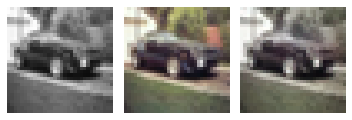

EPOCH: 76.250	trn_loss: 0.004	(6671.99s - 2078.16s remaining)

2020-11-08 13:03:38.734 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 76.255	trn_loss: 0.005	(6672.40s - 2077.70s remaining)

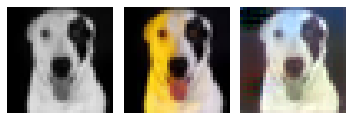

2020-11-08 13:03:38.878 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


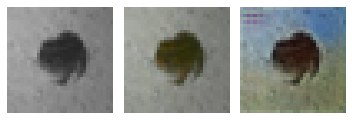

2020-11-08 13:03:39.071 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


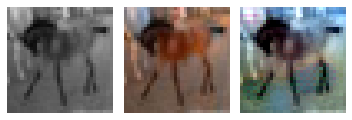

2020-11-08 13:03:39.219 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


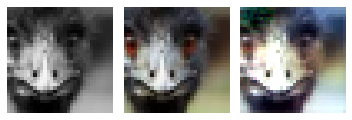

2020-11-08 13:03:39.372 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


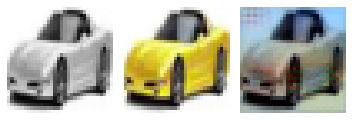

EPOCH: 76.505	trn_loss: 0.004	(6693.18s - 2055.49s remaining)

2020-11-08 13:03:59.918 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 76.510	trn_loss: 0.004	(6693.58s - 2055.03s remaining)

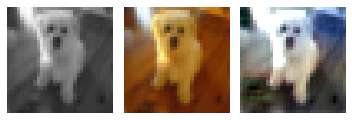

2020-11-08 13:04:00.047 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


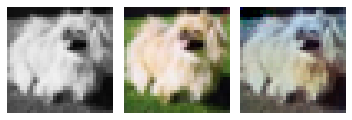

2020-11-08 13:04:00.196 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


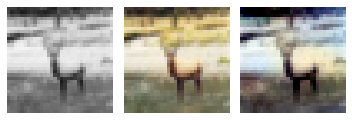

2020-11-08 13:04:00.332 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


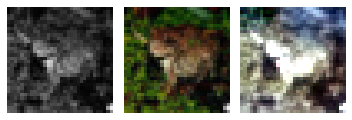

2020-11-08 13:04:00.544 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


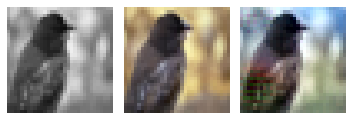

EPOCH: 76.760	trn_loss: 0.004	(6714.40s - 2032.84s remaining)

2020-11-08 13:04:21.162 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 76.765	trn_loss: 0.004	(6714.82s - 2032.39s remaining)

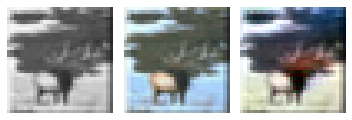

2020-11-08 13:04:21.298 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


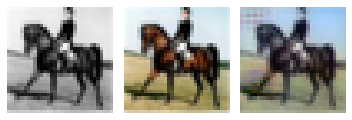

2020-11-08 13:04:21.428 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


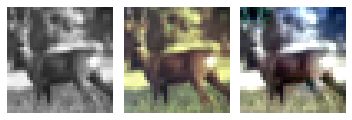

2020-11-08 13:04:21.564 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


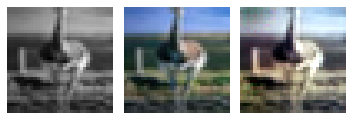

2020-11-08 13:04:21.699 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


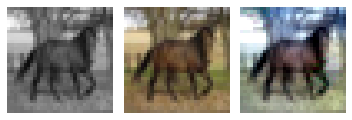

EPOCH: 76.950	val_loss: 0.005	(6740.38s - 2019.05s remaining)

2020-11-08 13:04:46.895 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 77.000	val_loss: 0.003	(6740.56s - 2013.41s remaining)

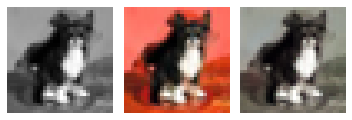

2020-11-08 13:04:47.021 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


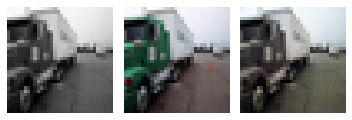

2020-11-08 13:04:47.160 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


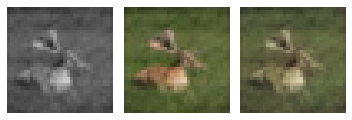

2020-11-08 13:04:47.293 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


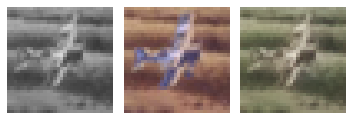

2020-11-08 13:04:47.420 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


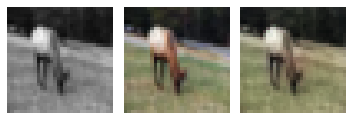

EPOCH: 77.250	trn_loss: 0.004	(6761.23s - 1991.17s remaining)

2020-11-08 13:05:07.967 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 77.255	trn_loss: 0.004	(6761.63s - 1990.71s remaining)

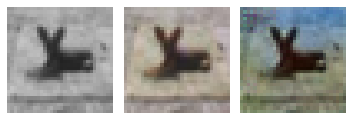

2020-11-08 13:05:08.097 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


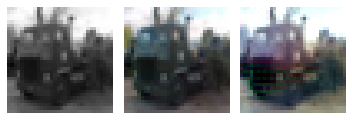

2020-11-08 13:05:08.301 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


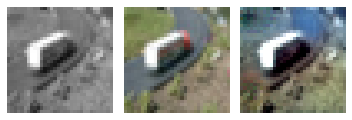

2020-11-08 13:05:08.433 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


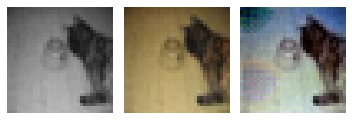

2020-11-08 13:05:08.569 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


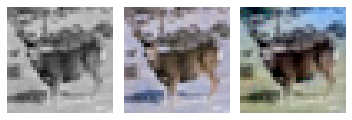

EPOCH: 77.505	trn_loss: 0.005	(6782.33s - 1968.49s remaining)

2020-11-08 13:05:29.072 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 77.510	trn_loss: 0.004	(6782.73s - 1968.03s remaining)

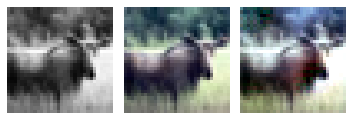

2020-11-08 13:05:29.214 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


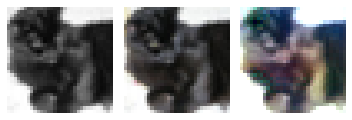

2020-11-08 13:05:29.350 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


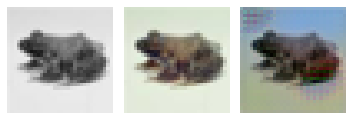

2020-11-08 13:05:29.487 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


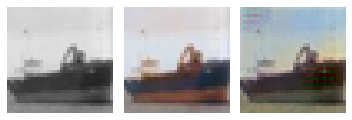

2020-11-08 13:05:29.684 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


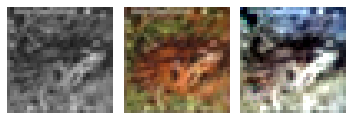

EPOCH: 77.760	trn_loss: 0.005	(6803.40s - 1945.80s remaining)

2020-11-08 13:05:50.152 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 77.765	trn_loss: 0.004	(6803.81s - 1945.35s remaining)

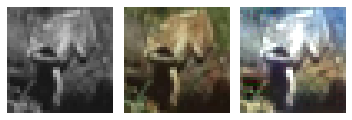

2020-11-08 13:05:50.297 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


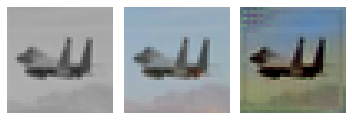

2020-11-08 13:05:50.441 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


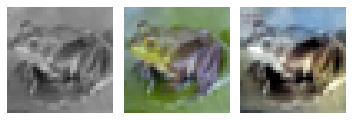

2020-11-08 13:05:50.591 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


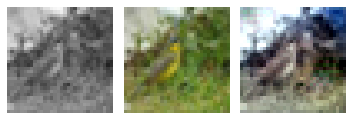

2020-11-08 13:05:50.740 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


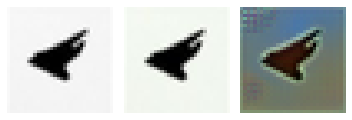

EPOCH: 77.950	val_loss: 0.005	(6829.45s - 1931.87s remaining)

2020-11-08 13:06:15.994 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 78.000	val_loss: 0.003	(6829.66s - 1926.31s remaining)

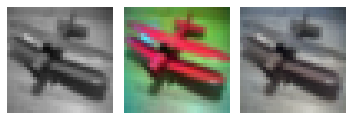

2020-11-08 13:06:16.118 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


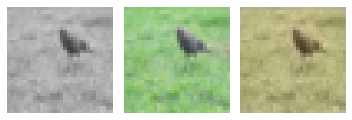

2020-11-08 13:06:16.246 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


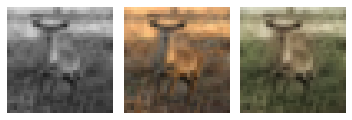

2020-11-08 13:06:16.387 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


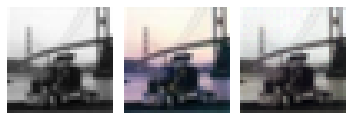

2020-11-08 13:06:16.525 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


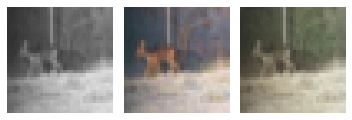

EPOCH: 78.250	trn_loss: 0.004	(6850.26s - 1904.07s remaining)

2020-11-08 13:06:37.000 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 78.255	trn_loss: 0.005	(6850.66s - 1903.61s remaining)

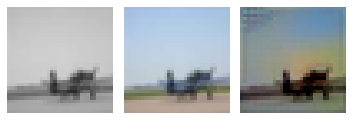

2020-11-08 13:06:37.128 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


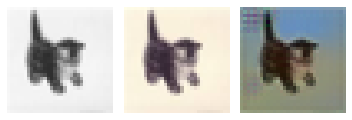

2020-11-08 13:06:37.321 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


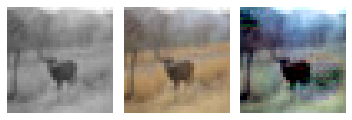

2020-11-08 13:06:37.456 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


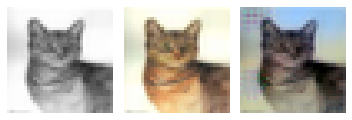

2020-11-08 13:06:37.590 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


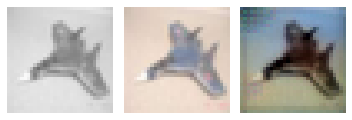

EPOCH: 78.505	trn_loss: 0.005	(6871.30s - 1881.38s remaining)

2020-11-08 13:06:58.047 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 78.510	trn_loss: 0.005	(6871.71s - 1880.92s remaining)

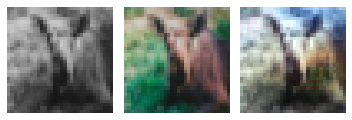

2020-11-08 13:06:58.185 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


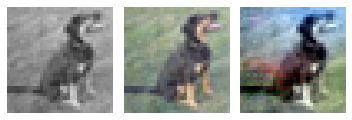

2020-11-08 13:06:58.318 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


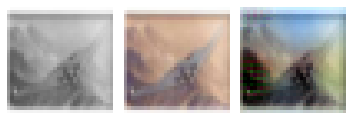

2020-11-08 13:06:58.448 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


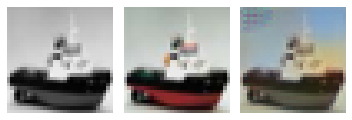

2020-11-08 13:06:58.640 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


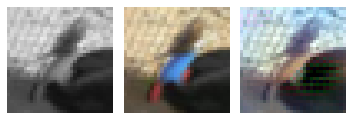

EPOCH: 78.760	trn_loss: 0.004	(6892.47s - 1858.74s remaining)

2020-11-08 13:07:19.205 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 78.765	trn_loss: 0.004	(6892.87s - 1858.28s remaining)

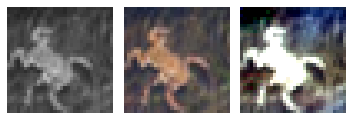

2020-11-08 13:07:19.332 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


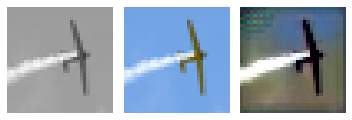

2020-11-08 13:07:19.467 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


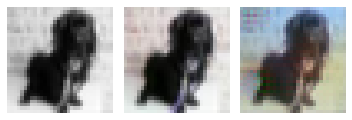

2020-11-08 13:07:19.604 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


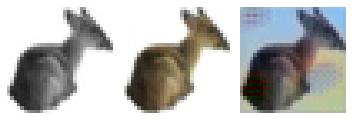

2020-11-08 13:07:19.735 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


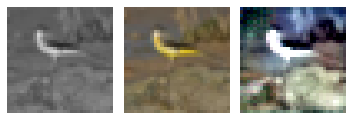

EPOCH: 78.950	val_loss: 0.005	(6918.40s - 1844.62s remaining)

2020-11-08 13:07:44.921 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 79.000	val_loss: 0.003	(6918.59s - 1839.12s remaining)

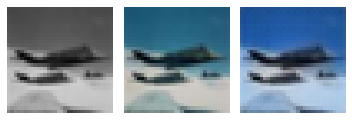

2020-11-08 13:07:45.057 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


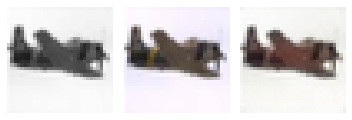

2020-11-08 13:07:45.197 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


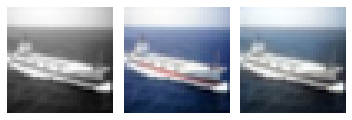

2020-11-08 13:07:45.329 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


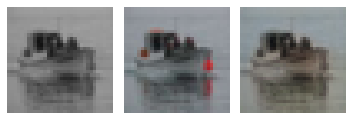

2020-11-08 13:07:45.455 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


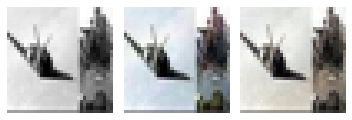

EPOCH: 79.250	trn_loss: 0.004	(6939.01s - 1816.84s remaining)

2020-11-08 13:08:05.741 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 79.255	trn_loss: 0.004	(6939.41s - 1816.38s remaining)

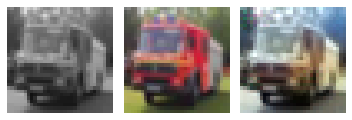

2020-11-08 13:08:05.860 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


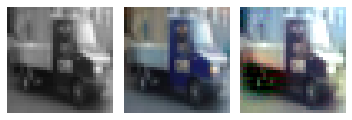

2020-11-08 13:08:06.054 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


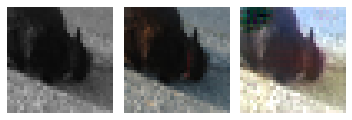

2020-11-08 13:08:06.188 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


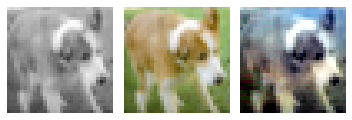

2020-11-08 13:08:06.316 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


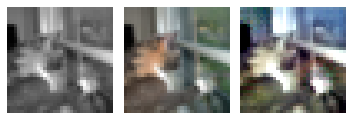

EPOCH: 79.505	trn_loss: 0.004	(6959.87s - 1794.12s remaining)

2020-11-08 13:08:26.613 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 79.510	trn_loss: 0.005	(6960.28s - 1793.66s remaining)

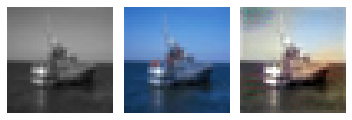

2020-11-08 13:08:26.732 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


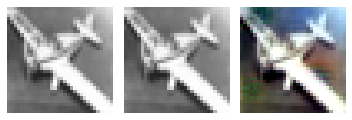

2020-11-08 13:08:26.861 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


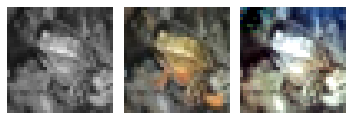

2020-11-08 13:08:26.999 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


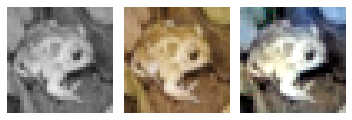

2020-11-08 13:08:27.196 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


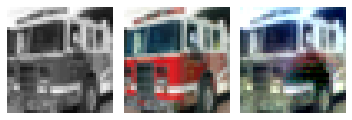

EPOCH: 79.760	trn_loss: 0.004	(6980.65s - 1771.40s remaining)

2020-11-08 13:08:47.397 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 79.765	trn_loss: 0.004	(6981.06s - 1770.94s remaining)

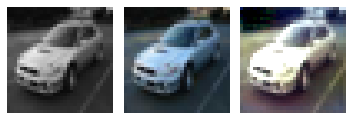

2020-11-08 13:08:47.533 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


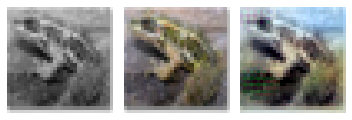

2020-11-08 13:08:47.666 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


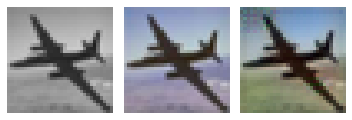

2020-11-08 13:08:47.793 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


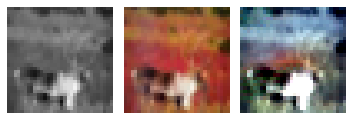

2020-11-08 13:08:47.925 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


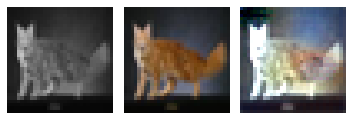

EPOCH: 79.950	val_loss: 0.005	(7006.51s - 1757.11s remaining)

2020-11-08 13:09:13.038 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 80.000	trn_loss: 0.004	val_loss: 0.005	(7006.70s - 1751.68s remaining)


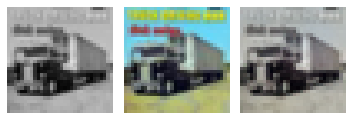

2020-11-08 13:09:13.169 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


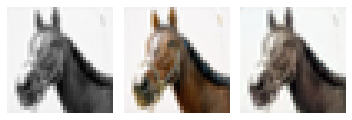

2020-11-08 13:09:13.308 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


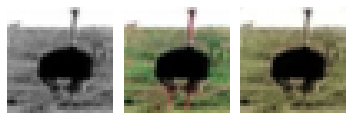

2020-11-08 13:09:13.443 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


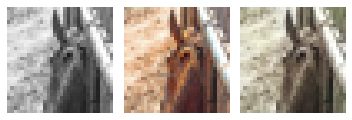

2020-11-08 13:09:13.581 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


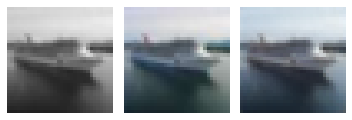

EPOCH: 80.250	trn_loss: 0.004	(7027.28s - 1729.45s remaining)

2020-11-08 13:09:34.021 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 80.255	trn_loss: 0.004	(7027.68s - 1729.00s remaining)

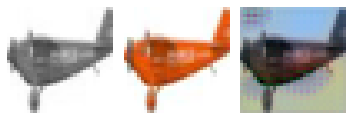

2020-11-08 13:09:34.153 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


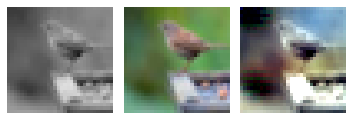

2020-11-08 13:09:34.350 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


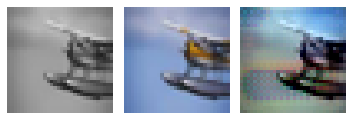

2020-11-08 13:09:34.487 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


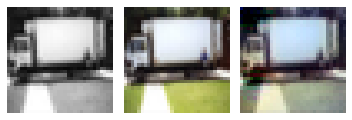

2020-11-08 13:09:34.619 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


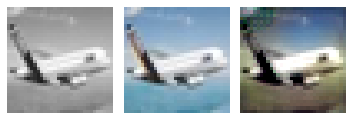

EPOCH: 80.505	trn_loss: 0.005	(7048.33s - 1706.80s remaining)

2020-11-08 13:09:55.067 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 80.510	trn_loss: 0.004	(7048.73s - 1706.35s remaining)

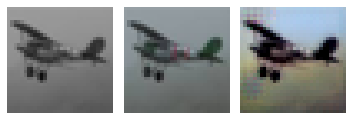

2020-11-08 13:09:55.206 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


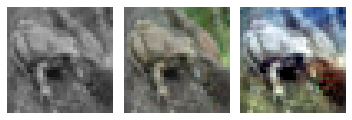

2020-11-08 13:09:55.347 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


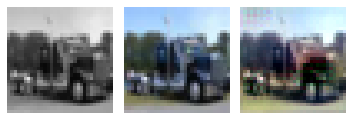

2020-11-08 13:09:55.475 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


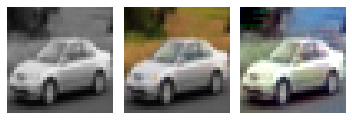

2020-11-08 13:09:55.674 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


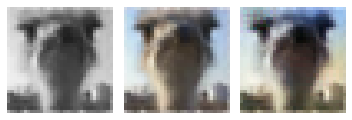

EPOCH: 80.760	trn_loss: 0.004	(7069.41s - 1684.17s remaining)

2020-11-08 13:10:16.170 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 80.765	trn_loss: 0.004	(7069.83s - 1683.72s remaining)

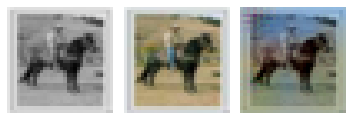

2020-11-08 13:10:16.293 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


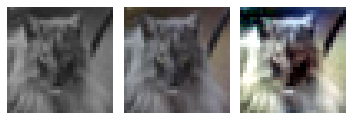

2020-11-08 13:10:16.430 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


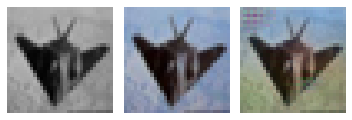

2020-11-08 13:10:16.560 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


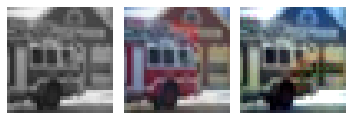

2020-11-08 13:10:16.691 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


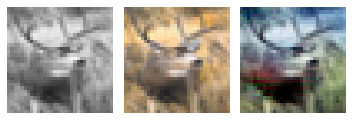

EPOCH: 80.950	val_loss: 0.005	(7095.35s - 1669.75s remaining)

2020-11-08 13:10:41.864 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 81.000	val_loss: 0.003	(7095.53s - 1664.38s remaining)

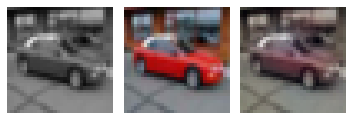

2020-11-08 13:10:41.990 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


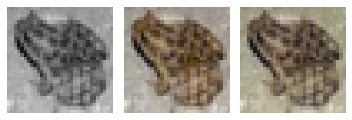

2020-11-08 13:10:42.122 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


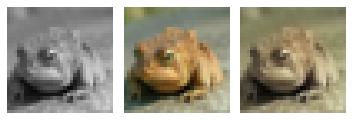

2020-11-08 13:10:42.255 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


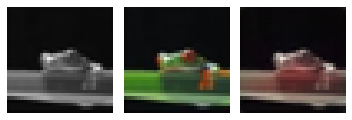

2020-11-08 13:10:42.388 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


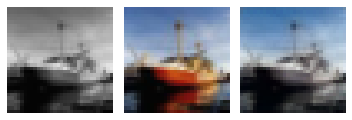

EPOCH: 81.250	trn_loss: 0.004	(7116.12s - 1642.18s remaining)

2020-11-08 13:11:02.865 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 81.255	trn_loss: 0.004	(7116.53s - 1641.73s remaining)

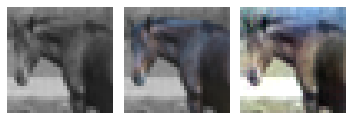

2020-11-08 13:11:02.994 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


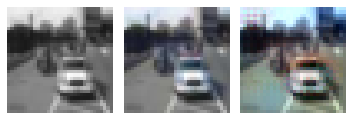

2020-11-08 13:11:03.198 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


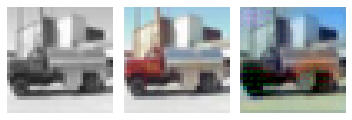

2020-11-08 13:11:03.329 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


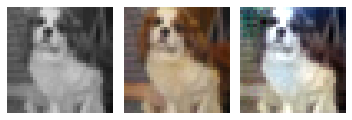

2020-11-08 13:11:03.464 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


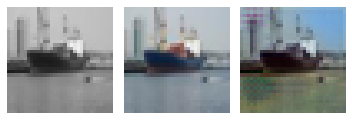

EPOCH: 81.505	trn_loss: 0.004	(7137.07s - 1619.52s remaining)

2020-11-08 13:11:23.810 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 81.510	trn_loss: 0.004	(7137.47s - 1619.07s remaining)

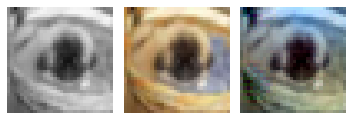

2020-11-08 13:11:23.936 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


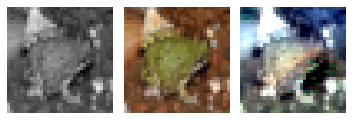

2020-11-08 13:11:24.072 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


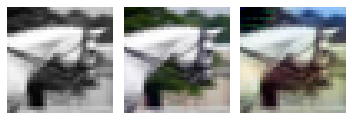

2020-11-08 13:11:24.223 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


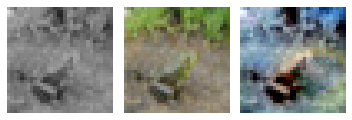

2020-11-08 13:11:24.440 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


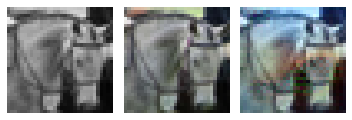

EPOCH: 81.760	trn_loss: 0.004	(7158.20s - 1596.92s remaining)

2020-11-08 13:11:44.944 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 81.765	trn_loss: 0.004	(7158.61s - 1596.46s remaining)

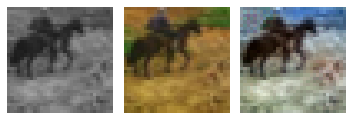

2020-11-08 13:11:45.068 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


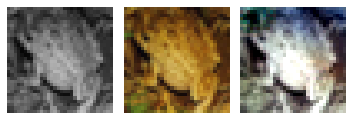

2020-11-08 13:11:45.202 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


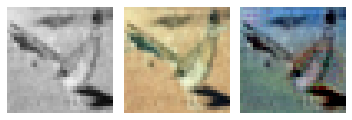

2020-11-08 13:11:45.330 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


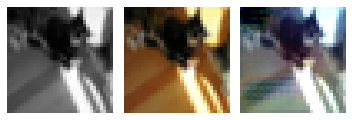

2020-11-08 13:11:45.461 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


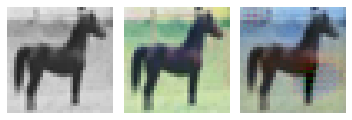

EPOCH: 81.950	val_loss: 0.005	(7183.91s - 1582.30s remaining)

2020-11-08 13:12:10.432 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 82.000	val_loss: 0.003	(7184.10s - 1577.00s remaining)

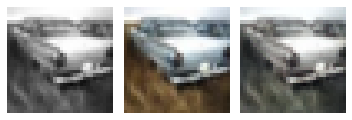

2020-11-08 13:12:10.550 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


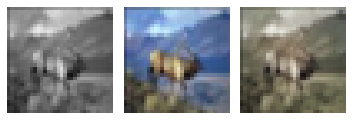

2020-11-08 13:12:10.681 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


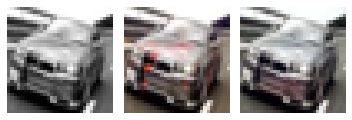

2020-11-08 13:12:10.813 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


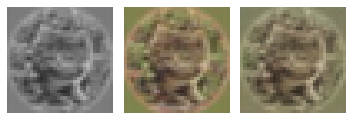

2020-11-08 13:12:10.939 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


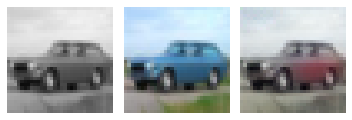

EPOCH: 82.250	trn_loss: 0.004	(7204.60s - 1554.79s remaining)

2020-11-08 13:12:31.346 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 82.255	trn_loss: 0.004	(7205.01s - 1554.34s remaining)

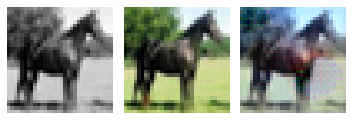

2020-11-08 13:12:31.469 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


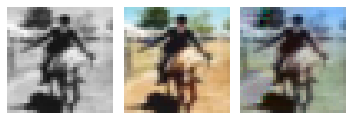

2020-11-08 13:12:31.661 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


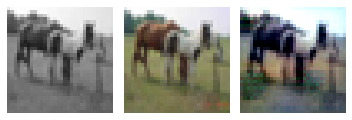

2020-11-08 13:12:31.797 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


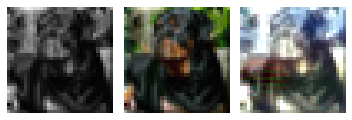

2020-11-08 13:12:31.938 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


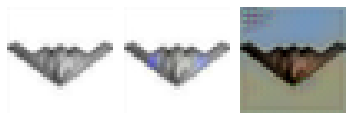

EPOCH: 82.505	trn_loss: 0.005	(7225.68s - 1532.18s remaining)

2020-11-08 13:12:52.416 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 82.510	trn_loss: 0.004	(7226.08s - 1531.72s remaining)

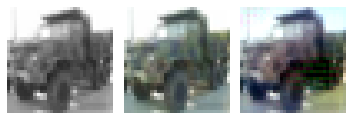

2020-11-08 13:12:52.540 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


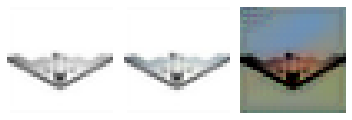

2020-11-08 13:12:52.681 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


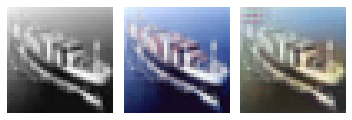

2020-11-08 13:12:52.807 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


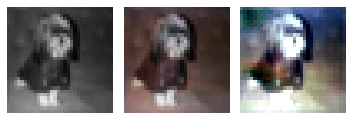

2020-11-08 13:12:53.001 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


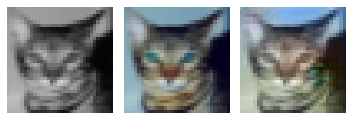

EPOCH: 82.760	trn_loss: 0.004	(7246.76s - 1509.57s remaining)

2020-11-08 13:13:13.509 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 82.765	trn_loss: 0.005	(7247.17s - 1509.12s remaining)

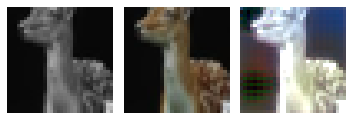

2020-11-08 13:13:13.635 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


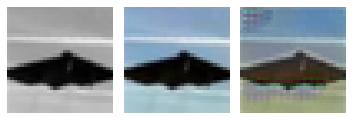

2020-11-08 13:13:13.768 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


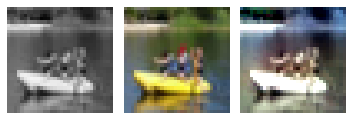

2020-11-08 13:13:13.910 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


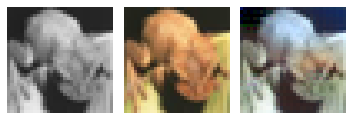

2020-11-08 13:13:14.047 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


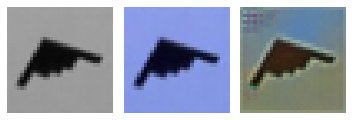

EPOCH: 82.950	val_loss: 0.005	(7272.63s - 1494.86s remaining)

2020-11-08 13:13:39.146 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 83.000	val_loss: 0.003	(7272.81s - 1489.61s remaining)

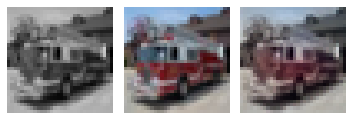

2020-11-08 13:13:39.277 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


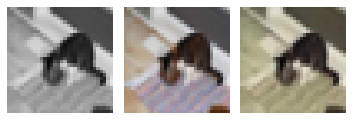

2020-11-08 13:13:39.409 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


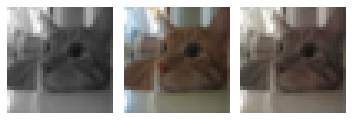

2020-11-08 13:13:39.537 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


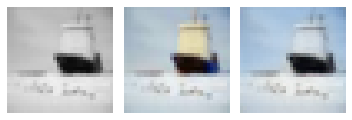

2020-11-08 13:13:39.671 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


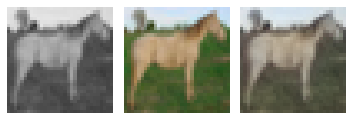

EPOCH: 83.250	trn_loss: 0.004	(7293.39s - 1467.44s remaining)

2020-11-08 13:14:00.128 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 83.255	trn_loss: 0.004	(7293.79s - 1466.98s remaining)

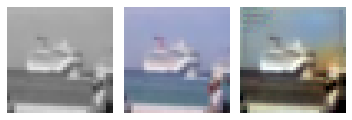

2020-11-08 13:14:00.260 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


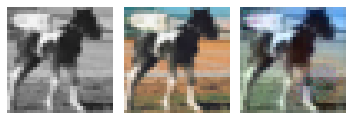

2020-11-08 13:14:00.461 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


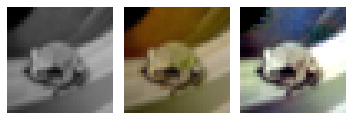

2020-11-08 13:14:00.594 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


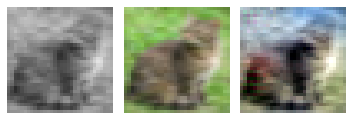

2020-11-08 13:14:00.729 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


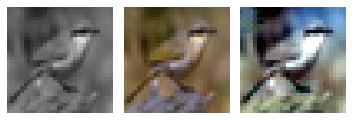

EPOCH: 83.505	trn_loss: 0.004	(7314.45s - 1444.83s remaining)

2020-11-08 13:14:21.198 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 83.510	trn_loss: 0.004	(7314.86s - 1444.38s remaining)

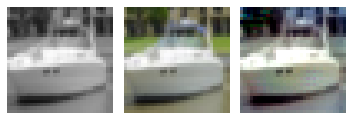

2020-11-08 13:14:21.323 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


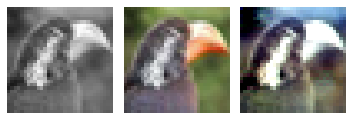

2020-11-08 13:14:21.460 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


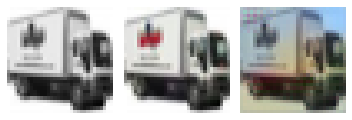

2020-11-08 13:14:21.587 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


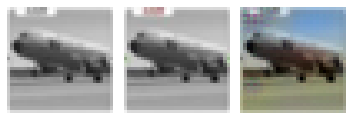

2020-11-08 13:14:21.787 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


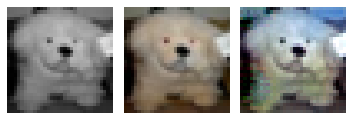

EPOCH: 83.760	trn_loss: 0.004	(7335.46s - 1422.23s remaining)

2020-11-08 13:14:42.197 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 83.765	trn_loss: 0.005	(7335.86s - 1421.78s remaining)

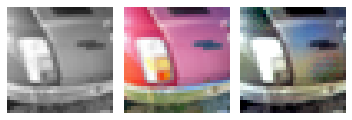

2020-11-08 13:14:42.323 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


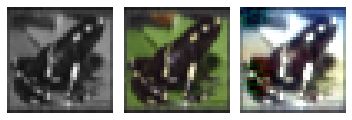

2020-11-08 13:14:42.456 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


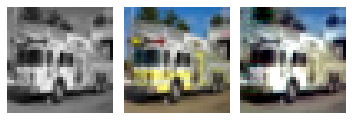

2020-11-08 13:14:42.590 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


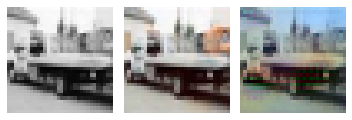

2020-11-08 13:14:42.728 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


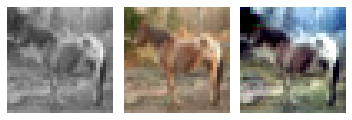

EPOCH: 83.950	val_loss: 0.005	(7361.32s - 1407.38s remaining)

2020-11-08 13:15:07.838 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 84.000	val_loss: 0.003	(7361.50s - 1402.19s remaining)

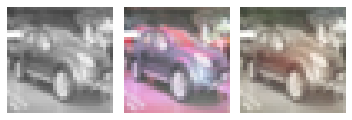

2020-11-08 13:15:07.964 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


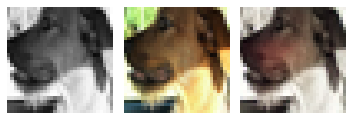

2020-11-08 13:15:08.095 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


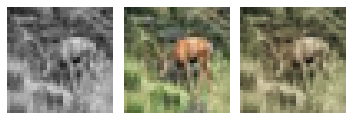

2020-11-08 13:15:08.228 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


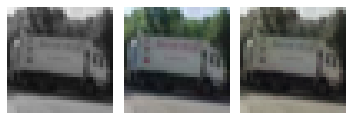

2020-11-08 13:15:08.368 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


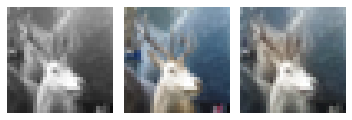

EPOCH: 84.250	trn_loss: 0.004	(7382.23s - 1380.06s remaining)

2020-11-08 13:15:28.979 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 84.255	trn_loss: 0.005	(7382.64s - 1379.61s remaining)

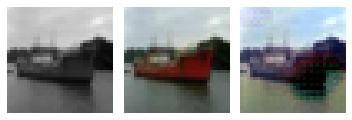

2020-11-08 13:15:29.109 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


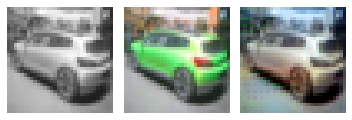

2020-11-08 13:15:29.317 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


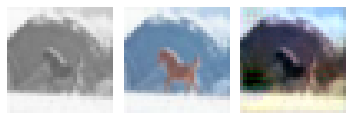

2020-11-08 13:15:29.458 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


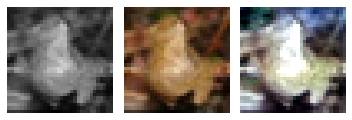

2020-11-08 13:15:29.614 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


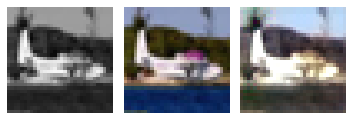

EPOCH: 84.505	trn_loss: 0.004	(7403.46s - 1357.50s remaining)

2020-11-08 13:15:50.226 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 84.510	trn_loss: 0.005	(7403.89s - 1357.05s remaining)

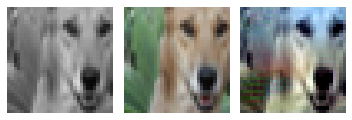

2020-11-08 13:15:50.354 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


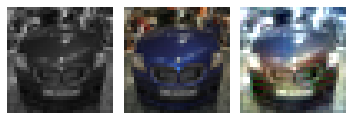

2020-11-08 13:15:50.495 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


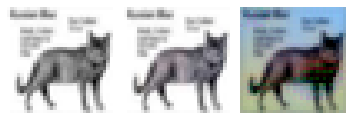

2020-11-08 13:15:50.631 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


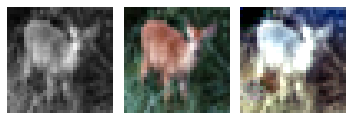

2020-11-08 13:15:50.836 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


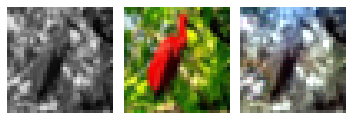

EPOCH: 84.760	trn_loss: 0.004	(7424.59s - 1334.93s remaining)

2020-11-08 13:16:11.333 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 84.765	trn_loss: 0.004	(7425.00s - 1334.48s remaining)

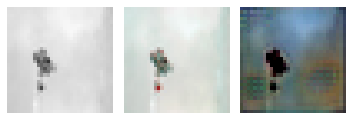

2020-11-08 13:16:11.469 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


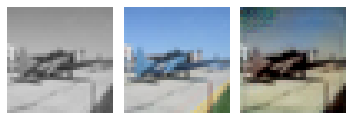

2020-11-08 13:16:11.603 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


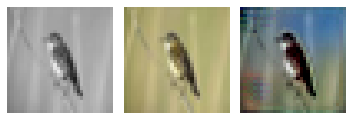

2020-11-08 13:16:11.738 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


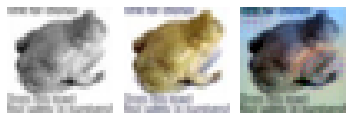

2020-11-08 13:16:11.875 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


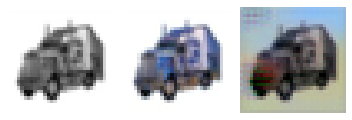

EPOCH: 84.950	val_loss: 0.005	(7450.78s - 1320.00s remaining)

2020-11-08 13:16:37.324 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 85.000	trn_loss: 0.004	val_loss: 0.005	(7450.99s - 1314.88s remaining)


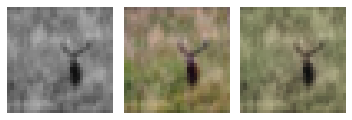

2020-11-08 13:16:37.461 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


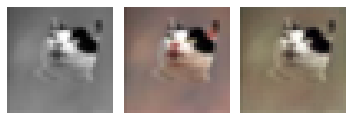

2020-11-08 13:16:37.609 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


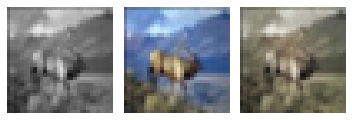

2020-11-08 13:16:37.747 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


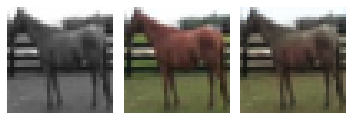

2020-11-08 13:16:37.890 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


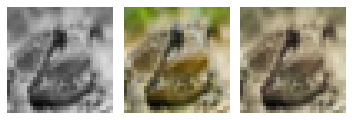

EPOCH: 85.250	trn_loss: 0.005	(7471.64s - 1292.75s remaining)

2020-11-08 13:16:58.380 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 85.255	trn_loss: 0.004	(7472.04s - 1292.29s remaining)

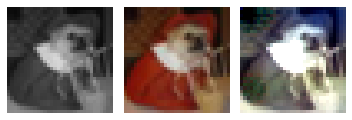

2020-11-08 13:16:58.531 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


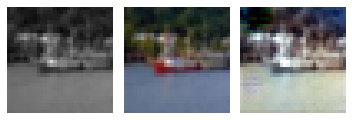

2020-11-08 13:16:58.742 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


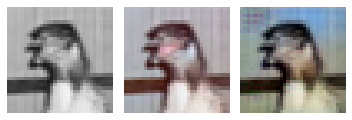

2020-11-08 13:16:58.881 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


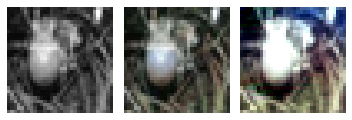

2020-11-08 13:16:59.020 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


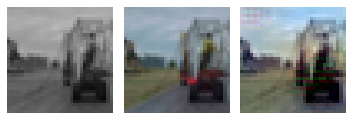

EPOCH: 85.505	trn_loss: 0.005	(7492.93s - 1270.21s remaining)

2020-11-08 13:17:19.668 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 85.510	trn_loss: 0.005	(7493.33s - 1269.75s remaining)

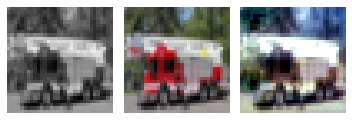

2020-11-08 13:17:19.794 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


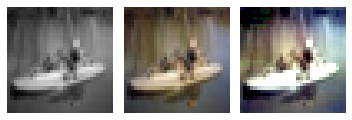

2020-11-08 13:17:19.930 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


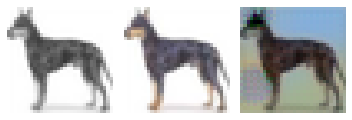

2020-11-08 13:17:20.067 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


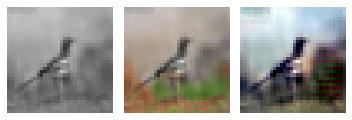

2020-11-08 13:17:20.274 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


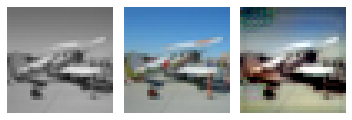

EPOCH: 85.760	trn_loss: 0.004	(7514.01s - 1247.64s remaining)

2020-11-08 13:17:40.753 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 85.765	trn_loss: 0.004	(7514.42s - 1247.19s remaining)

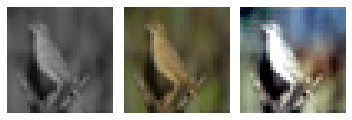

2020-11-08 13:17:40.887 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


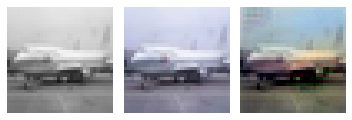

2020-11-08 13:17:41.021 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


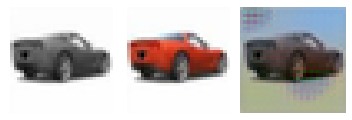

2020-11-08 13:17:41.156 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


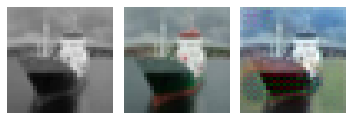

2020-11-08 13:17:41.295 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


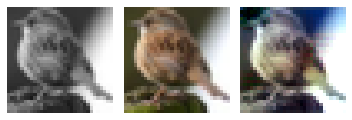

EPOCH: 85.950	val_loss: 0.005	(7540.00s - 1232.54s remaining)

2020-11-08 13:18:06.516 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 86.000	val_loss: 0.003	(7540.18s - 1227.47s remaining)

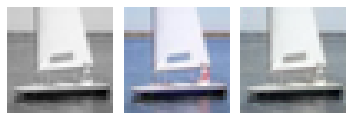

2020-11-08 13:18:06.656 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


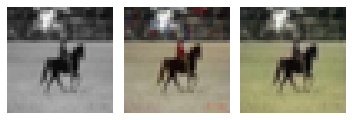

2020-11-08 13:18:06.793 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


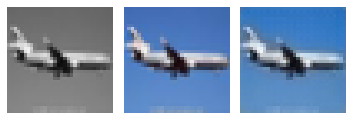

2020-11-08 13:18:06.937 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


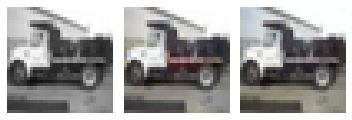

2020-11-08 13:18:07.071 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


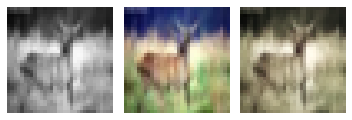

EPOCH: 86.250	trn_loss: 0.004	(7560.85s - 1205.35s remaining)

2020-11-08 13:18:27.600 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 86.255	trn_loss: 0.005	(7561.26s - 1204.90s remaining)

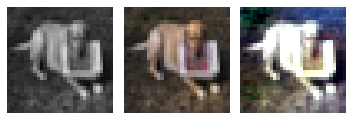

2020-11-08 13:18:27.729 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


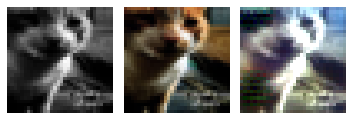

2020-11-08 13:18:27.935 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


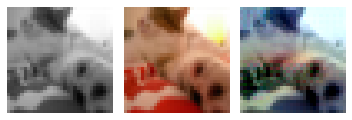

2020-11-08 13:18:28.082 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


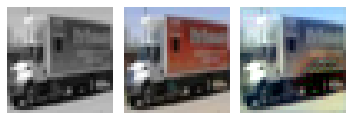

2020-11-08 13:18:28.220 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


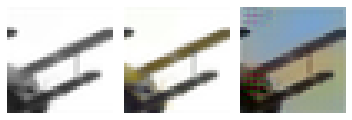

EPOCH: 86.505	trn_loss: 0.005	(7582.02s - 1182.80s remaining)

2020-11-08 13:18:48.754 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 86.510	trn_loss: 0.004	(7582.42s - 1182.35s remaining)

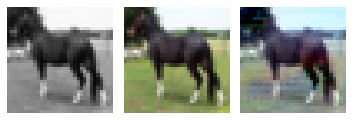

2020-11-08 13:18:48.890 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


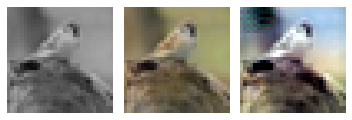

2020-11-08 13:18:49.029 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


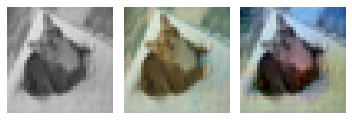

2020-11-08 13:18:49.166 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


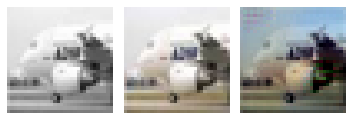

2020-11-08 13:18:49.371 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


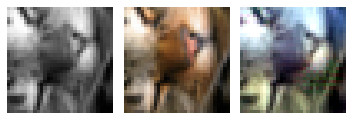

EPOCH: 86.760	trn_loss: 0.004	(7603.07s - 1160.25s remaining)

2020-11-08 13:19:09.829 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 86.765	trn_loss: 0.005	(7603.49s - 1159.79s remaining)

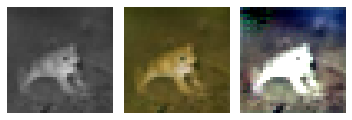

2020-11-08 13:19:09.973 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


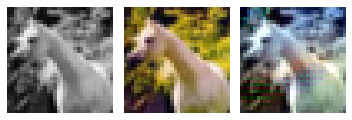

2020-11-08 13:19:10.122 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


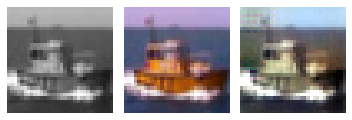

2020-11-08 13:19:10.257 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


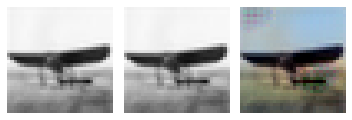

2020-11-08 13:19:10.391 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


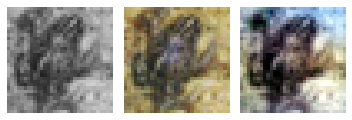

EPOCH: 86.950	val_loss: 0.005	(7629.06s - 1145.02s remaining)

2020-11-08 13:19:35.578 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 87.000	val_loss: 0.003	(7629.24s - 1140.00s remaining)

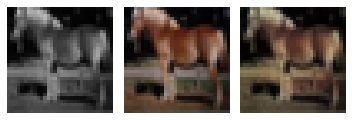

2020-11-08 13:19:35.719 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


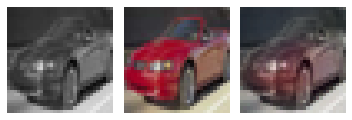

2020-11-08 13:19:35.872 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


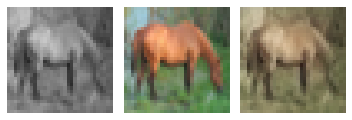

2020-11-08 13:19:36.016 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


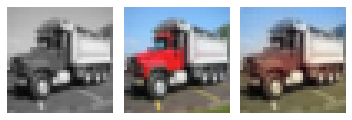

2020-11-08 13:19:36.148 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


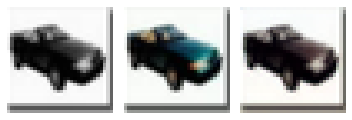

EPOCH: 87.250	trn_loss: 0.005	(7649.85s - 1117.89s remaining)

2020-11-08 13:19:56.593 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 87.255	trn_loss: 0.005	(7650.26s - 1117.43s remaining)

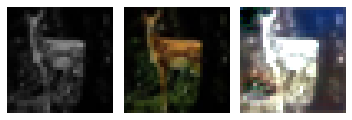

2020-11-08 13:19:56.731 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


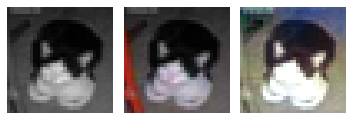

2020-11-08 13:19:56.939 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


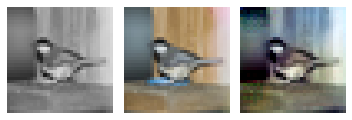

2020-11-08 13:19:57.075 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


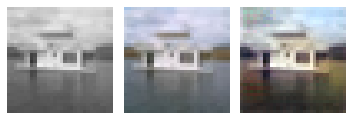

2020-11-08 13:19:57.220 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


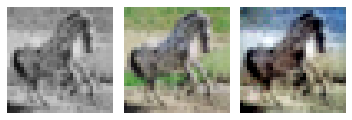

EPOCH: 87.505	trn_loss: 0.004	(7671.03s - 1095.35s remaining)

2020-11-08 13:20:17.782 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 87.510	trn_loss: 0.004	(7671.44s - 1094.90s remaining)

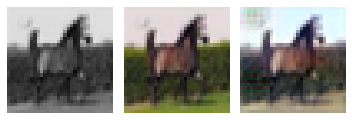

2020-11-08 13:20:17.913 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


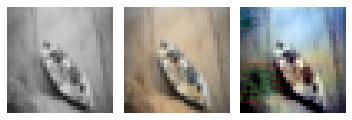

2020-11-08 13:20:18.062 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


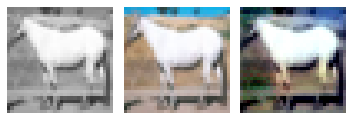

2020-11-08 13:20:18.200 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


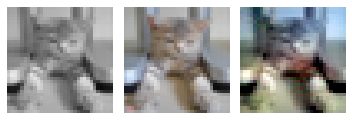

2020-11-08 13:20:18.404 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


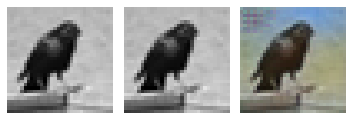

EPOCH: 87.760	trn_loss: 0.004	(7692.24s - 1072.83s remaining)

2020-11-08 13:20:38.975 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 87.765	trn_loss: 0.004	(7692.64s - 1072.37s remaining)

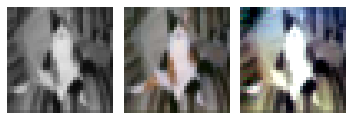

2020-11-08 13:20:39.109 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


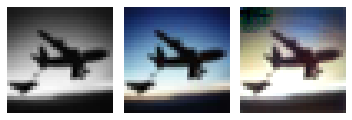

2020-11-08 13:20:39.249 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


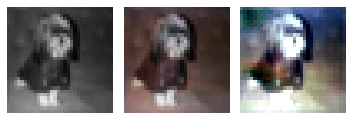

2020-11-08 13:20:39.388 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


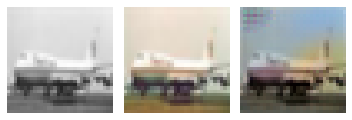

2020-11-08 13:20:39.525 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


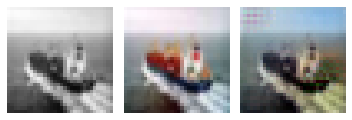

EPOCH: 87.950	val_loss: 0.005	(7718.20s - 1057.47s remaining)

2020-11-08 13:21:04.718 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 88.000	val_loss: 0.003	(7718.38s - 1052.51s remaining)

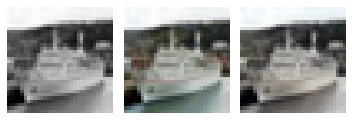

2020-11-08 13:21:04.848 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


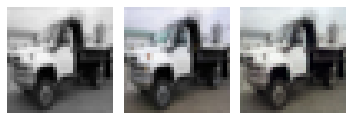

2020-11-08 13:21:04.987 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


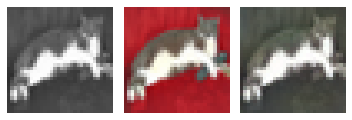

2020-11-08 13:21:05.127 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


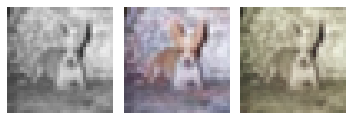

2020-11-08 13:21:05.265 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


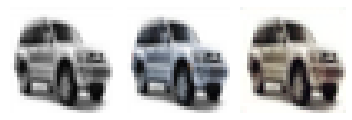

EPOCH: 88.250	trn_loss: 0.005	(7739.04s - 1030.41s remaining)

2020-11-08 13:21:25.777 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 88.255	trn_loss: 0.004	(7739.44s - 1029.96s remaining)

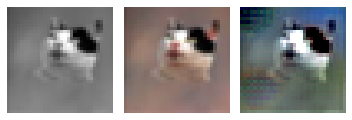

2020-11-08 13:21:25.912 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


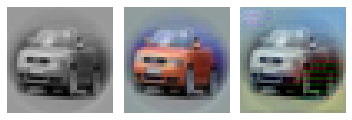

2020-11-08 13:21:26.124 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


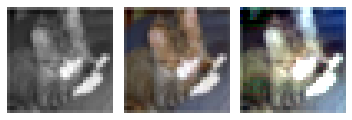

2020-11-08 13:21:26.261 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


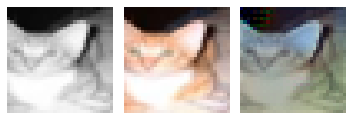

2020-11-08 13:21:26.416 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


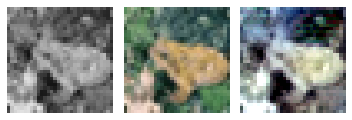

EPOCH: 88.505	trn_loss: 0.004	(7760.22s - 1007.88s remaining)

2020-11-08 13:21:46.962 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 88.510	trn_loss: 0.004	(7760.63s - 1007.43s remaining)

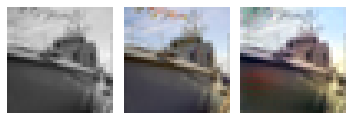

2020-11-08 13:21:47.093 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


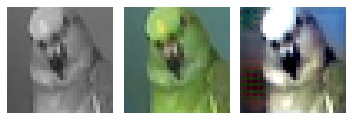

2020-11-08 13:21:47.241 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


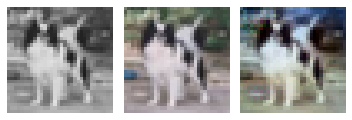

2020-11-08 13:21:47.377 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


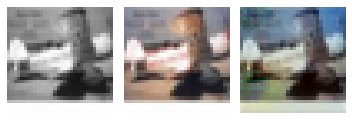

2020-11-08 13:21:47.586 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


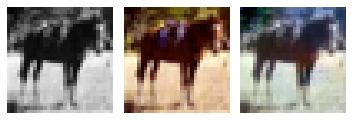

EPOCH: 88.760	trn_loss: 0.004	(7781.40s - 985.37s remaining)

2020-11-08 13:22:08.148 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 88.765	trn_loss: 0.004	(7781.81s - 984.91s remaining)

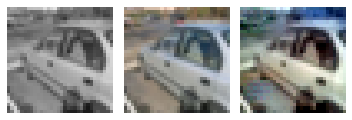

2020-11-08 13:22:08.289 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


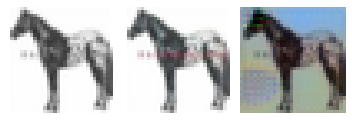

2020-11-08 13:22:08.427 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


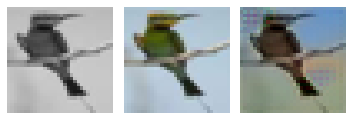

2020-11-08 13:22:08.563 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


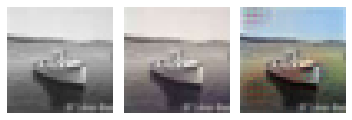

2020-11-08 13:22:08.701 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


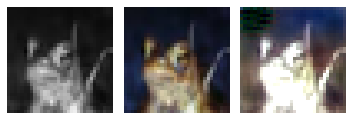

EPOCH: 88.950	val_loss: 0.005	(7807.68s - 969.93s remaining)

2020-11-08 13:22:34.208 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 89.000	val_loss: 0.003	(7807.87s - 965.02s remaining)

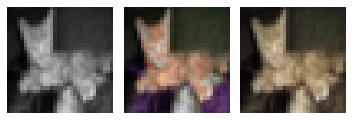

2020-11-08 13:22:34.341 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


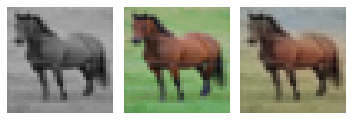

2020-11-08 13:22:34.475 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


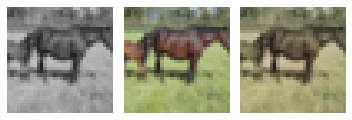

2020-11-08 13:22:34.607 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


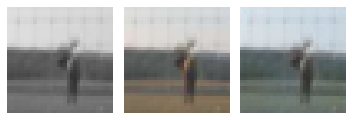

2020-11-08 13:22:34.744 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


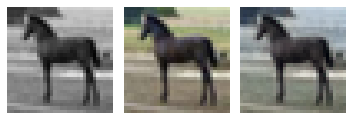

EPOCH: 89.250	trn_loss: 0.004	(7828.48s - 942.93s remaining)

2020-11-08 13:22:55.227 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 89.255	trn_loss: 0.004	(7828.89s - 942.47s remaining)

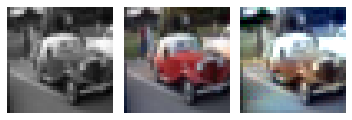

2020-11-08 13:22:55.357 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


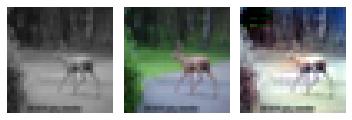

2020-11-08 13:22:55.564 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


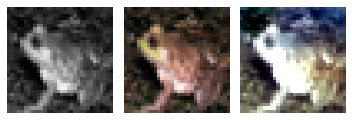

2020-11-08 13:22:55.710 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


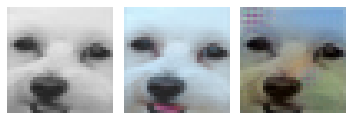

2020-11-08 13:22:55.856 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


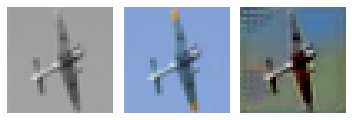

EPOCH: 89.505	trn_loss: 0.004	(7849.66s - 920.41s remaining)

2020-11-08 13:23:16.422 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 89.510	trn_loss: 0.004	(7850.09s - 919.96s remaining)

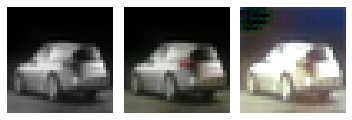

2020-11-08 13:23:16.552 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


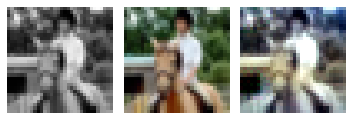

2020-11-08 13:23:16.693 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


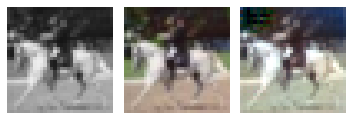

2020-11-08 13:23:16.836 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


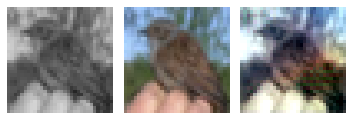

2020-11-08 13:23:17.039 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


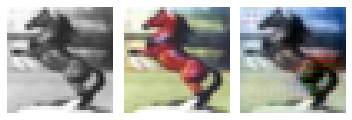

EPOCH: 89.760	trn_loss: 0.004	(7870.87s - 897.90s remaining)

2020-11-08 13:23:37.609 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 89.765	trn_loss: 0.004	(7871.27s - 897.45s remaining)

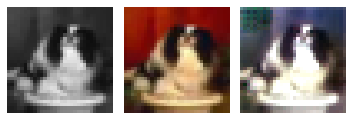

2020-11-08 13:23:37.739 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


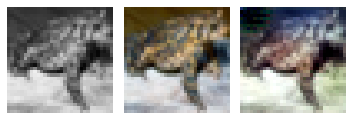

2020-11-08 13:23:37.879 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


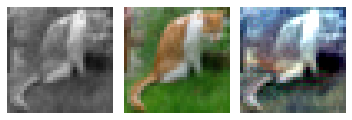

2020-11-08 13:23:38.016 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


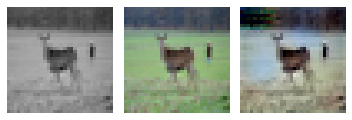

2020-11-08 13:23:38.165 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


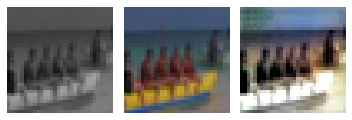

EPOCH: 89.950	val_loss: 0.005	(7896.92s - 882.31s remaining)

2020-11-08 13:24:03.458 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 90.000	trn_loss: 0.004	val_loss: 0.005	(7897.12s - 877.46s remaining)


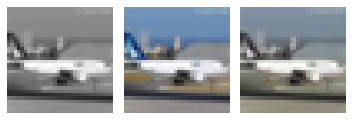

2020-11-08 13:24:03.581 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


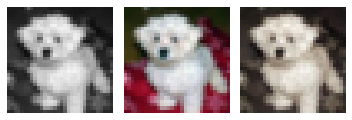

2020-11-08 13:24:03.714 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


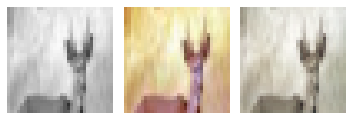

2020-11-08 13:24:03.848 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


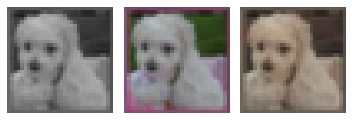

2020-11-08 13:24:03.982 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


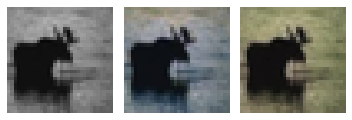

EPOCH: 90.250	trn_loss: 0.004	(7917.75s - 855.38s remaining)

2020-11-08 13:24:24.494 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 90.255	trn_loss: 0.004	(7918.16s - 854.93s remaining)

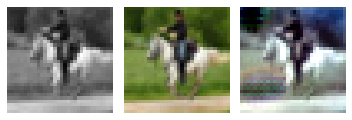

2020-11-08 13:24:24.625 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


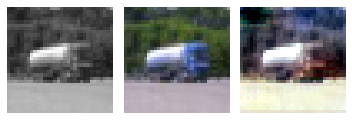

2020-11-08 13:24:24.834 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


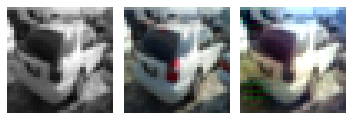

2020-11-08 13:24:24.975 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


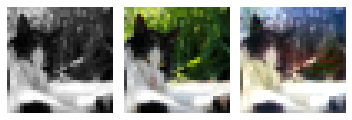

2020-11-08 13:24:25.111 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


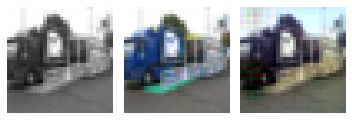

EPOCH: 90.505	trn_loss: 0.004	(7938.89s - 832.87s remaining)

2020-11-08 13:24:45.631 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 90.510	trn_loss: 0.004	(7939.29s - 832.42s remaining)

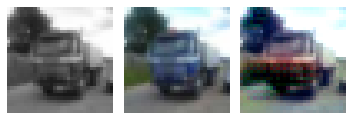

2020-11-08 13:24:45.772 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


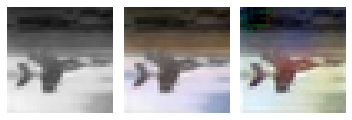

2020-11-08 13:24:45.916 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


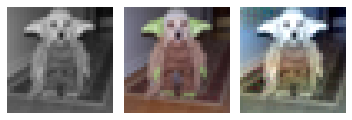

2020-11-08 13:24:46.061 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


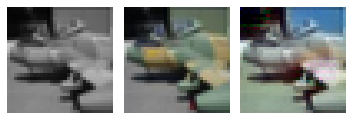

2020-11-08 13:24:46.277 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


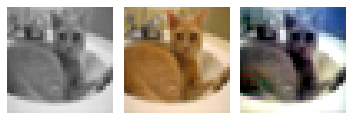

EPOCH: 90.760	trn_loss: 0.004	(7960.10s - 810.37s remaining)

2020-11-08 13:25:06.845 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 90.765	trn_loss: 0.004	(7960.51s - 809.92s remaining)

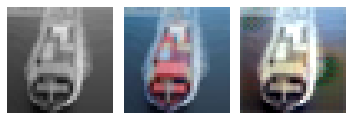

2020-11-08 13:25:06.981 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


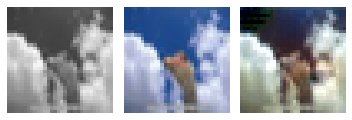

2020-11-08 13:25:07.118 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


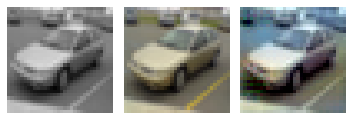

2020-11-08 13:25:07.288 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


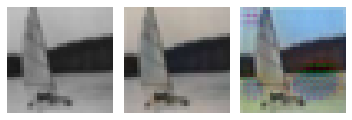

2020-11-08 13:25:07.422 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


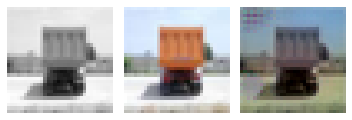

EPOCH: 90.950	val_loss: 0.005	(7986.19s - 794.67s remaining)

2020-11-08 13:25:32.723 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 91.000	val_loss: 0.003	(7986.39s - 789.86s remaining)

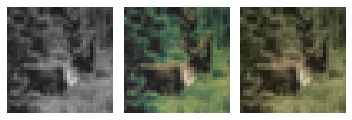

2020-11-08 13:25:32.851 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


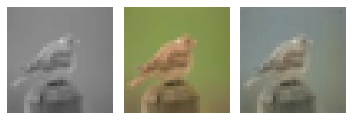

2020-11-08 13:25:32.990 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


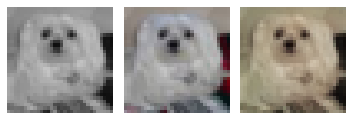

2020-11-08 13:25:33.121 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


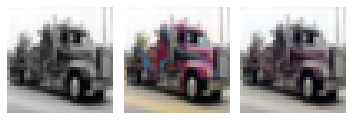

2020-11-08 13:25:33.262 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


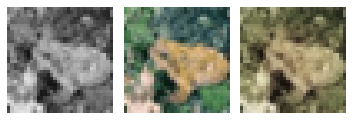

EPOCH: 91.250	trn_loss: 0.005	(8007.09s - 767.80s remaining)

2020-11-08 13:25:53.829 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 91.255	trn_loss: 0.004	(8007.49s - 767.35s remaining)

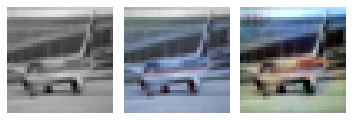

2020-11-08 13:25:53.964 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


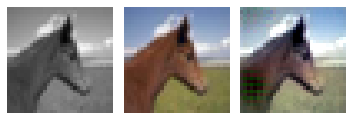

2020-11-08 13:25:54.180 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


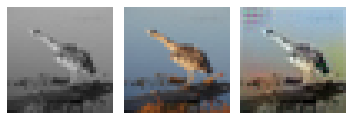

2020-11-08 13:25:54.314 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


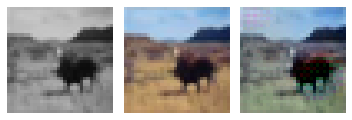

2020-11-08 13:25:54.450 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


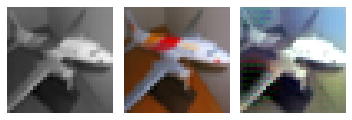

EPOCH: 91.505	trn_loss: 0.004	(8028.30s - 745.31s remaining)

2020-11-08 13:26:15.040 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 91.510	trn_loss: 0.004	(8028.70s - 744.86s remaining)

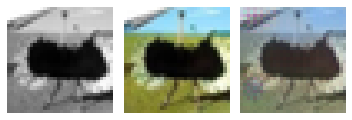

2020-11-08 13:26:15.194 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


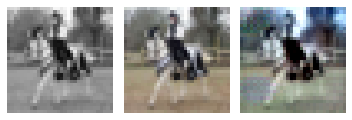

2020-11-08 13:26:15.329 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


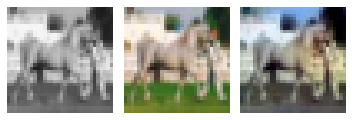

2020-11-08 13:26:15.466 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


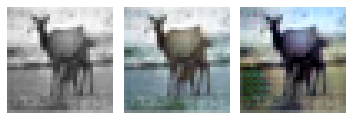

2020-11-08 13:26:15.674 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


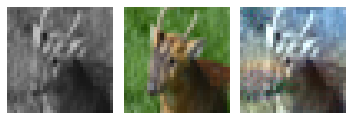

EPOCH: 91.760	trn_loss: 0.004	(8049.47s - 722.82s remaining)

2020-11-08 13:26:36.233 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 91.765	trn_loss: 0.005	(8049.90s - 722.37s remaining)

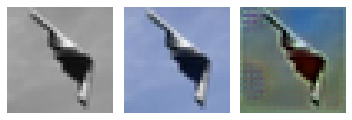

2020-11-08 13:26:36.364 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


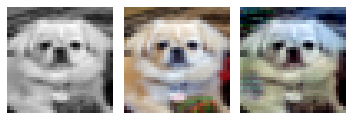

2020-11-08 13:26:36.513 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


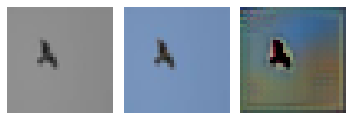

2020-11-08 13:26:36.644 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


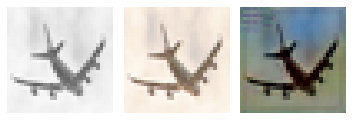

2020-11-08 13:26:36.792 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


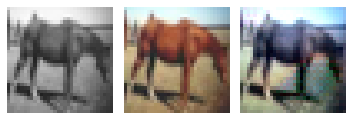

EPOCH: 91.950	val_loss: 0.005	(8075.58s - 707.00s remaining)

2020-11-08 13:27:02.119 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 92.000	val_loss: 0.003	(8075.78s - 702.24s remaining)

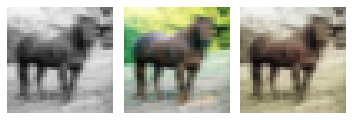

2020-11-08 13:27:02.253 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


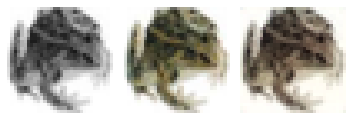

2020-11-08 13:27:02.385 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


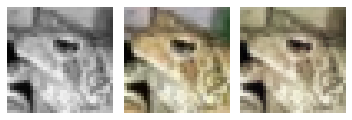

2020-11-08 13:27:02.520 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


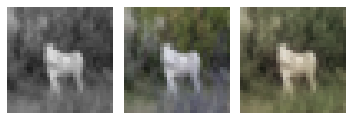

2020-11-08 13:27:02.648 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


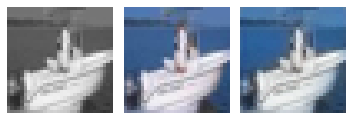

EPOCH: 92.250	trn_loss: 0.004	(8096.44s - 680.19s remaining)

2020-11-08 13:27:23.180 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 92.255	trn_loss: 0.004	(8096.84s - 679.74s remaining)

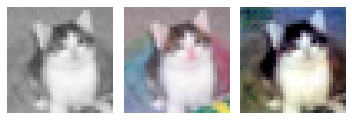

2020-11-08 13:27:23.312 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


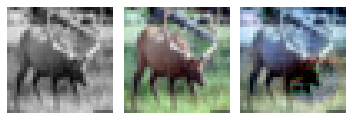

2020-11-08 13:27:23.520 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


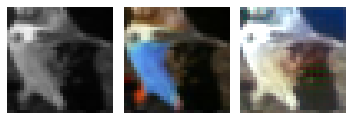

2020-11-08 13:27:23.659 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


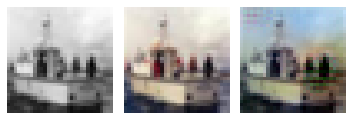

2020-11-08 13:27:23.797 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


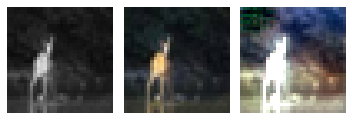

EPOCH: 92.505	trn_loss: 0.004	(8117.67s - 657.71s remaining)

2020-11-08 13:27:44.413 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 92.510	trn_loss: 0.005	(8118.08s - 657.25s remaining)

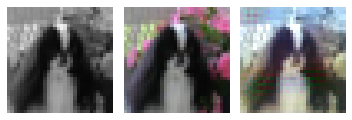

2020-11-08 13:27:44.547 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


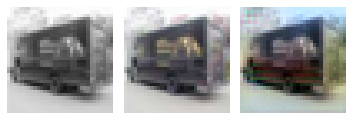

2020-11-08 13:27:44.693 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


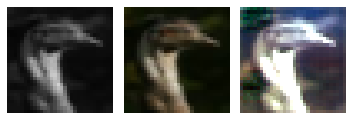

2020-11-08 13:27:44.834 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


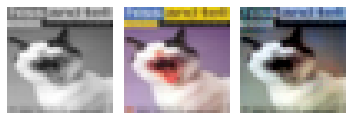

2020-11-08 13:27:45.044 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


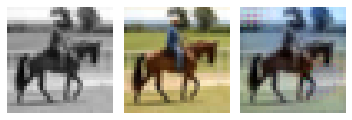

EPOCH: 92.760	trn_loss: 0.004	(8138.96s - 635.23s remaining)

2020-11-08 13:28:05.705 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 92.765	trn_loss: 0.004	(8139.37s - 634.78s remaining)

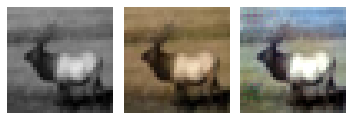

2020-11-08 13:28:05.840 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


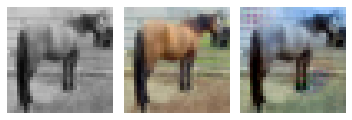

2020-11-08 13:28:05.986 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


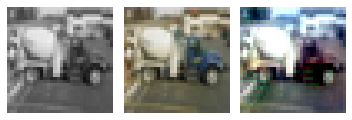

2020-11-08 13:28:06.127 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


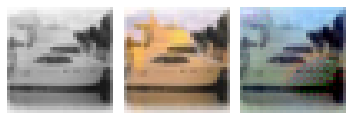

2020-11-08 13:28:06.274 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


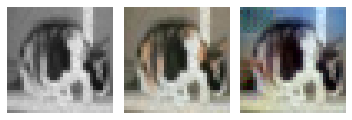

EPOCH: 92.950	val_loss: 0.005	(8165.30s - 619.32s remaining)

2020-11-08 13:28:31.837 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 93.000	val_loss: 0.003	(8165.50s - 614.61s remaining)

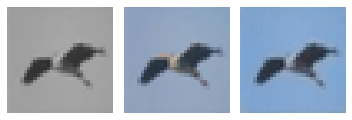

2020-11-08 13:28:31.987 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


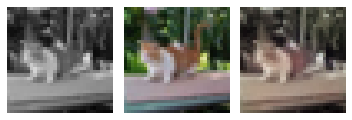

2020-11-08 13:28:32.127 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


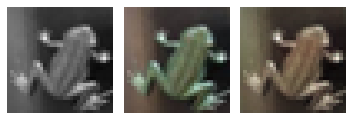

2020-11-08 13:28:32.259 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


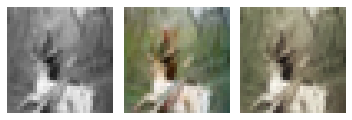

2020-11-08 13:28:32.393 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


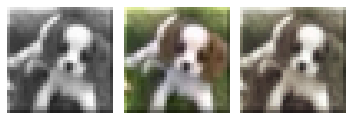

EPOCH: 93.250	trn_loss: 0.005	(8186.14s - 592.56s remaining)

2020-11-08 13:28:52.886 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 93.255	trn_loss: 0.005	(8186.55s - 592.11s remaining)

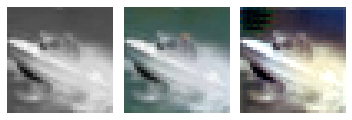

2020-11-08 13:28:53.029 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


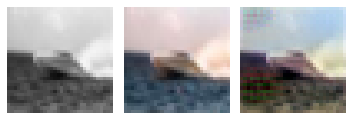

2020-11-08 13:28:53.242 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


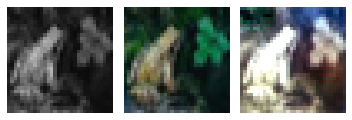

2020-11-08 13:28:53.387 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


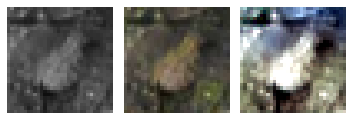

2020-11-08 13:28:53.525 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


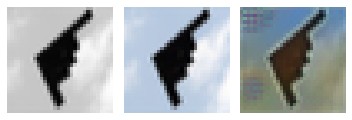

EPOCH: 93.505	trn_loss: 0.004	(8207.34s - 570.08s remaining)

2020-11-08 13:29:14.085 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 93.510	trn_loss: 0.005	(8207.75s - 569.63s remaining)

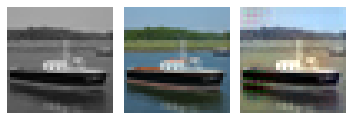

2020-11-08 13:29:14.223 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


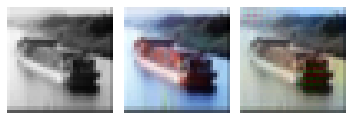

2020-11-08 13:29:14.362 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


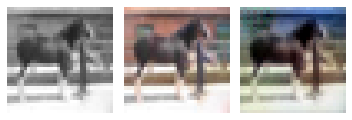

2020-11-08 13:29:14.511 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


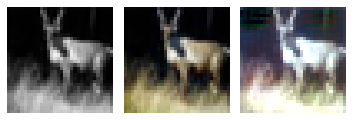

2020-11-08 13:29:14.731 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


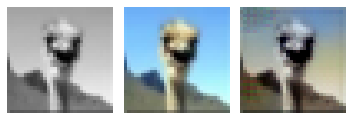

EPOCH: 93.760	trn_loss: 0.004	(8228.75s - 547.63s remaining)

2020-11-08 13:29:35.497 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 93.765	trn_loss: 0.004	(8229.16s - 547.18s remaining)

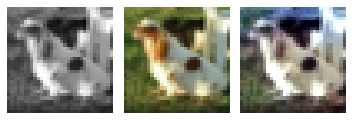

2020-11-08 13:29:35.642 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


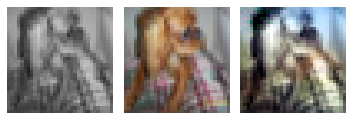

2020-11-08 13:29:35.791 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


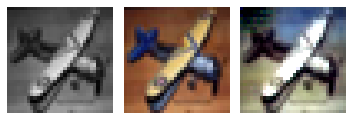

2020-11-08 13:29:35.943 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


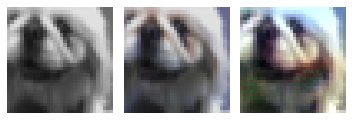

2020-11-08 13:29:36.089 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


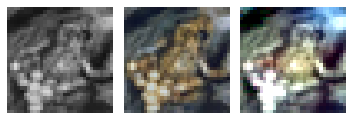

EPOCH: 93.950	val_loss: 0.005	(8255.04s - 531.59s remaining)

2020-11-08 13:30:01.564 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 94.000	val_loss: 0.003	(8255.23s - 526.93s remaining)

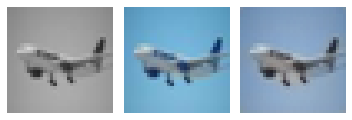

2020-11-08 13:30:01.695 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


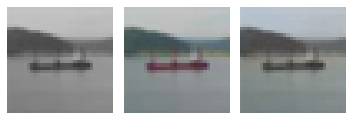

2020-11-08 13:30:01.832 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


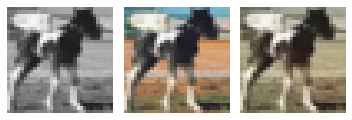

2020-11-08 13:30:01.974 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


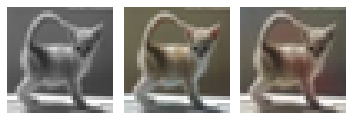

2020-11-08 13:30:02.111 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


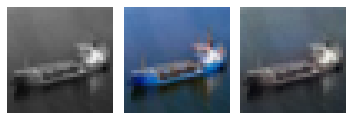

EPOCH: 94.250	trn_loss: 0.004	(8275.90s - 504.90s remaining)

2020-11-08 13:30:22.660 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 94.255	trn_loss: 0.004	(8276.32s - 504.45s remaining)

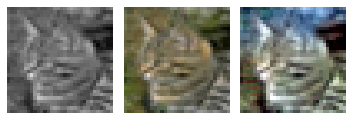

2020-11-08 13:30:22.808 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


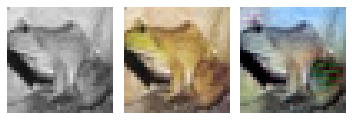

2020-11-08 13:30:23.020 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


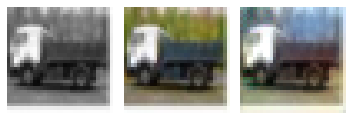

2020-11-08 13:30:23.160 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


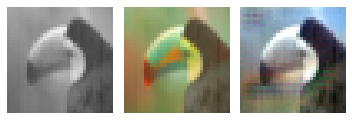

2020-11-08 13:30:23.308 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


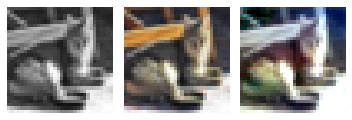

EPOCH: 94.505	trn_loss: 0.004	(8297.14s - 482.43s remaining)

2020-11-08 13:30:43.902 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 94.510	trn_loss: 0.004	(8297.56s - 481.98s remaining)

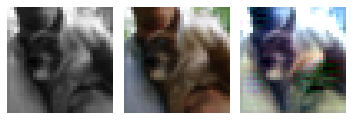

2020-11-08 13:30:44.048 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


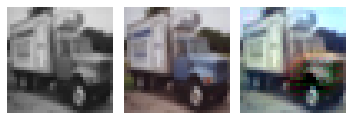

2020-11-08 13:30:44.195 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


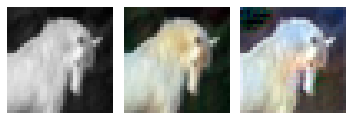

2020-11-08 13:30:44.350 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


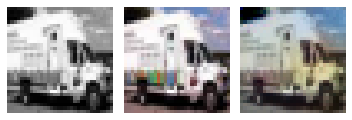

2020-11-08 13:30:44.560 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


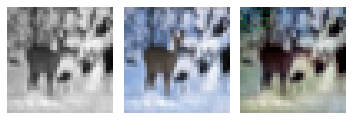

EPOCH: 94.760	trn_loss: 0.004	(8318.41s - 459.97s remaining)

2020-11-08 13:31:05.157 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 94.765	trn_loss: 0.003	(8318.82s - 459.52s remaining)

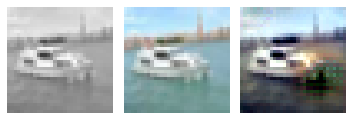

2020-11-08 13:31:05.301 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


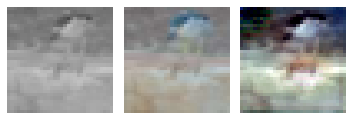

2020-11-08 13:31:05.450 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


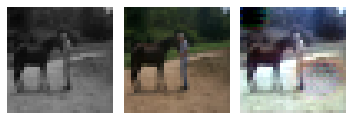

2020-11-08 13:31:05.592 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


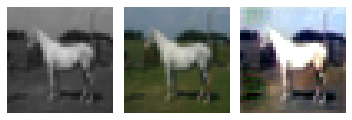

2020-11-08 13:31:05.739 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


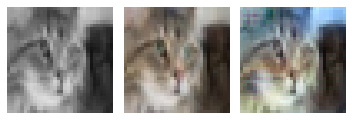

EPOCH: 94.950	val_loss: 0.005	(8344.78s - 443.82s remaining)

2020-11-08 13:31:31.323 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 95.000	trn_loss: 0.004	val_loss: 0.005	(8344.99s - 439.21s remaining)


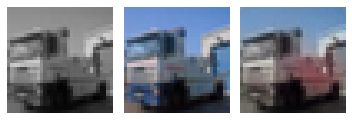

2020-11-08 13:31:31.465 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


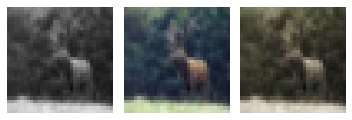

2020-11-08 13:31:31.607 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


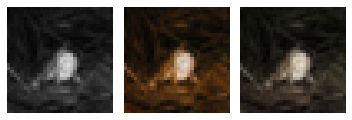

2020-11-08 13:31:31.748 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


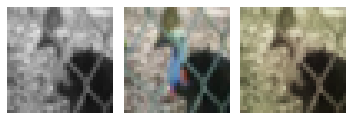

2020-11-08 13:31:31.892 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


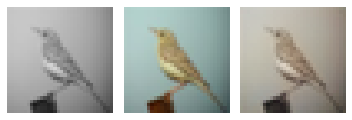

EPOCH: 95.250	trn_loss: 0.004	(8365.73s - 417.19s remaining)

2020-11-08 13:31:52.483 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 95.255	trn_loss: 0.004	(8366.15s - 416.74s remaining)

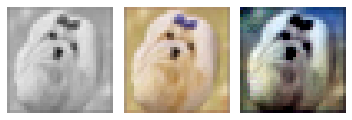

2020-11-08 13:31:52.620 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


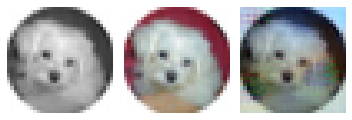

2020-11-08 13:31:52.841 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


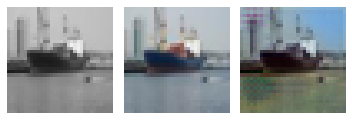

2020-11-08 13:31:52.986 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


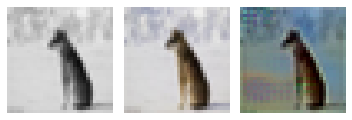

2020-11-08 13:31:53.129 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


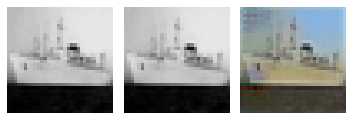

EPOCH: 95.505	trn_loss: 0.004	(8387.14s - 394.74s remaining)

2020-11-08 13:32:13.885 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 95.510	trn_loss: 0.004	(8387.55s - 394.29s remaining)

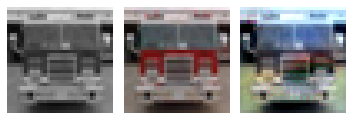

2020-11-08 13:32:14.022 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


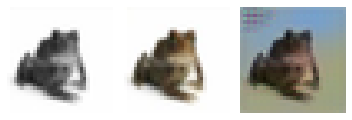

2020-11-08 13:32:14.163 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


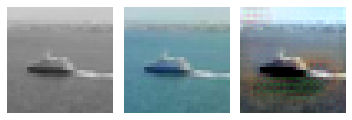

2020-11-08 13:32:14.306 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


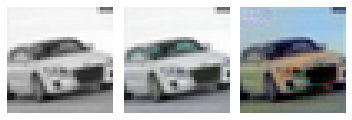

2020-11-08 13:32:14.515 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


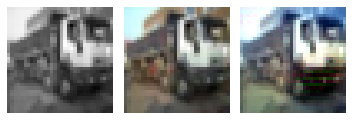

EPOCH: 95.760	trn_loss: 0.004	(8408.43s - 372.28s remaining)

2020-11-08 13:32:35.177 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 95.765	trn_loss: 0.004	(8408.84s - 371.83s remaining)

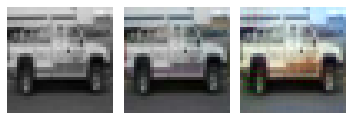

2020-11-08 13:32:35.312 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


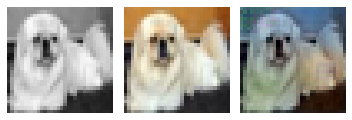

2020-11-08 13:32:35.457 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


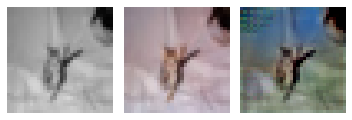

2020-11-08 13:32:35.592 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


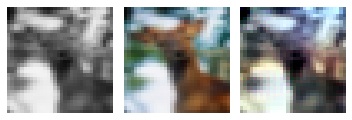

2020-11-08 13:32:35.741 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


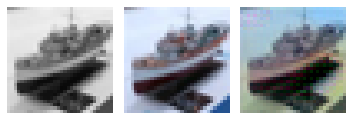

EPOCH: 95.950	val_loss: 0.005	(8434.74s - 356.03s remaining)

2020-11-08 13:33:01.271 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 96.000	val_loss: 0.003	(8434.94s - 351.46s remaining)

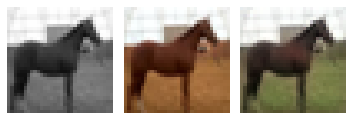

2020-11-08 13:33:01.407 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


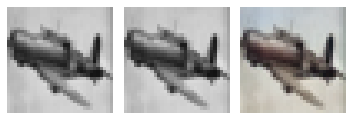

2020-11-08 13:33:01.541 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


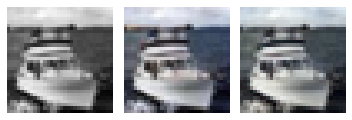

2020-11-08 13:33:01.680 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


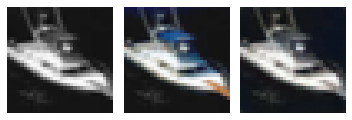

2020-11-08 13:33:01.818 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


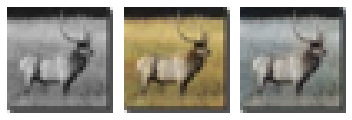

EPOCH: 96.250	trn_loss: 0.004	(8455.58s - 329.44s remaining)

2020-11-08 13:33:22.333 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 96.255	trn_loss: 0.004	(8455.99s - 328.99s remaining)

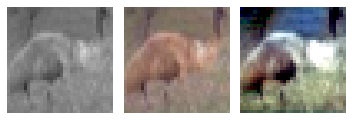

2020-11-08 13:33:22.478 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


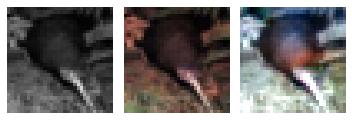

2020-11-08 13:33:22.695 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


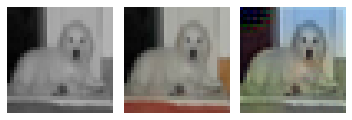

2020-11-08 13:33:22.840 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


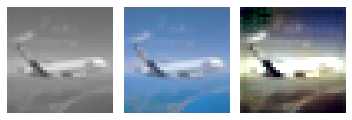

2020-11-08 13:33:22.991 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


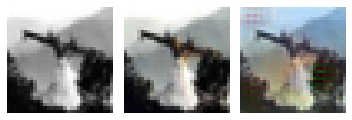

EPOCH: 96.505	trn_loss: 0.005	(8476.79s - 306.98s remaining)

2020-11-08 13:33:43.533 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 96.510	trn_loss: 0.005	(8477.20s - 306.53s remaining)

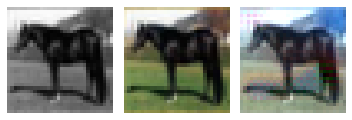

2020-11-08 13:33:43.677 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


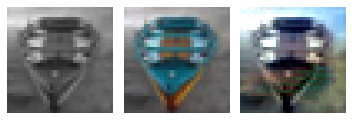

2020-11-08 13:33:43.814 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


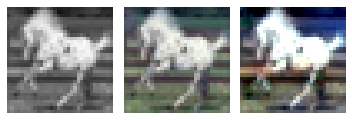

2020-11-08 13:33:43.950 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


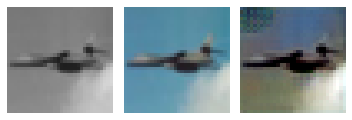

2020-11-08 13:33:44.158 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


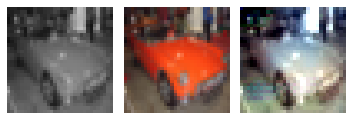

EPOCH: 96.760	trn_loss: 0.004	(8498.13s - 284.54s remaining)

2020-11-08 13:34:04.873 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 96.765	trn_loss: 0.004	(8498.54s - 284.09s remaining)

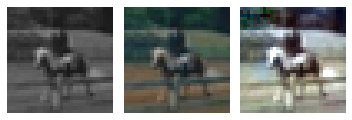

2020-11-08 13:34:05.008 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


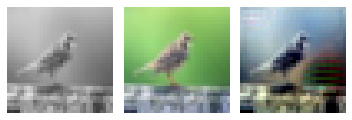

2020-11-08 13:34:05.153 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


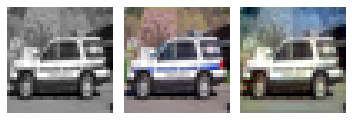

2020-11-08 13:34:05.294 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


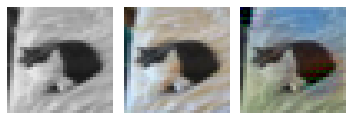

2020-11-08 13:34:05.428 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


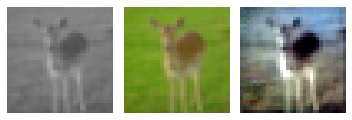

EPOCH: 96.950	val_loss: 0.005	(8524.28s - 268.17s remaining)

2020-11-08 13:34:30.801 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 97.000	val_loss: 0.003	(8524.47s - 263.64s remaining)

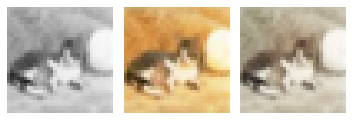

2020-11-08 13:34:30.937 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


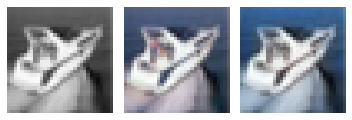

2020-11-08 13:34:31.072 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


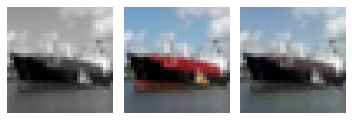

2020-11-08 13:34:31.209 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


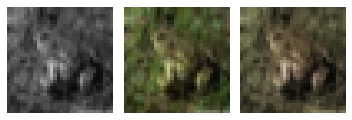

2020-11-08 13:34:31.348 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


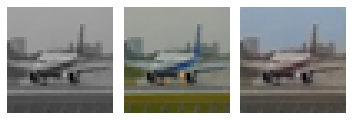

EPOCH: 97.250	trn_loss: 0.005	(8545.10s - 241.64s remaining)

2020-11-08 13:34:51.844 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 97.255	trn_loss: 0.004	(8545.51s - 241.19s remaining)

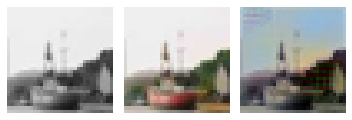

2020-11-08 13:34:51.974 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


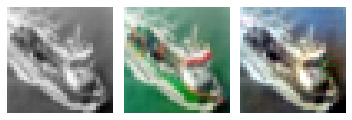

2020-11-08 13:34:52.186 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


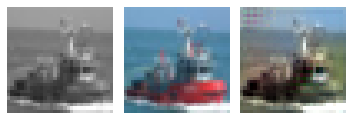

2020-11-08 13:34:52.334 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


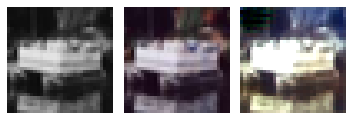

2020-11-08 13:34:52.471 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


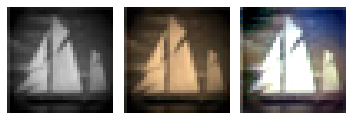

EPOCH: 97.505	trn_loss: 0.005	(8566.30s - 219.19s remaining)

2020-11-08 13:35:13.041 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 97.510	trn_loss: 0.004	(8566.70s - 218.74s remaining)

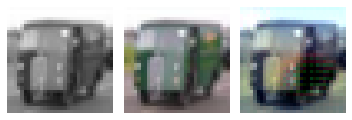

2020-11-08 13:35:13.176 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


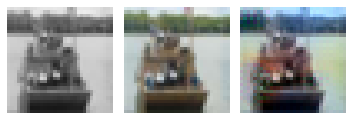

2020-11-08 13:35:13.320 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


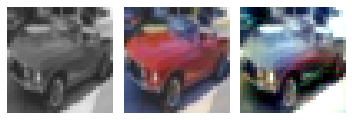

2020-11-08 13:35:13.453 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


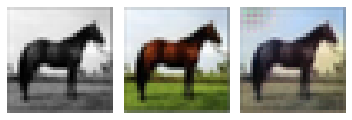

2020-11-08 13:35:13.662 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


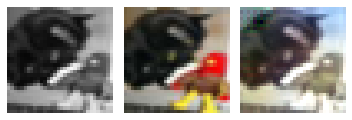

EPOCH: 97.760	trn_loss: 0.004	(8587.47s - 196.75s remaining)

2020-11-08 13:35:34.209 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 97.765	trn_loss: 0.005	(8587.87s - 196.30s remaining)

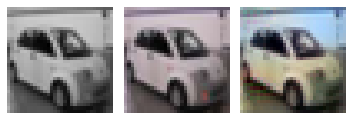

2020-11-08 13:35:34.348 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


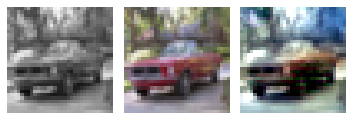

2020-11-08 13:35:34.484 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


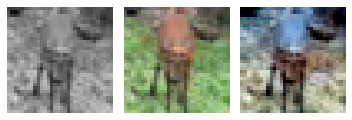

2020-11-08 13:35:34.626 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


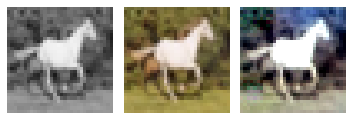

2020-11-08 13:35:34.761 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


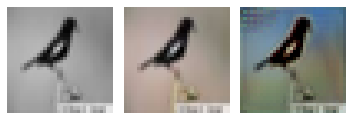

EPOCH: 97.950	val_loss: 0.005	(8613.98s - 180.28s remaining)

2020-11-08 13:36:00.511 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 98.000	val_loss: 0.003	(8614.18s - 175.80s remaining)

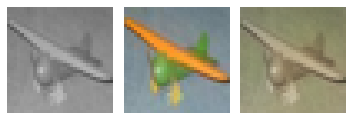

2020-11-08 13:36:00.646 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


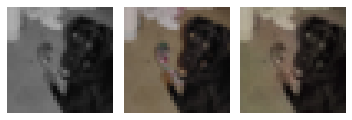

2020-11-08 13:36:00.780 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


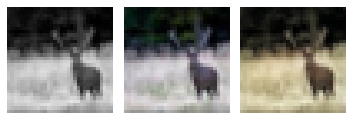

2020-11-08 13:36:00.918 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


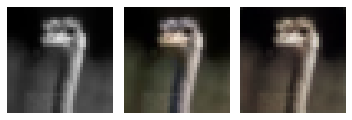

2020-11-08 13:36:01.056 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


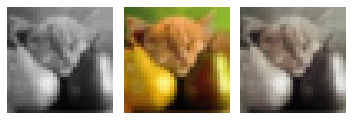

EPOCH: 98.250	trn_loss: 0.004	(8634.92s - 153.80s remaining)

2020-11-08 13:36:21.673 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 98.255	trn_loss: 0.004	(8635.34s - 153.35s remaining)

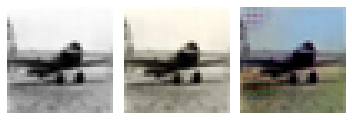

2020-11-08 13:36:21.818 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


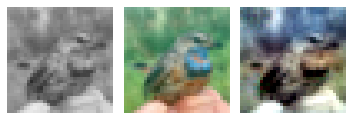

2020-11-08 13:36:22.032 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


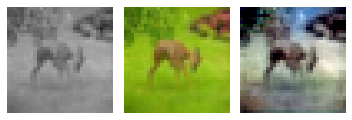

2020-11-08 13:36:22.175 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


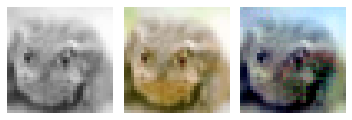

2020-11-08 13:36:22.315 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


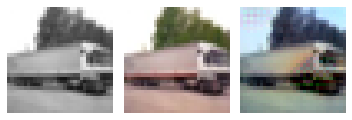

EPOCH: 98.505	trn_loss: 0.004	(8656.12s - 131.36s remaining)

2020-11-08 13:36:42.860 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 98.510	trn_loss: 0.004	(8656.52s - 130.91s remaining)

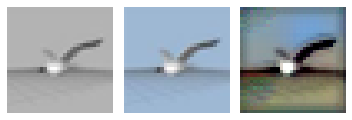

2020-11-08 13:36:42.996 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


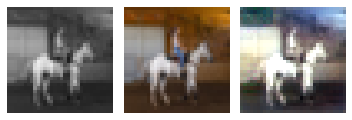

2020-11-08 13:36:43.136 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


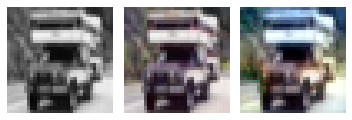

2020-11-08 13:36:43.273 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


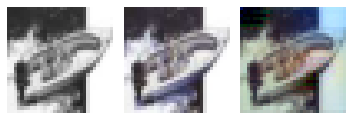

2020-11-08 13:36:43.470 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


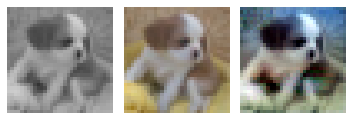

EPOCH: 98.760	trn_loss: 0.004	(8677.27s - 108.93s remaining)

2020-11-08 13:37:04.010 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 98.765	trn_loss: 0.005	(8677.67s - 108.48s remaining)

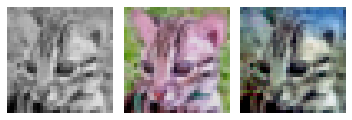

2020-11-08 13:37:04.151 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


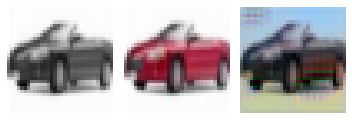

2020-11-08 13:37:04.289 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


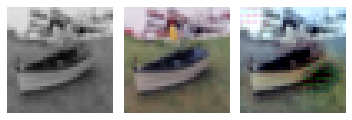

2020-11-08 13:37:04.424 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


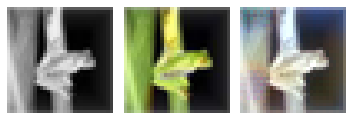

2020-11-08 13:37:04.559 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


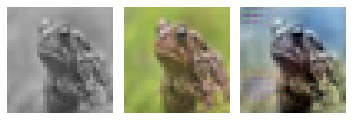

EPOCH: 98.950	val_loss: 0.005	(8703.55s - 92.36s remaining)

2020-11-08 13:37:30.067 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 99.000	val_loss: 0.003	(8703.73s - 87.92s remaining)

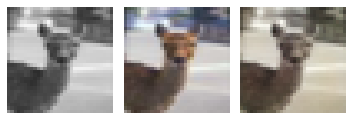

2020-11-08 13:37:30.205 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


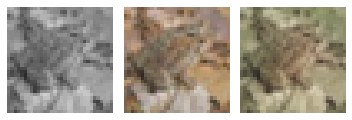

2020-11-08 13:37:30.348 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


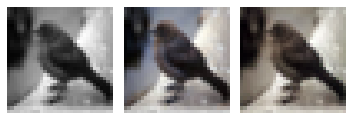

2020-11-08 13:37:30.496 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


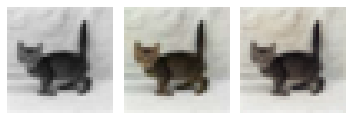

2020-11-08 13:37:30.637 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


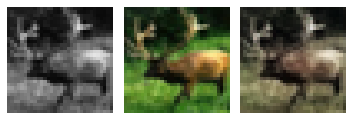

EPOCH: 99.250	trn_loss: 0.005	(8724.47s - 65.93s remaining)

2020-11-08 13:37:51.210 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 99.255	trn_loss: 0.004	(8724.87s - 65.48s remaining)

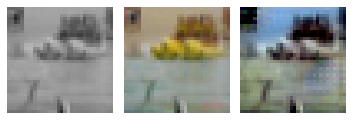

2020-11-08 13:37:51.357 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


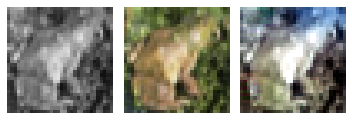

2020-11-08 13:37:51.567 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


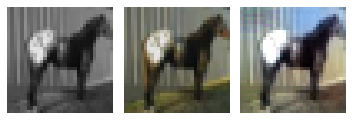

2020-11-08 13:37:51.717 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


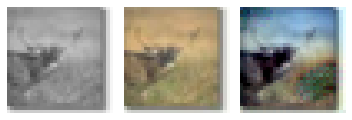

2020-11-08 13:37:51.857 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


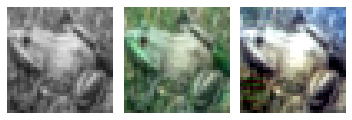

EPOCH: 99.505	trn_loss: 0.005	(8745.72s - 43.50s remaining)

2020-11-08 13:38:12.486 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 99.510	trn_loss: 0.004	(8746.15s - 43.05s remaining)

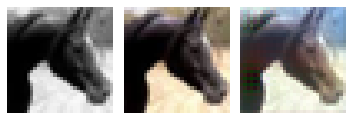

2020-11-08 13:38:12.617 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


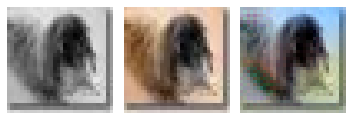

2020-11-08 13:38:12.755 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


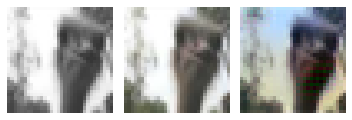

2020-11-08 13:38:12.892 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


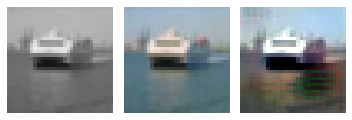

2020-11-08 13:38:13.104 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


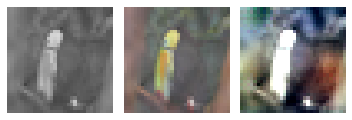

EPOCH: 99.760	trn_loss: 0.004	(8766.99s - 21.07s remaining)

2020-11-08 13:38:33.728 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


EPOCH: 99.765	trn_loss: 0.005	(8767.39s - 20.62s remaining)

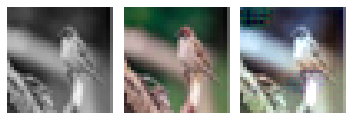

2020-11-08 13:38:33.860 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


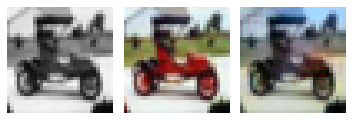

2020-11-08 13:38:33.996 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


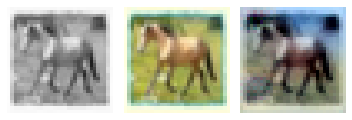

2020-11-08 13:38:34.137 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


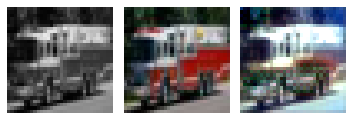

2020-11-08 13:38:34.280 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


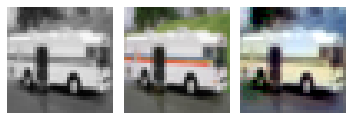

EPOCH: 99.950	val_loss: 0.005	(8793.14s - 4.40s remaining)

2020-11-08 13:38:59.686 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


EPOCH: 100.000	trn_loss: 0.004	val_loss: 0.005	(8793.35s - 0.00s remaining)


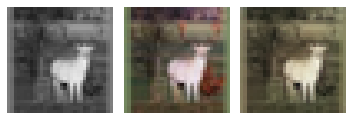

2020-11-08 13:38:59.833 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)


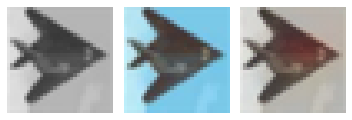

2020-11-08 13:38:59.978 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


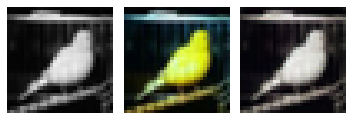

2020-11-08 13:39:00.156 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


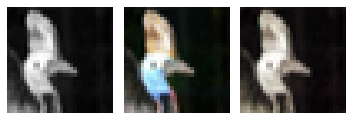

2020-11-08 13:39:00.294 | INFO     | torch_snippets.loader:subplots:375 - plotting 3 images in a grid of 1x3 @ (5, 5)
Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


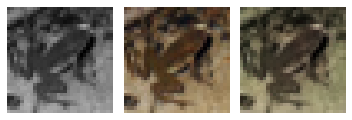

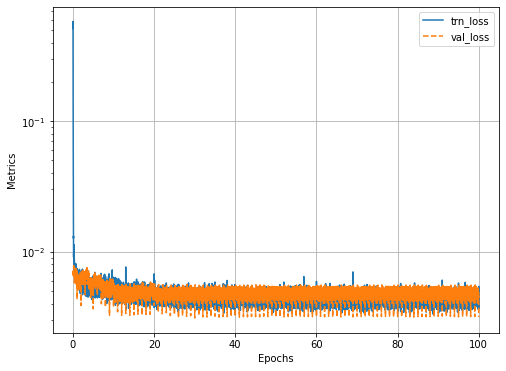

In [ ]:
model, optimizer, criterion = get_model()
exp_lr_scheduler = optim.lr_scheduler.StepLR(optimizer, step_size=10, gamma=0.1)

_val_dl = DataLoader(val_ds, batch_size=1, shuffle=True)

n_epochs = 100
log = Report(n_epochs)
for ex in range(n_epochs):
    N = len(trn_dl)
    for bx, data in enumerate(trn_dl):
        loss = train_batch(model, data, optimizer, criterion)
        log.record(ex+(bx+1)/N, trn_loss=loss, end='\r')
        if (bx+1)%50 == 0:
            for _ in range(5):
                a,b = next(iter(_val_dl))
                _b = model(a)
                subplots([a[0], b[0], _b[0]], nc=3, figsize=(5,5))

    N = len(val_dl)
    for bx, data in enumerate(val_dl):
        loss = validate_batch(model, data, criterion)
        log.record(ex+(bx+1)/N, val_loss=loss, end='\r')
        
    exp_lr_scheduler.step()
    if (ex+1) % 5 == 0: log.report_avgs(ex+1)

    for _ in range(5):
        a,b = next(iter(_val_dl))
        _b = model(a)
        subplots([a[0], b[0], _b[0]], nc=3, figsize=(5,5))

log.plot(log=True)

  0%|          | 0/101 [00:00<?, ?it/s]/usr/local/lib/python3.6/dist-packages/numpy/core/fromnumeric.py:3335: RuntimeWarning: Mean of empty slice.
  out=out, **kwargs)
/usr/local/lib/python3.6/dist-packages/numpy/core/_methods.py:161: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
100%|██████████| 101/101 [00:00<00:00, 396.27it/s]


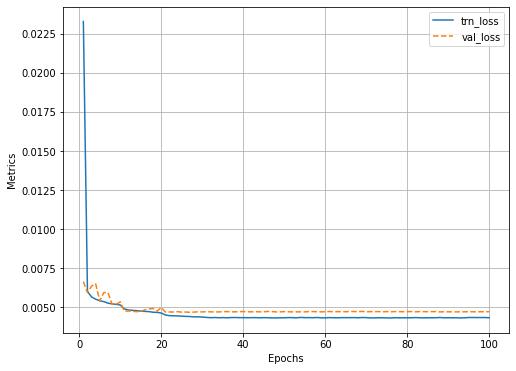

In [ ]:

log.plot_epochs()